In [4]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import datetime
idx = pd.IndexSlice
import statsmodels.api as sm

from statsmodels.regression.linear_model import OLS
from statsmodels.tsa.stattools import adfuller
from statsmodels.tsa.stattools import coint
from sklearn.model_selection import train_test_split

import yfinance as yf

import datapackage

%matplotlib inline

In [5]:
stocks = pd.read_csv('sp_500_stocks.csv')

In [631]:
import csv

history_filename = 'history/sp500.csv'
f = open(history_filename, 'w')
data = pd.DataFrame()
for s in stocks["Symbol"]:
    ticker = yf.Ticker(s)
    df = ticker.history(period="15y")
    df["symbol"] = s
    data = data.append(df)
f.write(data.to_csv())
f.close()

- AGN: No data found, symbol may be delisted
- APC: No data found, symbol may be delisted
- BHGE: No data found, symbol may be delisted
- BBT: No data found, symbol may be delisted
- BRK.B: No data found, symbol may be delisted
- BF.B: No data found for this date range, symbol may be delisted
- CBG: No data found for this date range, symbol may be delisted
- CBS: No data found, symbol may be delisted
- CELG: No data found, symbol may be delisted
- CTL: No data found, symbol may be delisted
- CXO: No data found, symbol may be delisted
- DWDP: No data found, symbol may be delisted
- DPS: No data found for this date range, symbol may be delisted
- ETFC: No data found, symbol may be delisted
- GGP: No data found for this date range, symbol may be delisted
- HRS: No data found, symbol may be delisted
- HCP: No data found, symbol may be delisted
- JEC: No data found, symbol may be delisted
- LLL: No data found, symbol may be delisted
- LUK: No data found for this date range, symbol may be de

In [6]:
prices = pd.read_csv('history/sp500.csv', index_col=['symbol'], parse_dates=True)

In [40]:
prices

,Date,Open,High,Low,Close,Volume,Dividends,Stock Splits,Adj Close,Sector
symbol,,,,,,,,,,
MMM,2006-04-24,56.016762,57.276988,56.010092,56.983601,4363700.0,0.00,0.0,NaN,Industrials
MMM,2006-04-25,56.676843,57.010236,56.276772,56.550152,3955800.0,0.00,0.0,NaN,Industrials
MMM,2006-04-26,56.570183,57.110283,56.410155,57.023598,2704600.0,0.00,0.0,NaN,Industrials
MMM,2006-04-27,56.676837,57.130252,56.343444,56.830200,2991300.0,0.00,0.0,NaN,Industrials
MMM,2006-04-28,56.676832,57.016895,56.636827,56.963551,2531000.0,0.00,0.0,NaN,Industrials
...,...,...,...,...,...,...,...,...,...,...
ZTS,2021-04-15,163.686190,166.152518,163.686190,165.203934,2041500.0,0.00,0.0,NaN,Health Care
ZTS,2021-04-16,166.022729,168.019754,165.753126,167.380707,2290800.0,0.00,0.0,NaN,Health Care
ZTS,2021-04-19,167.250892,168.019751,166.342242,167.850006,1842700.0,0.00,0.0,NaN,Health Care


In [8]:
prices['Sector'] = prices.index.to_series().map(stocks.set_index('Symbol')['Sector'])

In [9]:
prices.head(10)

,Date,Open,High,Low,Close,Volume,Dividends,Stock Splits,Adj Close,Sector
symbol,,,,,,,,,,
MMM,2006-04-24,56.016762,57.276988,56.010092,56.983601,4363700.0,0.0,0.0,NaN,Industrials
MMM,2006-04-25,56.676843,57.010236,56.276772,56.550152,3955800.0,0.0,0.0,NaN,Industrials
MMM,2006-04-26,56.570183,57.110283,56.410155,57.023598,2704600.0,0.0,0.0,NaN,Industrials
MMM,2006-04-27,56.676837,57.130252,56.343444,56.830200,2991300.0,0.0,0.0,NaN,Industrials
MMM,2006-04-28,56.676832,57.016895,56.636827,56.963551,2531000.0,0.0,0.0,NaN,Industrials
MMM,2006-05-01,57.016930,57.163623,56.570179,56.656864,2848100.0,0.0,0.0,NaN,Industrials
MMM,2006-05-02,56.776884,56.883567,55.730029,56.343472,3807300.0,0.0,0.0,NaN,Industrials
MMM,2006-05-03,56.510157,57.276962,56.416807,57.276962,3317600.0,0.0,0.0,NaN,Industrials
MMM,2006-05-04,57.276953,57.790376,57.236942,57.657021,3324700.0,0.0,0.0,NaN,Industrials


In [44]:
tickers = prices[prices['Sector'] == 'Information Technology'].index.unique().tolist()
print(tickers.sort())
for i in tickers:
    print(i, end=", ")
print(len(tickers))

None
AAPL, ACN, ADBE, ADI, ADP, ADS, ADSK, AKAM, AMAT, AMD, ANSS, APH, ATVI, AVGO, CA, CDNS, CRM, CSCO, CSRA, CTSH, CTXS, DXC, EA, EBAY, FB, FFIV, FIS, FISV, FLIR, GLW, GOOG, GOOGL, GPN, HPE, HPQ, IBM, INTC, INTU, IT, JNPR, KLAC, LRCX, MA, MCHP, MSFT, MSI, MU, NFLX, NTAP, NVDA, ORCL, PAYX, PYPL, QCOM, QRVO, SNPS, STX, SWKS, TEL, TXN, V, VRSN, WDC, WU, XLNX, XRX, 66


In [11]:
IT = prices.loc[tickers, : ]
IT

,Date,Open,High,Low,Close,Volume,Dividends,Stock Splits,Adj Close,Sector
symbol,,,,,,,,,,
ACN,2006-04-24,22.426719,22.607945,22.222840,22.434269,1464200.0,0.0,0.0,NaN,Information Technology
ACN,2006-04-25,22.388960,22.464471,22.260591,22.388960,1204600.0,0.0,0.0,NaN,Information Technology
ACN,2006-04-26,22.351206,22.683454,22.283246,22.351206,1291800.0,0.0,0.0,NaN,Information Technology
ACN,2006-04-27,22.298346,22.532429,22.018955,22.419163,1975700.0,0.0,0.0,NaN,Information Technology
ACN,2006-04-28,22.313450,22.313450,21.898141,21.950998,2263600.0,0.0,0.0,NaN,Information Technology
...,...,...,...,...,...,...,...,...,...,...
XLNX,2021-04-15,125.510002,131.630005,125.510002,130.100006,3731900.0,0.0,0.0,NaN,Information Technology
XLNX,2021-04-16,130.490005,130.990005,127.849998,128.639999,2179700.0,0.0,0.0,NaN,Information Technology
XLNX,2021-04-19,127.989998,130.110001,125.419998,126.900002,1836300.0,0.0,0.0,NaN,Information Technology


In [12]:
IT = IT.set_index(['Date'], append=True)
min_obs = 365*10
nobs = IT.groupby(level='symbol').size()
keep = nobs[nobs>=min_obs].index
IT = IT.loc[idx[keep,:], :]
IT

Open       High        Low      Close       Volume  \
symbol Date                                                                  
AAPL   2006-04-24   2.056505   2.058659   2.014975   2.022666  707028000.0   
       2006-04-25   2.029125   2.048506   2.016821   2.035586  529062800.0   
       2006-04-26   2.050353   2.100496   2.042662   2.096498  710886400.0   
       2006-04-27   2.083577   2.149102   2.071887   2.133721  845947200.0   
       2006-04-28   2.134336   2.193401   2.128799   2.165406  760037600.0   
...                      ...        ...        ...        ...          ...   
XRX    2021-04-15  24.910000  25.080000  24.639999  24.740000    3138500.0   
       2021-04-16  24.809999  25.230000  24.650000  25.070000    3291000.0   
       2021-04-19  25.000000  25.590000  24.990000  25.320000    5002600.0   
       2021-04-20  24.930000  25.030001  23.700001  23.709999    4080000.0   
       2021-04-21  23.520000  24.469999  23.420000  24.320000    2082000.0   

                   Dividends  Stock Splits  Adj Close                  Sector  
symbol Date                                                                    
AAPL   2006-04-24        0.0           0.0        NaN  Information Technology  
       2006-04-25        0.0           0.0        NaN  Information Technology  
       2006-04-26        0.0           0.0        NaN  Information Technology  
       2006-04-27        0.0           0.0        NaN  Information Technology  
       2006-04-28        0.0           0.0        NaN  Information Technology  
...                      ...           ...        ...                     ...  
XRX    2021-04-15        0.0           0.0        NaN  Information Technology  
       2021-04-16        0.0           0.0        NaN  Information Technology  
       2021-04-19        0.0           0.0        NaN  Information Technology  
       2021-04-20        0.0           0.0        NaN  Information Technology  
       2021-04-21        0.0           0.0        NaN  Information Technology  

[215041 rows x 9 columns]

In [13]:
close = IT.unstack('symbol')['Close'].sort_index()
close = close.dropna()
close

symbol,AAPL,ACN,ADBE,ADI,ADP,ADS,ADSK,AKAM,AMAT,AMD,...,QCOM,SNPS,STX,SWKS,TXN,VRSN,WDC,WU,XLNX,XRX
Date,,,,,,,,,,,,,,,,,,,,,
2006-10-02,2.302917,23.287542,37.000000,20.116110,25.761679,51.641300,33.520000,49.830002,13.467232,24.809999,...,24.496069,19.500000,12.887232,4.587751,23.495592,17.526478,13.928676,13.908158,16.115734,27.927454
2006-10-03,2.278921,23.355497,36.750000,19.992619,26.112179,53.032433,33.290001,51.150002,13.520763,24.129999,...,25.019068,19.400000,12.825408,6.210690,22.989466,17.025478,13.622472,14.077081,16.057720,27.981968
2006-10-04,2.318914,23.672642,37.759998,20.328798,26.123135,54.470573,34.119999,51.970001,13.834312,25.030001,...,25.315907,19.840000,12.819787,6.337624,22.925314,17.382122,13.748093,13.922235,16.666952,28.599756
2006-10-05,2.301993,23.589577,38.180000,20.253321,26.123135,54.555161,35.160000,52.340000,13.826664,25.110001,...,25.626873,20.000000,12.729869,6.364824,22.526121,17.501005,13.591061,13.823691,16.442118,28.327208
2006-10-06,2.283228,23.257336,38.150002,20.630676,25.997173,53.887802,35.099998,51.369999,13.994909,24.010000,...,25.704613,19.969999,12.578112,6.310424,22.319386,17.229277,13.441883,13.774422,16.681463,28.490738
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-04-15,134.500000,285.149994,523.250000,160.710007,191.889999,107.500000,298.859985,105.830002,134.410004,83.010002,...,137.839996,262.130005,81.330002,190.649994,193.169998,208.320007,68.730003,25.760000,130.100006,24.740000
2021-04-16,134.160004,286.959991,525.080017,159.509995,192.940002,109.779999,300.160004,105.959999,133.729996,82.150002,...,138.210007,260.769989,82.070000,189.759995,191.929993,208.160004,68.889999,25.889999,128.639999,25.070000
2021-04-19,134.839996,286.540009,516.169983,156.910004,192.750000,108.529999,290.200012,105.739998,130.889999,81.110001,...,135.250000,250.639999,82.330002,185.869995,187.059998,207.259995,68.309998,26.150000,126.900002,25.320000


In [14]:
tickers = list(IT.index.get_level_values('symbol').unique())

# Search for cointegrated pairs

In [15]:
train_close, test_close = train_test_split(close, test_size=0.2, shuffle=False)

In [16]:
train_close.head(2).append(train_close.tail(2))

symbol,AAPL,ACN,ADBE,ADI,ADP,ADS,ADSK,AKAM,AMAT,AMD,...,QCOM,SNPS,STX,SWKS,TXN,VRSN,WDC,WU,XLNX,XRX
Date,,,,,,,,,,,,,,,,,,,,,
2006-10-02,2.302917,23.287542,37.000000,20.116110,25.761679,51.641300,33.520000,49.830002,13.467232,24.809999,...,24.496069,19.500000,12.887232,4.587751,23.495592,17.526478,13.928676,13.908158,16.115734,27.927454
2006-10-03,2.278921,23.355497,36.750000,19.992619,26.112179,53.032433,33.290001,51.150002,13.520763,24.129999,...,25.019068,19.400000,12.825408,6.210690,22.989466,17.025478,13.622472,14.077081,16.057720,27.981968
2018-05-21,45.430706,150.175140,238.100006,89.754997,120.735466,203.237930,137.669998,76.459999,47.674252,12.990000,...,52.396835,89.430000,49.130131,94.277176,102.248108,128.320007,79.806671,17.944965,69.562759,24.650055
2018-05-22,45.316906,148.634521,238.789993,90.141136,120.304405,203.285736,136.710007,76.389999,47.912632,12.980000,...,52.106297,89.269997,49.782333,95.412125,102.664841,127.839996,81.042564,17.998423,68.985222,24.782204


In [649]:
def find_cointegrated_pairs(data, level=0.05):
    n = data.shape[1]
    pvalue_matrix = np.ones((n, n))
    keys = data.keys()
    pairs = []
    for i in range(n):
        for j in range(i+1, n):
            result = coint(data[keys[i]], data[keys[j]])
            pvalue_matrix[i, j] = result[1]
            if result[1] < level:
                pairs.append((keys[i], keys[j]))
    return pvalue_matrix, pairs

# Начиная отсюда

In [66]:
def find_cointegrated_pairs(data):
    n = data.shape[1]
    pvalue_matrix = np.ones((n, n))
    keys = data.keys()
    pairs = []
    for i in range(n):
        for j in range(i+1, n):
            result = coint(data[keys[i]], data[keys[j]])
            model = sm.OLS(data[keys[i]], data[keys[j]]).fit()
            pvalue_matrix[i, j] = result[1]
            pairs.append((keys[i], keys[j], result[1], model.params[0]))
    return pvalue_matrix, pairs

In [67]:
pvalues, pairs = find_cointegrated_pairs(train_close)
print(pairs)

[('AAPL', 'ACN', 0.13938352710330915, 0.2727317793833045), ('AAPL', 'ADBE', 0.8172050495739622, 0.2475568895392411), ('AAPL', 'ADI', 0.0614087693344599, 0.4507369192521966), ('AAPL', 'ADP', 0.044367047461287376, 0.3379319851746466), ('AAPL', 'ADS', 0.989720287664589, 0.11520615290988954), ('AAPL', 'ADSK', 0.38789727666826923, 0.3433874925378816), ('AAPL', 'AKAM', 0.4311195660309729, 0.38331963026372595), ('AAPL', 'AMAT', 0.6054574298063439, 0.8886156364096497), ('AAPL', 'AMD', 1.0, 1.6551304242481368), ('AAPL', 'ANSS', 0.14313798102899827, 0.25709101200516177), ('AAPL', 'APH', 0.22300899484483644, 0.9368529670891201), ('AAPL', 'ATVI', 0.6031110384532327, 0.7130406911492612), ('AAPL', 'CDNS', 0.4716964177833728, 0.973795427512274), ('AAPL', 'CRM', 0.050484831015254215, 0.3681985818983414), ('AAPL', 'CSCO', 0.5608763743937153, 0.8718296702931857), ('AAPL', 'CTSH', 0.1809275024875019, 0.4654442319509383), ('AAPL', 'CTXS', 0.20482134242115363, 0.3642574226743757), ('AAPL', 'DXC', 0.6736929

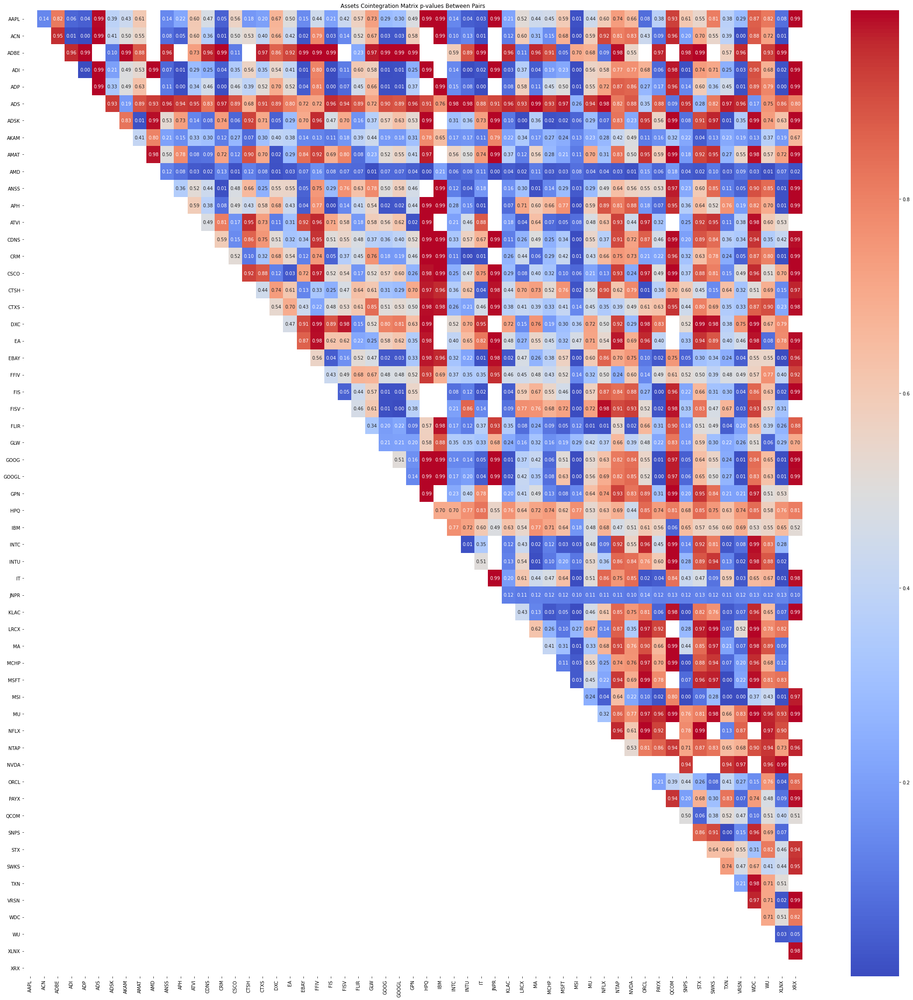

In [46]:
fig, ax = plt.subplots(figsize=(30,30))
sns.heatmap(pvalues, xticklabels = train_close.columns,
                yticklabels = train_close.columns, cmap = 'coolwarm', annot = True, fmt=".2f",
                mask = (pvalues == 1))
ax.set_title('Assets Cointegration Matrix p-values Between Pairs')
plt.tight_layout()
plt.savefig('coint', dpi=300)

In [68]:
def get_pairs(pairs, level):
    result = []
    for pair in pairs:
        if pair[2] < level:
            #if (cointegration_test((pair[0], pair[1])) == True):
            result.append((pair[0], pair[1], pair[3]))
    return result

In [697]:
def print_pairs_plt(pairs, height=270):
    fig, axs = plt.subplots(len(pairs), figsize=(10, height))

    for i in range(len(pairs)):
        ax = axs.flatten()[i]
        data0 = train_close[pairs[i][0]]
        data1 = train_close[pairs[i][1]]

        x = train_close[pairs[i][0]].index.get_level_values('Date')
        x_dates = np.array([x[0], x[int(len(x) / 4)], x[int(len(x) / 2)], x[int(3 * len(x) / 4)], x[len(x) - 1]])
        axs[i].plot(x, data0, label=pairs[i][0])
        axs[i].plot(x, data1, label=pairs[i][1])
        ax.set_xticks(x_dates)
        ax.legend()
        ax.title.set_text("#{}: {} & {}".format(i, pairs[i][0], pairs[i][1]))
    plt.show()

In [599]:
print_pairs_plt(pairs)

KeyboardInterrupt: 

Error in callback <function flush_figures at 0x7f3b6cba0b80> (for post_execute):


KeyboardInterrupt: 

# Cointegration test

In [33]:
def cointegration_test(pair, show=False):
    model = sm.OLS(train_close[pair[0]], train_close[pair[1]]).fit()
    
    #print("----------------- {} & {} -----------------".format(pair[0], pair[1]))
    
    spread = train_close[pair[0]] - model.params[0] * train_close[pair[1]]
    
    #print('Hedge Ratio = ', model.params[0])
    
    adf = adfuller(spread, maxlag = 1)
    #print('Critical Value = ', adf[0])
    #print(adf[4])
    
    is_ok = False
    color = 'b'
    if (adf[0] < adf[4]['1%']):
        is_ok = True
        color = 'g'
    
    if (show):
        ax = spread.plot(color=color, figsize=(12, 6))
        ax.set_ylabel("Spread")
        ax.grid(True)
        plt.show()
    
    return is_ok

-------------------- #0 --------------------
----------------- AAPL & ADP -----------------
Hedge Ratio =  0.3379319851746466
Critical Value =  -2.5104324241203644
{'1%': -3.4325853286163874, '5%': -2.8625276197775373, '10%': -2.5672957374856296}


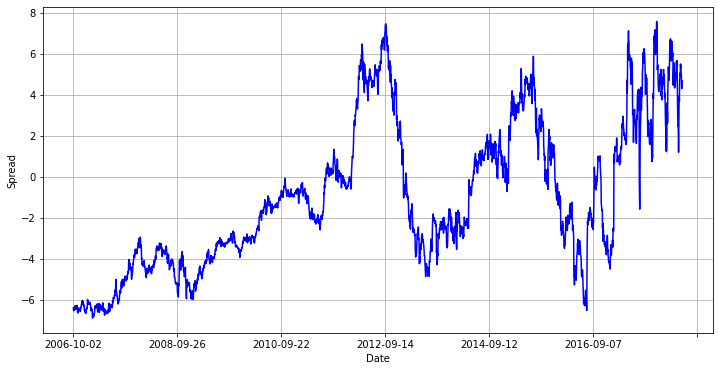

False
-------------------- #1 --------------------
----------------- AAPL & INTU -----------------
Hedge Ratio =  0.2622506155466821
Critical Value =  -3.448779503634264
{'1%': -3.4325853286163874, '5%': -2.8625276197775373, '10%': -2.5672957374856296}


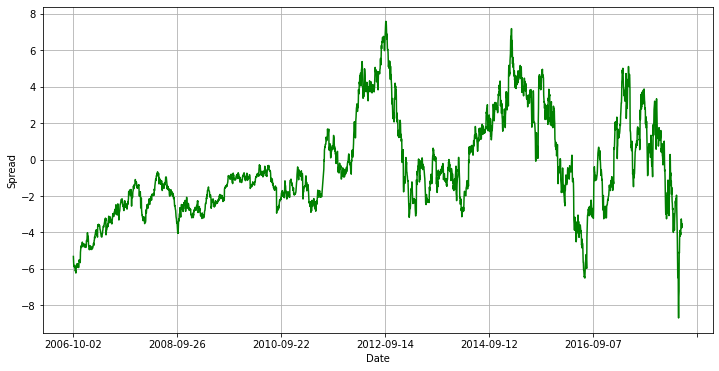

True
-------------------- #2 --------------------
----------------- AAPL & IT -----------------
Hedge Ratio =  0.30056453277186673
Critical Value =  -3.0975378034172887
{'1%': -3.4325853286163874, '5%': -2.8625276197775373, '10%': -2.5672957374856296}


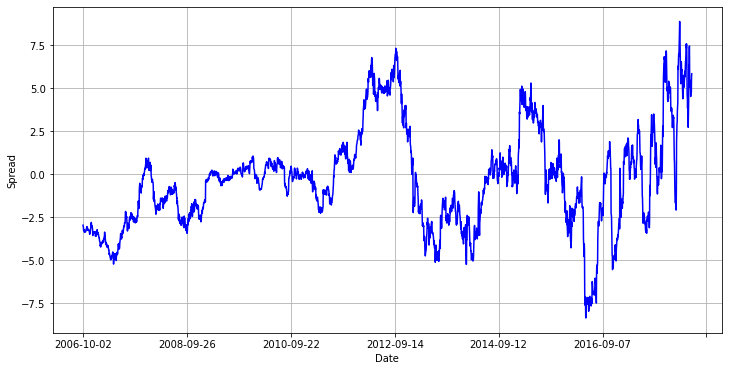

False
-------------------- #3 --------------------
----------------- AAPL & MSI -----------------
Hedge Ratio =  0.34266892023227435
Critical Value =  -3.0882518982265545
{'1%': -3.4325853286163874, '5%': -2.8625276197775373, '10%': -2.5672957374856296}


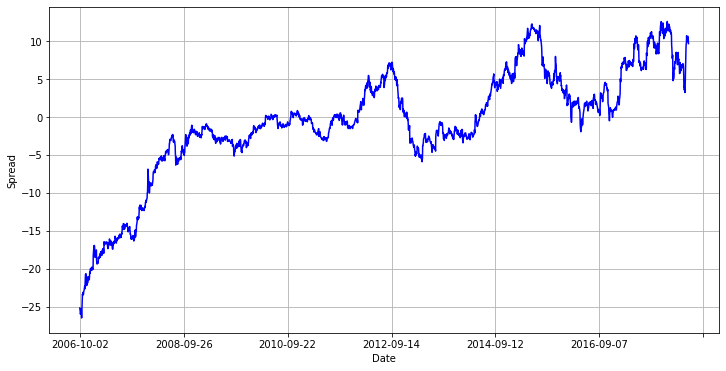

False
-------------------- #4 --------------------
----------------- ACN & ADI -----------------
Hedge Ratio =  1.6524475773082923
Critical Value =  -3.805816463955232
{'1%': -3.4325853286163874, '5%': -2.8625276197775373, '10%': -2.5672957374856296}


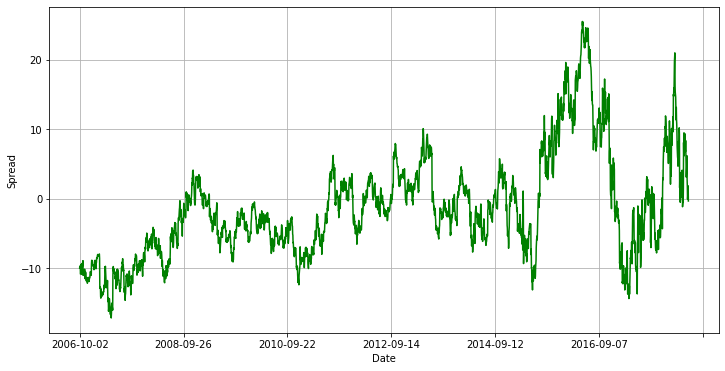

True
-------------------- #5 --------------------
----------------- ACN & ADP -----------------
Hedge Ratio =  1.238268752530516
Critical Value =  -4.136026661257971
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


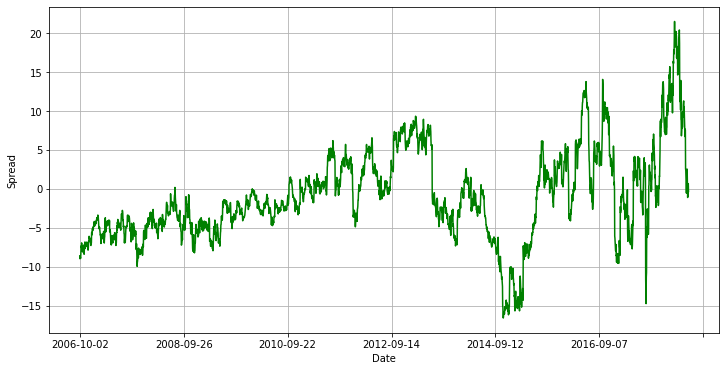

True
-------------------- #6 --------------------
----------------- ACN & APH -----------------
Hedge Ratio =  3.4156013212145924
Critical Value =  -3.774014763369553
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


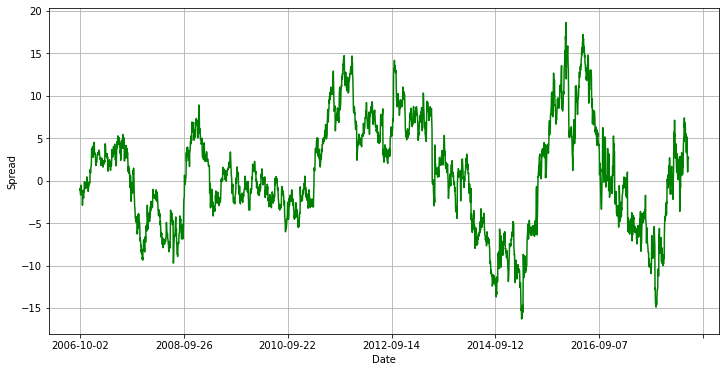

True
-------------------- #7 --------------------
----------------- ACN & CRM -----------------
Hedge Ratio =  1.332721677844493
Critical Value =  -3.4259737226256197
{'1%': -3.4325853286163874, '5%': -2.8625276197775373, '10%': -2.5672957374856296}


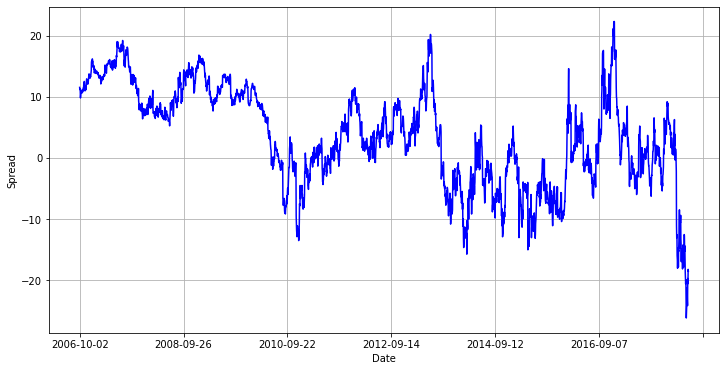

False
-------------------- #8 --------------------
----------------- ACN & EBAY -----------------
Hedge Ratio =  3.425962481478844
Critical Value =  -2.962162034794541
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


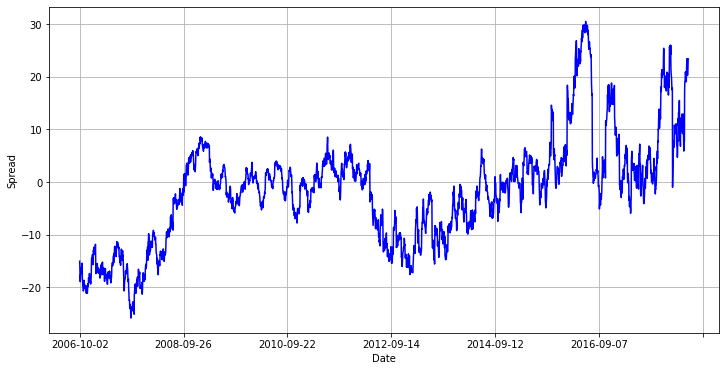

False
-------------------- #9 --------------------
----------------- ACN & FIS -----------------
Hedge Ratio =  1.5063636312135946
Critical Value =  -3.587894205046085
{'1%': -3.4325853286163874, '5%': -2.8625276197775373, '10%': -2.5672957374856296}


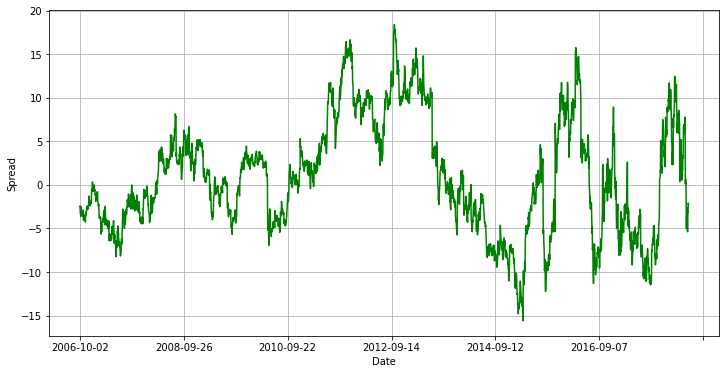

True
-------------------- #10 --------------------
----------------- ACN & GOOG -----------------
Hedge Ratio =  0.13620403552894642
Critical Value =  -3.921166900600707
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


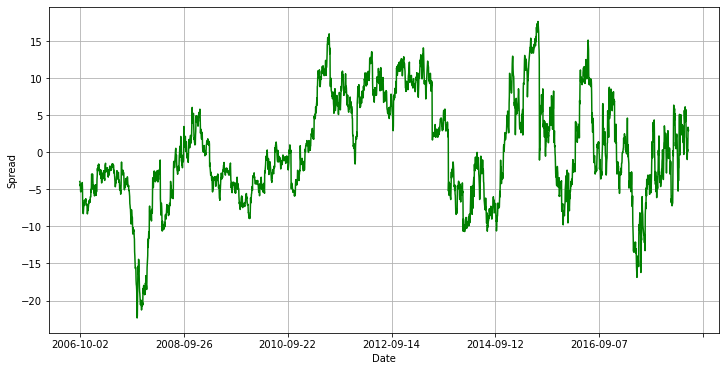

True
-------------------- #11 --------------------
----------------- ACN & GOOGL -----------------
Hedge Ratio =  0.1340035339296134
Critical Value =  -3.8853017597676907
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


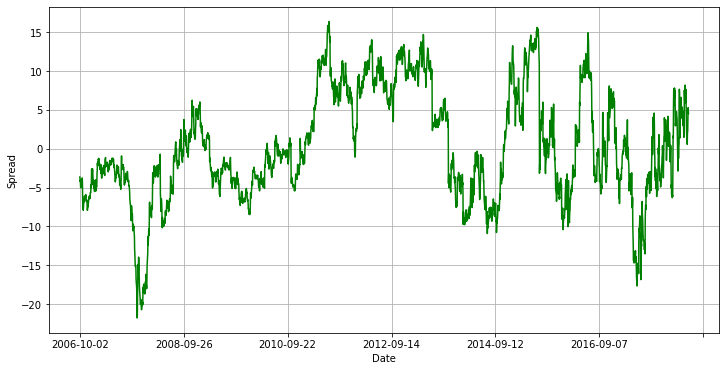

True
-------------------- #12 --------------------
----------------- ACN & IT -----------------
Hedge Ratio =  1.0915527448524376
Critical Value =  -3.7779349530148245
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


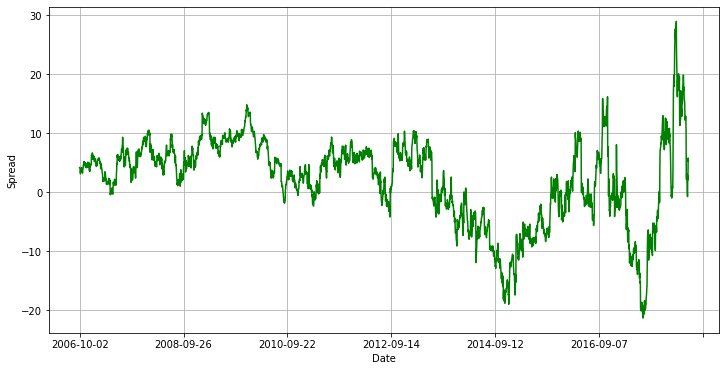

True
-------------------- #13 --------------------
----------------- ACN & MSI -----------------
Hedge Ratio =  1.2816530720737234
Critical Value =  -4.02103349477035
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


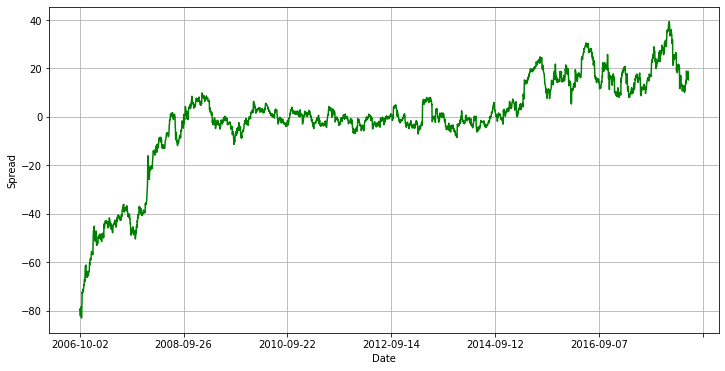

True
-------------------- #14 --------------------
----------------- ACN & VRSN -----------------
Hedge Ratio =  1.2661211188230064
Critical Value =  -4.3623772518934345
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


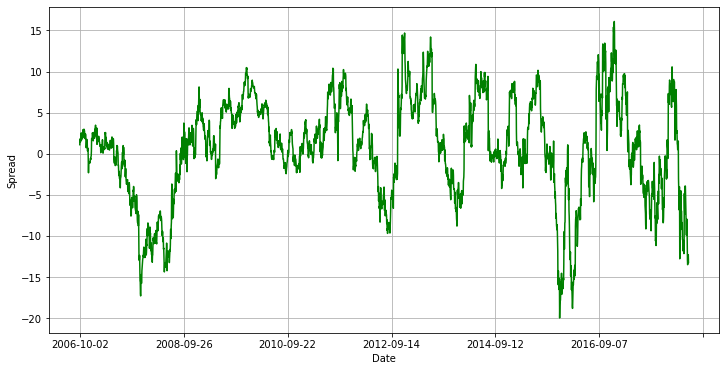

True
-------------------- #15 --------------------
----------------- ACN & XLNX -----------------
Hedge Ratio =  1.9837369001678737
Critical Value =  -3.20426580952763
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


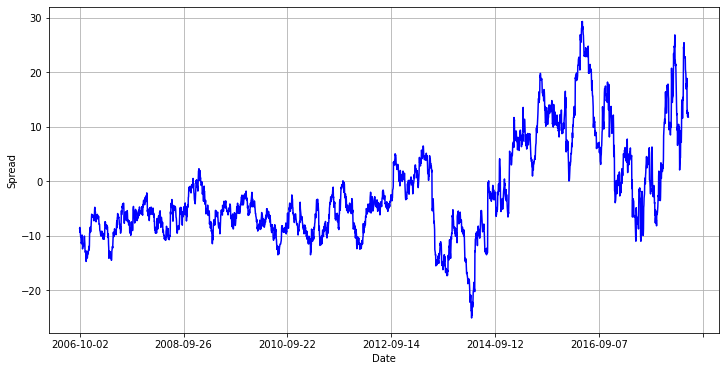

False
-------------------- #16 --------------------
----------------- ADI & ADP -----------------
Hedge Ratio =  0.7448426739789865
Critical Value =  -4.332931906970251
{'1%': -3.4325853286163874, '5%': -2.8625276197775373, '10%': -2.5672957374856296}


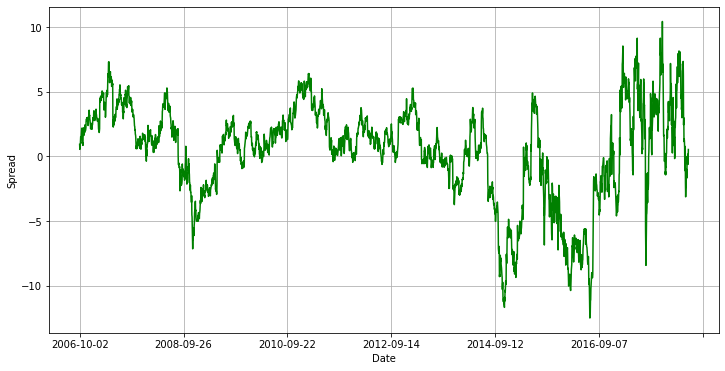

True
-------------------- #17 --------------------
----------------- ADI & APH -----------------
Hedge Ratio =  2.053203688433667
Critical Value =  -3.6725594681046445
{'1%': -3.4325853286163874, '5%': -2.8625276197775373, '10%': -2.5672957374856296}


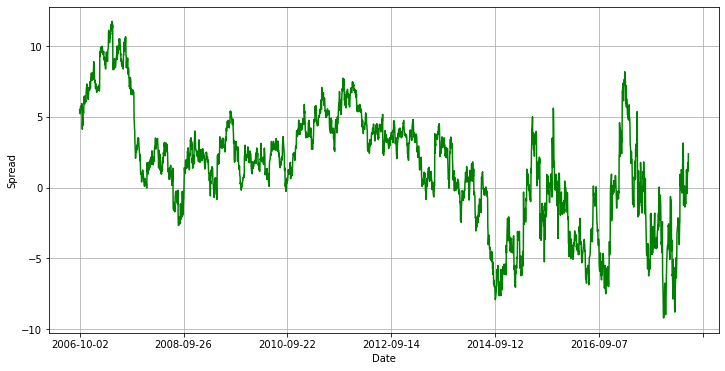

True
-------------------- #18 --------------------
----------------- ADI & CRM -----------------
Hedge Ratio =  0.7945816510453594
Critical Value =  -2.672821474146078
{'1%': -3.4325853286163874, '5%': -2.8625276197775373, '10%': -2.5672957374856296}


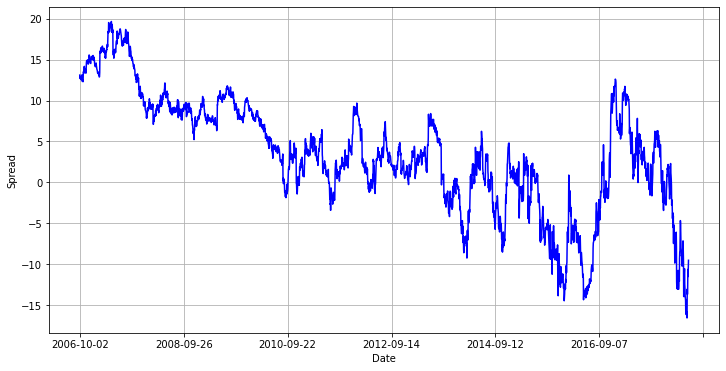

False
-------------------- #19 --------------------
----------------- ADI & EBAY -----------------
Hedge Ratio =  2.0700917229189124
Critical Value =  -4.000861744522588
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


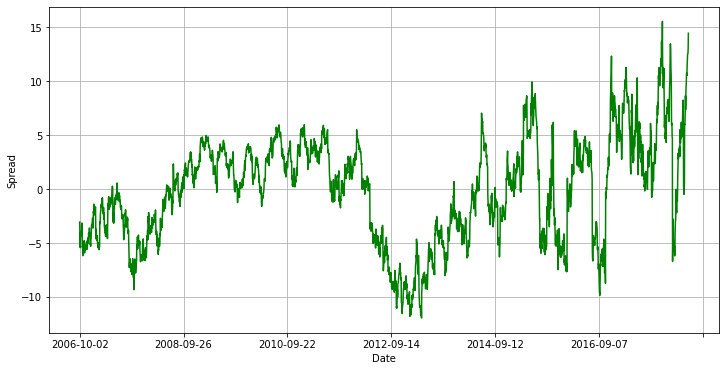

True
-------------------- #20 --------------------
----------------- ADI & FIS -----------------
Hedge Ratio =  0.9043775761329873
Critical Value =  -3.6829734280837494
{'1%': -3.4325853286163874, '5%': -2.8625276197775373, '10%': -2.5672957374856296}


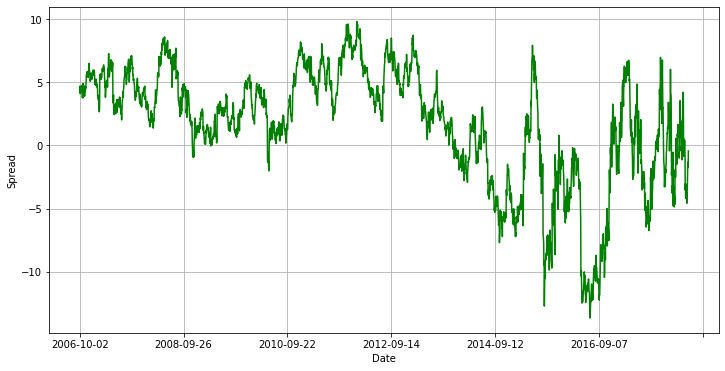

True
-------------------- #21 --------------------
----------------- ADI & GOOG -----------------
Hedge Ratio =  0.08179923855023392
Critical Value =  -3.9043608033601997
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


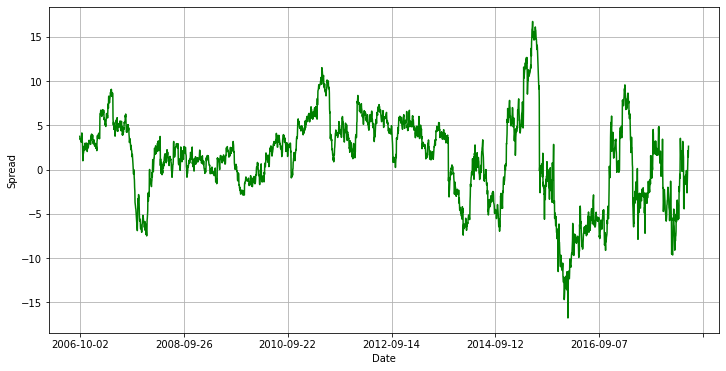

True
-------------------- #22 --------------------
----------------- ADI & GOOGL -----------------
Hedge Ratio =  0.08045012740177236
Critical Value =  -3.807988500835652
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


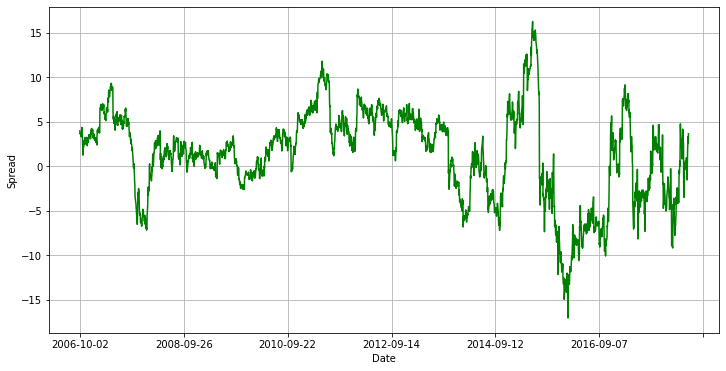

True
-------------------- #23 --------------------
----------------- ADI & INTU -----------------
Hedge Ratio =  0.5712112343433051
Critical Value =  -2.4794512525875816
{'1%': -3.4325853286163874, '5%': -2.8625276197775373, '10%': -2.5672957374856296}


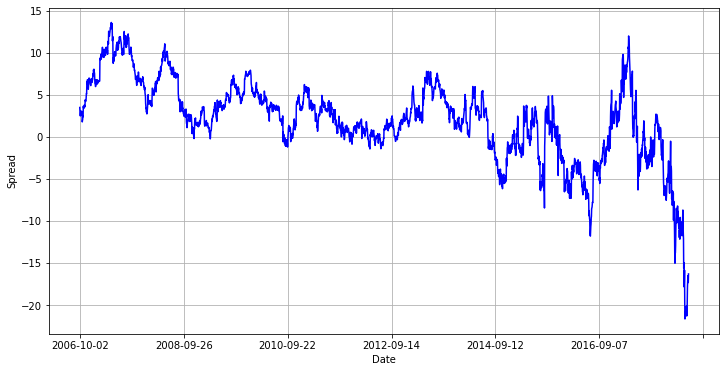

False
-------------------- #24 --------------------
----------------- ADI & IT -----------------
Hedge Ratio =  0.6532689415206709
Critical Value =  -3.2667834295944687
{'1%': -3.4325853286163874, '5%': -2.8625276197775373, '10%': -2.5672957374856296}


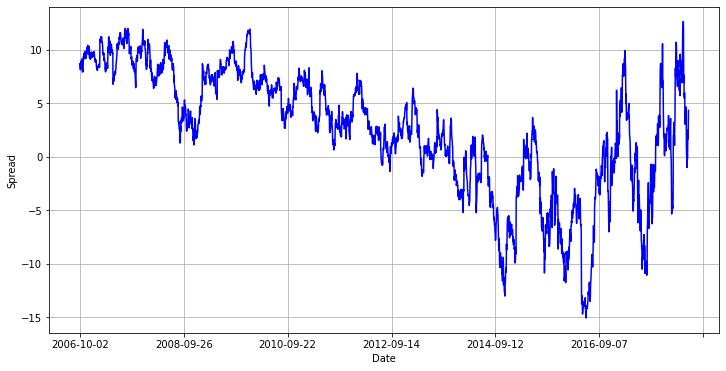

False
-------------------- #25 --------------------
----------------- ADI & KLAC -----------------
Hedge Ratio =  0.8940872057619439
Critical Value =  -3.233430823066493
{'1%': -3.4325853286163874, '5%': -2.8625276197775373, '10%': -2.5672957374856296}


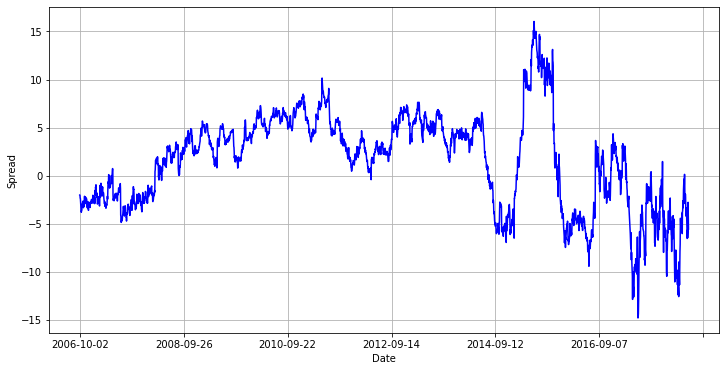

False
-------------------- #26 --------------------
----------------- ADI & MA -----------------
Hedge Ratio =  0.6020396542743688
Critical Value =  -0.7524428634932855
{'1%': -3.4325853286163874, '5%': -2.8625276197775373, '10%': -2.5672957374856296}


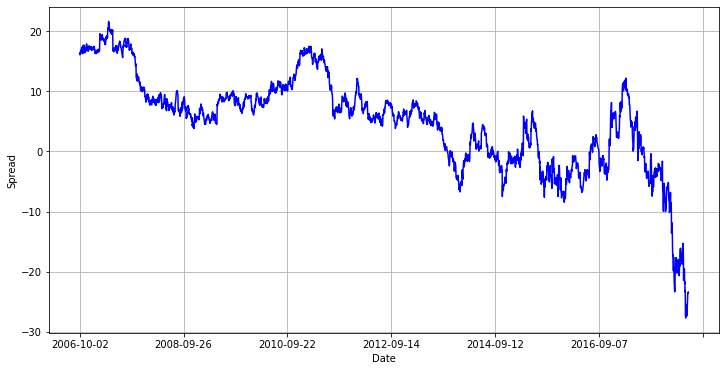

False
-------------------- #27 --------------------
----------------- ADI & MSI -----------------
Hedge Ratio =  0.7813152858627809
Critical Value =  -4.251019807084777
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


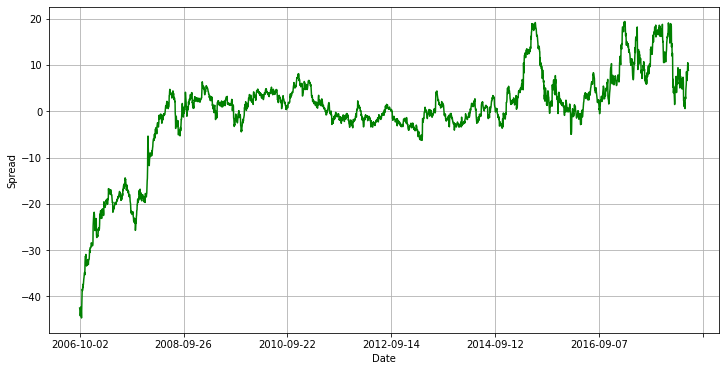

True
-------------------- #28 --------------------
----------------- ADI & SNPS -----------------
Hedge Ratio =  1.0192520163213785
Critical Value =  -4.657448962661857
{'1%': -3.4325853286163874, '5%': -2.8625276197775373, '10%': -2.5672957374856296}


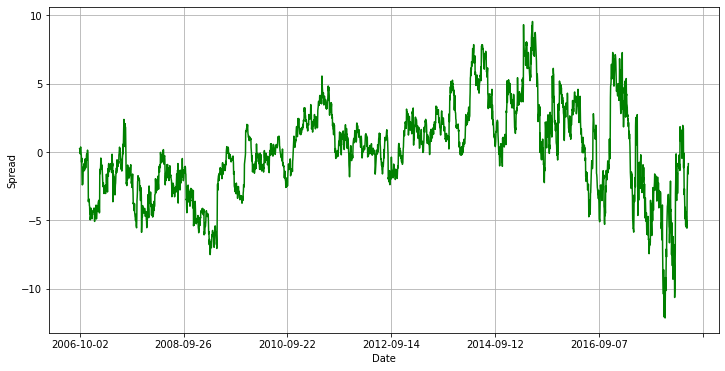

True
-------------------- #29 --------------------
----------------- ADI & VRSN -----------------
Hedge Ratio =  0.7576846187060609
Critical Value =  -3.28713793622979
{'1%': -3.4325853286163874, '5%': -2.8625276197775373, '10%': -2.5672957374856296}


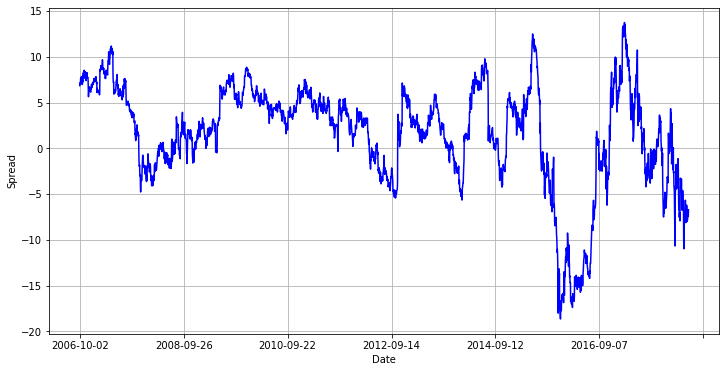

False
-------------------- #30 --------------------
----------------- ADI & XLNX -----------------
Hedge Ratio =  1.199241855391058
Critical Value =  -3.523504936077628
{'1%': -3.4325853286163874, '5%': -2.8625276197775373, '10%': -2.5672957374856296}


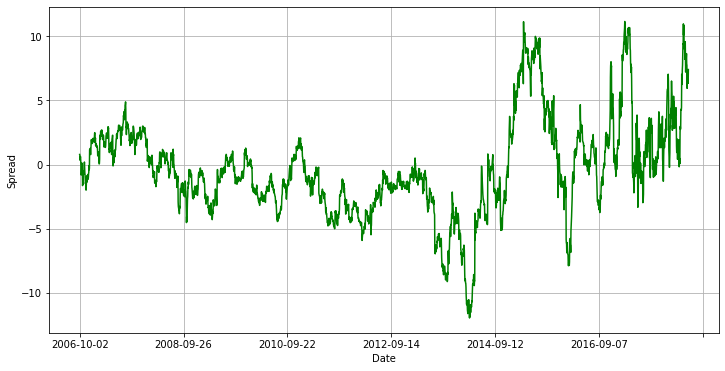

True
-------------------- #31 --------------------
----------------- ADP & APH -----------------
Hedge Ratio =  2.7498716410737445
Critical Value =  -4.128759326360732
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


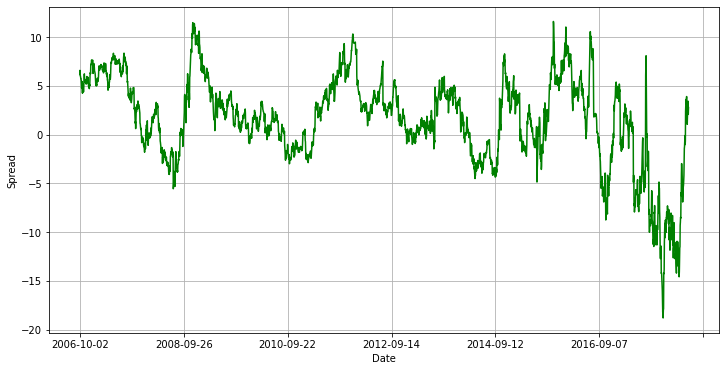

True
-------------------- #32 --------------------
----------------- ADP & CRM -----------------
Hedge Ratio =  1.0670859248653004
Critical Value =  -3.082959115596037
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


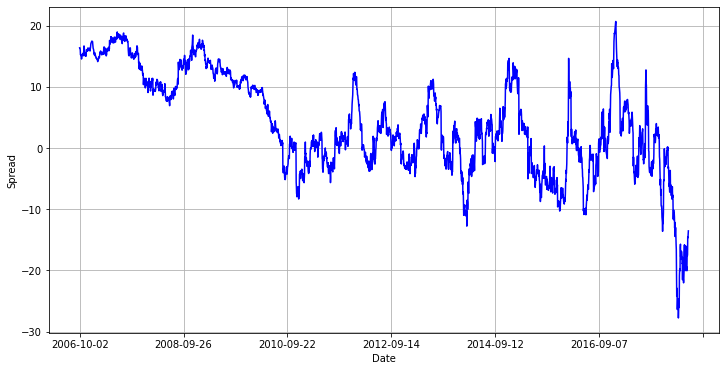

False
-------------------- #33 --------------------
----------------- ADP & EBAY -----------------
Hedge Ratio =  2.761023295364009
Critical Value =  -3.0839716294881554
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


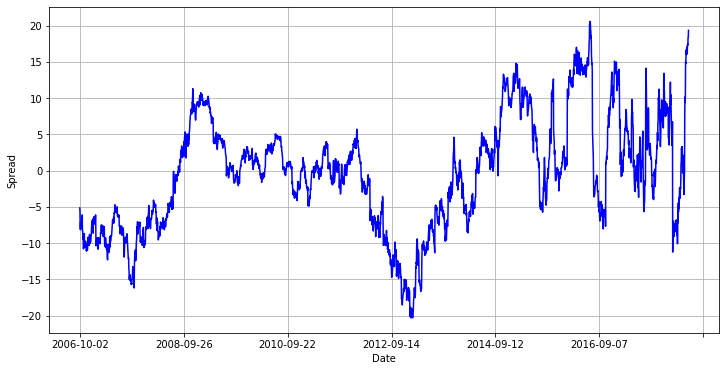

False
-------------------- #34 --------------------
----------------- ADP & FIS -----------------
Hedge Ratio =  1.2134578008829602
Critical Value =  -4.0259969237243345
{'1%': -3.4325853286163874, '5%': -2.8625276197775373, '10%': -2.5672957374856296}


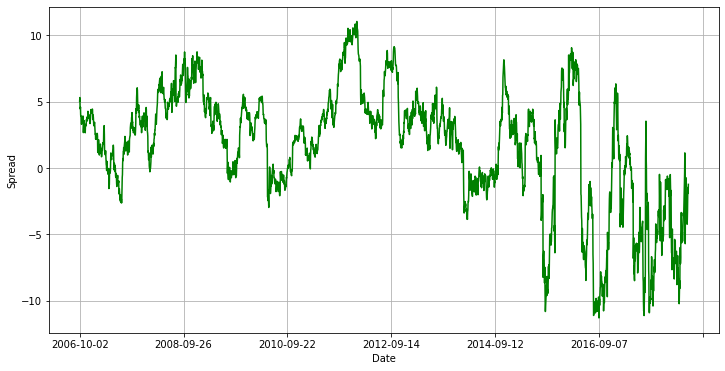

True
-------------------- #35 --------------------
----------------- ADP & GOOG -----------------
Hedge Ratio =  0.109558882801597
Critical Value =  -3.9689477295750106
{'1%': -3.4325853286163874, '5%': -2.8625276197775373, '10%': -2.5672957374856296}


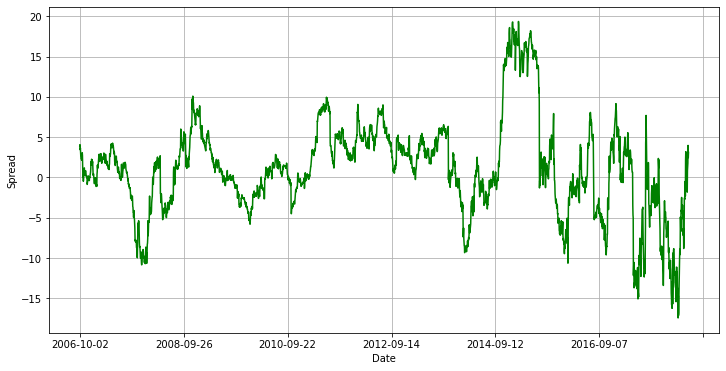

True
-------------------- #36 --------------------
----------------- ADP & GOOGL -----------------
Hedge Ratio =  0.10778931293680917
Critical Value =  -3.9962633889161405
{'1%': -3.4325853286163874, '5%': -2.8625276197775373, '10%': -2.5672957374856296}


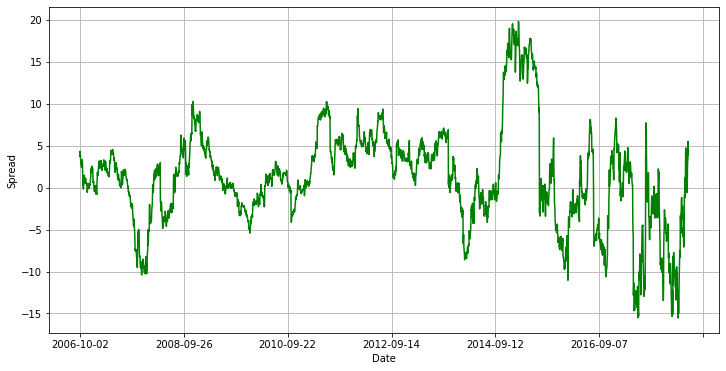

True
-------------------- #37 --------------------
----------------- ADP & IT -----------------
Hedge Ratio =  0.8781722236545945
Critical Value =  -3.966400003675746
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


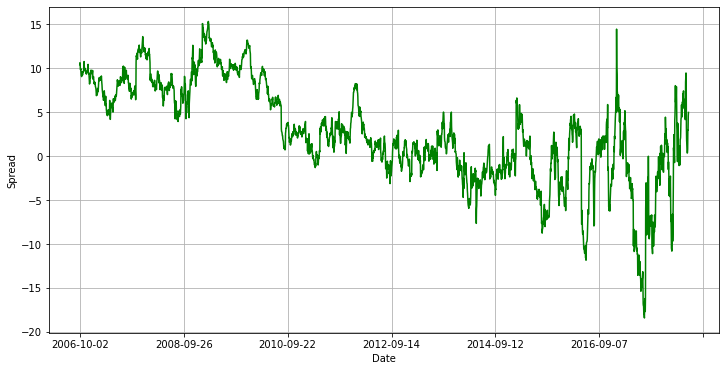

True
-------------------- #38 --------------------
----------------- ADP & MSI -----------------
Hedge Ratio =  1.0391635428605968
Critical Value =  -3.9556750965005123
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


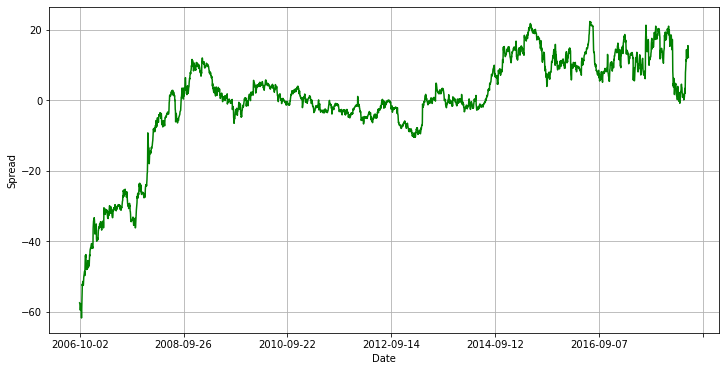

True
-------------------- #39 --------------------
----------------- ADP & VRSN -----------------
Hedge Ratio =  1.0166840302865452
Critical Value =  -3.5372265939168543
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


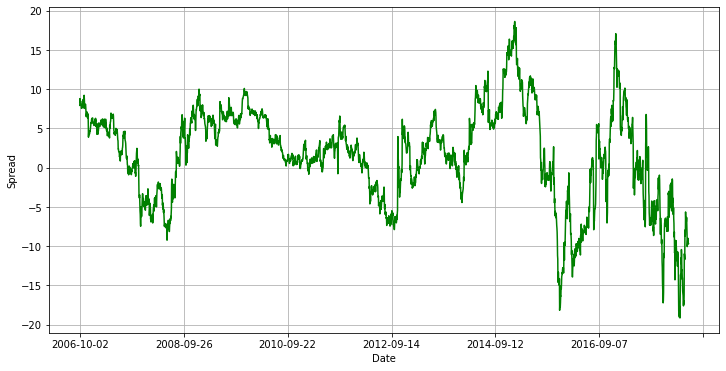

True
-------------------- #40 --------------------
----------------- ADP & XLNX -----------------
Hedge Ratio =  1.5993231985286418
Critical Value =  -3.4621517743960704
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


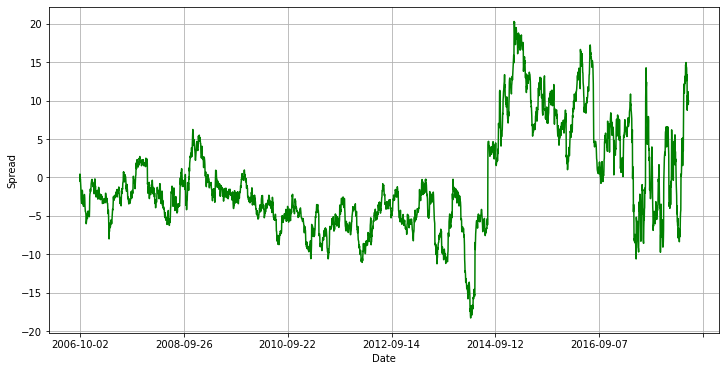

True
-------------------- #41 --------------------
----------------- ADSK & AMAT -----------------
Hedge Ratio =  2.597551796901429
Critical Value =  -4.184124263802856
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


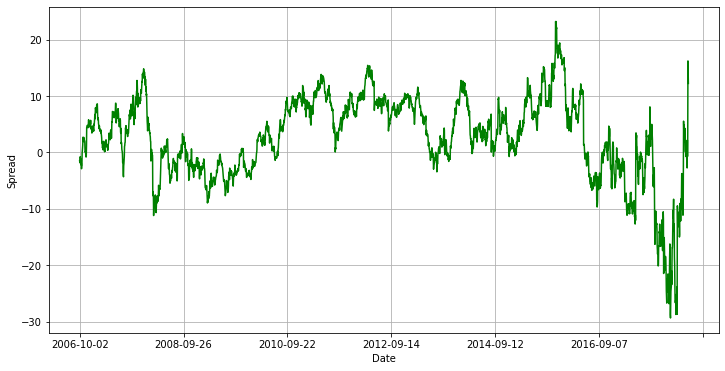

True
-------------------- #42 --------------------
----------------- ADSK & LRCX -----------------
Hedge Ratio =  0.7572541181373468
Critical Value =  -3.7450419425087316
{'1%': -3.4325853286163874, '5%': -2.8625276197775373, '10%': -2.5672957374856296}


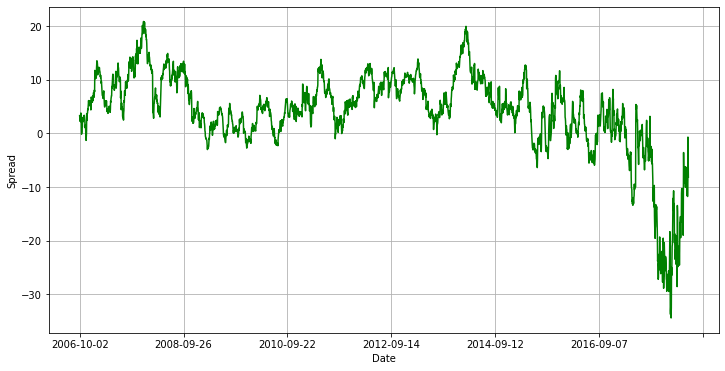

True
-------------------- #43 --------------------
----------------- ADSK & MCHP -----------------
Hedge Ratio =  1.35690597237646
Critical Value =  -3.9699594483079044
{'1%': -3.4325853286163874, '5%': -2.8625276197775373, '10%': -2.5672957374856296}


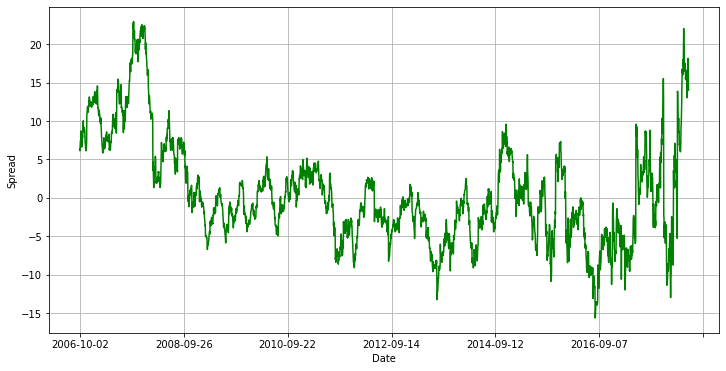

True
-------------------- #44 --------------------
----------------- ADSK & MSFT -----------------
Hedge Ratio =  1.4254841843942796
Critical Value =  -3.7277974780318544
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


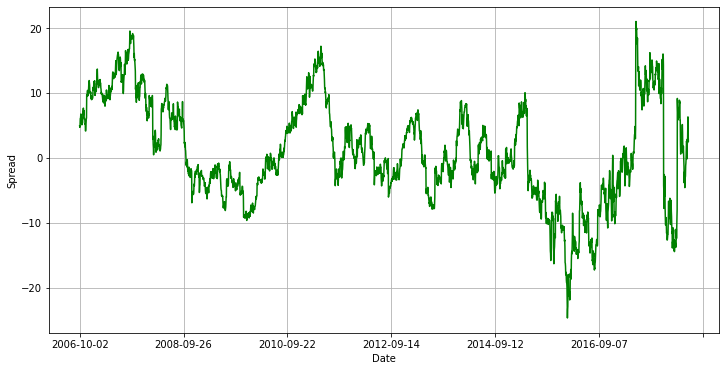

True
-------------------- #45 --------------------
----------------- ADSK & TXN -----------------
Hedge Ratio =  1.3088741303385993
Critical Value =  -3.7706378546100425
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


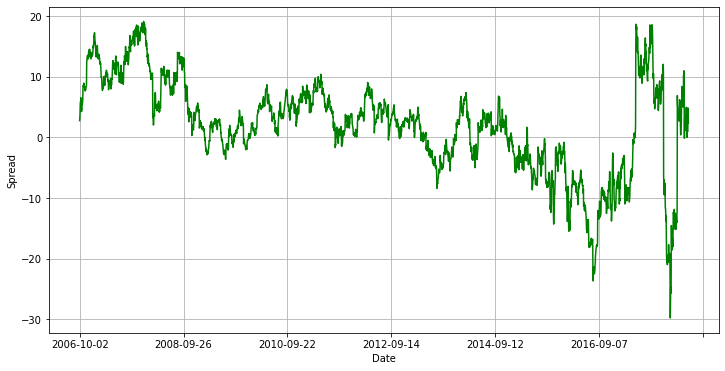

True
-------------------- #46 --------------------
----------------- AKAM & STX -----------------
Hedge Ratio =  1.8194193802916159
Critical Value =  -2.5990934103933987
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


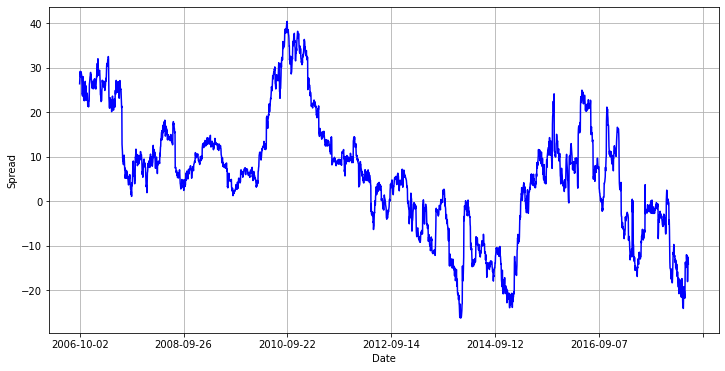

False
-------------------- #47 --------------------
----------------- AMAT & DXC -----------------
Hedge Ratio =  0.6827512584629019
Critical Value =  -3.0270180096089687
{'1%': -3.4325853286163874, '5%': -2.8625276197775373, '10%': -2.5672957374856296}


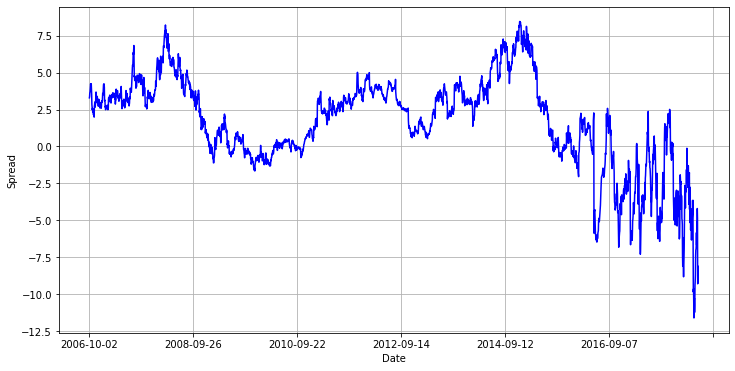

False
-------------------- #48 --------------------
----------------- AMD & ATVI -----------------
Hedge Ratio =  0.22383221566689124
Critical Value =  -4.022058587552398
{'1%': -3.4325853286163874, '5%': -2.8625276197775373, '10%': -2.5672957374856296}


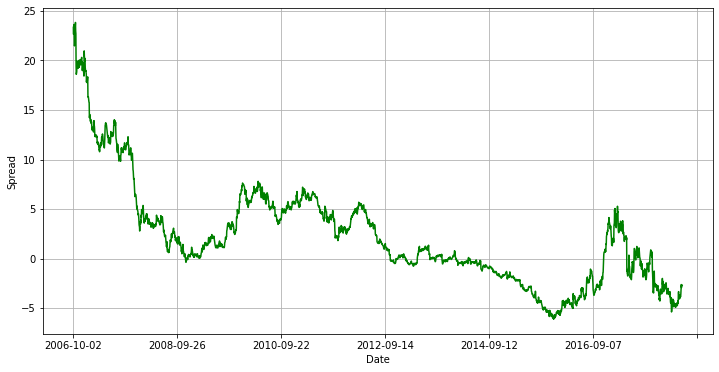

True
-------------------- #49 --------------------
----------------- AMD & CDNS -----------------
Hedge Ratio =  0.36012835647025704
Critical Value =  -4.203525186312457
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


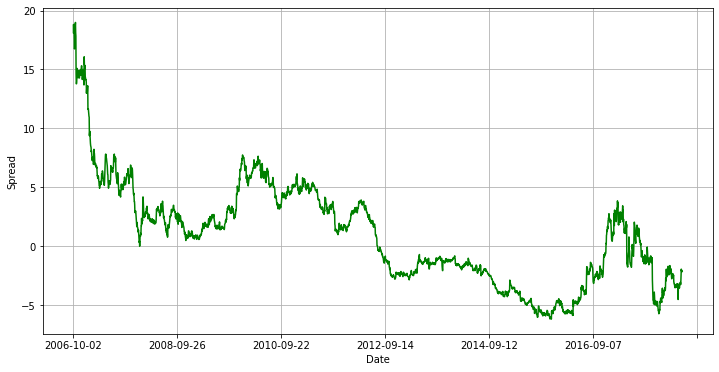

True
-------------------- #50 --------------------
----------------- AMD & CSCO -----------------
Hedge Ratio =  0.34085715533151617
Critical Value =  -4.78717647851117
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


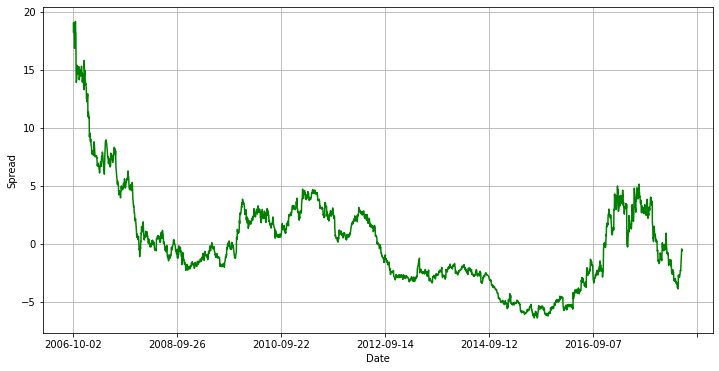

True
-------------------- #51 --------------------
----------------- AMD & DXC -----------------
Hedge Ratio =  0.21104719053169657
Critical Value =  -4.123234219017316
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


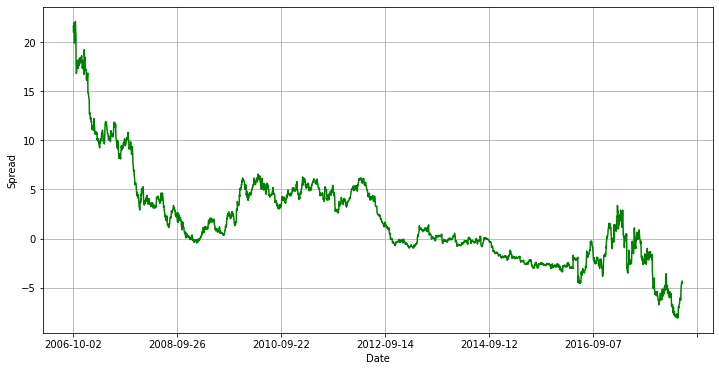

True
-------------------- #52 --------------------
----------------- AMD & EA -----------------
Hedge Ratio =  0.1231395182362991
Critical Value =  -3.638600526700096
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


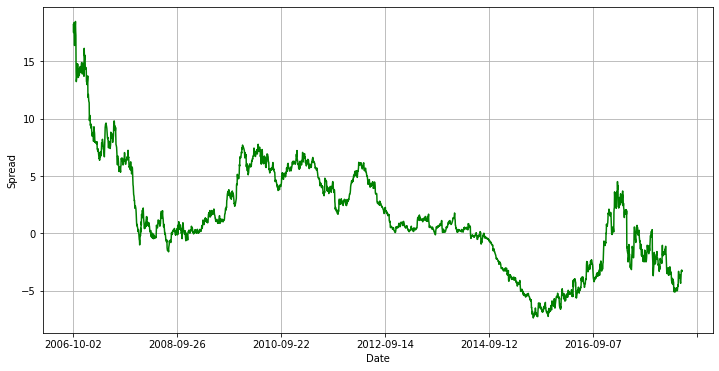

True
-------------------- #53 --------------------
----------------- AMD & GLW -----------------
Hedge Ratio =  0.42664068259889404
Critical Value =  -4.537824096961335
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


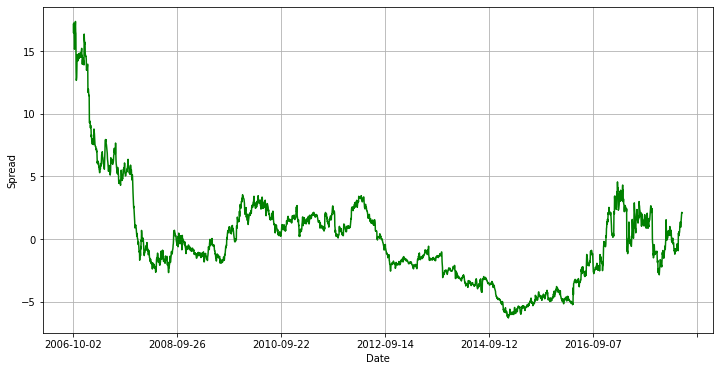

True
-------------------- #54 --------------------
----------------- AMD & GPN -----------------
Hedge Ratio =  0.13171500165788927
Critical Value =  -4.155334398021174
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


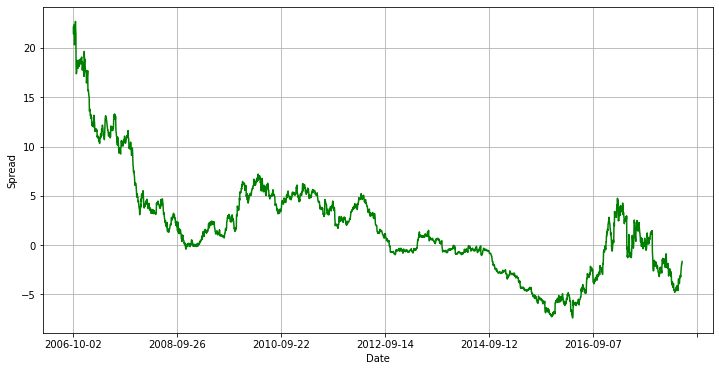

True
-------------------- #55 --------------------
----------------- AMD & HPQ -----------------
Hedge Ratio =  0.5417386227477062
Critical Value =  -5.016660729801063
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


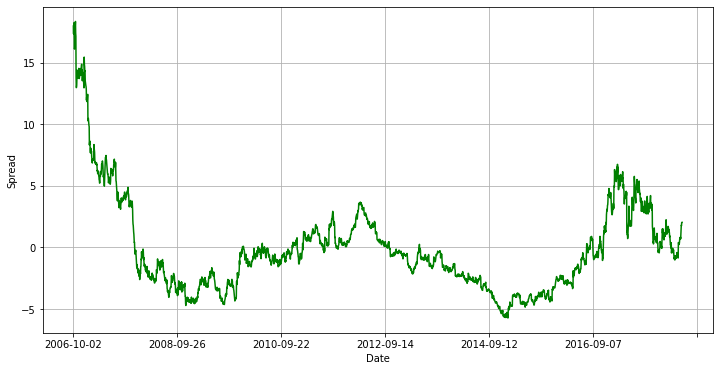

True
-------------------- #56 --------------------
----------------- AMD & JNPR -----------------
Hedge Ratio =  0.31906167467825897
Critical Value =  -4.803545556478384
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


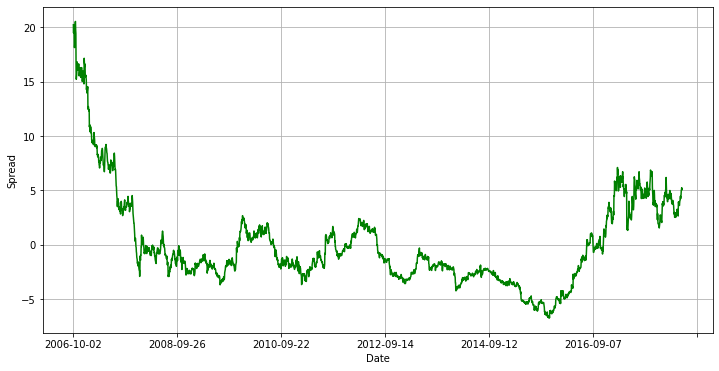

True
-------------------- #57 --------------------
----------------- AMD & KLAC -----------------
Hedge Ratio =  0.1348554454102446
Critical Value =  -4.404513843178614
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


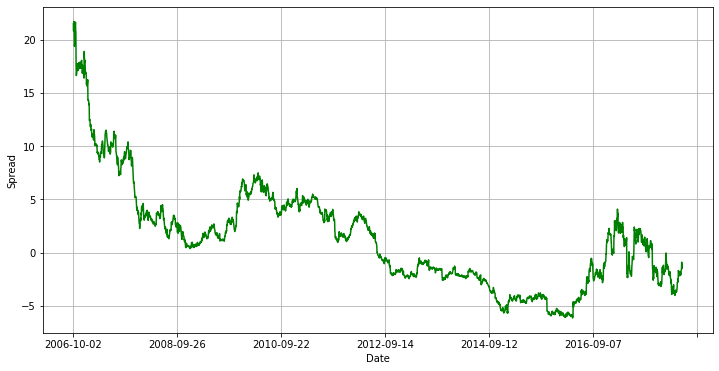

True
-------------------- #58 --------------------
----------------- AMD & LRCX -----------------
Hedge Ratio =  0.0910526112019993
Critical Value =  -4.209665048621421
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


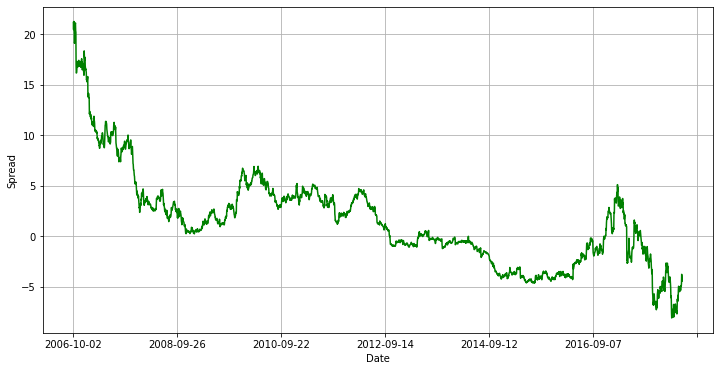

True
-------------------- #59 --------------------
----------------- AMD & MCHP -----------------
Hedge Ratio =  0.16245345758570084
Critical Value =  -4.625448601196594
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


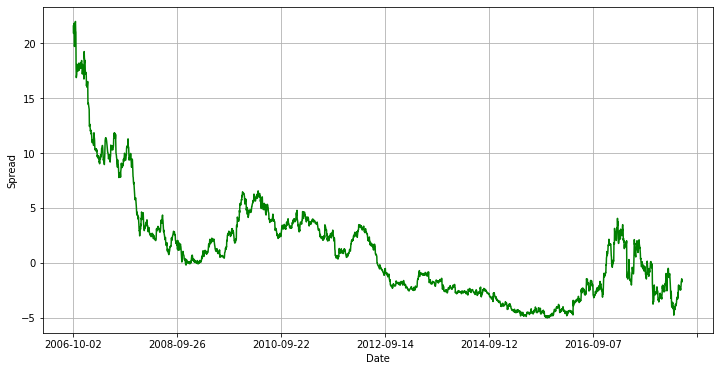

True
-------------------- #60 --------------------
----------------- AMD & MSFT -----------------
Hedge Ratio =  0.16893378616369503
Critical Value =  -4.337575429732477
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


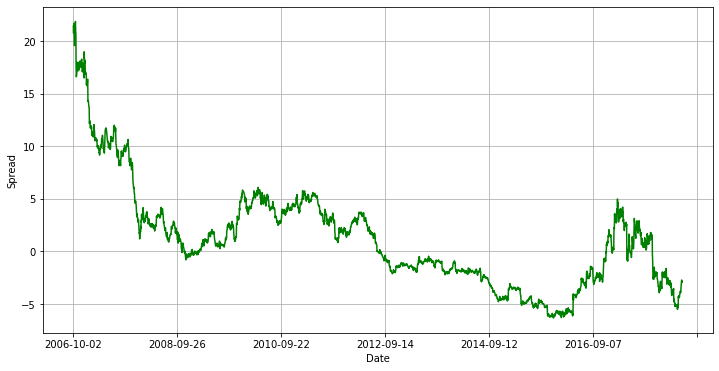

True
-------------------- #61 --------------------
----------------- AMD & MU -----------------
Hedge Ratio =  0.31831196785561955
Critical Value =  -2.8768175455898706
{'1%': -3.4325853286163874, '5%': -2.8625276197775373, '10%': -2.5672957374856296}


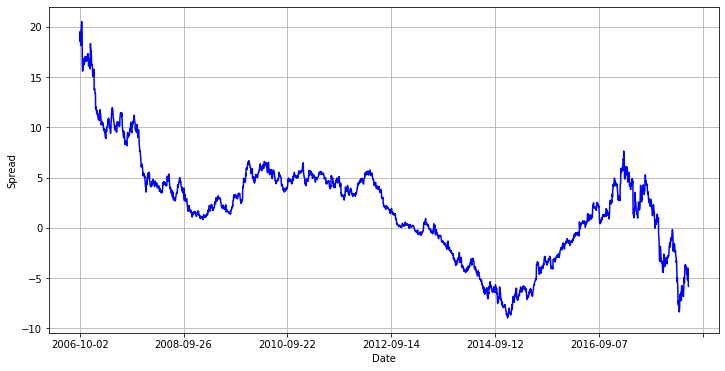

False
-------------------- #62 --------------------
----------------- AMD & NFLX -----------------
Hedge Ratio =  0.057303585640096306
Critical Value =  -3.5241520293734707
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


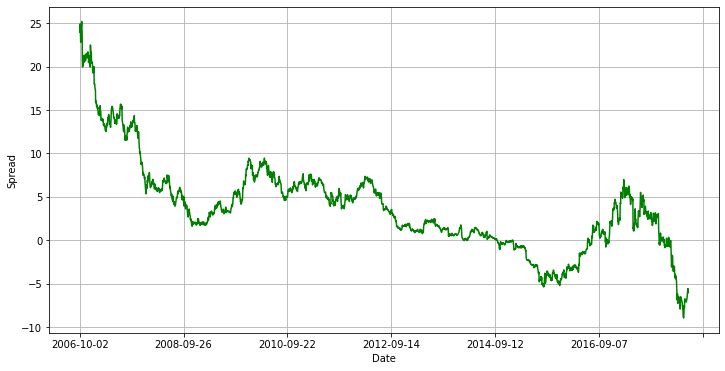

True
-------------------- #63 --------------------
----------------- AMD & NTAP -----------------
Hedge Ratio =  0.22423047250637018
Critical Value =  -4.390729871250501
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


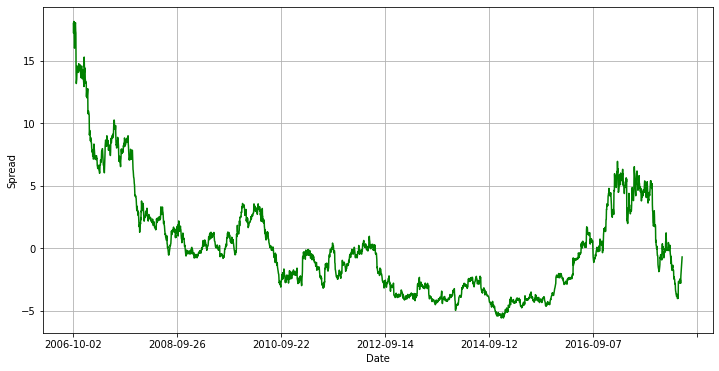

True
-------------------- #64 --------------------
----------------- AMD & NVDA -----------------
Hedge Ratio =  0.08387920640284312
Critical Value =  -3.4649193617176826
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


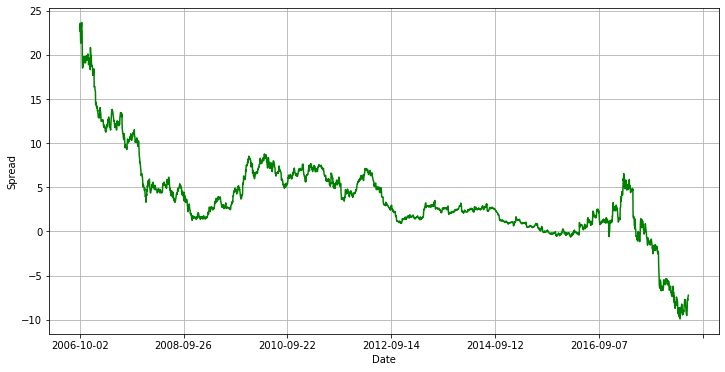

True
-------------------- #65 --------------------
----------------- AMD & SNPS -----------------
Hedge Ratio =  0.15575794935216486
Critical Value =  -4.694506457641923
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


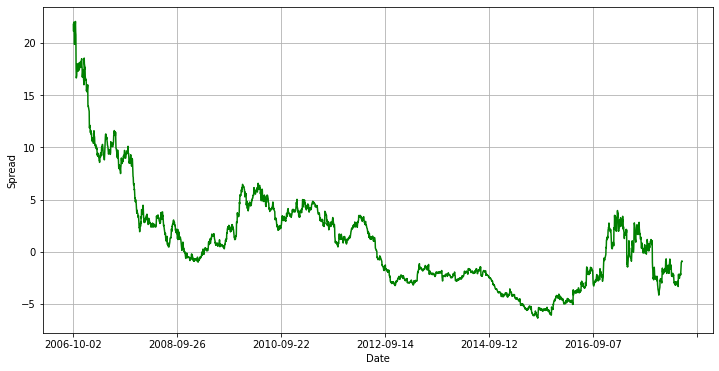

True
-------------------- #66 --------------------
----------------- AMD & STX -----------------
Hedge Ratio =  0.23303092125745642
Critical Value =  -3.767198882381202
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


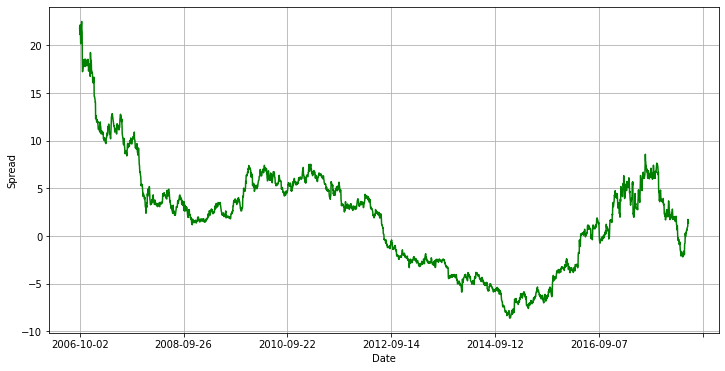

True
-------------------- #67 --------------------
----------------- AMD & TXN -----------------
Hedge Ratio =  0.15363524740429102
Critical Value =  -4.218302800405519
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


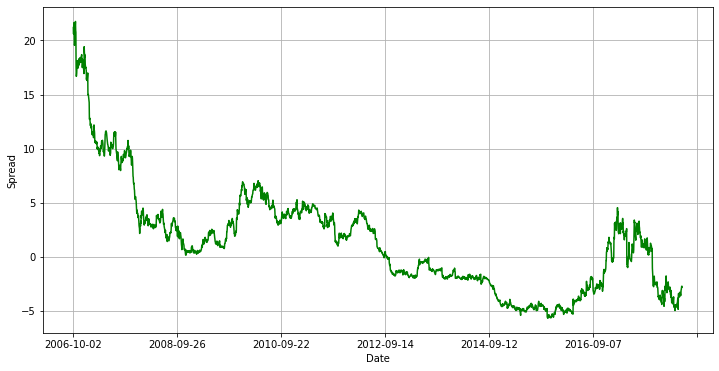

True
-------------------- #68 --------------------
----------------- AMD & WDC -----------------
Hedge Ratio =  0.11754920976443058
Critical Value =  -4.148494830247912
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


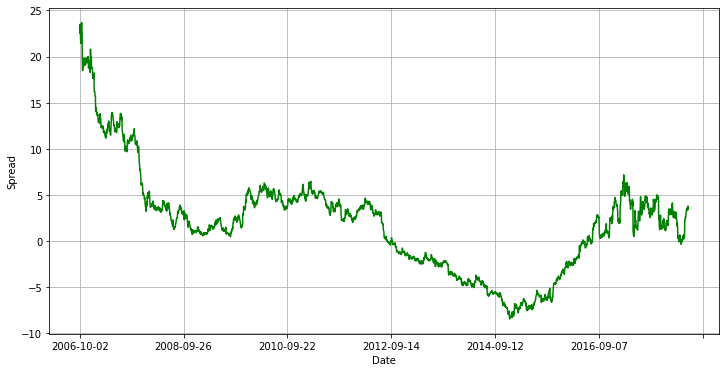

True
-------------------- #69 --------------------
----------------- AMD & WU -----------------
Hedge Ratio =  0.49186467078066887
Critical Value =  -4.372859453615629
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


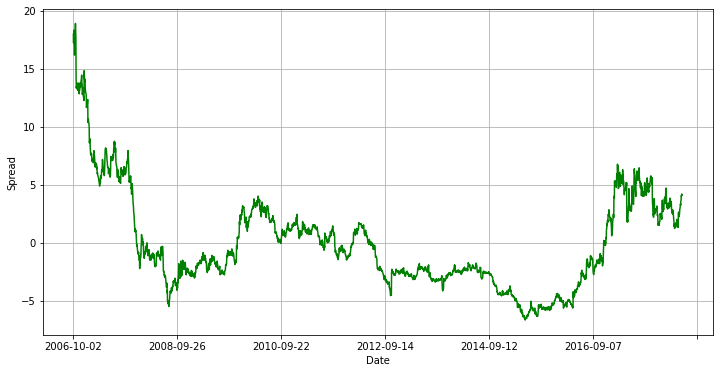

True
-------------------- #70 --------------------
----------------- AMD & XRX -----------------
Hedge Ratio =  0.32305512533838393
Critical Value =  -4.021813551503391
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


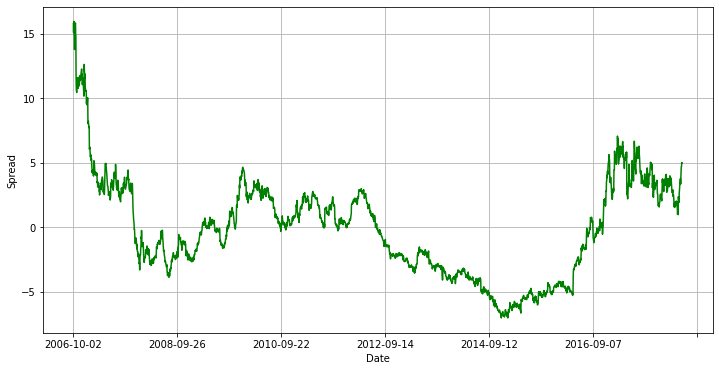

True
-------------------- #71 --------------------
----------------- ANSS & CRM -----------------
Hedge Ratio =  1.3935824301579005
Critical Value =  -2.654358129190752
{'1%': -3.4325853286163874, '5%': -2.8625276197775373, '10%': -2.5672957374856296}


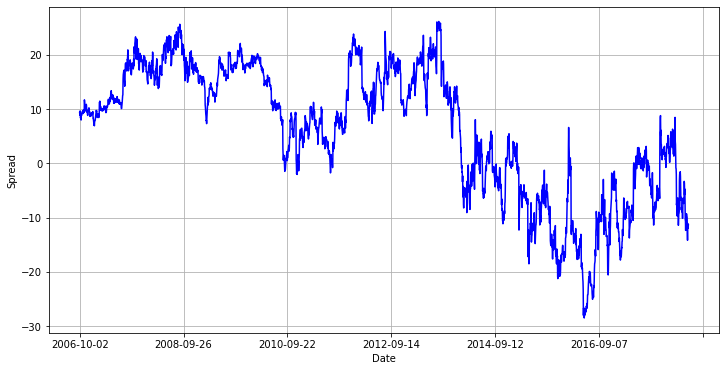

False
-------------------- #72 --------------------
----------------- ANSS & INTU -----------------
Hedge Ratio =  0.9976531354330955
Critical Value =  -2.176407190849917
{'1%': -3.4325853286163874, '5%': -2.8625276197775373, '10%': -2.5672957374856296}


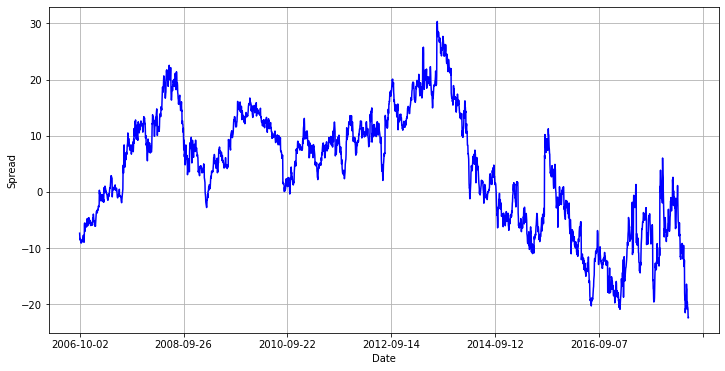

False
-------------------- #73 --------------------
----------------- ANSS & MA -----------------
Hedge Ratio =  1.054723883728434
Critical Value =  -0.7437246674105558
{'1%': -3.4325853286163874, '5%': -2.8625276197775373, '10%': -2.5672957374856296}


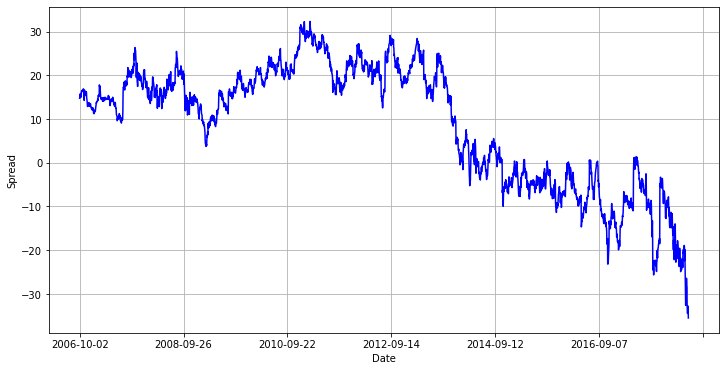

False
-------------------- #74 --------------------
----------------- ANSS & MSI -----------------
Hedge Ratio =  1.3518294903005765
Critical Value =  -4.178222740187084
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


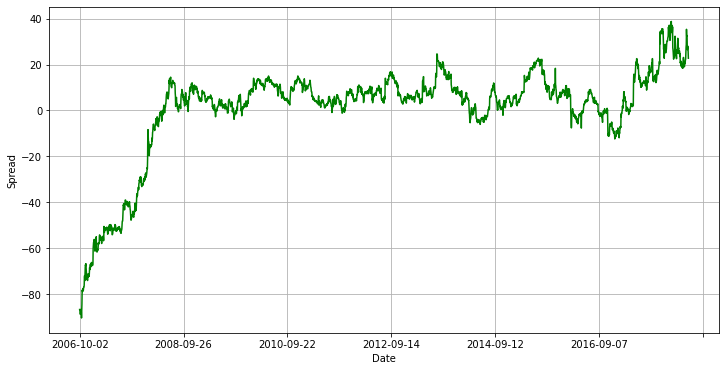

True
-------------------- #75 --------------------
----------------- ANSS & XLNX -----------------
Hedge Ratio =  2.0960918405996205
Critical Value =  -3.7137090485519426
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


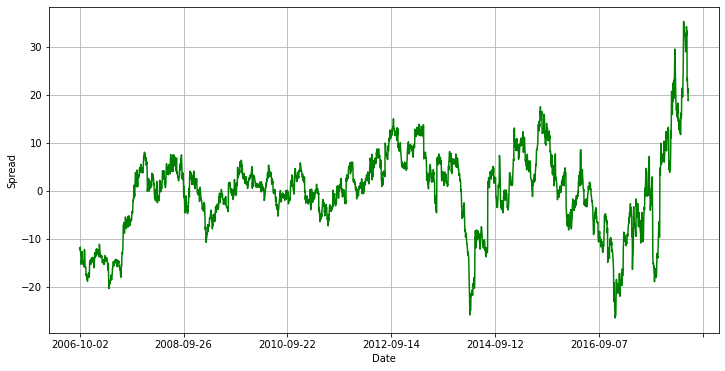

True
-------------------- #76 --------------------
----------------- APH & EBAY -----------------
Hedge Ratio =  0.9972172058042114
Critical Value =  -2.6472899253845603
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


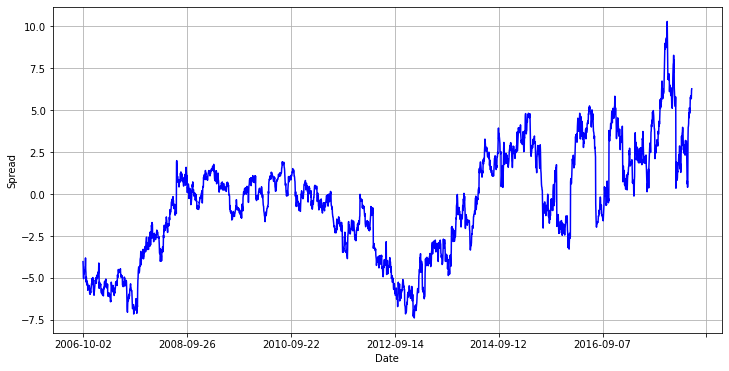

False
-------------------- #77 --------------------
----------------- APH & FIS -----------------
Hedge Ratio =  0.44004646546071335
Critical Value =  -4.579981037035336
{'1%': -3.4325853286163874, '5%': -2.8625276197775373, '10%': -2.5672957374856296}


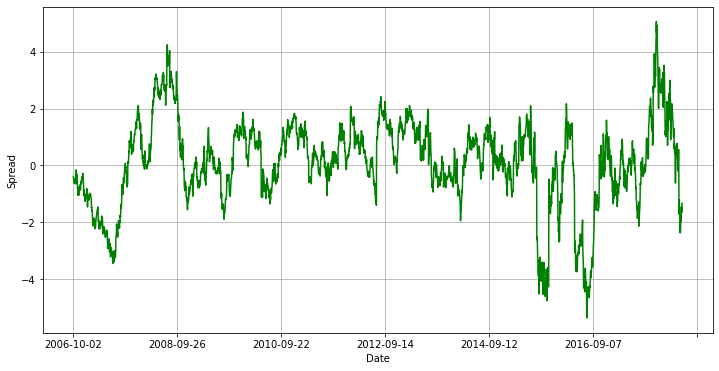

True
-------------------- #78 --------------------
----------------- APH & GOOG -----------------
Hedge Ratio =  0.03973784484427362
Critical Value =  -3.9591965431806235
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


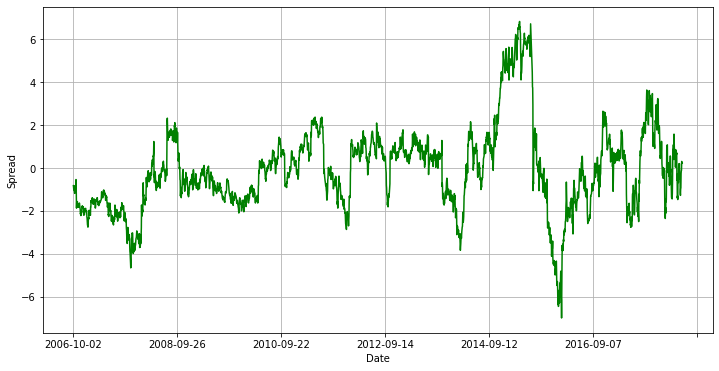

True
-------------------- #79 --------------------
----------------- APH & GOOGL -----------------
Hedge Ratio =  0.039095792152806216
Critical Value =  -3.9248373098283516
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


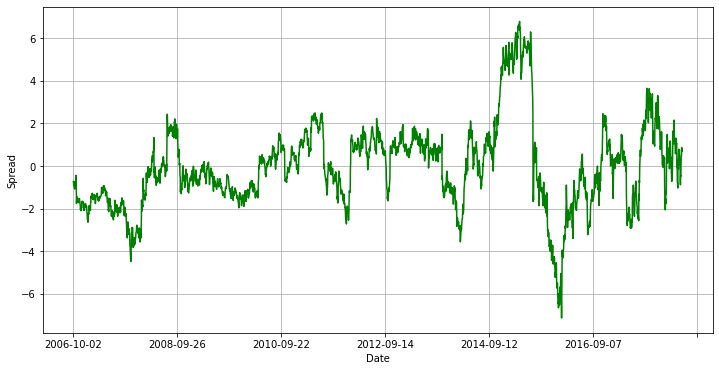

True
-------------------- #80 --------------------
----------------- APH & IT -----------------
Hedge Ratio =  0.3184042255192346
Critical Value =  -3.834046936800592
{'1%': -3.4325853286163874, '5%': -2.8625276197775373, '10%': -2.5672957374856296}


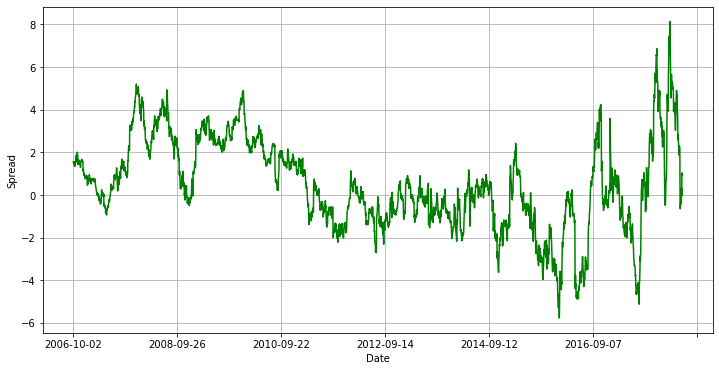

True
-------------------- #81 --------------------
----------------- APH & MSI -----------------
Hedge Ratio =  0.37270396420661
Critical Value =  -3.8426162105731367
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


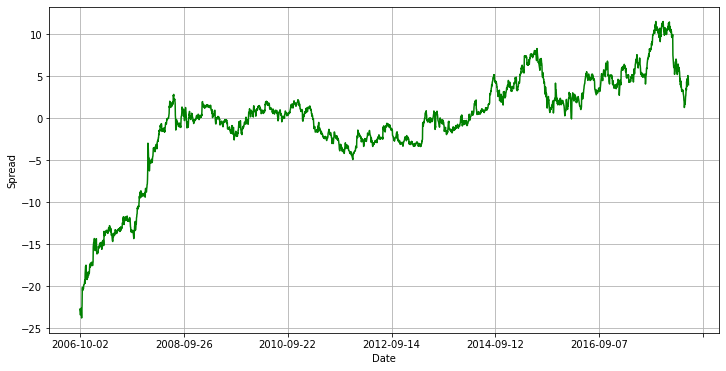

True
-------------------- #82 --------------------
----------------- APH & XLNX -----------------
Hedge Ratio =  0.5780378880419895
Critical Value =  -2.645003418939674
{'1%': -3.4325853286163874, '5%': -2.8625276197775373, '10%': -2.5672957374856296}


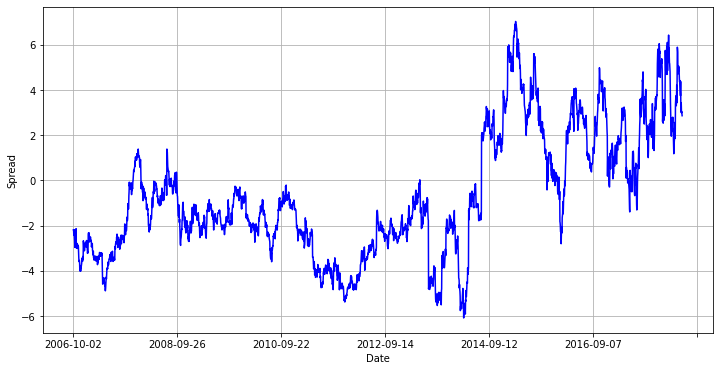

False
-------------------- #83 --------------------
----------------- ATVI & GPN -----------------
Hedge Ratio =  0.5658332021348395
Critical Value =  -3.866833201085711
{'1%': -3.4325853286163874, '5%': -2.8625276197775373, '10%': -2.5672957374856296}


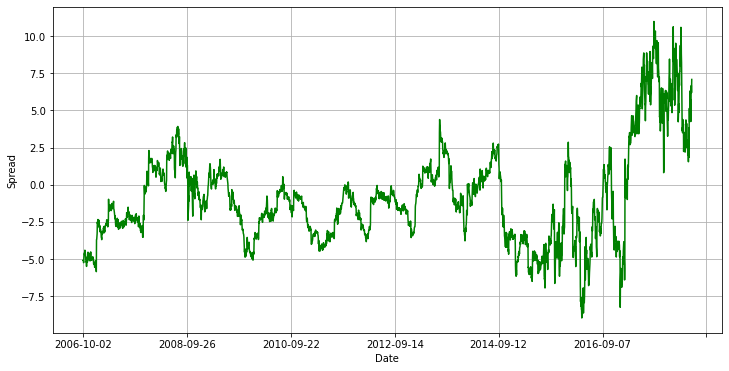

True
-------------------- #84 --------------------
----------------- ATVI & LRCX -----------------
Hedge Ratio =  0.3631674065252486
Critical Value =  -3.289312078018085
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


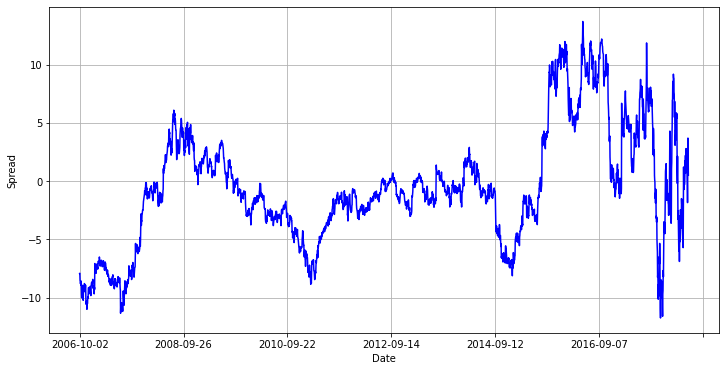

False
-------------------- #85 --------------------
----------------- ATVI & MSFT -----------------
Hedge Ratio =  0.6789754115408598
Critical Value =  -2.0957504020816025
{'1%': -3.4325853286163874, '5%': -2.8625276197775373, '10%': -2.5672957374856296}


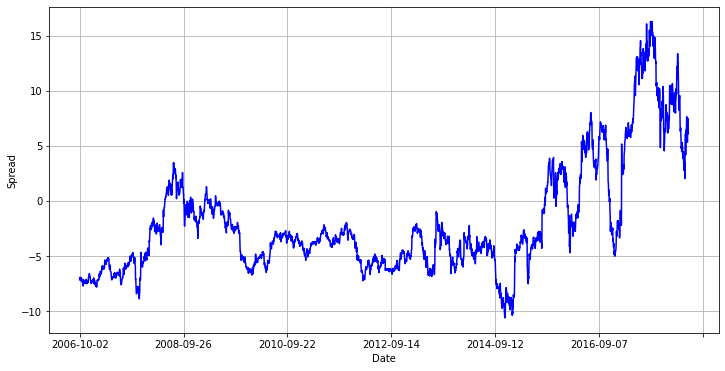

False
-------------------- #86 --------------------
----------------- CDNS & MSI -----------------
Hedge Ratio =  0.34982049044743196
Critical Value =  -3.0088702795860556
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


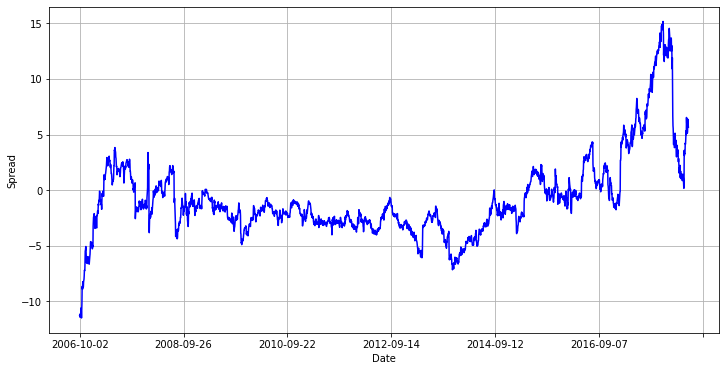

False
-------------------- #87 --------------------
----------------- CRM & INTU -----------------
Hedge Ratio =  0.708292182370453
Critical Value =  -4.5204381699286
{'1%': -3.4325853286163874, '5%': -2.8625276197775373, '10%': -2.5672957374856296}


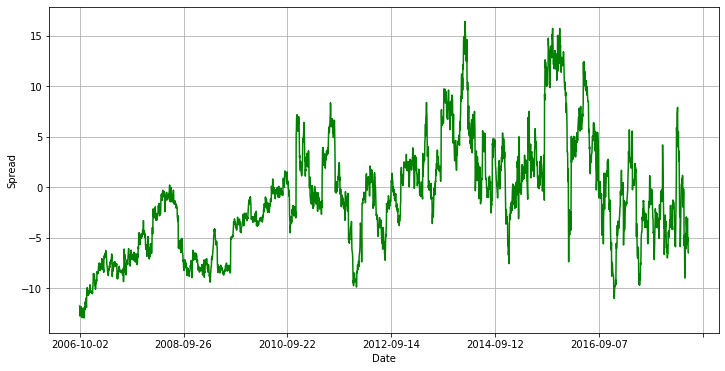

True
-------------------- #88 --------------------
----------------- CRM & IT -----------------
Hedge Ratio =  0.8120174841102538
Critical Value =  -3.765710674041701
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


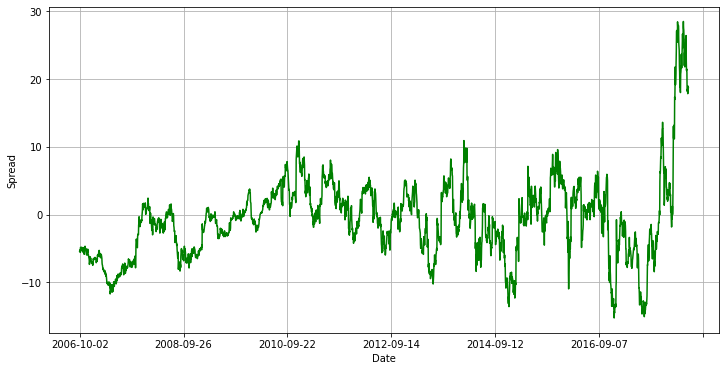

True
-------------------- #89 --------------------
----------------- CRM & MSI -----------------
Hedge Ratio =  0.9302971502424155
Critical Value =  -3.0295982691933636
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


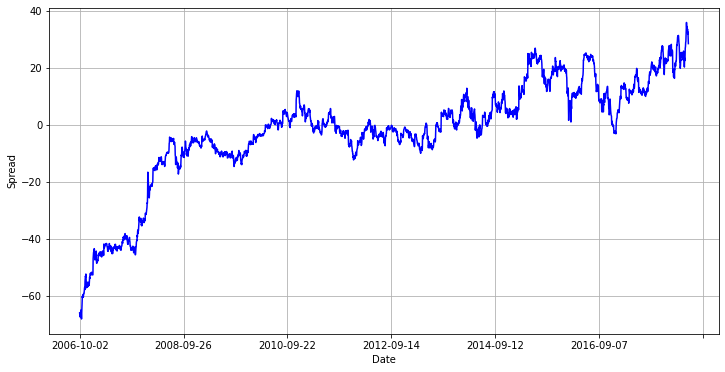

False
-------------------- #90 --------------------
----------------- CRM & VRSN -----------------
Hedge Ratio =  0.9379680712025175
Critical Value =  -3.4060321561298403
{'1%': -3.4325853286163874, '5%': -2.8625276197775373, '10%': -2.5672957374856296}


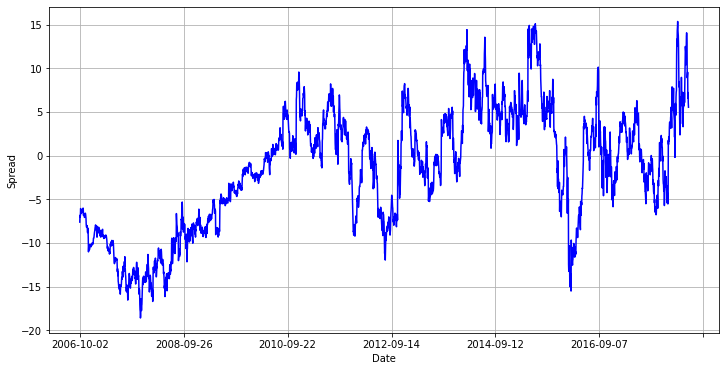

False
-------------------- #91 --------------------
----------------- CRM & XLNX -----------------
Hedge Ratio =  1.4591614635944374
Critical Value =  -1.923798915473385
{'1%': -3.4325853286163874, '5%': -2.8625276197775373, '10%': -2.5672957374856296}


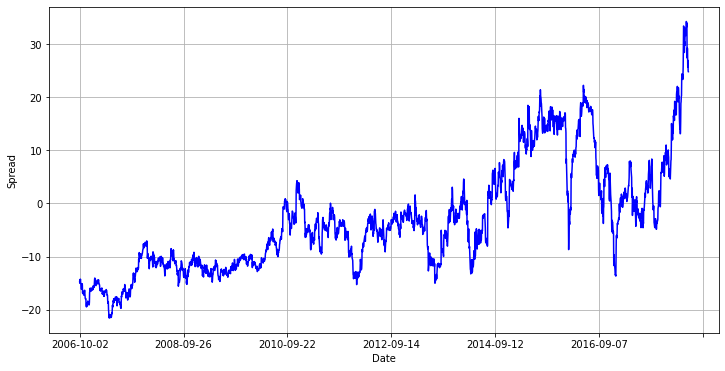

False
-------------------- #92 --------------------
----------------- CSCO & EA -----------------
Hedge Ratio =  0.35822161140301356
Critical Value =  -1.3901759789017494
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


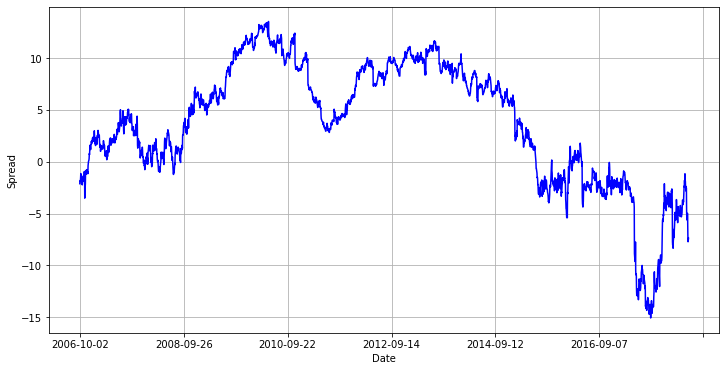

False
-------------------- #93 --------------------
----------------- CTSH & IT -----------------
Hedge Ratio =  0.6291435589543868
Critical Value =  -2.637681257159686
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


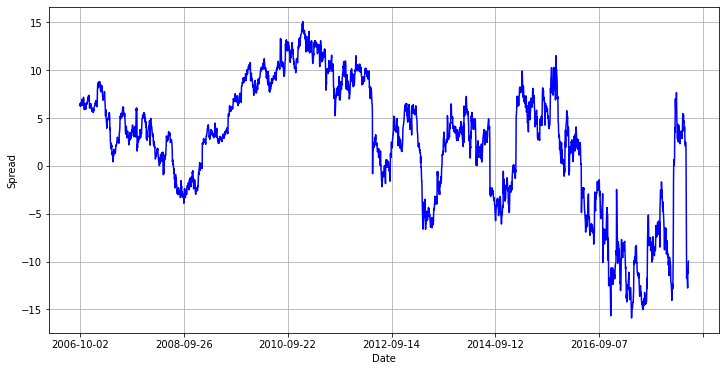

False
-------------------- #94 --------------------
----------------- CTSH & MSI -----------------
Hedge Ratio =  0.7450037493457452
Critical Value =  -3.745235362815928
{'1%': -3.4325853286163874, '5%': -2.8625276197775373, '10%': -2.5672957374856296}


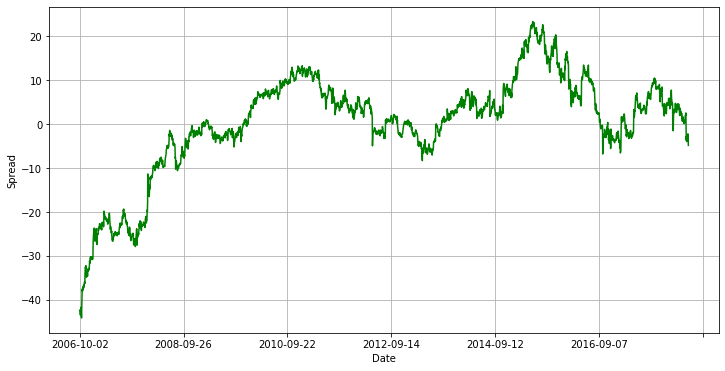

True
-------------------- #95 --------------------
----------------- CTSH & ORCL -----------------
Hedge Ratio =  1.3698819342093966
Critical Value =  -2.1548799053733214
{'1%': -3.4325853286163874, '5%': -2.8625276197775373, '10%': -2.5672957374856296}


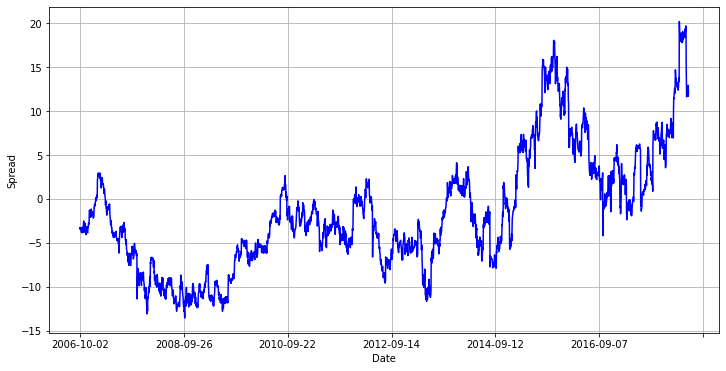

False
-------------------- #96 --------------------
----------------- EBAY & FIS -----------------
Hedge Ratio =  0.4312847384216813
Critical Value =  -2.721624325924613
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


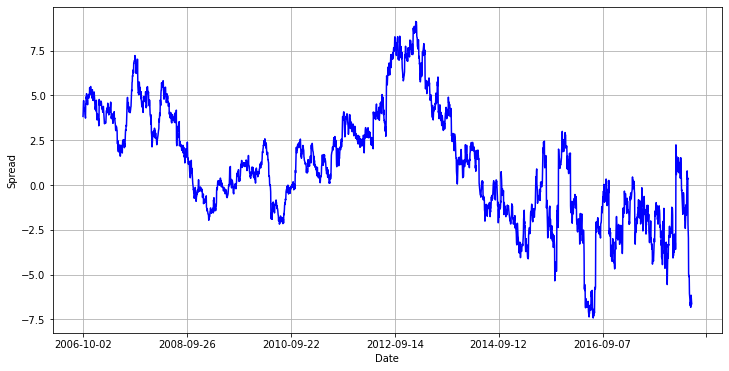

False
-------------------- #97 --------------------
----------------- EBAY & GOOG -----------------
Hedge Ratio =  0.03910100023463809
Critical Value =  -3.0515962884414787
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


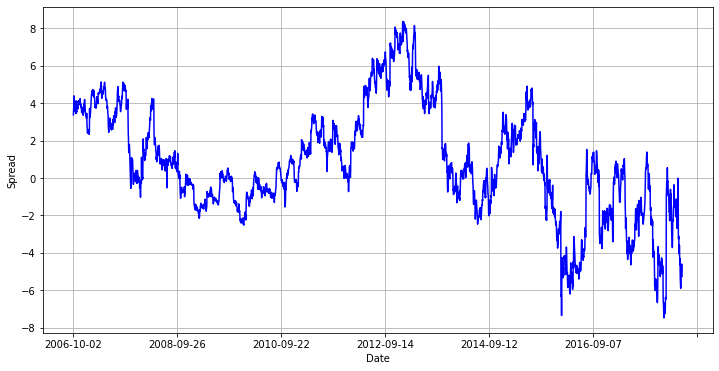

False
-------------------- #98 --------------------
----------------- EBAY & GOOGL -----------------
Hedge Ratio =  0.03845293645948892
Critical Value =  -3.030260830599821
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


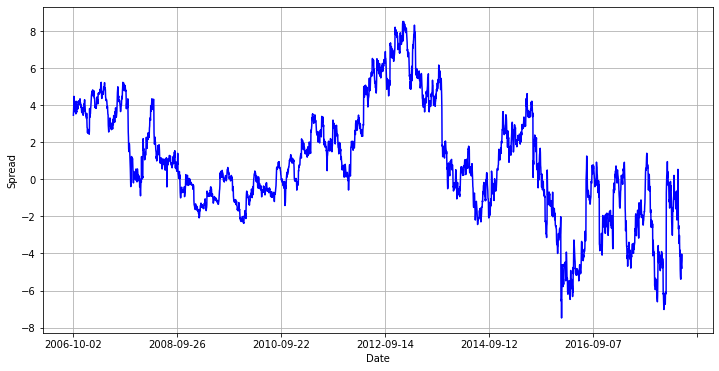

False
-------------------- #99 --------------------
----------------- EBAY & IT -----------------
Hedge Ratio =  0.31185780260041246
Critical Value =  -2.8474304820930882
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


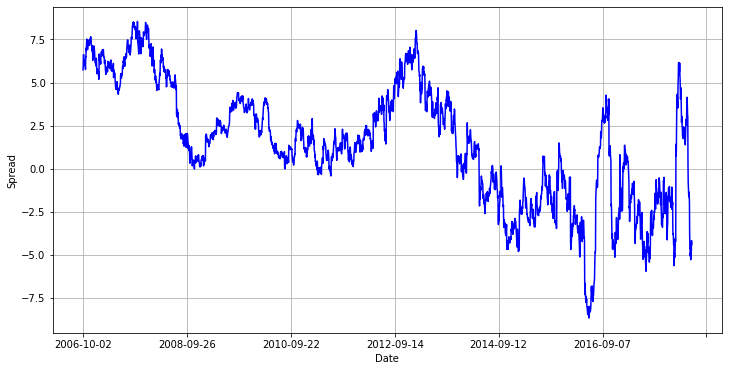

False
-------------------- #100 --------------------
----------------- EBAY & KLAC -----------------
Hedge Ratio =  0.42645864736667677
Critical Value =  -2.6903477565514975
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


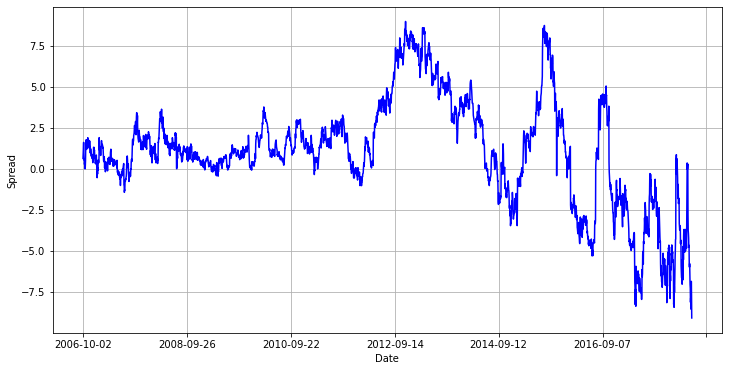

False
-------------------- #101 --------------------
----------------- EBAY & MSI -----------------
Hedge Ratio =  0.377969406349816
Critical Value =  -4.812273645096245
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


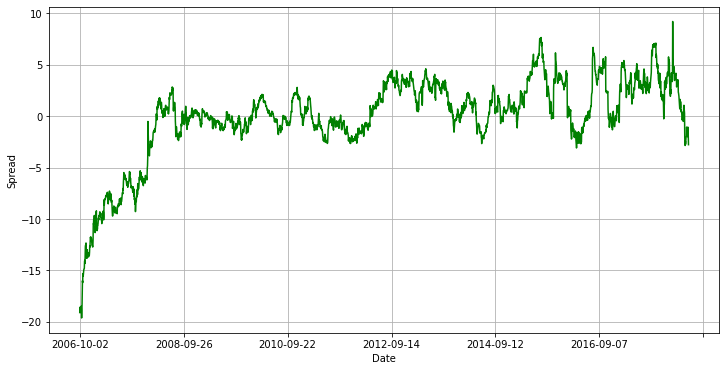

True
-------------------- #102 --------------------
----------------- EBAY & PAYX -----------------
Hedge Ratio =  0.6084297296781427
Critical Value =  -3.4800955899363237
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


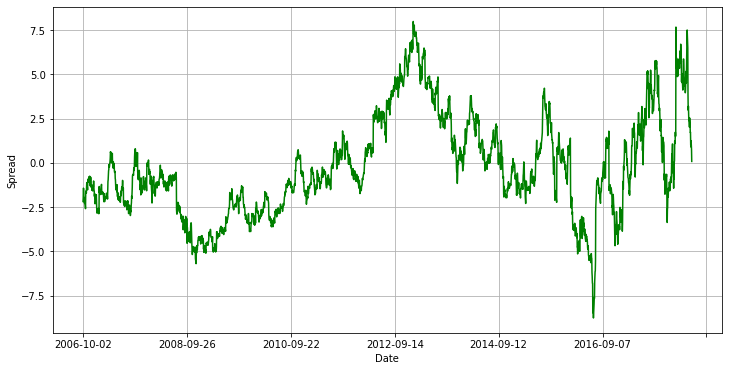

True
-------------------- #103 --------------------
----------------- EBAY & VRSN -----------------
Hedge Ratio =  0.362425365053226
Critical Value =  -2.3930410611997335
{'1%': -3.4325853286163874, '5%': -2.8625276197775373, '10%': -2.5672957374856296}


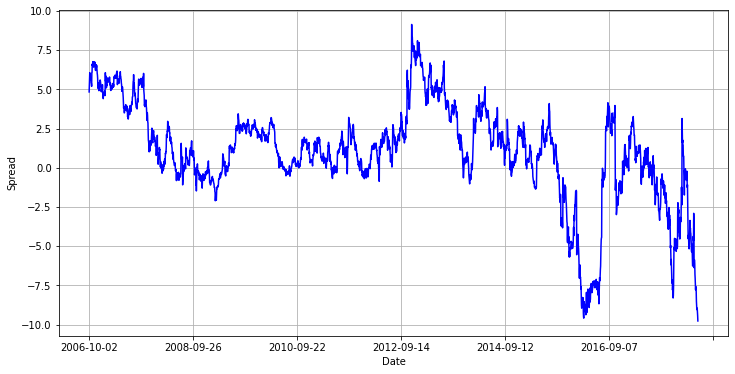

False
-------------------- #104 --------------------
----------------- EBAY & XLNX -----------------
Hedge Ratio =  0.5739586416512332
Critical Value =  -4.3960014450747
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


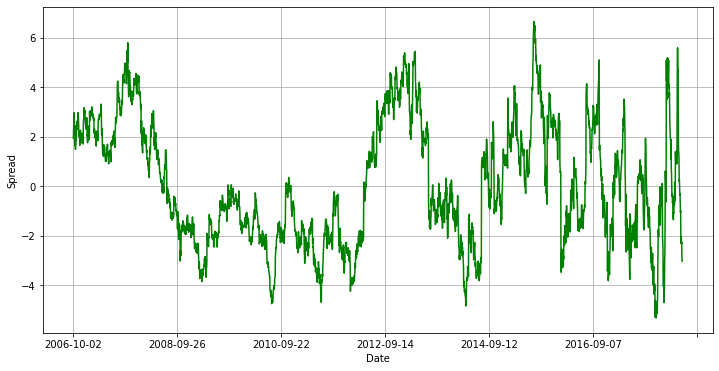

True
-------------------- #105 --------------------
----------------- FIS & FISV -----------------
Hedge Ratio =  1.4267428217649099
Critical Value =  -2.729035433844332
{'1%': -3.4325853286163874, '5%': -2.8625276197775373, '10%': -2.5672957374856296}


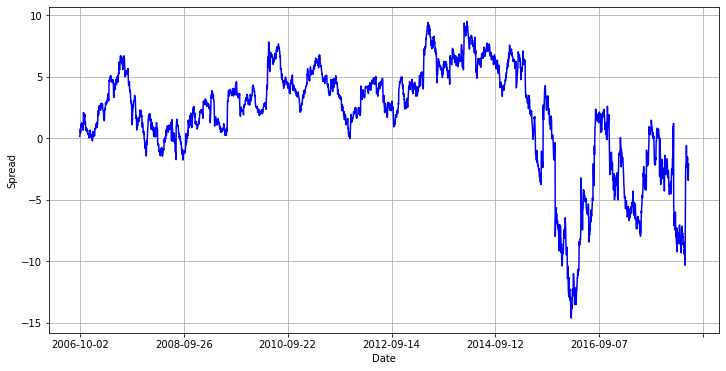

False
-------------------- #106 --------------------
----------------- FIS & GOOG -----------------
Hedge Ratio =  0.09002248195411554
Critical Value =  -3.899978457343683
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


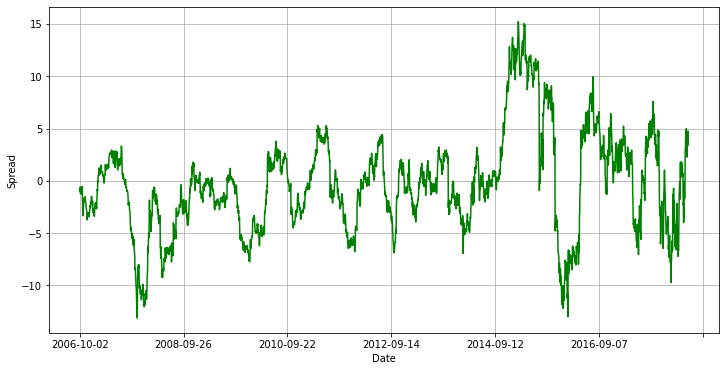

True
-------------------- #107 --------------------
----------------- FIS & GOOGL -----------------
Hedge Ratio =  0.0885960910842734
Critical Value =  -3.9548540373303678
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


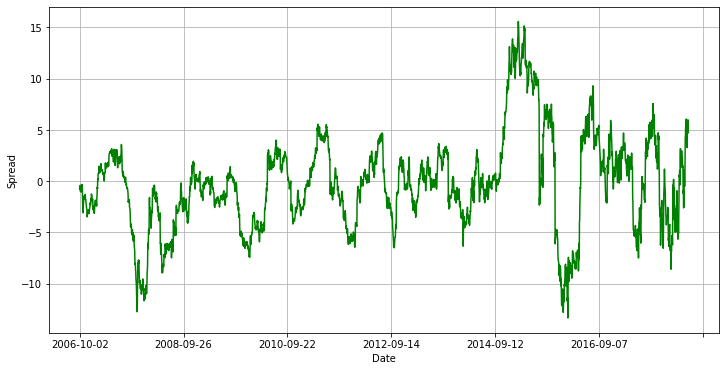

True
-------------------- #108 --------------------
----------------- FIS & IT -----------------
Hedge Ratio =  0.7224320919064969
Critical Value =  -4.207799968079869
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


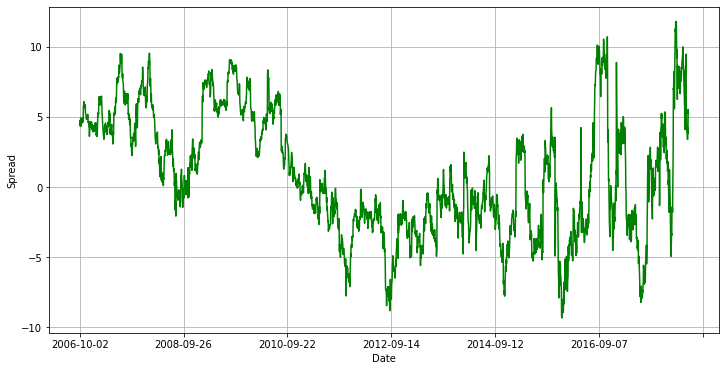

True
-------------------- #109 --------------------
----------------- FIS & KLAC -----------------
Hedge Ratio =  0.9808781128728103
Critical Value =  -3.4501686938573983
{'1%': -3.4325853286163874, '5%': -2.8625276197775373, '10%': -2.5672957374856296}


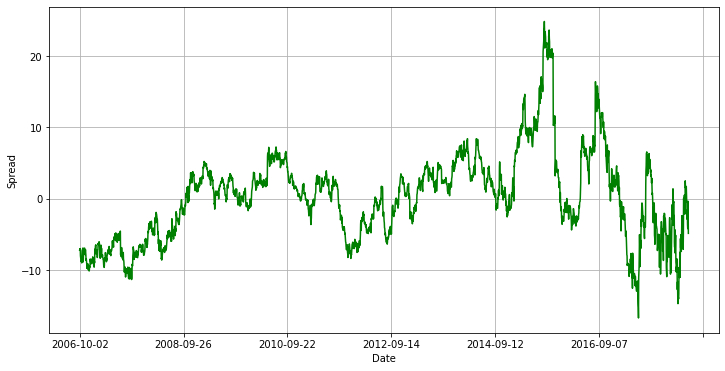

True
-------------------- #110 --------------------
----------------- FIS & MSI -----------------
Hedge Ratio =  0.8464548437290453
Critical Value =  -3.7132179600866566
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


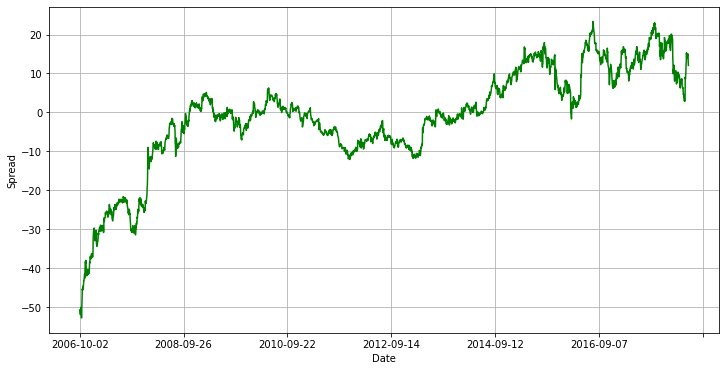

True
-------------------- #111 --------------------
----------------- FIS & PAYX -----------------
Hedge Ratio =  1.3856105738114604
Critical Value =  -1.3294097720098164
{'1%': -3.4325853286163874, '5%': -2.8625276197775373, '10%': -2.5672957374856296}


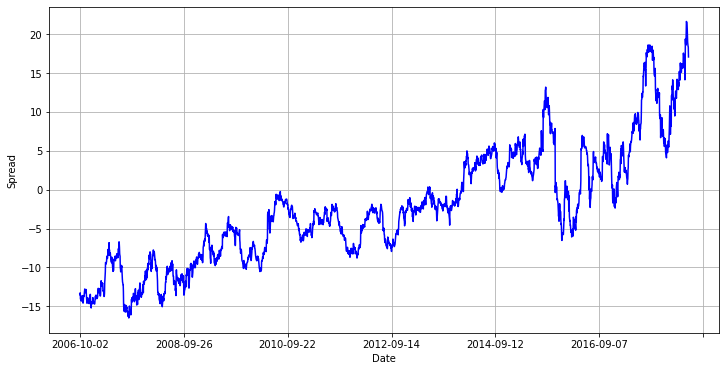

False
-------------------- #112 --------------------
----------------- FIS & VRSN -----------------
Hedge Ratio =  0.8341477798627711
Critical Value =  -3.2624972855996495
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


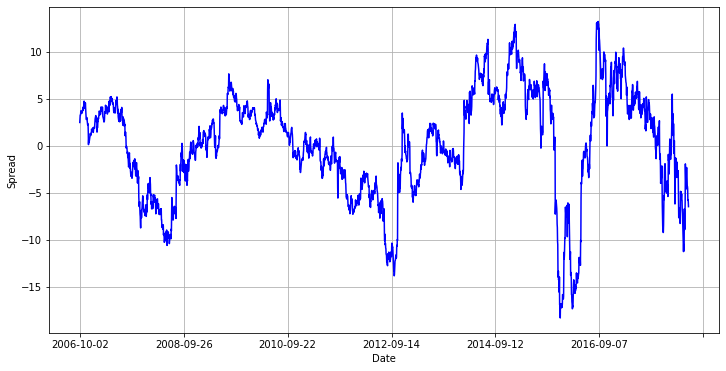

False
-------------------- #113 --------------------
----------------- FIS & XLNX -----------------
Hedge Ratio =  1.3071225513964675
Critical Value =  -2.682655821804921
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


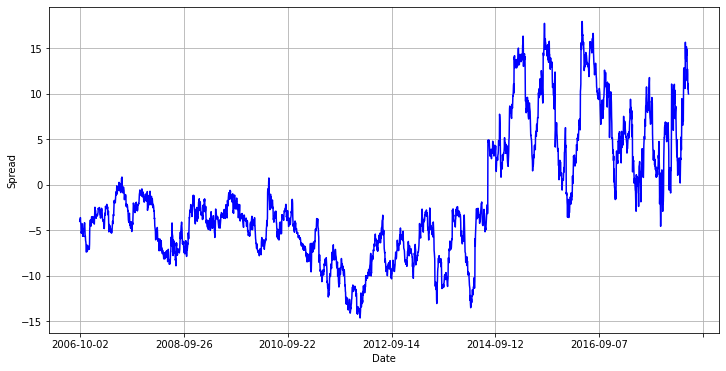

False
-------------------- #114 --------------------
----------------- FISV & GOOG -----------------
Hedge Ratio =  0.062600116982537
Critical Value =  -2.867641021606242
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


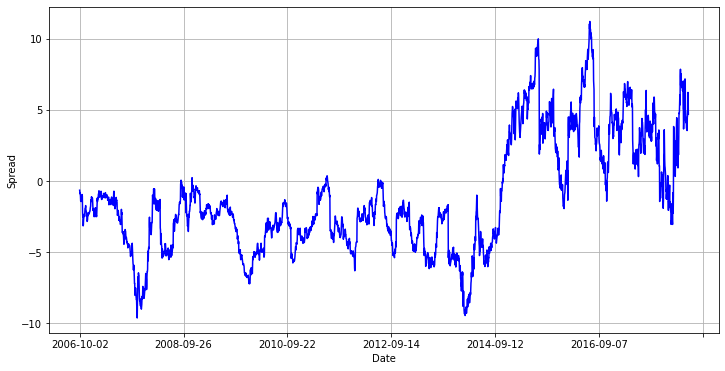

False
-------------------- #115 --------------------
----------------- FISV & GOOGL -----------------
Hedge Ratio =  0.061633355049522796
Critical Value =  -2.9387383112204546
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


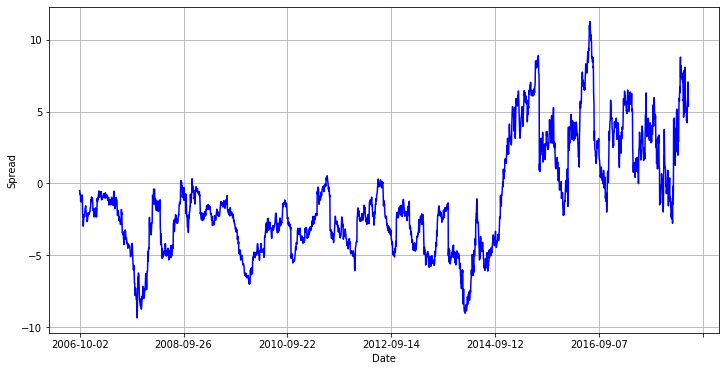

False
-------------------- #116 --------------------
----------------- FISV & MSI -----------------
Hedge Ratio =  0.5817354728300027
Critical Value =  -2.9631357902091846
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


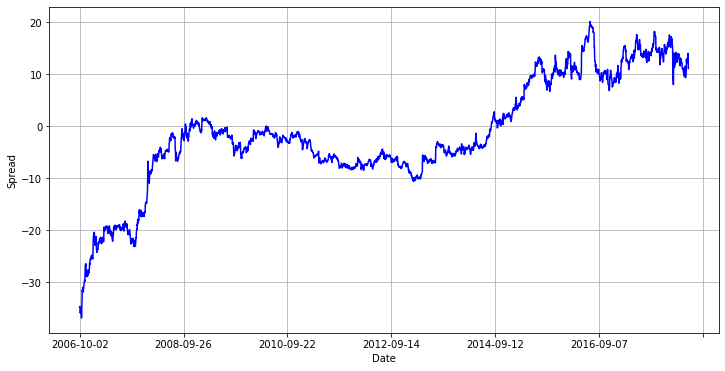

False
-------------------- #117 --------------------
----------------- FISV & PAYX -----------------
Hedge Ratio =  0.9562690297090561
Critical Value =  -0.3797793161667099
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


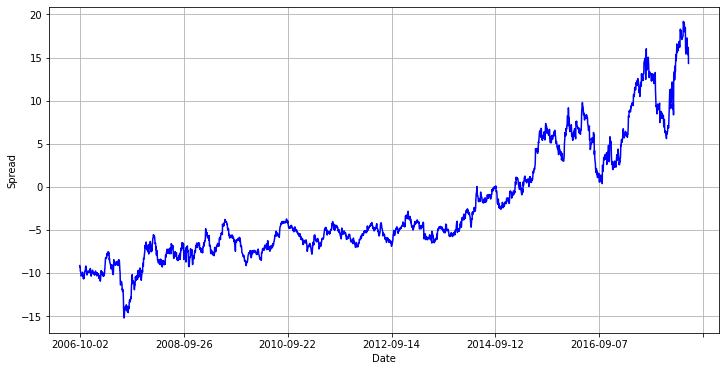

False
-------------------- #118 --------------------
----------------- FISV & VRSN -----------------
Hedge Ratio =  0.5812717413439933
Critical Value =  -3.117059776044435
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


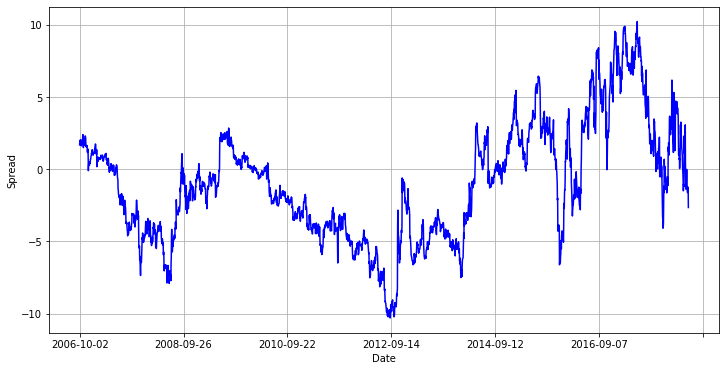

False
-------------------- #119 --------------------
----------------- FLIR & MSFT -----------------
Hedge Ratio =  0.6860999715374841
Critical Value =  -1.1573606884305043
{'1%': -3.4325853286163874, '5%': -2.8625276197775373, '10%': -2.5672957374856296}


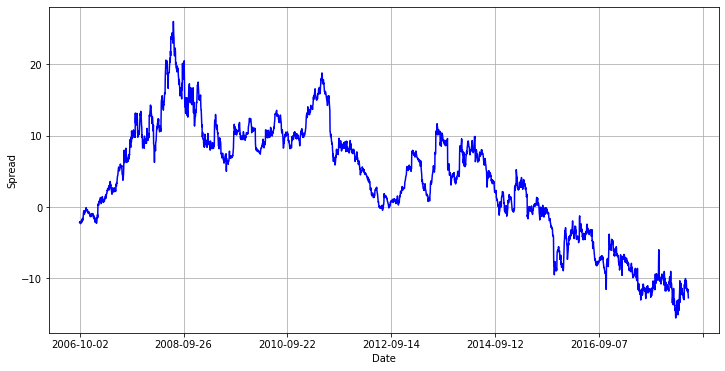

False
-------------------- #120 --------------------
----------------- FLIR & MU -----------------
Hedge Ratio =  1.2917780554593428
Critical Value =  -1.2098859932568073
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


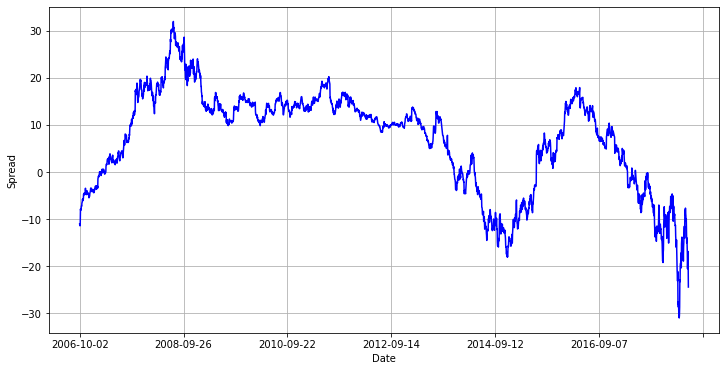

False
-------------------- #121 --------------------
----------------- FLIR & NFLX -----------------
Hedge Ratio =  0.25046936695681293
Critical Value =  0.7531829983033497
{'1%': -3.4325853286163874, '5%': -2.8625276197775373, '10%': -2.5672957374856296}


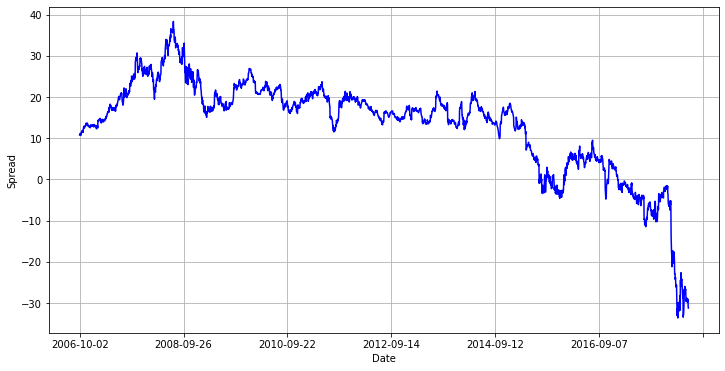

False
-------------------- #122 --------------------
----------------- FLIR & NVDA -----------------
Hedge Ratio =  0.30427634613827687
Critical Value =  0.30270956070077903
{'1%': -3.4325853286163874, '5%': -2.8625276197775373, '10%': -2.5672957374856296}


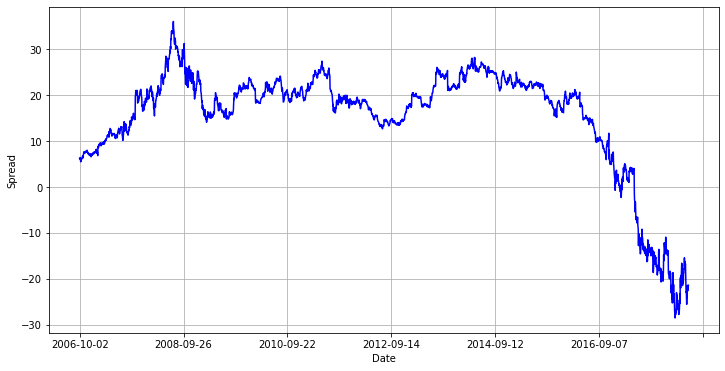

False
-------------------- #123 --------------------
----------------- FLIR & TXN -----------------
Hedge Ratio =  0.6225421513699524
Critical Value =  -1.1344152371615157
{'1%': -3.4325853286163874, '5%': -2.8625276197775373, '10%': -2.5672957374856296}


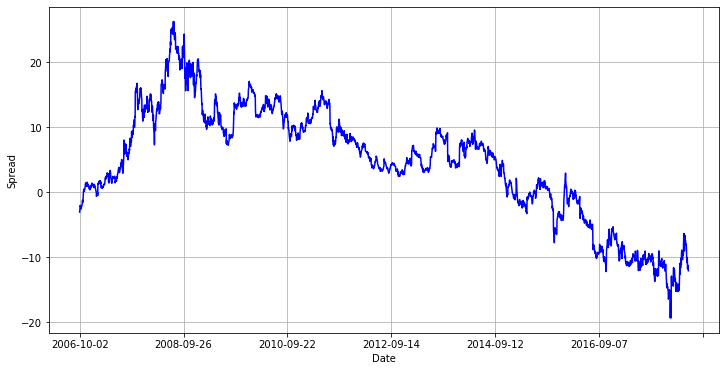

False
-------------------- #124 --------------------
----------------- GOOG & KLAC -----------------
Hedge Ratio =  10.862285769904707
Critical Value =  -4.134560300524806
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


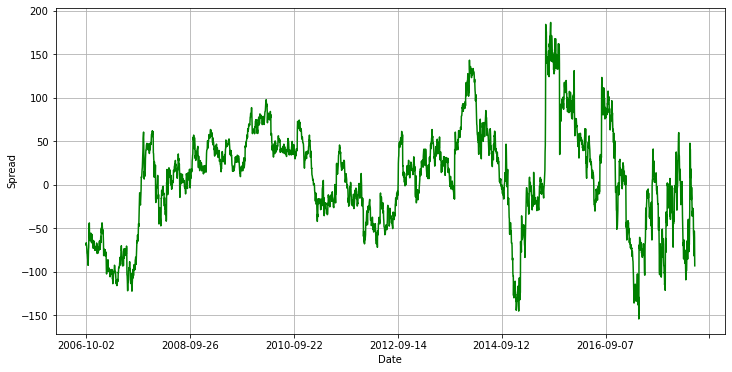

True
-------------------- #125 --------------------
----------------- GOOG & MSI -----------------
Hedge Ratio =  9.40998170111186
Critical Value =  -4.00562410573313
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


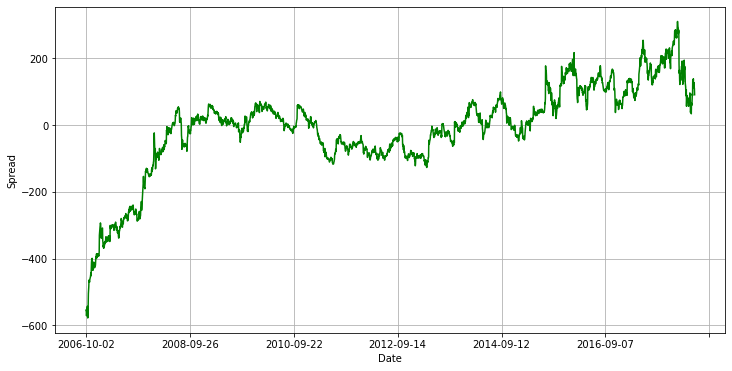

True
-------------------- #126 --------------------
----------------- GOOG & PAYX -----------------
Hedge Ratio =  15.350516477693306
Critical Value =  -2.430281155012668
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


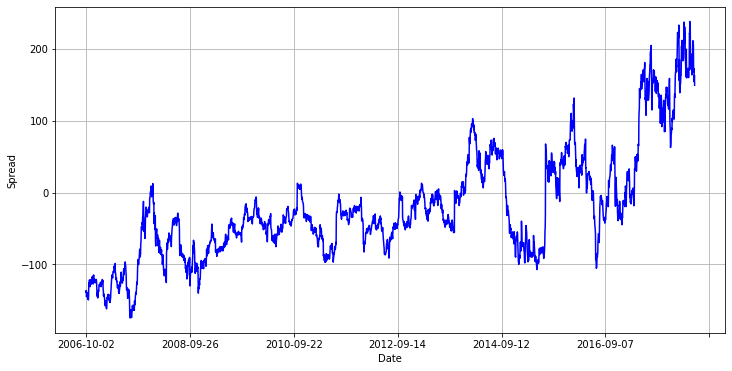

False
-------------------- #127 --------------------
----------------- GOOG & SNPS -----------------
Hedge Ratio =  12.322798866082342
Critical Value =  -3.2507849309316565
{'1%': -3.4325853286163874, '5%': -2.8625276197775373, '10%': -2.5672957374856296}


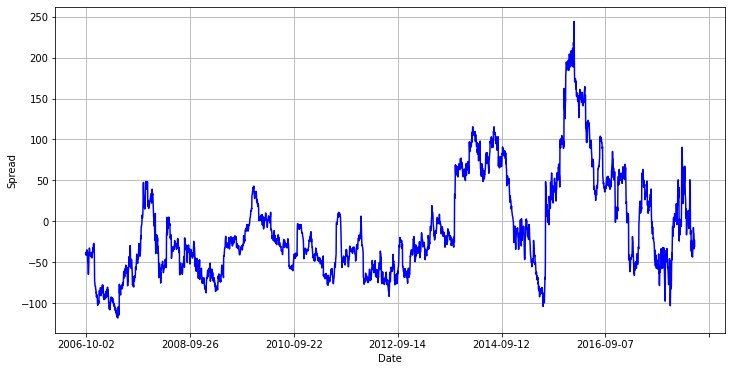

False
-------------------- #128 --------------------
----------------- GOOG & VRSN -----------------
Hedge Ratio =  9.236849970468104
Critical Value =  -3.891290118181627
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


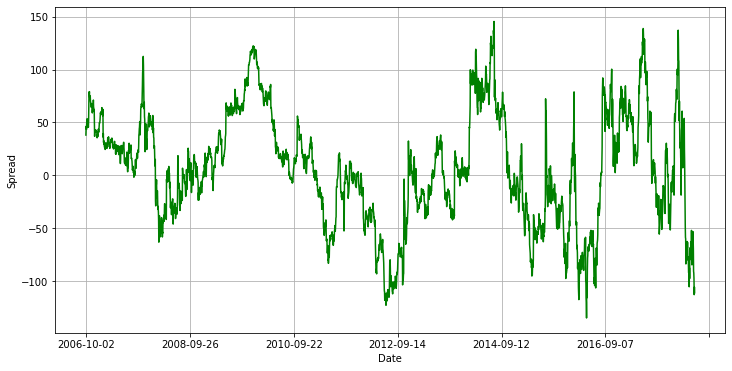

True
-------------------- #129 --------------------
----------------- GOOG & XLNX -----------------
Hedge Ratio =  14.48437283422074
Critical Value =  -3.30237833394706
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


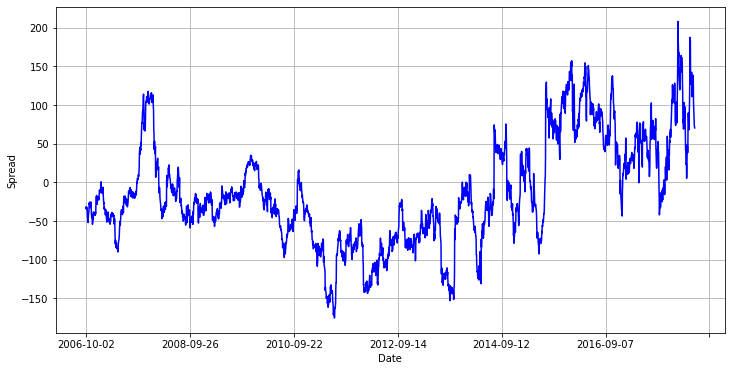

False
-------------------- #130 --------------------
----------------- GOOGL & IT -----------------
Hedge Ratio =  8.07368381777859
Critical Value =  -3.262417388359425
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


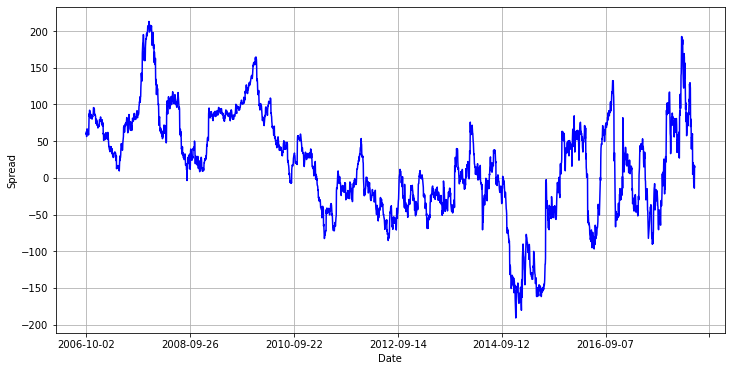

False
-------------------- #131 --------------------
----------------- GOOGL & KLAC -----------------
Hedge Ratio =  11.035524302016153
Critical Value =  -3.965695857141097
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


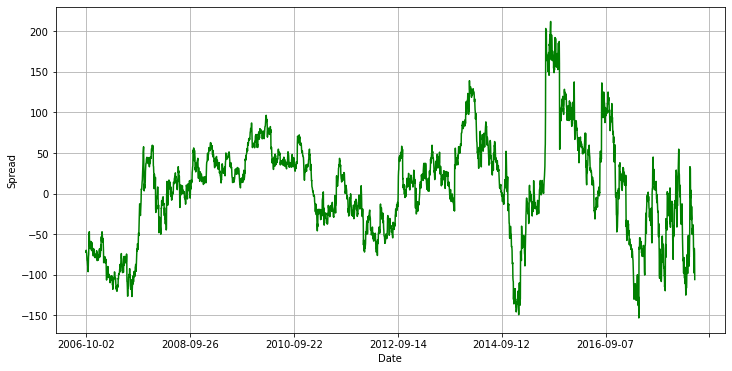

True
-------------------- #132 --------------------
----------------- GOOGL & MSI -----------------
Hedge Ratio =  9.554002889307498
Critical Value =  -3.9721291136094985
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


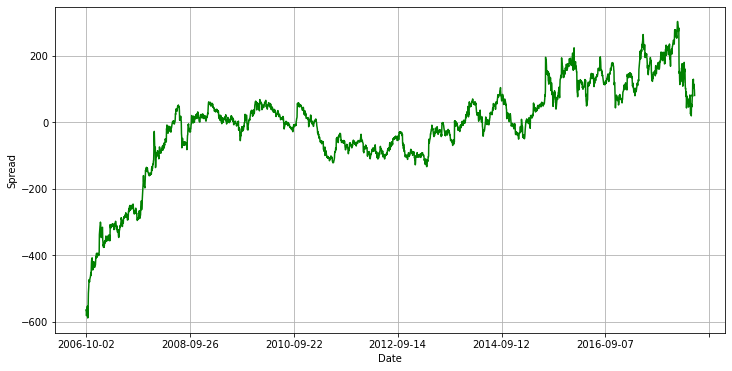

True
-------------------- #133 --------------------
----------------- GOOGL & PAYX -----------------
Hedge Ratio =  15.597571052994677
Critical Value =  -2.448294808613011
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


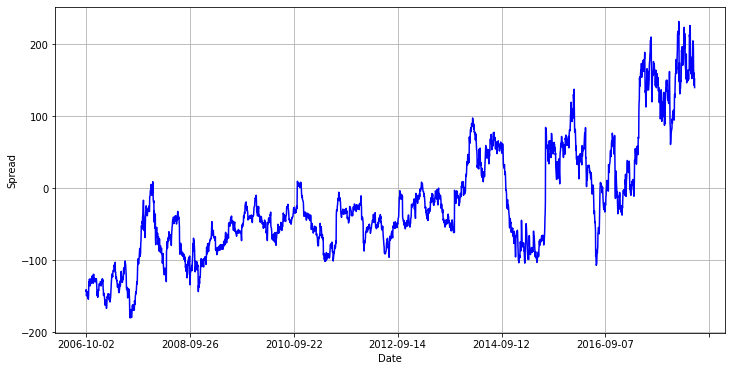

False
-------------------- #134 --------------------
----------------- GOOGL & VRSN -----------------
Hedge Ratio =  9.387531476017937
Critical Value =  -3.7963013332263675
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


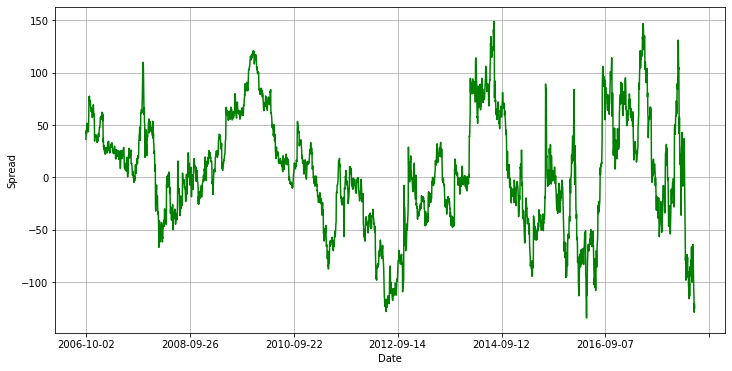

True
-------------------- #135 --------------------
----------------- GOOGL & XLNX -----------------
Hedge Ratio =  14.711847156917752
Critical Value =  -3.211795431582496
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


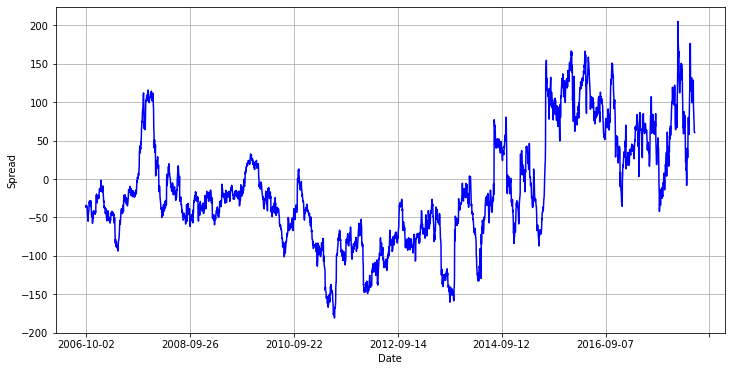

False
-------------------- #136 --------------------
----------------- INTC & INTU -----------------
Hedge Ratio =  0.3010143495479117
Critical Value =  -2.048757440575357
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


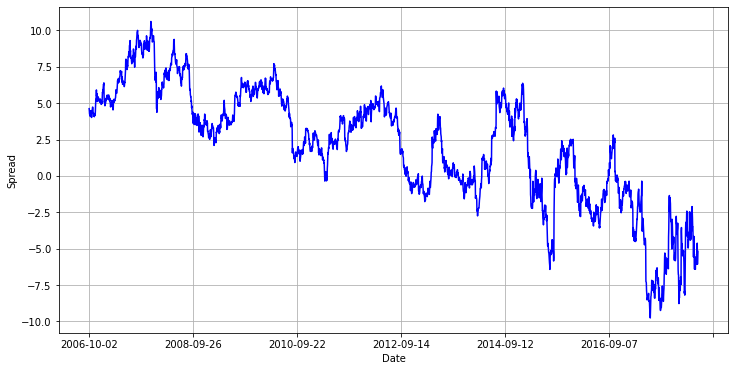

False
-------------------- #137 --------------------
----------------- INTC & MA -----------------
Hedge Ratio =  0.31487101323709554
Critical Value =  -1.2271933582758814
{'1%': -3.4325853286163874, '5%': -2.8625276197775373, '10%': -2.5672957374856296}


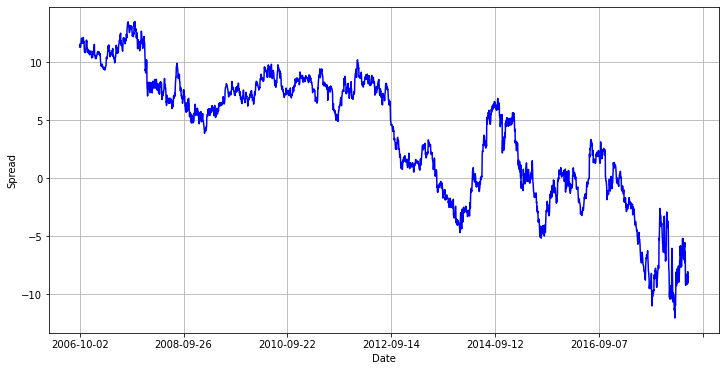

False
-------------------- #138 --------------------
----------------- INTC & MSFT -----------------
Hedge Ratio =  0.5912431658975935
Critical Value =  -2.2551352648037155
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


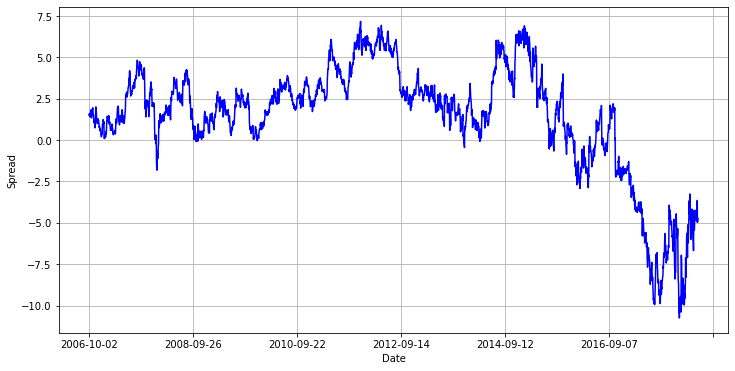

False
-------------------- #139 --------------------
----------------- INTC & MSI -----------------
Hedge Ratio =  0.4183363025543445
Critical Value =  -4.081792730842247
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


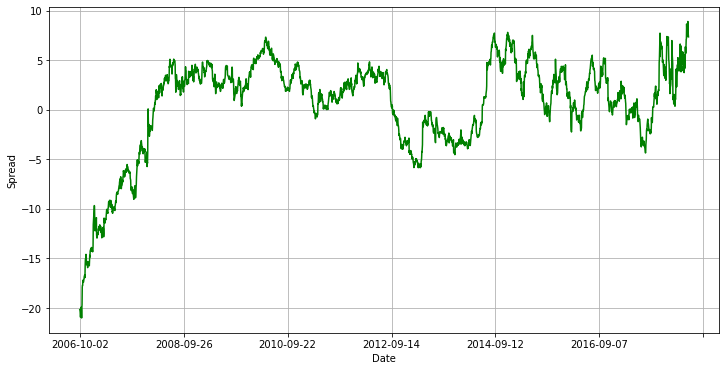

True
-------------------- #140 --------------------
----------------- INTC & TXN -----------------
Hedge Ratio =  0.5397097070058433
Critical Value =  -1.6652974720862324
{'1%': -3.4325853286163874, '5%': -2.8625276197775373, '10%': -2.5672957374856296}


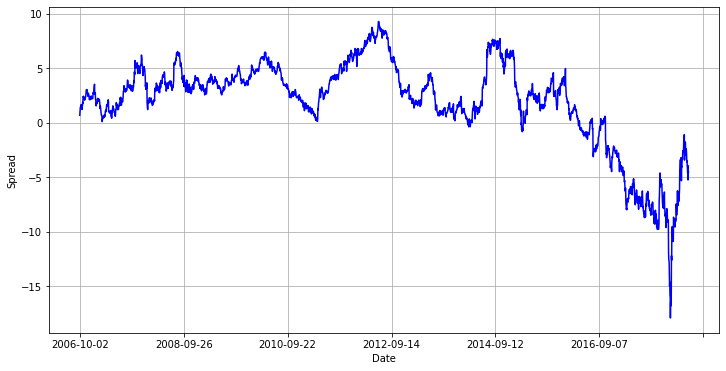

False
-------------------- #141 --------------------
----------------- INTU & MA -----------------
Hedge Ratio =  1.0620301288189984
Critical Value =  -2.8508097065410563
{'1%': -3.4325853286163874, '5%': -2.8625276197775373, '10%': -2.5672957374856296}


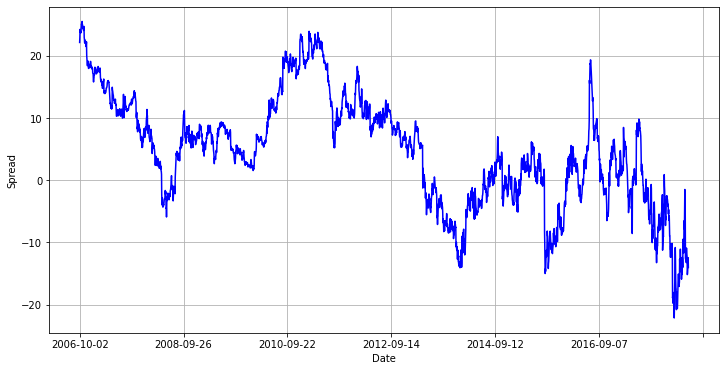

False
-------------------- #142 --------------------
----------------- INTU & VRSN -----------------
Hedge Ratio =  1.3208695157311345
Critical Value =  -3.5173392012265197
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


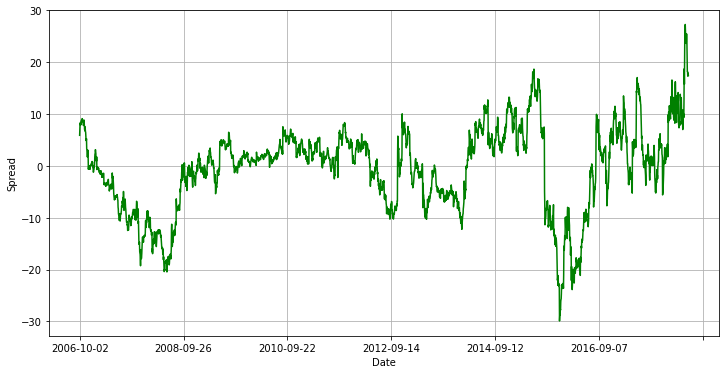

True
-------------------- #143 --------------------
----------------- INTU & XLNX -----------------
Hedge Ratio =  2.065588405596173
Critical Value =  -1.3507962531168038
{'1%': -3.4325853286163874, '5%': -2.8625276197775373, '10%': -2.5672957374856296}


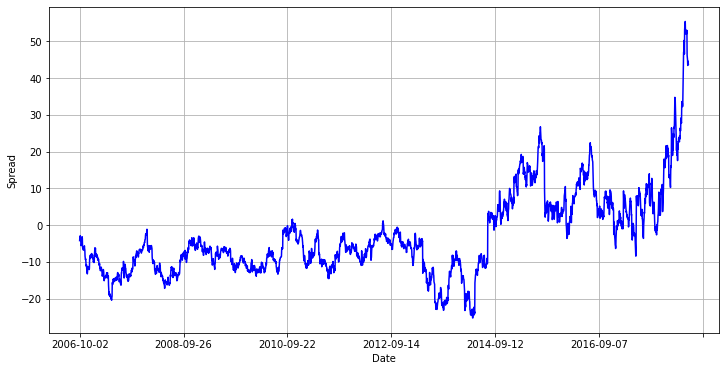

False
-------------------- #144 --------------------
----------------- IT & MSI -----------------
Hedge Ratio =  1.1539358009774605
Critical Value =  -3.6237497484797023
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


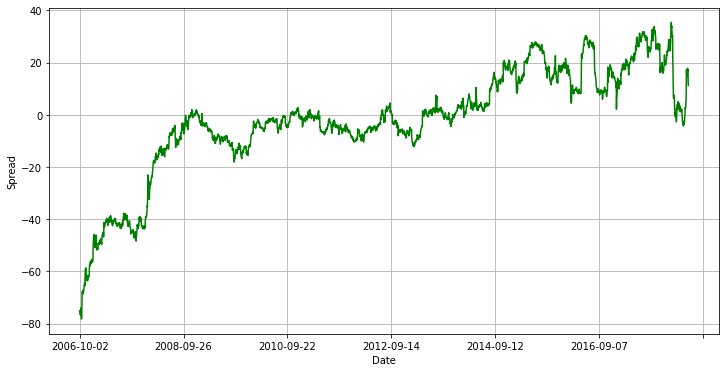

True
-------------------- #145 --------------------
----------------- IT & ORCL -----------------
Hedge Ratio =  2.1046099555012954
Critical Value =  -0.6209888692421057
{'1%': -3.4325853286163874, '5%': -2.8625276197775373, '10%': -2.5672957374856296}


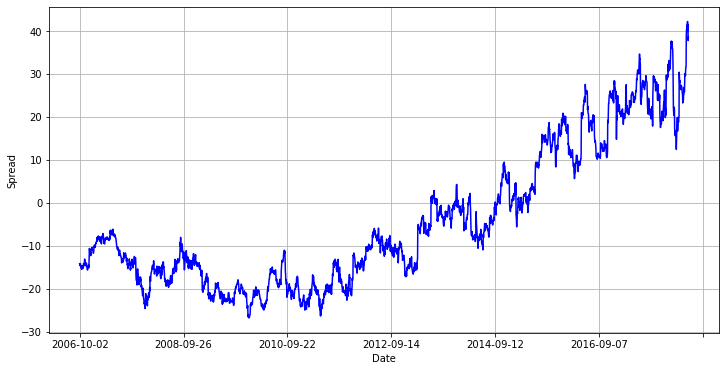

False
-------------------- #146 --------------------
----------------- IT & PAYX -----------------
Hedge Ratio =  1.893341774577665
Critical Value =  -1.787808179661324
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


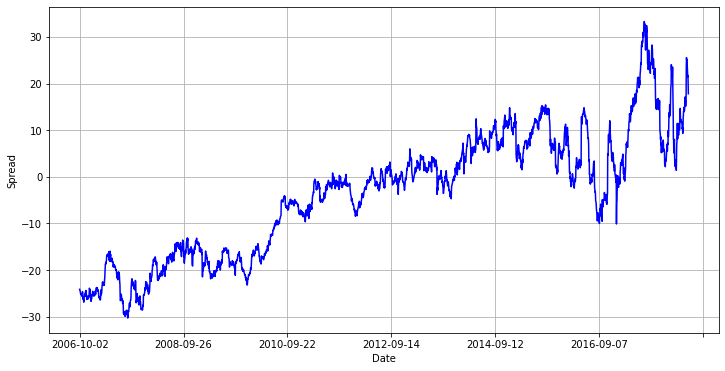

False
-------------------- #147 --------------------
----------------- IT & VRSN -----------------
Hedge Ratio =  1.148156395564734
Critical Value =  -3.301749833339133
{'1%': -3.4325853286163874, '5%': -2.8625276197775373, '10%': -2.5672957374856296}


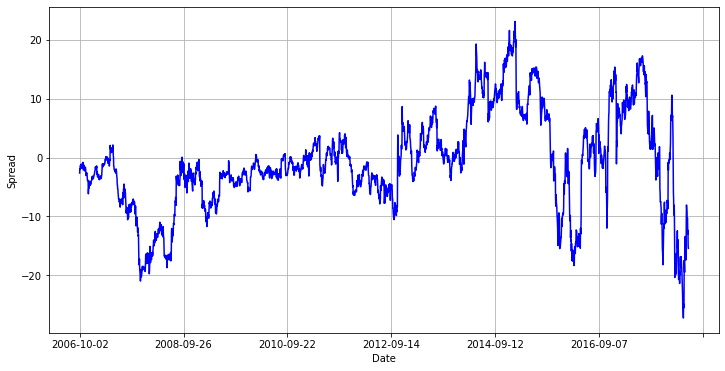

False
-------------------- #148 --------------------
----------------- IT & XLNX -----------------
Hedge Ratio =  1.7958310745953432
Critical Value =  -2.7595713890980407
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


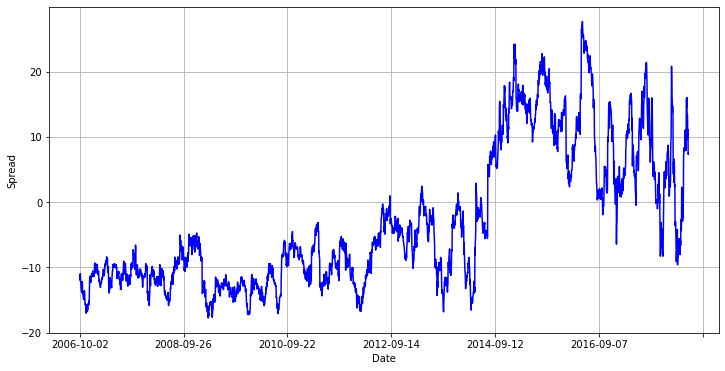

False
-------------------- #149 --------------------
----------------- KLAC & MCHP -----------------
Hedge Ratio =  1.1770808888374658
Critical Value =  -3.8456448717069933
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


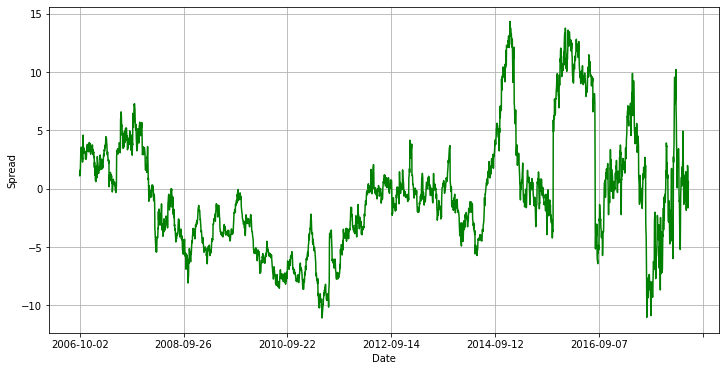

True
-------------------- #150 --------------------
----------------- KLAC & MSI -----------------
Hedge Ratio =  0.8650104717864365
Critical Value =  -3.516395496762581
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


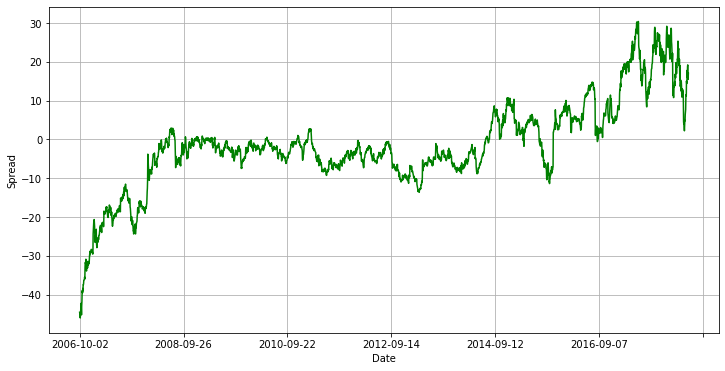

True
-------------------- #151 --------------------
----------------- KLAC & SNPS -----------------
Hedge Ratio =  1.1275331965231903
Critical Value =  -3.5004782647870174
{'1%': -3.4325853286163874, '5%': -2.8625276197775373, '10%': -2.5672957374856296}


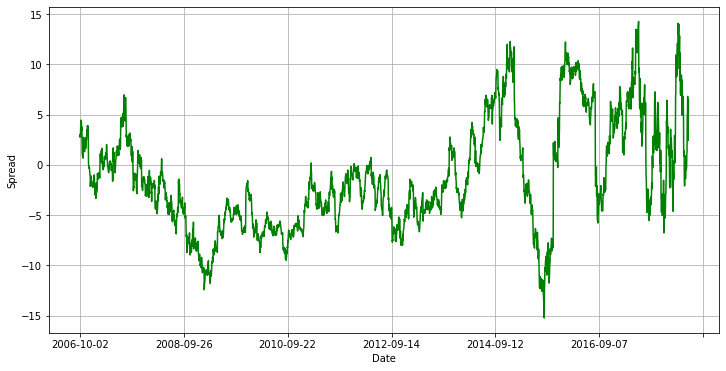

True
-------------------- #152 --------------------
----------------- KLAC & TXN -----------------
Hedge Ratio =  1.1407854273493983
Critical Value =  -3.7304981543170666
{'1%': -3.4325853286163874, '5%': -2.8625276197775373, '10%': -2.5672957374856296}


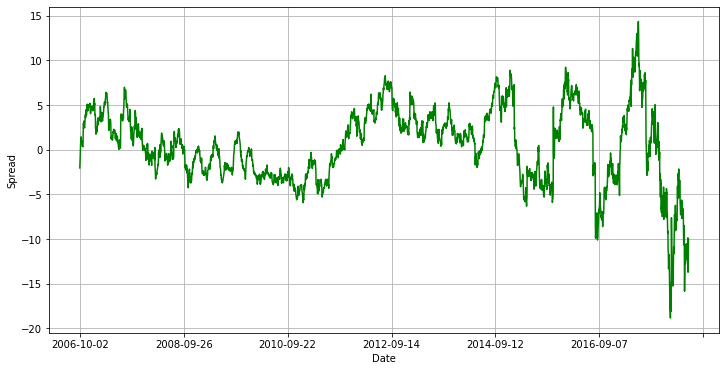

True
-------------------- #153 --------------------
----------------- MA & MSI -----------------
Hedge Ratio =  1.2035216142813177
Critical Value =  -2.07810344430658
{'1%': -3.4325853286163874, '5%': -2.8625276197775373, '10%': -2.5672957374856296}


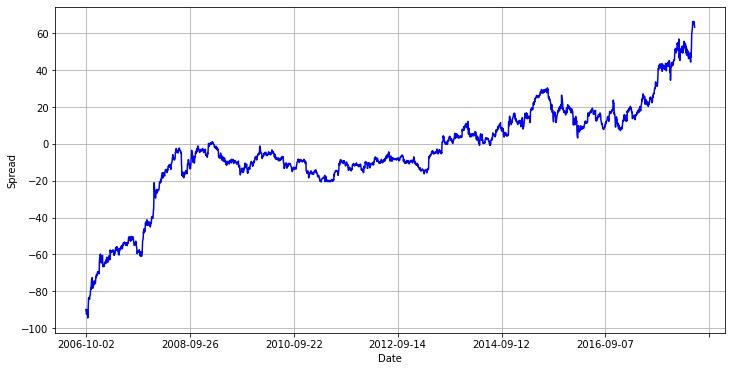

False
-------------------- #154 --------------------
----------------- MCHP & MSI -----------------
Hedge Ratio =  0.7284451592604945
Critical Value =  -3.4325706347970764
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


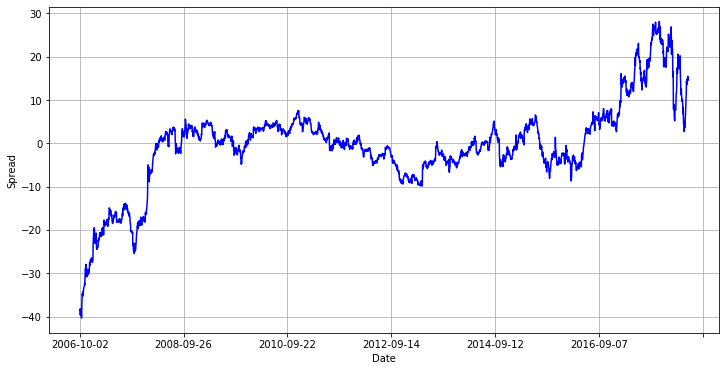

False
-------------------- #155 --------------------
----------------- MCHP & SNPS -----------------
Hedge Ratio =  0.9556882168351147
Critical Value =  -4.384764818940001
{'1%': -3.4325853286163874, '5%': -2.8625276197775373, '10%': -2.5672957374856296}


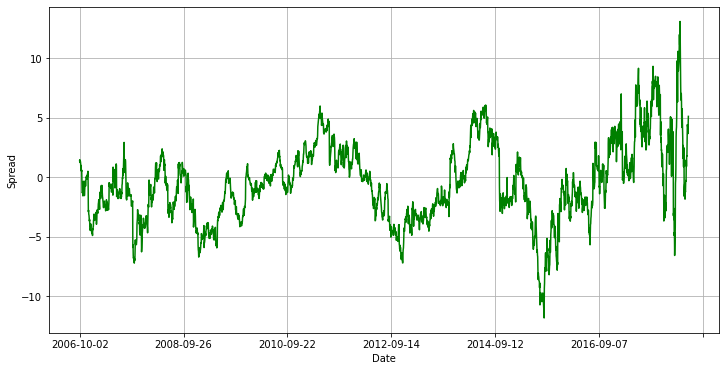

True
-------------------- #156 --------------------
----------------- MSFT & MSI -----------------
Hedge Ratio =  0.6915526802338035
Critical Value =  -2.8221115210504295
{'1%': -3.4325853286163874, '5%': -2.8625276197775373, '10%': -2.5672957374856296}


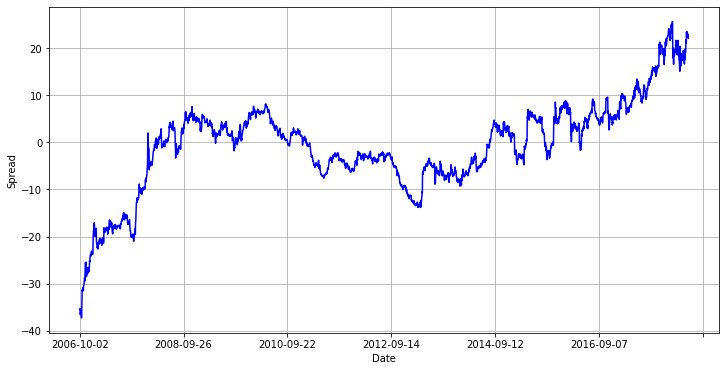

False
-------------------- #157 --------------------
----------------- MSFT & TXN -----------------
Hedge Ratio =  0.9153512600715978
Critical Value =  -4.5085838266865705
{'1%': -3.4325853286163874, '5%': -2.8625276197775373, '10%': -2.5672957374856296}


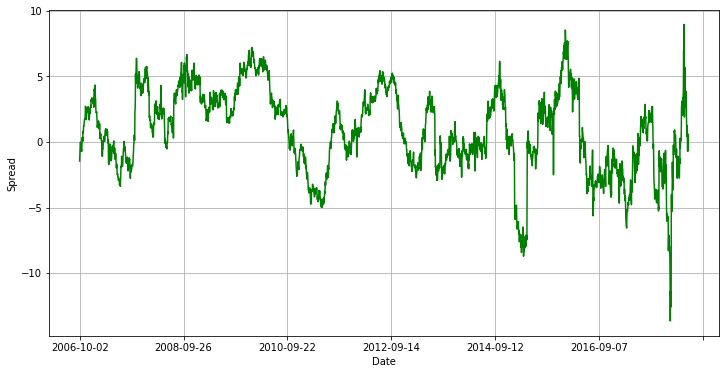

True
-------------------- #158 --------------------
----------------- MSI & NFLX -----------------
Hedge Ratio =  0.5129809397827301
Critical Value =  0.010095523125716169
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


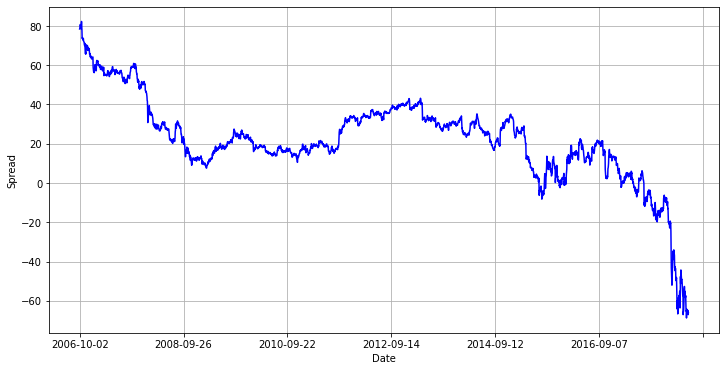

False
-------------------- #159 --------------------
----------------- MSI & PAYX -----------------
Hedge Ratio =  1.5665467131670188
Critical Value =  -4.392125824978915
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


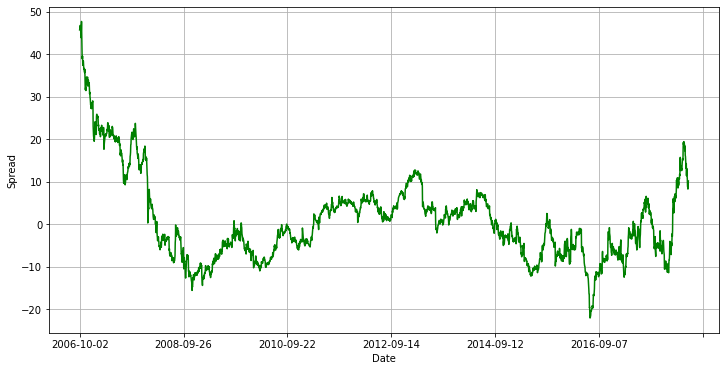

True
-------------------- #160 --------------------
----------------- MSI & SNPS -----------------
Hedge Ratio =  1.2419898170862815
Critical Value =  -4.541542374873441
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


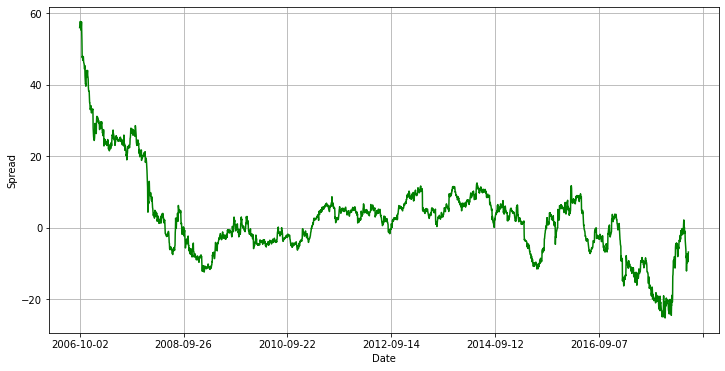

True
-------------------- #161 --------------------
----------------- MSI & TXN -----------------
Hedge Ratio =  1.2394877364488073
Critical Value =  -2.8762275768686805
{'1%': -3.4325853286163874, '5%': -2.8625276197775373, '10%': -2.5672957374856296}


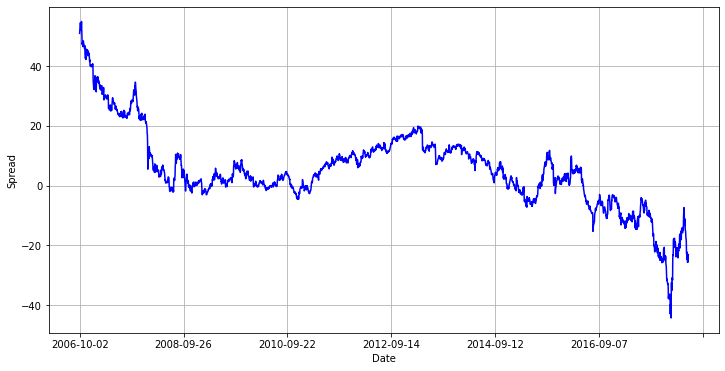

False
-------------------- #162 --------------------
----------------- MSI & VRSN -----------------
Hedge Ratio =  0.9157010138793714
Critical Value =  -4.041492000913313
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


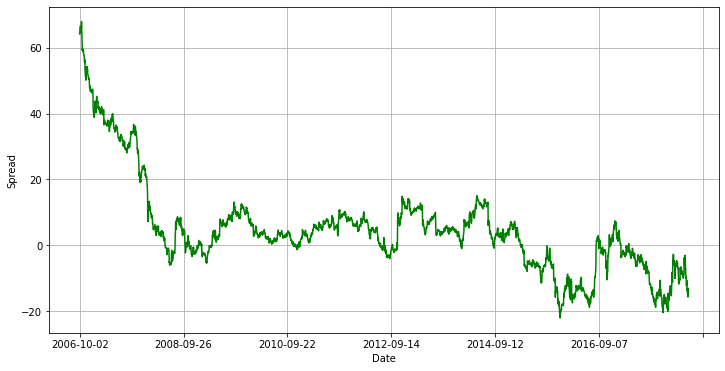

True
-------------------- #163 --------------------
----------------- MSI & XLNX -----------------
Hedge Ratio =  1.4608275349961362
Critical Value =  -4.510686664756763
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


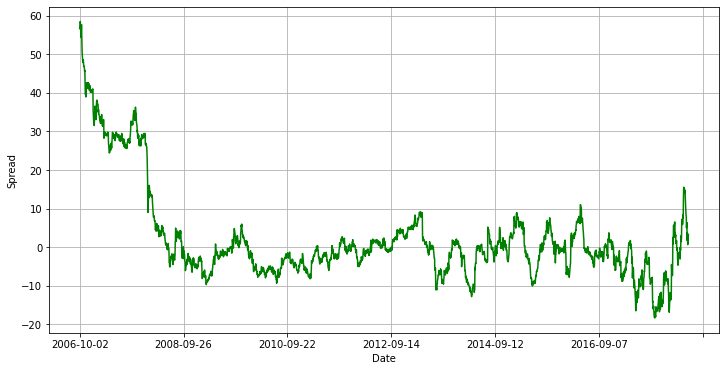

True
-------------------- #164 --------------------
----------------- ORCL & XLNX -----------------
Hedge Ratio =  0.8258714183673636
Critical Value =  -2.07796012079101
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


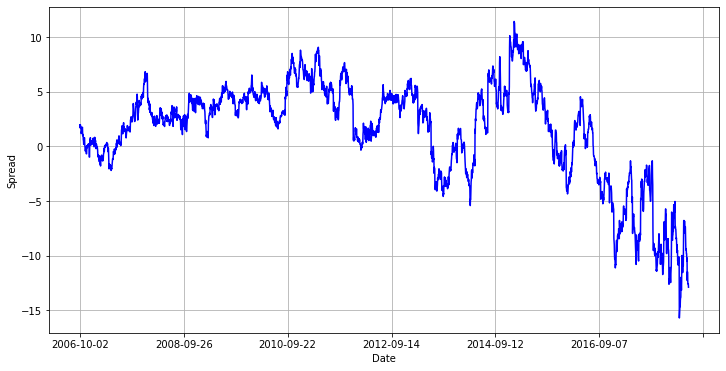

False
-------------------- #165 --------------------
----------------- SNPS & TXN -----------------
Hedge Ratio =  1.0025158557388378
Critical Value =  -2.5060841775740244
{'1%': -3.4325853286163874, '5%': -2.8625276197775373, '10%': -2.5672957374856296}


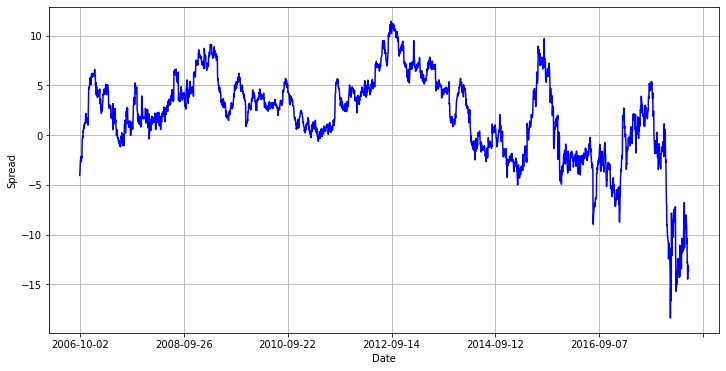

False
-------------------- #166 --------------------
----------------- VRSN & XLNX -----------------
Hedge Ratio =  1.5544938396803831
Critical Value =  -2.472779323595961
{'1%': -3.4325845647747215, '5%': -2.8625272824212167, '10%': -2.5672955578799543}


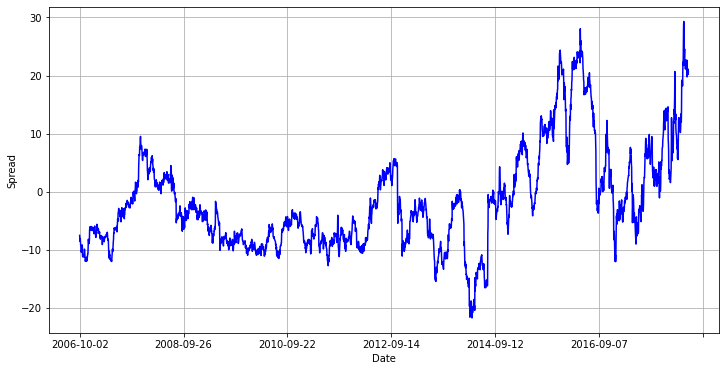

False
-------------------- #167 --------------------
----------------- WU & XLNX -----------------
Hedge Ratio =  0.3758034085461024
Critical Value =  -1.1056002547447914
{'1%': -3.4325853286163874, '5%': -2.8625276197775373, '10%': -2.5672957374856296}


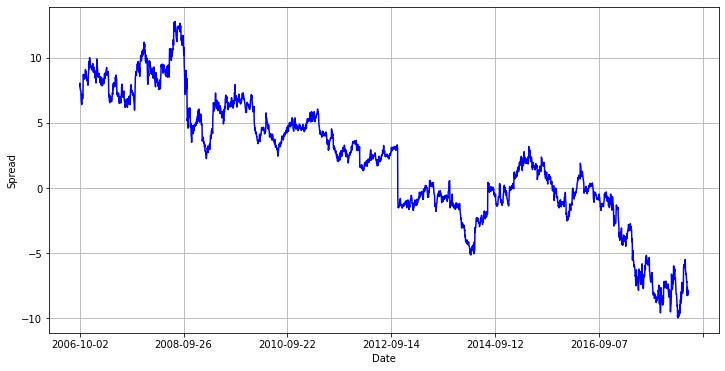

False
-------------------- #168 --------------------
----------------- WU & XRX -----------------
Hedge Ratio =  0.6278052340227602
Critical Value =  -2.8057871806198658
{'1%': -3.4325853286163874, '5%': -2.8625276197775373, '10%': -2.5672957374856296}


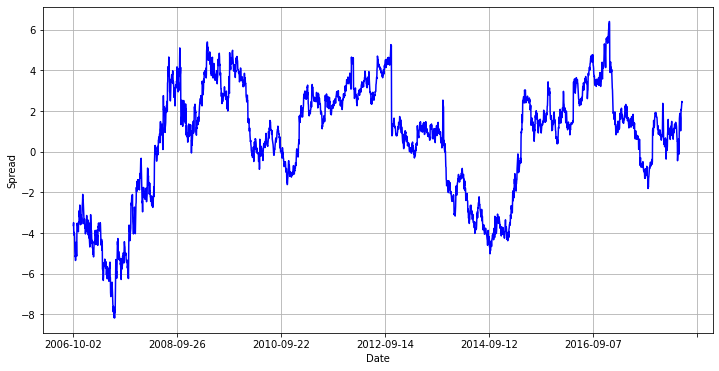

False


In [699]:
watched = []
for i in range(len(pairs)):
    print("-------------------- #{} --------------------".format(i))
    result = cointegration_test(pairs[i])
    print(result)
    if result == True:
        watched.append(pairs[i])

In [700]:
watched

[('AAPL', 'INTU'),
 ('ACN', 'ADI'),
 ('ACN', 'ADP'),
 ('ACN', 'APH'),
 ('ACN', 'FIS'),
 ('ACN', 'GOOG'),
 ('ACN', 'GOOGL'),
 ('ACN', 'IT'),
 ('ACN', 'MSI'),
 ('ACN', 'VRSN'),
 ('ADI', 'ADP'),
 ('ADI', 'APH'),
 ('ADI', 'EBAY'),
 ('ADI', 'FIS'),
 ('ADI', 'GOOG'),
 ('ADI', 'GOOGL'),
 ('ADI', 'MSI'),
 ('ADI', 'SNPS'),
 ('ADI', 'XLNX'),
 ('ADP', 'APH'),
 ('ADP', 'FIS'),
 ('ADP', 'GOOG'),
 ('ADP', 'GOOGL'),
 ('ADP', 'IT'),
 ('ADP', 'MSI'),
 ('ADP', 'VRSN'),
 ('ADP', 'XLNX'),
 ('ADSK', 'AMAT'),
 ('ADSK', 'LRCX'),
 ('ADSK', 'MCHP'),
 ('ADSK', 'MSFT'),
 ('ADSK', 'TXN'),
 ('AMD', 'ATVI'),
 ('AMD', 'CDNS'),
 ('AMD', 'CSCO'),
 ('AMD', 'DXC'),
 ('AMD', 'EA'),
 ('AMD', 'GLW'),
 ('AMD', 'GPN'),
 ('AMD', 'HPQ'),
 ('AMD', 'JNPR'),
 ('AMD', 'KLAC'),
 ('AMD', 'LRCX'),
 ('AMD', 'MCHP'),
 ('AMD', 'MSFT'),
 ('AMD', 'NFLX'),
 ('AMD', 'NTAP'),
 ('AMD', 'NVDA'),
 ('AMD', 'SNPS'),
 ('AMD', 'STX'),
 ('AMD', 'TXN'),
 ('AMD', 'WDC'),
 ('AMD', 'WU'),
 ('AMD', 'XRX'),
 ('ANSS', 'MSI'),
 ('ANSS', 'XLNX'),
 ('APH', 'F

In [701]:
len(watched)

92

# Trading signals

In [158]:
print(test_close[:400])

symbol           AAPL         ACN        ADBE         ADI         ADP  \
Date                                                                    
2018-05-23  45.607460  148.615402  243.910004   88.897957  121.222755   
2018-05-24  45.556606  148.883347  245.149994   89.510139  122.075523   
2018-05-25  45.660728  149.266098  243.559998   89.896271  122.431610   
2018-05-29  45.496067  146.921707  242.190002   88.897957  121.756905   
2018-05-30  45.399216  149.304337  247.399994   89.453606  122.412880   
...               ...         ...         ...         ...         ...   
2019-12-17  69.398575  198.889069  322.850006  115.922874  163.483780   
2019-12-18  69.232750  201.196732  324.380005  114.147247  162.745621   
2019-12-19  69.302048  203.680435  327.630005  115.805786  163.891739   
2019-12-20  69.158508  206.418335  327.609985  116.898476  166.174194   
2019-12-23  70.287064  206.154312  328.950012  116.264328  165.134949   

symbol             ADS        ADSK       AKAM     

In [24]:
def zscore(series):
    return (series - series.mean()) / np.std(series)

In [231]:
def set_signals(pair, threshold=1.5, exit_threshold=3, show=False):
    exit_threshold = threshold + 1
    signals = pd.DataFrame()
    signals[pair[0]] = test_close[pair[0]] 
    signals[pair[1]] = test_close[pair[1]]
    ratios = signals[pair[0]] / signals[pair[1]]
    #ratios = signals[pair[0]] - pair[2] * signals[pair[1]]

    signals['s'] = signals[pair[0]] - pair[2] * signals[pair[1]]
    signals['z'] = zscore(ratios)
    signals['z upper limit'] = np.mean(signals['z']) + threshold * np.std(signals['z'])
    signals['z upper limit exit'] = np.mean(signals['z']) + exit_threshold * np.std(signals['z'])
    signals['z lower limit'] = np.mean(signals['z']) - threshold * np.std(signals['z'])
    signals['z lower limit exit'] = np.mean(signals['z']) - threshold * np.std(signals['z'])

    signals['signals1'] = 0
    signals['signals1'] = np.select([signals['z'] > signals['z upper limit'], signals['z'] < signals['z lower limit']], [-1, 1], default=0)

    signals['positions1'] = signals['signals1'].diff()
    signals['positions1'][0] = signals['signals1'][0]
    signals['signals2'] = -signals['signals1']
    signals['positions2'] = signals['signals2'].diff()
    signals['positions2'][0] = signals['signals2'][0]
    
    if show == False:
        return signals

    print(signals.head(3).append(signals.tail(3)))

    fig = plt.figure(figsize=(15,8))
    bx = fig.add_subplot(111)   
    bx2 = bx.twinx()
    
    x_dates = test_close.index.get_level_values('Date')
    start = pd.Timestamp(x_dates[0])
    end = pd.Timestamp(x_dates[len(x_dates) - 1])
    
    x_dates = np.linspace(start.value, end.value, 12)
    x_dates = pd.to_datetime(x_dates).strftime('%Y-%m-%d')

    l1, = bx.plot(signals[pair[0]], c='#4abdac')
    l2, = bx2.plot(signals[pair[1]], c='#907163')
    
    u1, = bx.plot(signals[pair[0]][signals['positions1'] == 1], lw=0, marker='^', markersize=8, c='g',alpha=0.7)
    
    d1, = bx.plot(signals[pair[0]][signals['positions1'] == -1], lw=0,marker='v',markersize=8, c='r',alpha=0.7)

    u2, = bx2.plot(signals[pair[1]][signals['positions2'] == 1], lw=0,marker=2,markersize=9, c='g',alpha=0.9, markeredgewidth=3)

    d2, = bx2.plot(signals[pair[1]][signals['positions2'] == -1], lw=0,marker=3,markersize=9, c='r',alpha=0.9,markeredgewidth=3)

    bx.set_ylabel(pair[0],)
    bx2.set_ylabel(pair[1], rotation=270)
    bx.yaxis.labelpad=15
    bx2.yaxis.labelpad=15
    bx.set_xlabel('Date')
    bx.xaxis.labelpad=15
    
    bx2.set_xticks(x_dates)

    plt.legend([l1,l2,u1,d1,u2,d2], [pair[0], pair[1],'LONG {}'.format(pair[0]),
               'SHORT {}'.format(pair[0]),
               'LONG {}'.format(pair[1]),
               'SHORT {}'.format(pair[1])], loc ='best')

    plt.title('Pair Trading - Trading Signals and Position')
    #plt.xlabel('Date')
    plt.grid(True)
    plt.tight_layout()
    plt.show()
        
    return signals

In [232]:
pd.options.mode.chained_assignment = None

level=0.05, z=0.25
169
Number of days = 732
CAGR = 20.730%


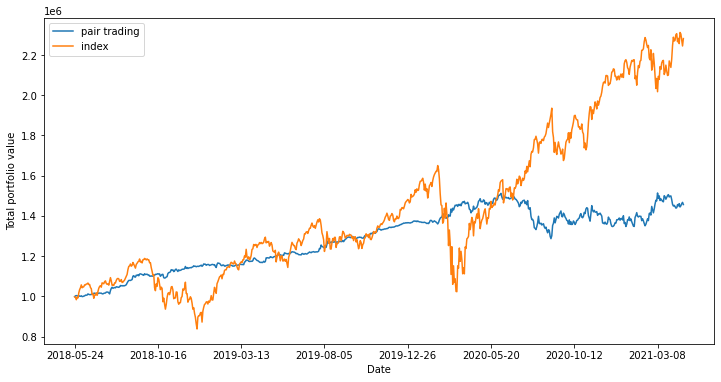

level=0.05, z=0.5
169
Number of days = 732
CAGR = 21.111%


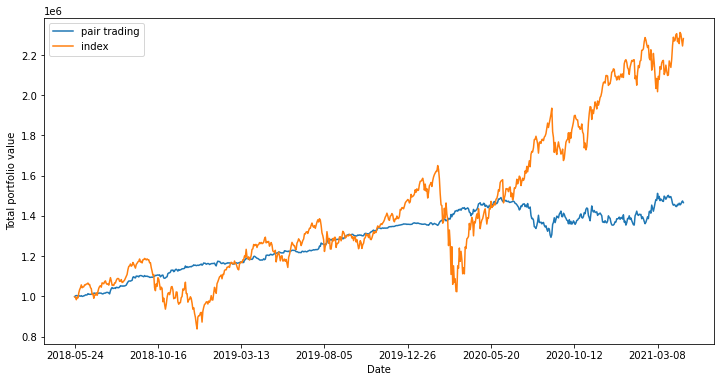

level=0.05, z=0.75
169
Number of days = 732
CAGR = 21.195%


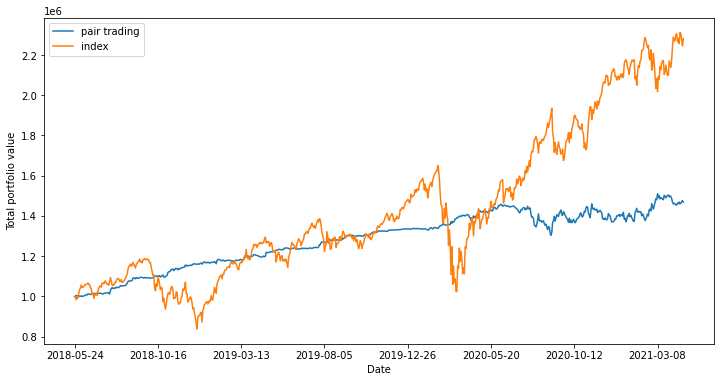

level=0.05, z=1.0
169
Number of days = 732
CAGR = 18.617%


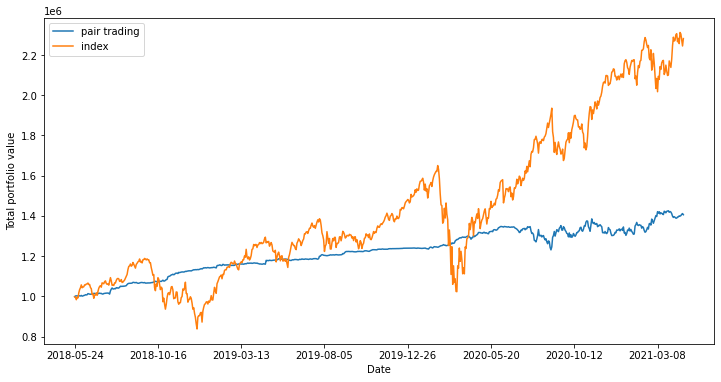

level=0.05, z=1.25
169
Number of days = 732
CAGR = 15.462%


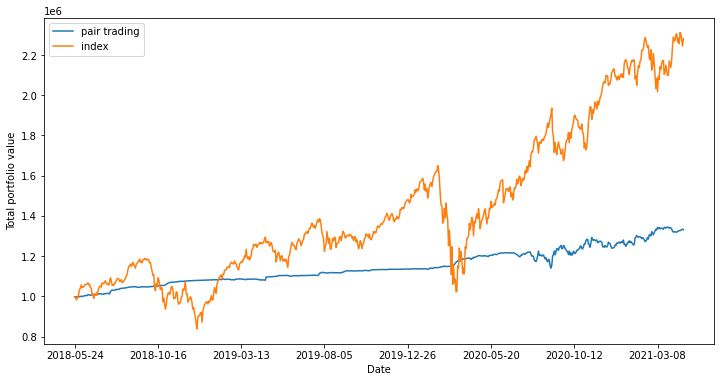

level=0.05, z=1.5
169
Number of days = 732
CAGR = 13.865%


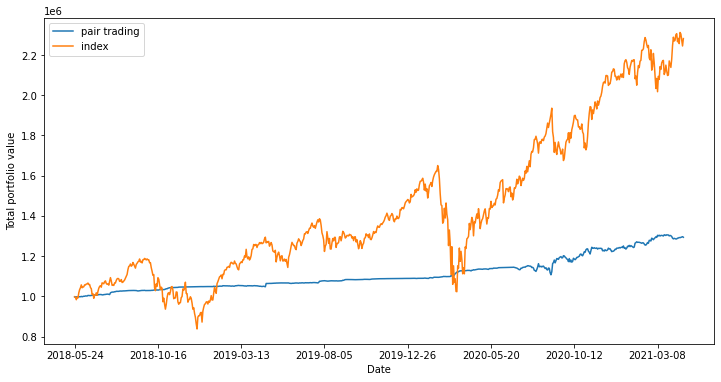

level=0.05, z=1.75
169
Number of days = 732
CAGR = 10.056%


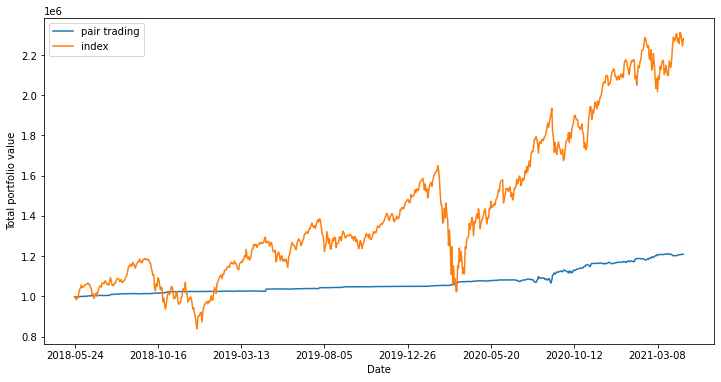

level=0.05, z=2.0
169
Number of days = 732
CAGR = 6.111%


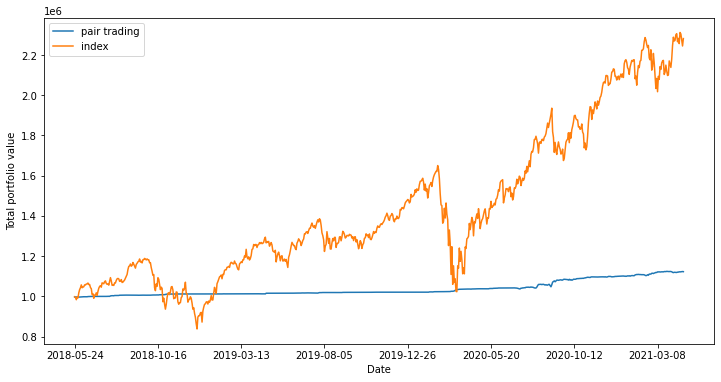

level=0.05, z=2.25
169
Number of days = 732
CAGR = 3.151%


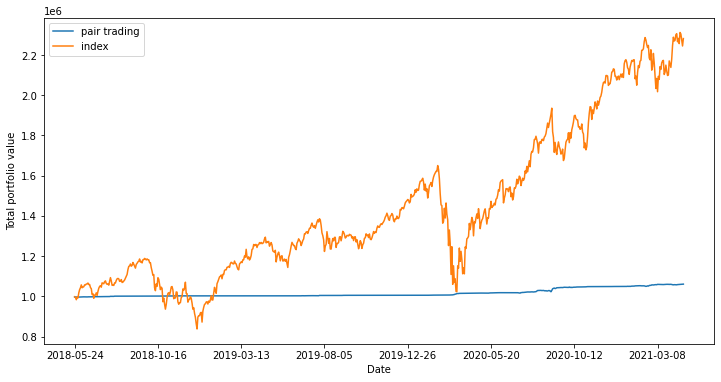

level=0.05, z=2.5
169
Number of days = 732
CAGR = 1.430%


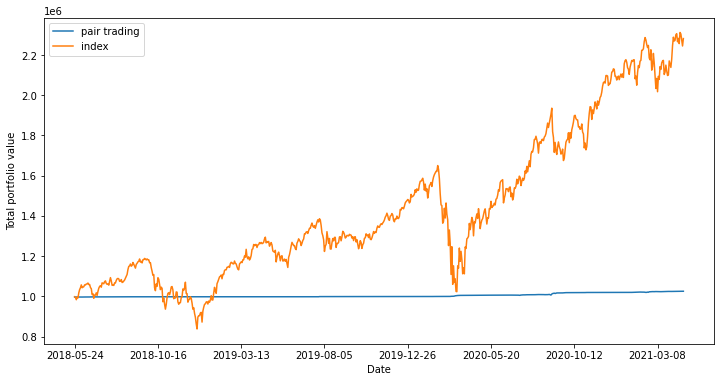

level=0.05, z=2.75
169
Number of days = 732
CAGR = 0.789%


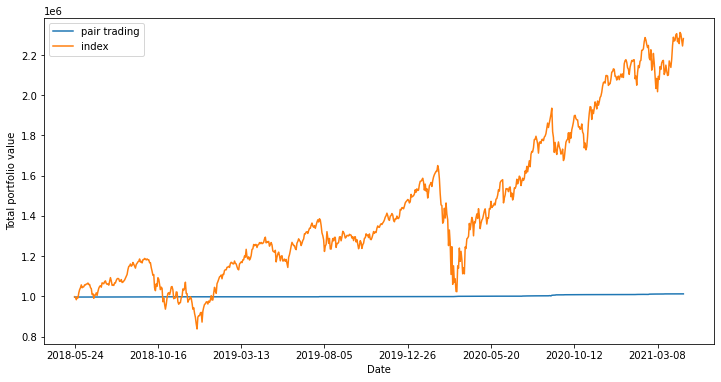

level=0.05, z=3.0
169
Number of days = 732
CAGR = 0.319%


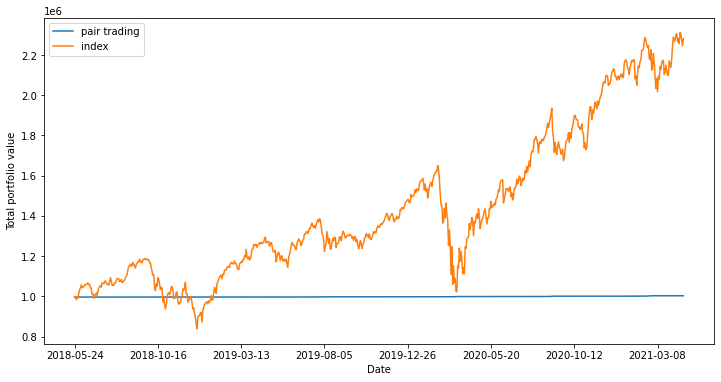

level=0.045000000000000005, z=0.25
162
Number of days = 732
CAGR = 21.003%


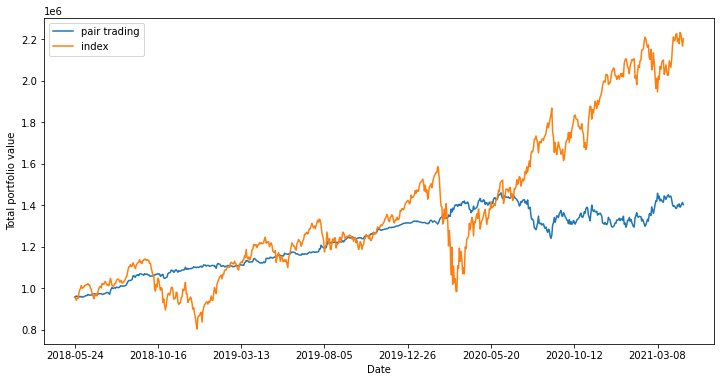

level=0.045000000000000005, z=0.5
162
Number of days = 732
CAGR = 21.186%


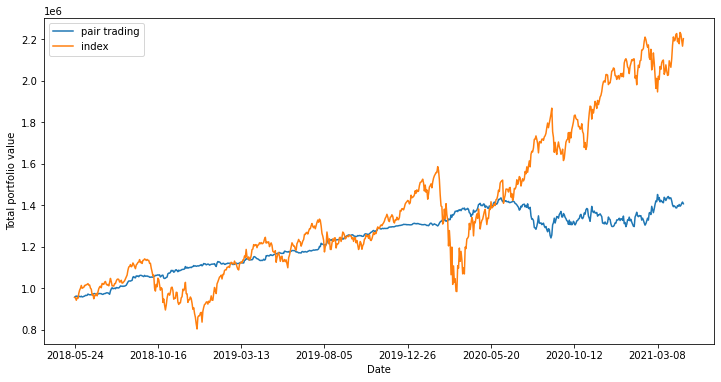

level=0.045000000000000005, z=0.75
162
Number of days = 732
CAGR = 21.531%


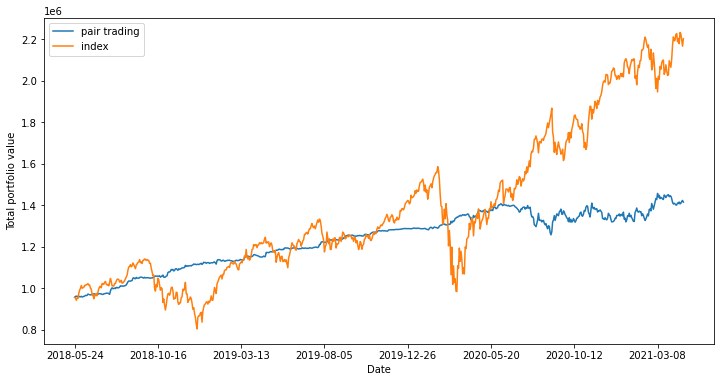

level=0.045000000000000005, z=1.0
162
Number of days = 732
CAGR = 18.818%


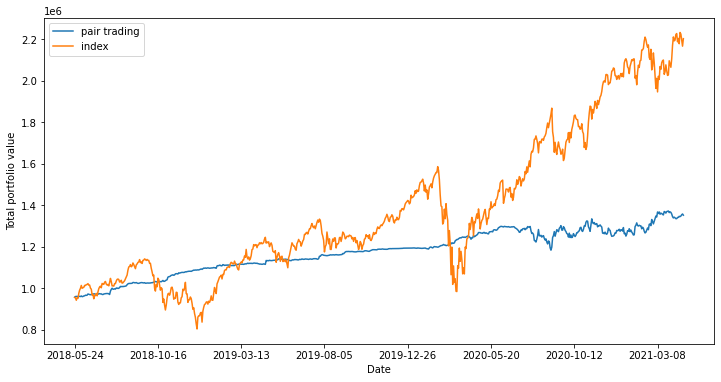

level=0.045000000000000005, z=1.25
162
Number of days = 732
CAGR = 15.542%


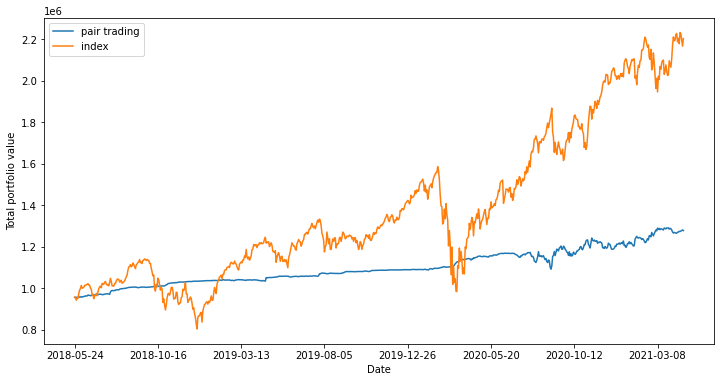

level=0.045000000000000005, z=1.5
162
Number of days = 732
CAGR = 14.048%


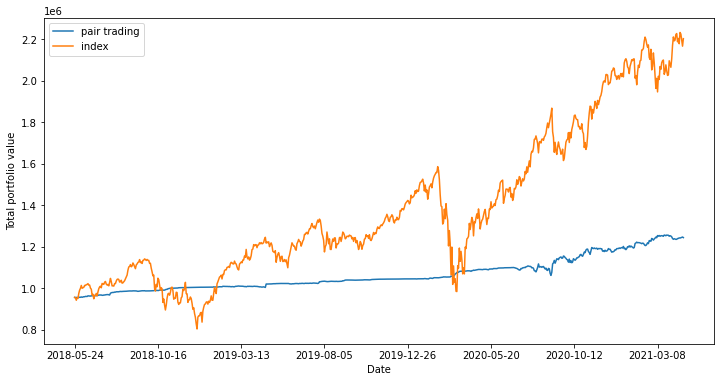

level=0.045000000000000005, z=1.75
162
Number of days = 732
CAGR = 10.201%


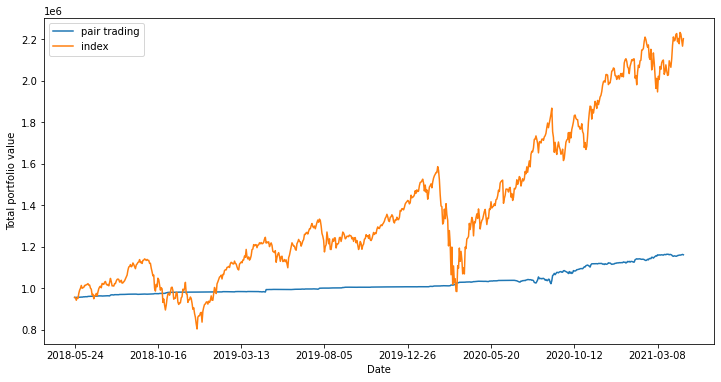

level=0.045000000000000005, z=2.0
162
Number of days = 732
CAGR = 6.140%


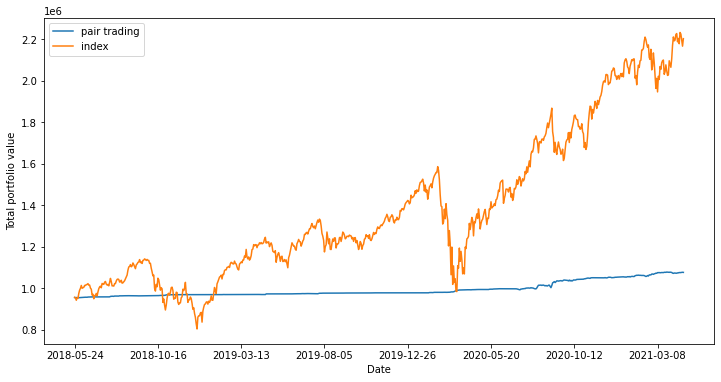

level=0.045000000000000005, z=2.25
162
Number of days = 732
CAGR = 3.200%


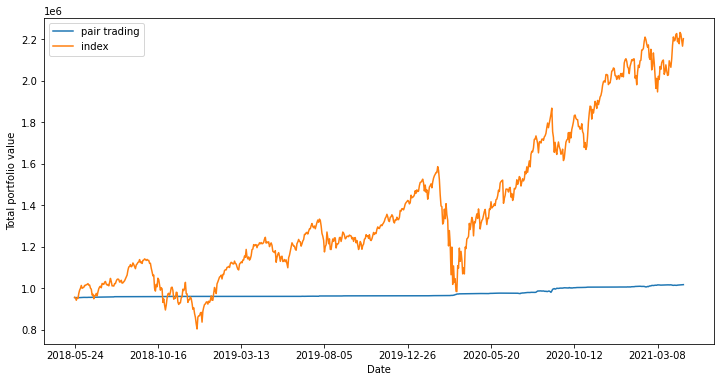

level=0.045000000000000005, z=2.5
162
Number of days = 732
CAGR = 1.458%


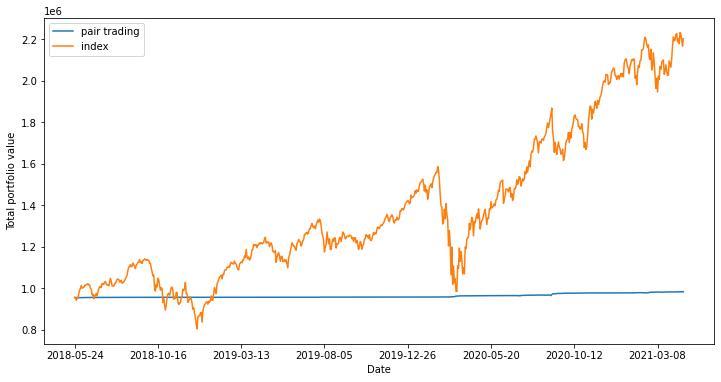

level=0.045000000000000005, z=2.75
162
Number of days = 732
CAGR = 0.778%


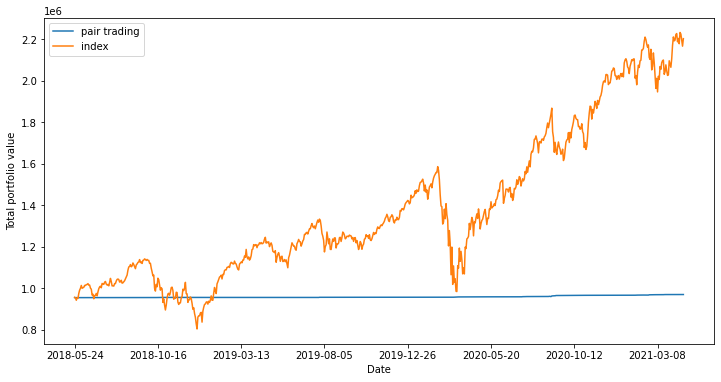

level=0.045000000000000005, z=3.0
162
Number of days = 732
CAGR = 0.327%


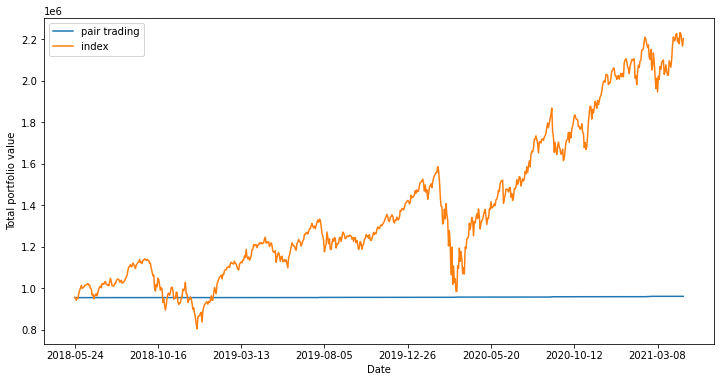

level=0.04000000000000001, z=0.25
153
Number of days = 732
CAGR = 21.594%


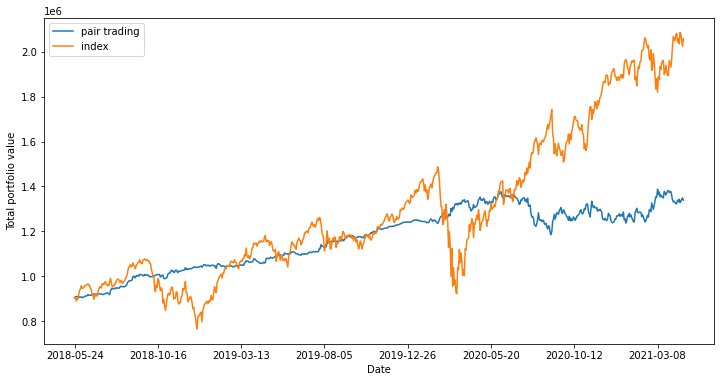

level=0.04000000000000001, z=0.5
153
Number of days = 732
CAGR = 21.775%


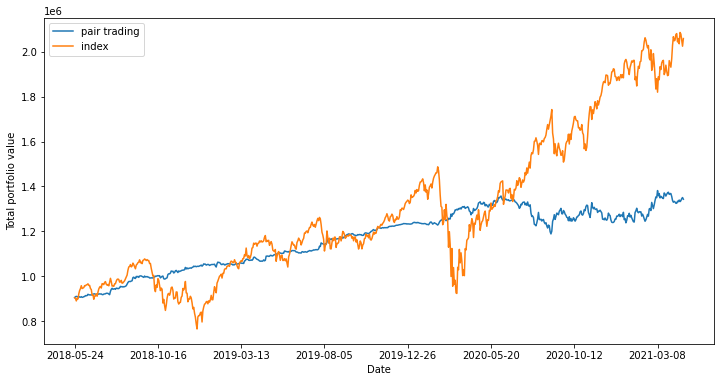

level=0.04000000000000001, z=0.75
153
Number of days = 732
CAGR = 21.615%


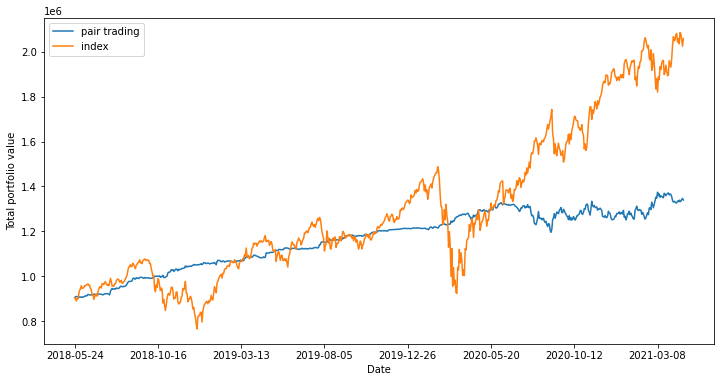

level=0.04000000000000001, z=1.0
153
Number of days = 732
CAGR = 18.891%


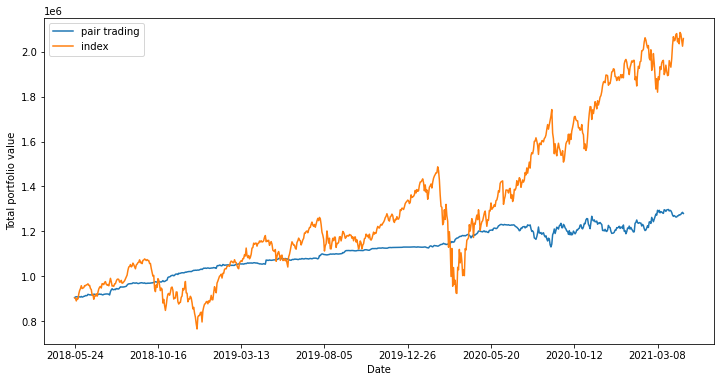

level=0.04000000000000001, z=1.25
153
Number of days = 732
CAGR = 15.740%


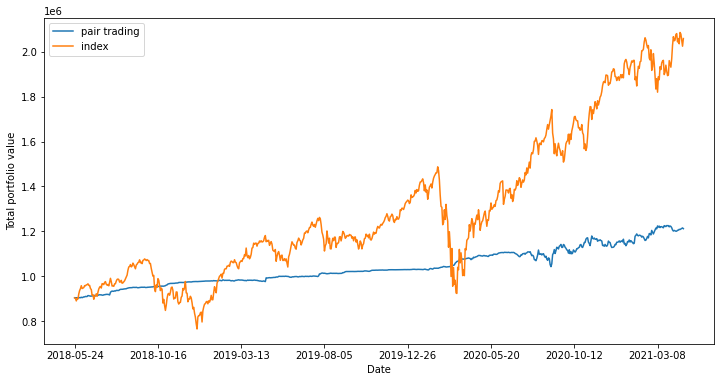

level=0.04000000000000001, z=1.5
153
Number of days = 732
CAGR = 13.977%


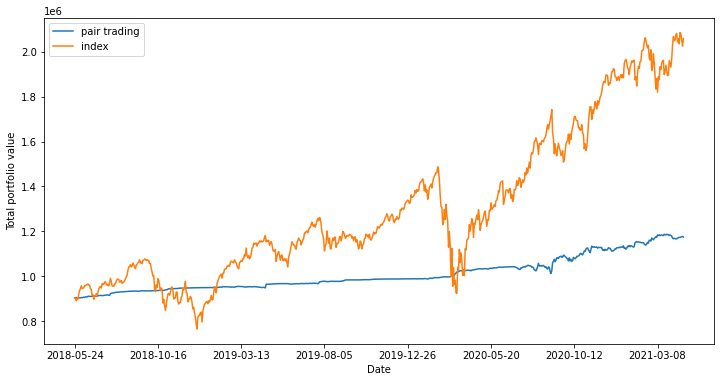

level=0.04000000000000001, z=1.75
153
Number of days = 732
CAGR = 9.853%


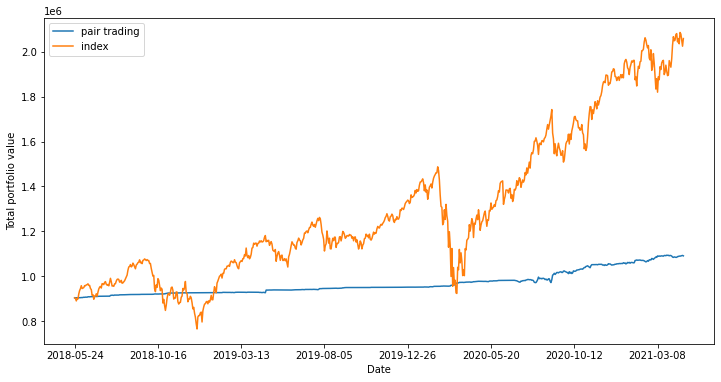

level=0.04000000000000001, z=2.0
153
Number of days = 732
CAGR = 5.980%


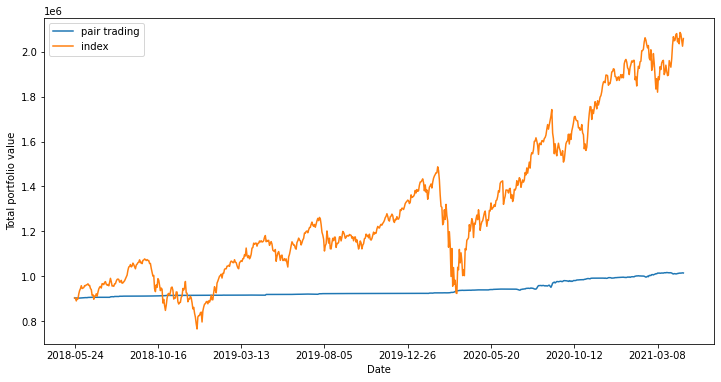

level=0.04000000000000001, z=2.25
153
Number of days = 732
CAGR = 3.106%


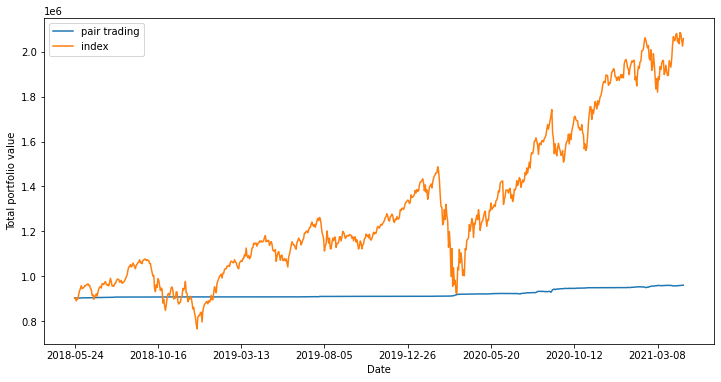

level=0.04000000000000001, z=2.5
153
Number of days = 732
CAGR = 1.479%


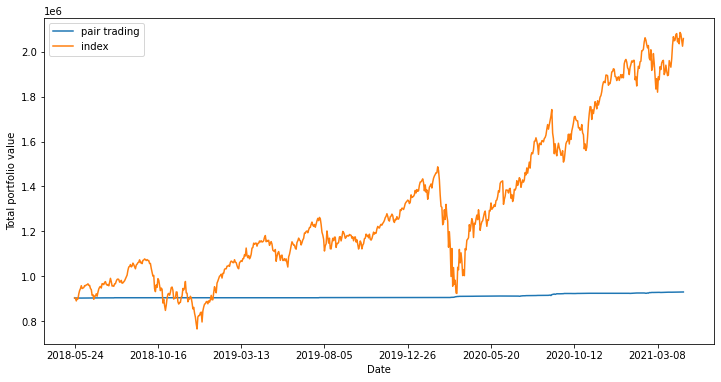

level=0.04000000000000001, z=2.75
153
Number of days = 732
CAGR = 0.727%


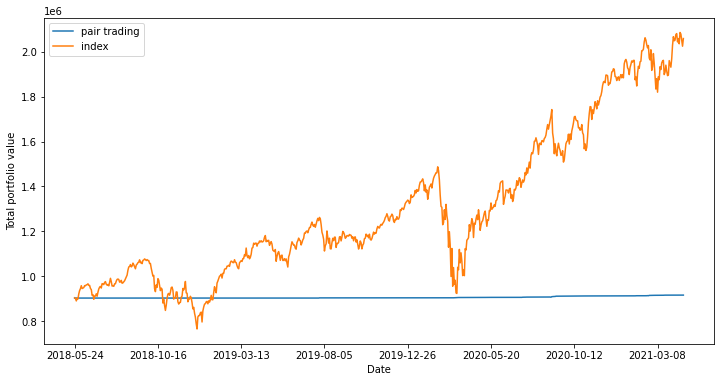

level=0.04000000000000001, z=3.0
153
Number of days = 732
CAGR = 0.306%


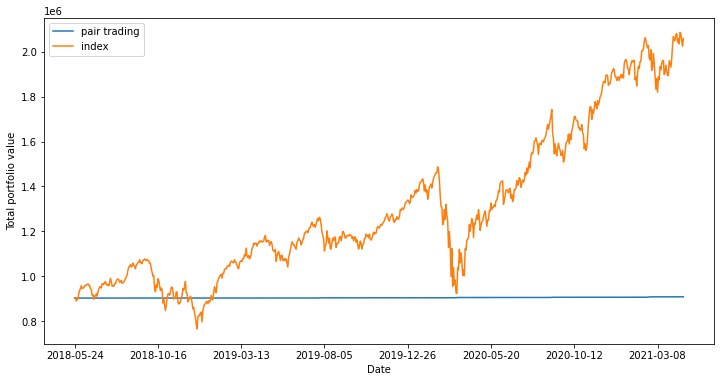

level=0.03500000000000001, z=0.25
138
Number of days = 732
CAGR = 21.159%


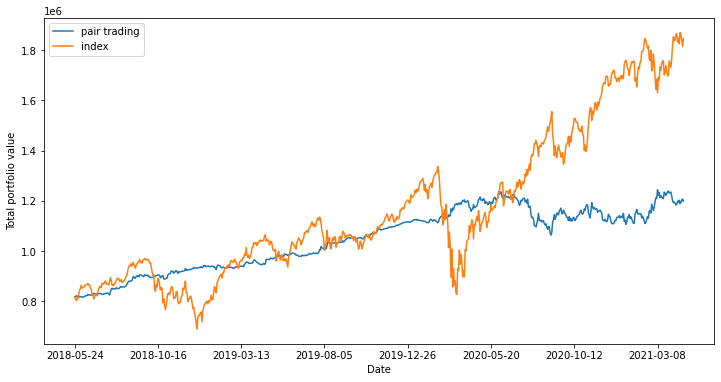

level=0.03500000000000001, z=0.5
138
Number of days = 732
CAGR = 21.095%


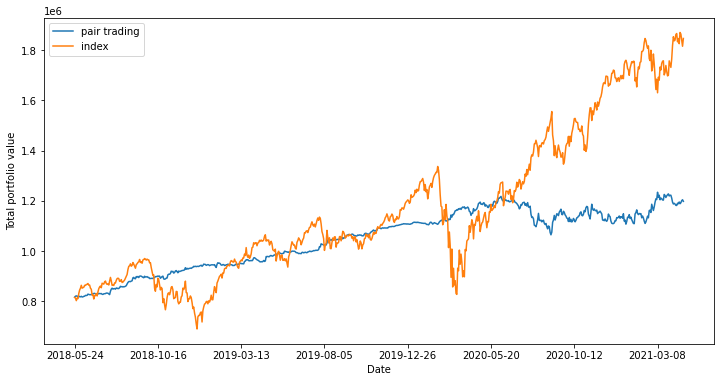

level=0.03500000000000001, z=0.75
138
Number of days = 732
CAGR = 20.920%


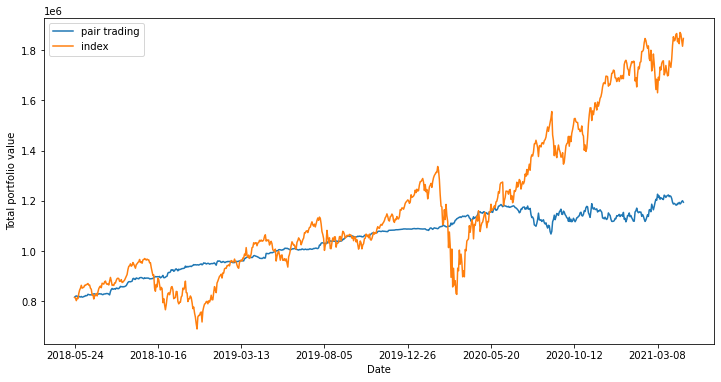

level=0.03500000000000001, z=1.0
138
Number of days = 732
CAGR = 18.365%


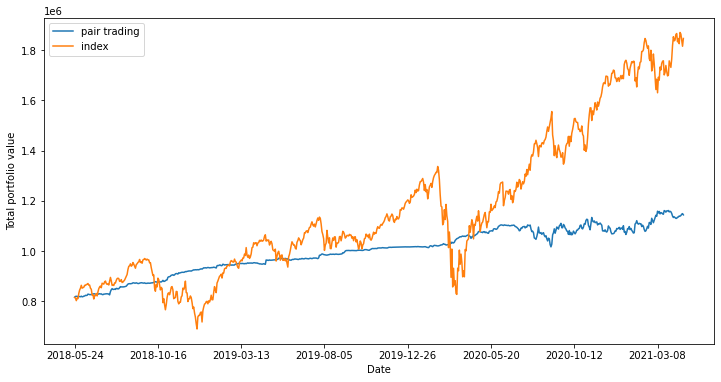

level=0.03500000000000001, z=1.25
138
Number of days = 732
CAGR = 15.438%


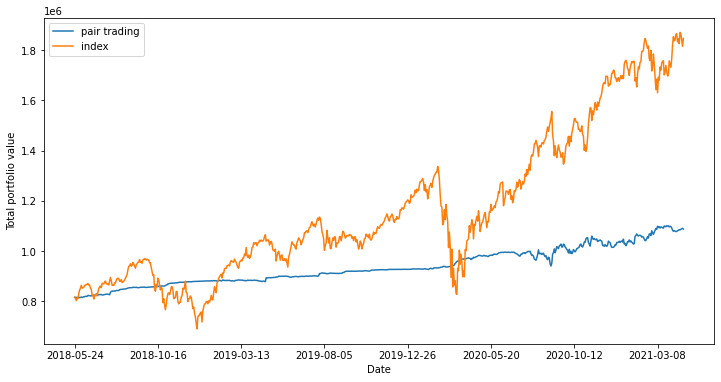

level=0.03500000000000001, z=1.5
138
Number of days = 732
CAGR = 13.663%


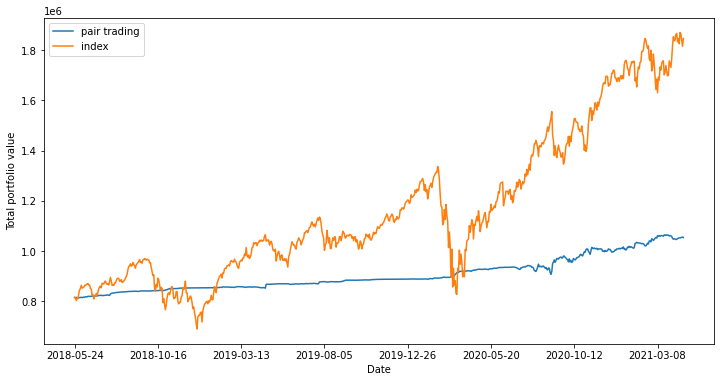

level=0.03500000000000001, z=1.75
138
Number of days = 732
CAGR = 9.676%


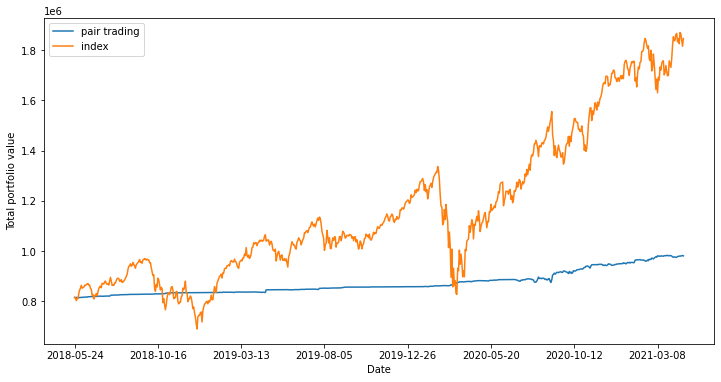

level=0.03500000000000001, z=2.0
138
Number of days = 732
CAGR = 5.697%


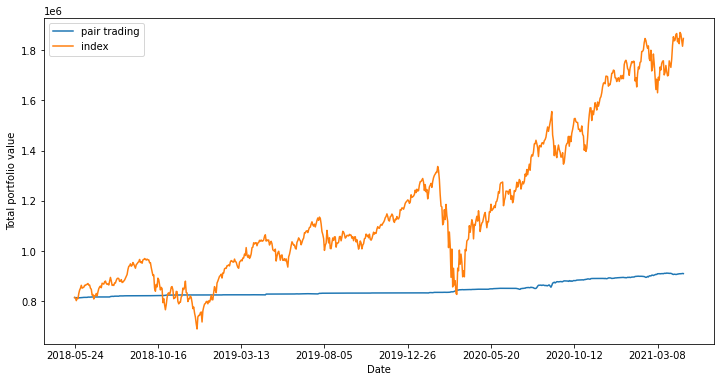

level=0.03500000000000001, z=2.25
138
Number of days = 732
CAGR = 3.090%


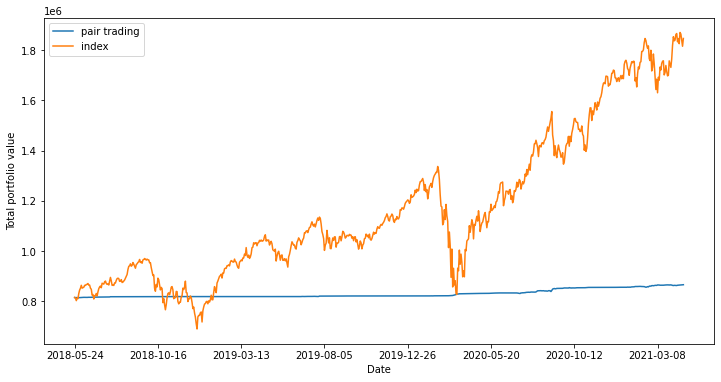

level=0.03500000000000001, z=2.5
138
Number of days = 732
CAGR = 1.445%


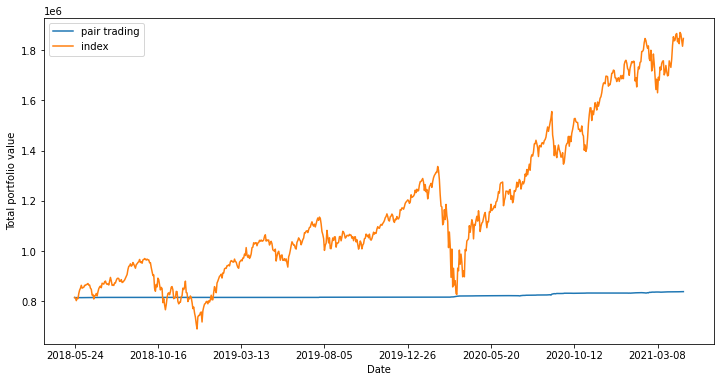

level=0.03500000000000001, z=2.75
138
Number of days = 732
CAGR = 0.705%


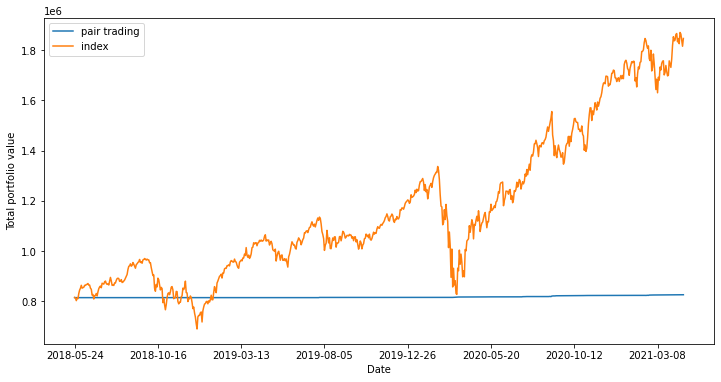

level=0.03500000000000001, z=3.0
138
Number of days = 732
CAGR = 0.333%


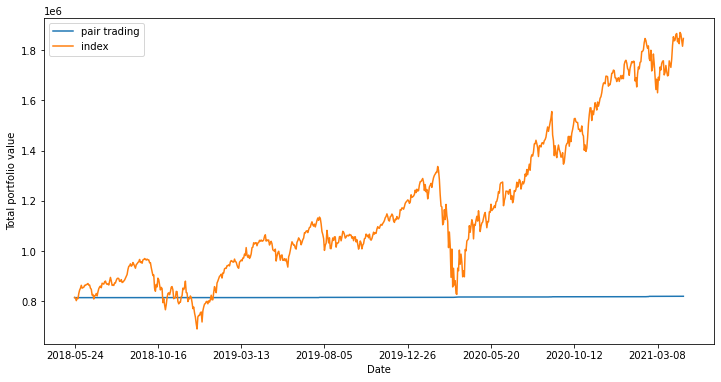

level=0.03000000000000001, z=0.25
126
Number of days = 732
CAGR = 21.311%


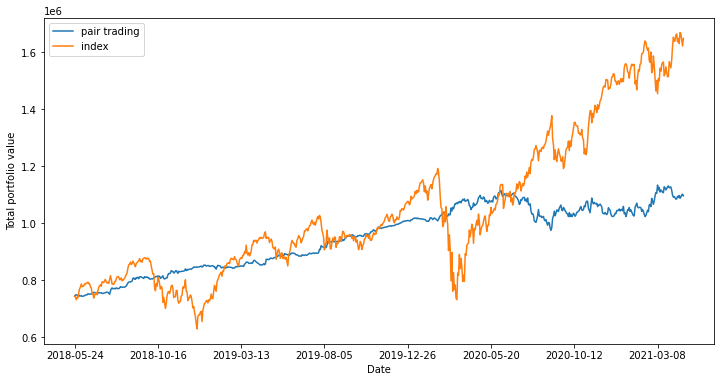

level=0.03000000000000001, z=0.5
126
Number of days = 732
CAGR = 21.112%


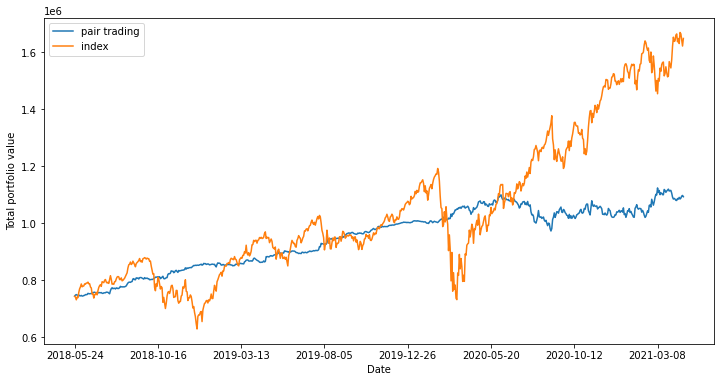

level=0.03000000000000001, z=0.75
126
Number of days = 732
CAGR = 20.861%


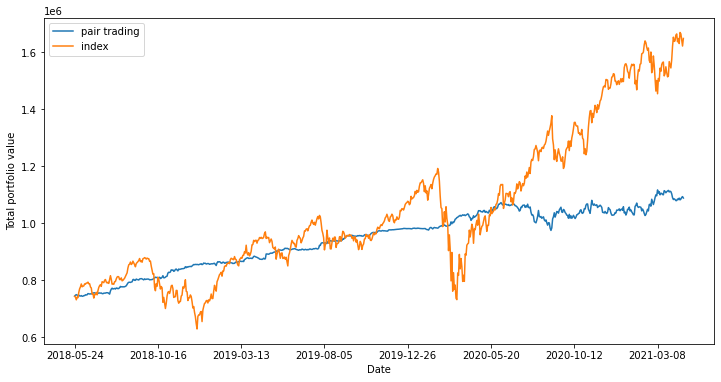

level=0.03000000000000001, z=1.0
126
Number of days = 732
CAGR = 18.430%


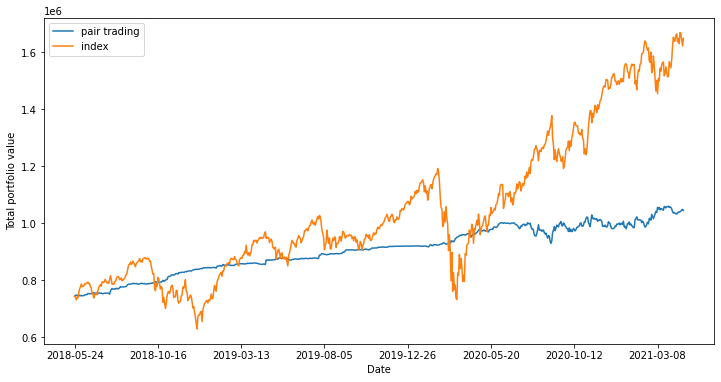

level=0.03000000000000001, z=1.25
126
Number of days = 732
CAGR = 15.067%


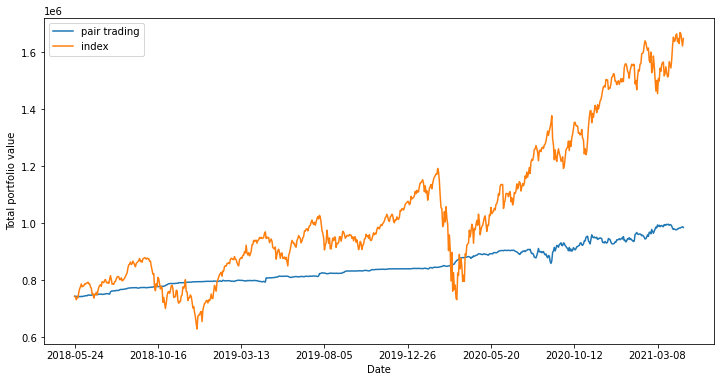

level=0.03000000000000001, z=1.5
126
Number of days = 732
CAGR = 13.358%


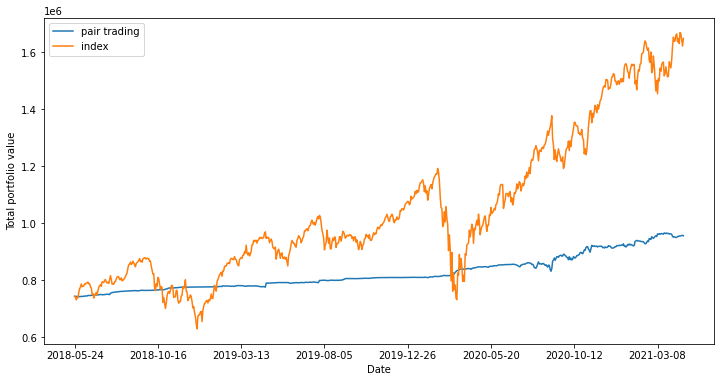

level=0.03000000000000001, z=1.75
126
Number of days = 732
CAGR = 9.431%


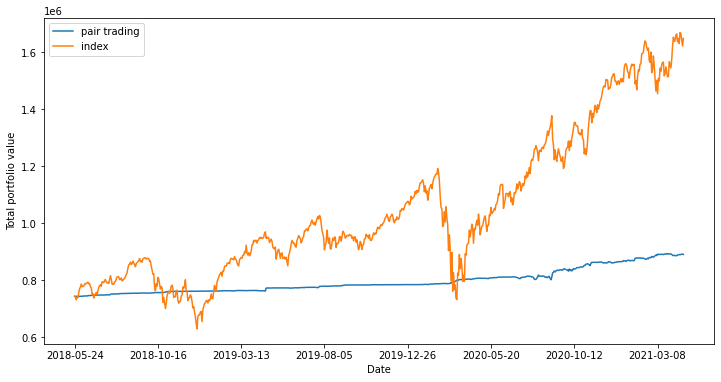

level=0.03000000000000001, z=2.0
126
Number of days = 732
CAGR = 5.448%


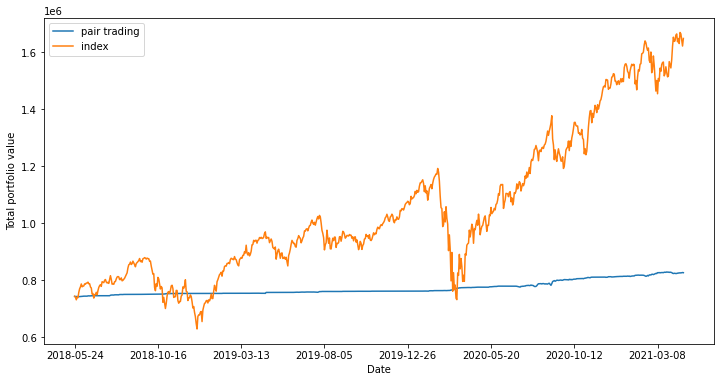

level=0.03000000000000001, z=2.25
126
Number of days = 732
CAGR = 3.060%


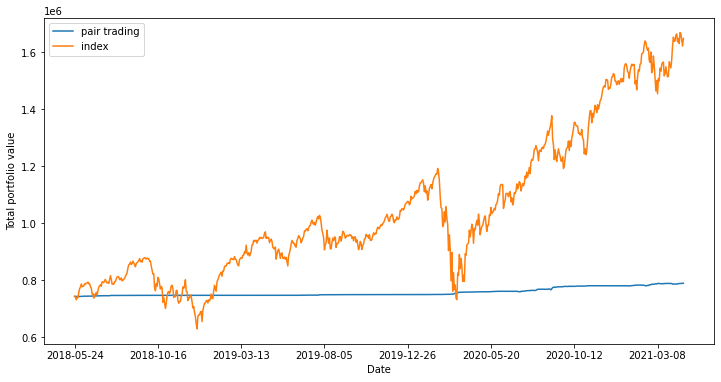

level=0.03000000000000001, z=2.5
126
Number of days = 732
CAGR = 1.450%


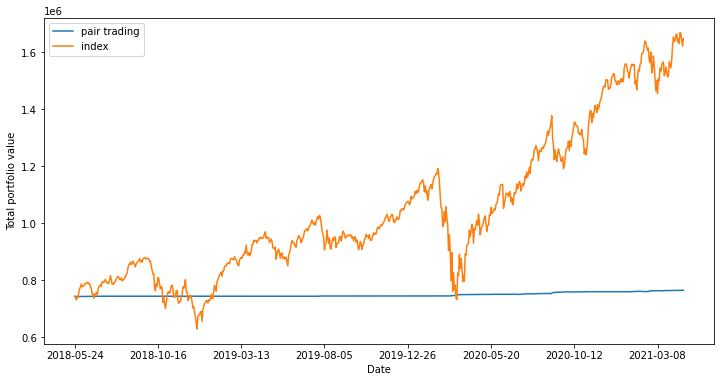

level=0.03000000000000001, z=2.75
126
Number of days = 732
CAGR = 0.742%


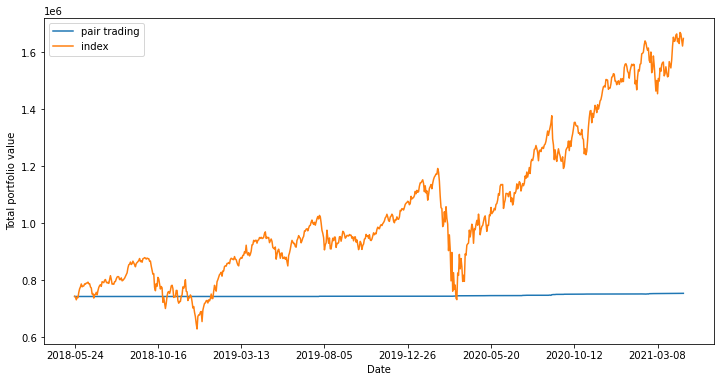

level=0.03000000000000001, z=3.0
126
Number of days = 732
CAGR = 0.356%


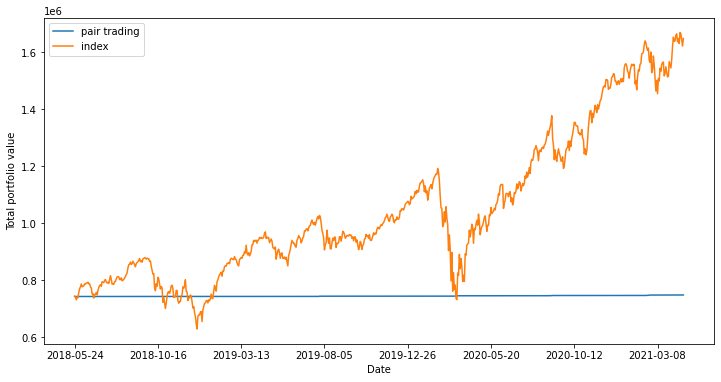

level=0.02500000000000001, z=0.25
113
Number of days = 732
CAGR = 20.919%


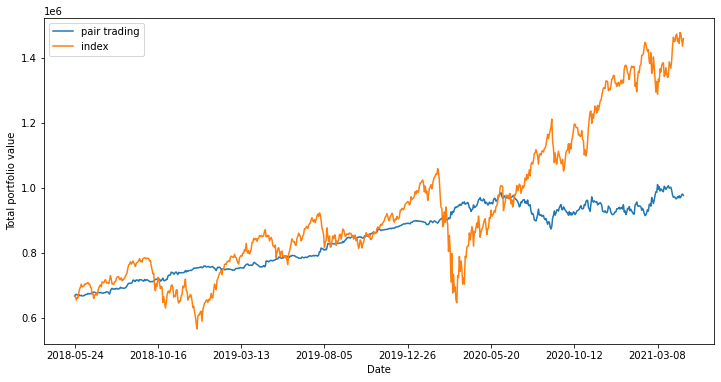

level=0.02500000000000001, z=0.5
113
Number of days = 732
CAGR = 21.125%


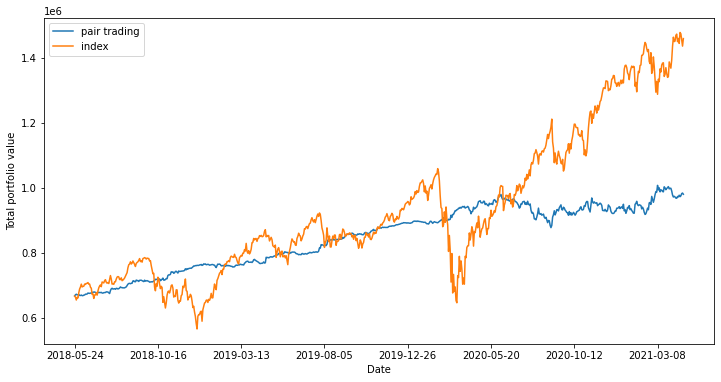

level=0.02500000000000001, z=0.75
113
Number of days = 732
CAGR = 20.981%


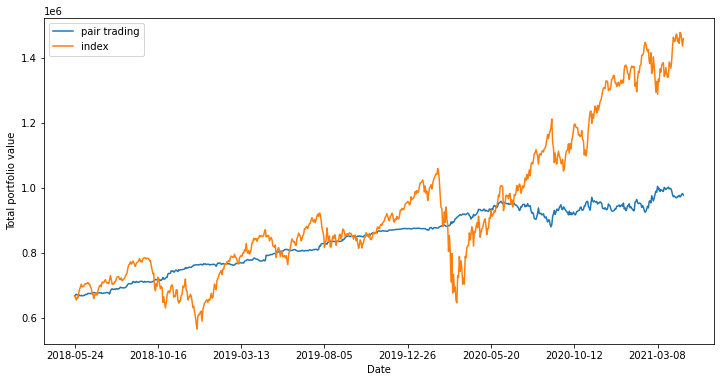

level=0.02500000000000001, z=1.0
113
Number of days = 732
CAGR = 17.919%


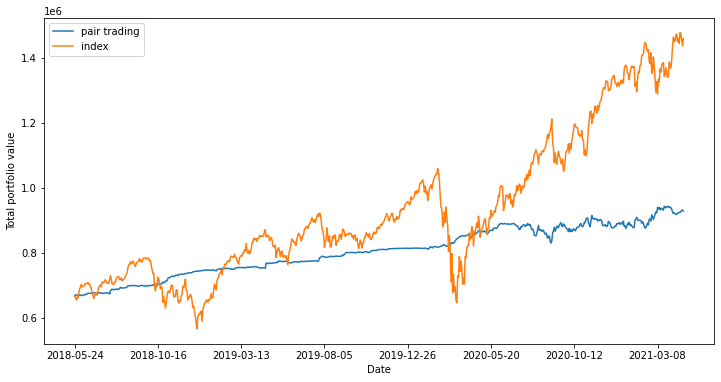

level=0.02500000000000001, z=1.25
113
Number of days = 732
CAGR = 15.022%


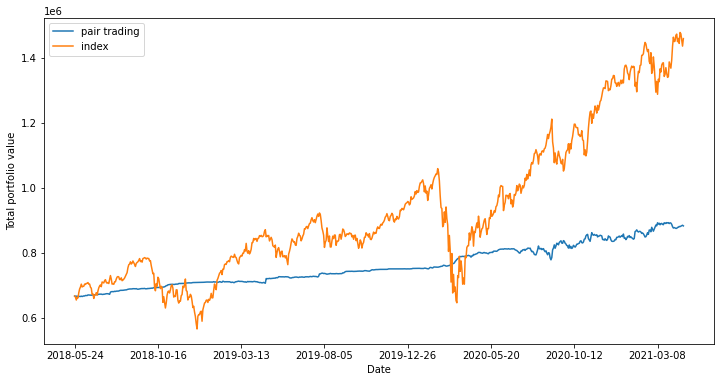

level=0.02500000000000001, z=1.5
113
Number of days = 732
CAGR = 13.259%


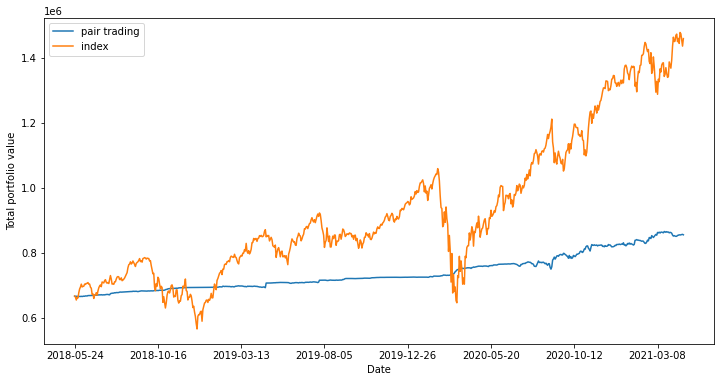

level=0.02500000000000001, z=1.75
113
Number of days = 732
CAGR = 9.539%


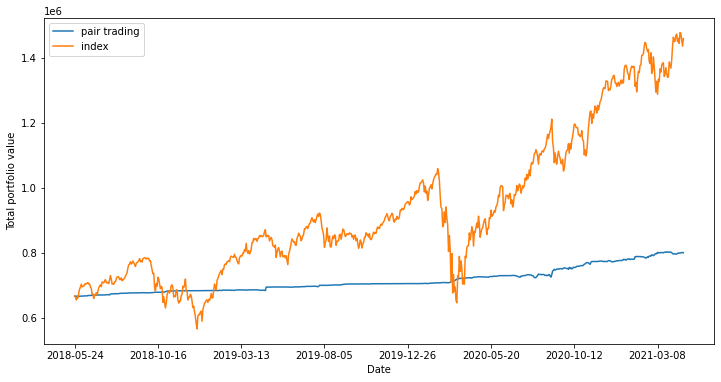

level=0.02500000000000001, z=2.0
113
Number of days = 732
CAGR = 5.305%


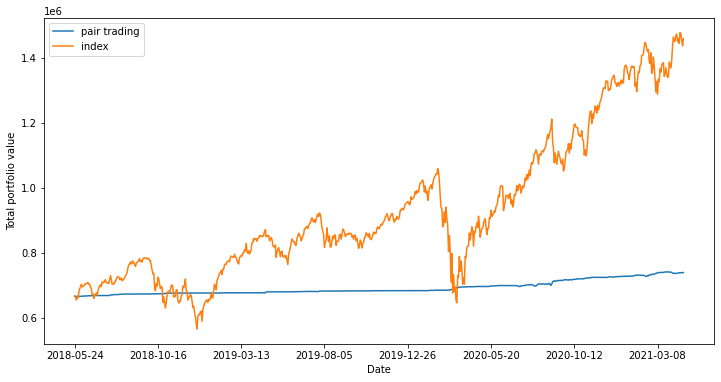

level=0.02500000000000001, z=2.25
113
Number of days = 732
CAGR = 3.008%


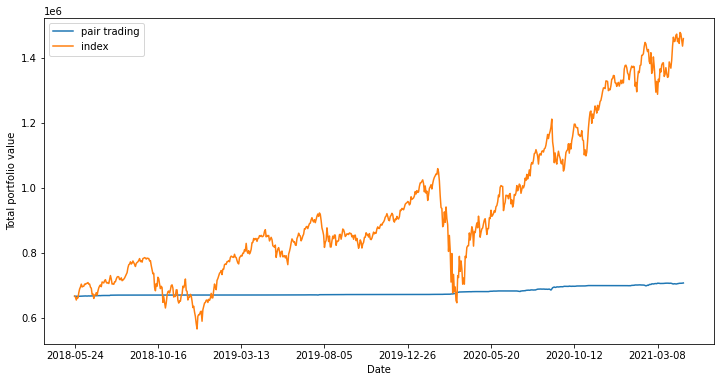

level=0.02500000000000001, z=2.5
113
Number of days = 732
CAGR = 1.549%


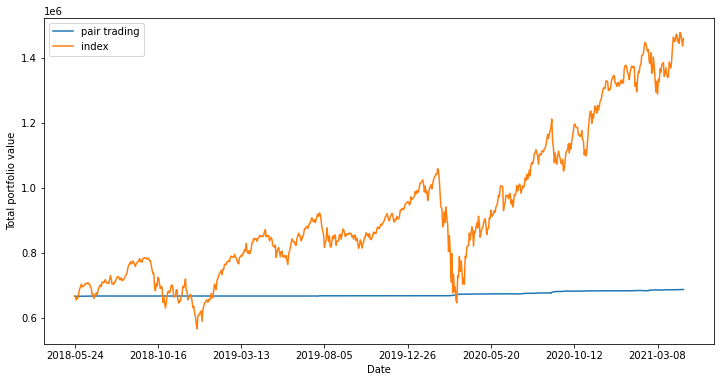

level=0.02500000000000001, z=2.75
113
Number of days = 732
CAGR = 0.812%


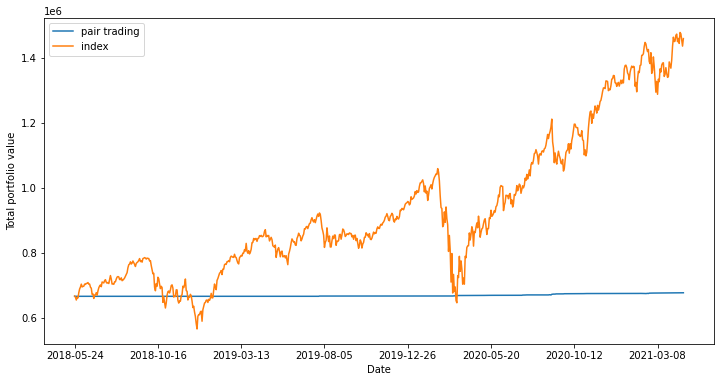

level=0.02500000000000001, z=3.0
113
Number of days = 732
CAGR = 0.394%


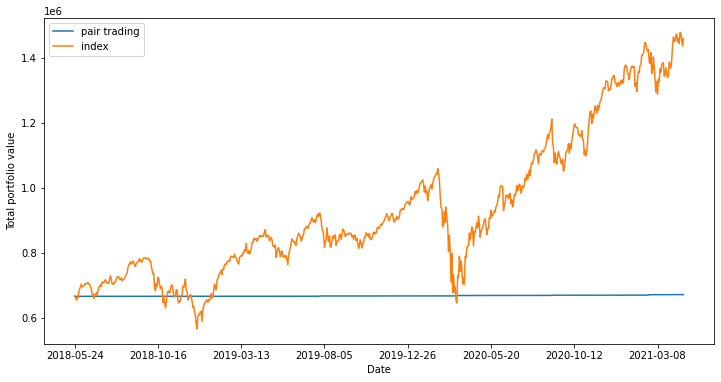

level=0.020000000000000007, z=0.25
99
Number of days = 732
CAGR = 20.891%


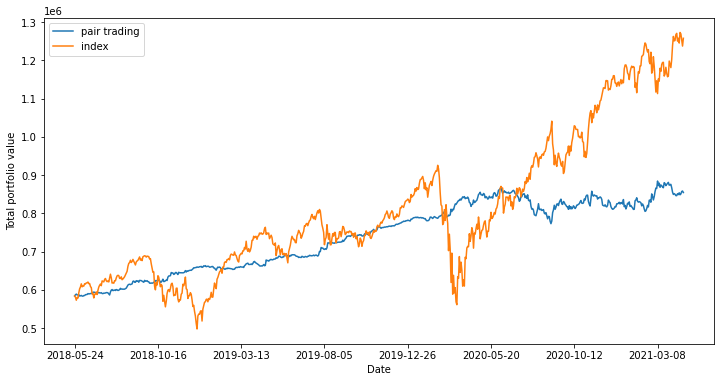

level=0.020000000000000007, z=0.5
99
Number of days = 732
CAGR = 20.953%


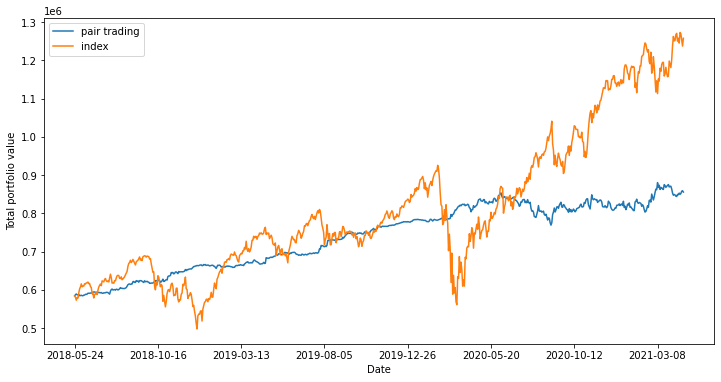

level=0.020000000000000007, z=0.75
99
Number of days = 732
CAGR = 20.824%


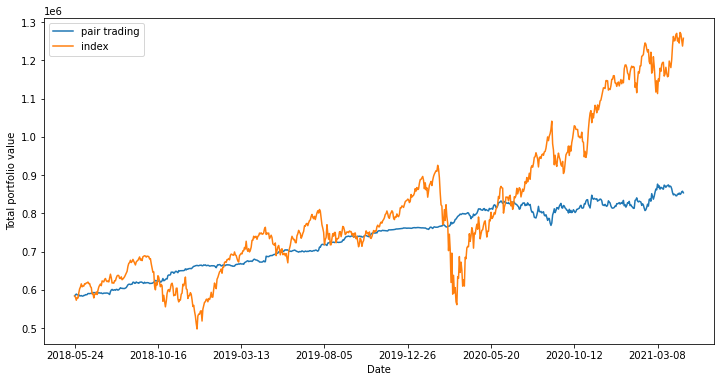

level=0.020000000000000007, z=1.0
99
Number of days = 732
CAGR = 17.642%


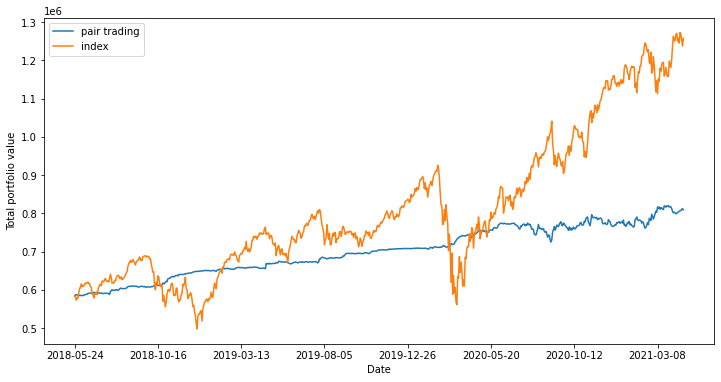

level=0.020000000000000007, z=1.25
99
Number of days = 732
CAGR = 14.913%


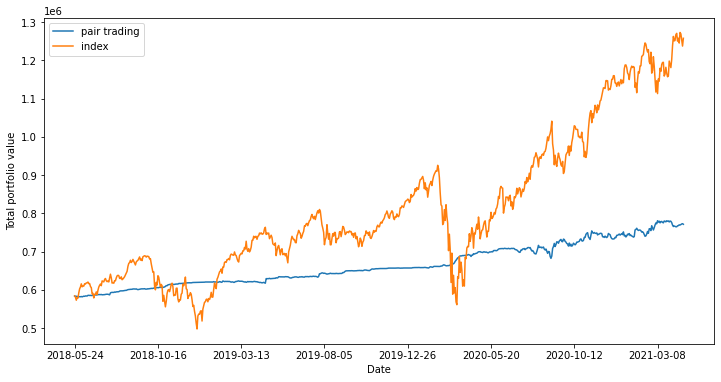

level=0.020000000000000007, z=1.5
99
Number of days = 732
CAGR = 12.601%


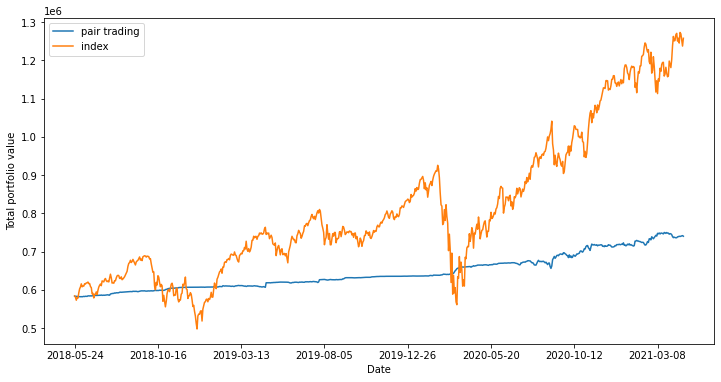

level=0.020000000000000007, z=1.75
99
Number of days = 732
CAGR = 9.690%


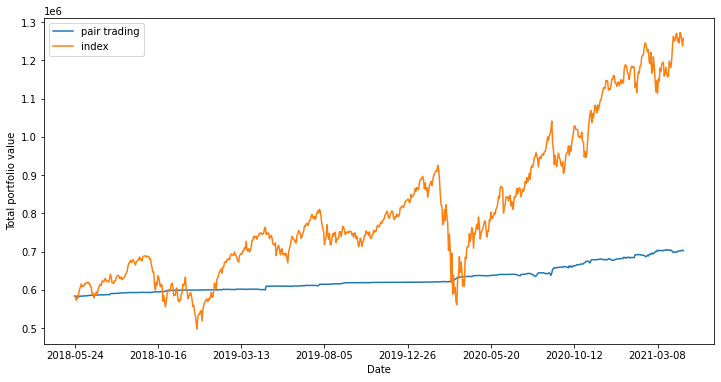

level=0.020000000000000007, z=2.0
99
Number of days = 732
CAGR = 5.258%


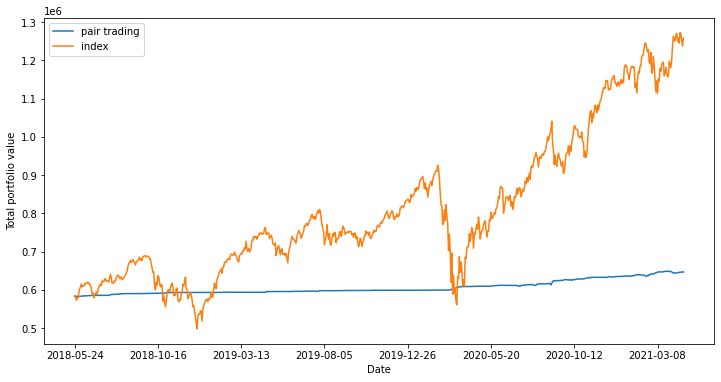

level=0.020000000000000007, z=2.25
99
Number of days = 732
CAGR = 3.085%


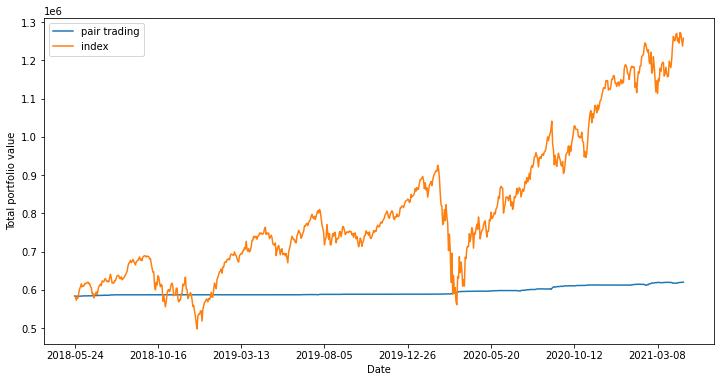

level=0.020000000000000007, z=2.5
99
Number of days = 732
CAGR = 1.605%


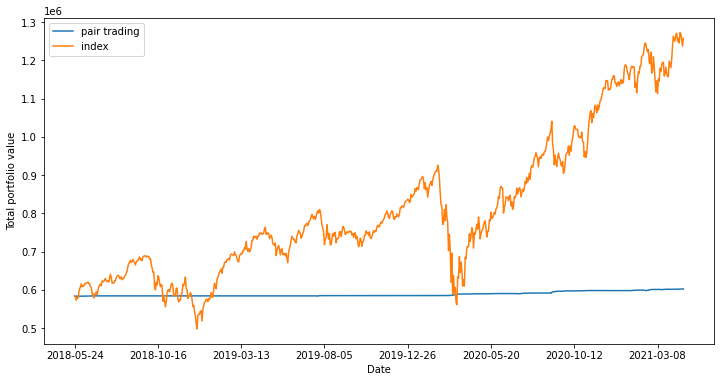

level=0.020000000000000007, z=2.75
99
Number of days = 732
CAGR = 0.906%


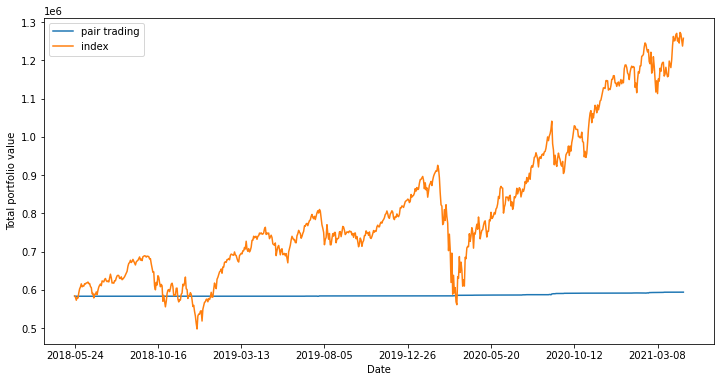

level=0.020000000000000007, z=3.0
99
Number of days = 732
CAGR = 0.450%


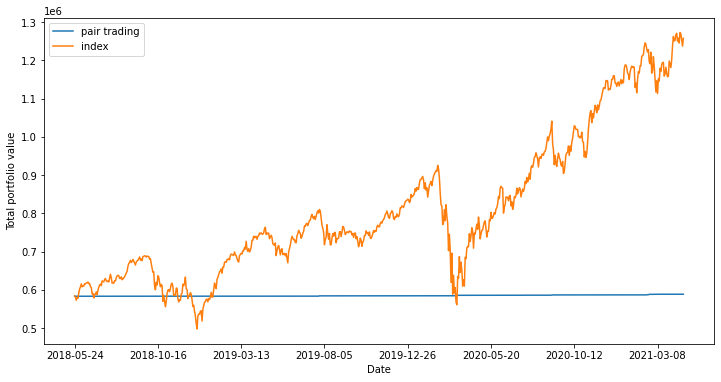

level=0.015000000000000006, z=0.25
84
Number of days = 732
CAGR = 19.635%


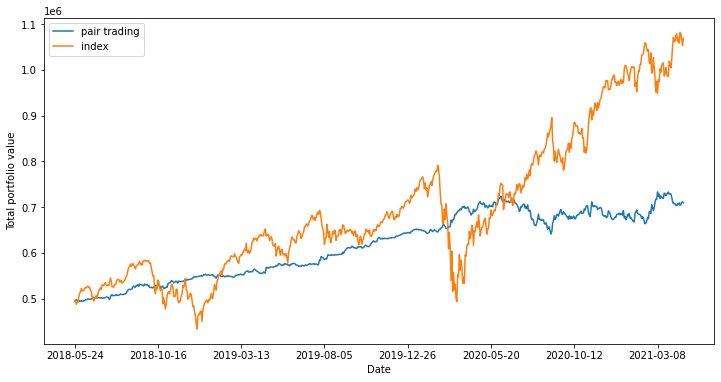

level=0.015000000000000006, z=0.5
84
Number of days = 732
CAGR = 19.978%


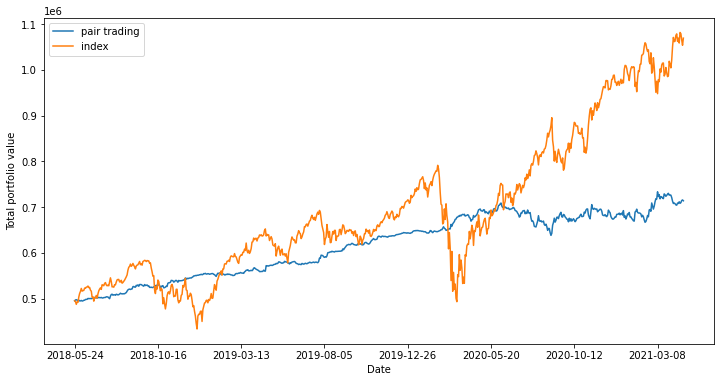

level=0.015000000000000006, z=0.75
84
Number of days = 732
CAGR = 19.648%


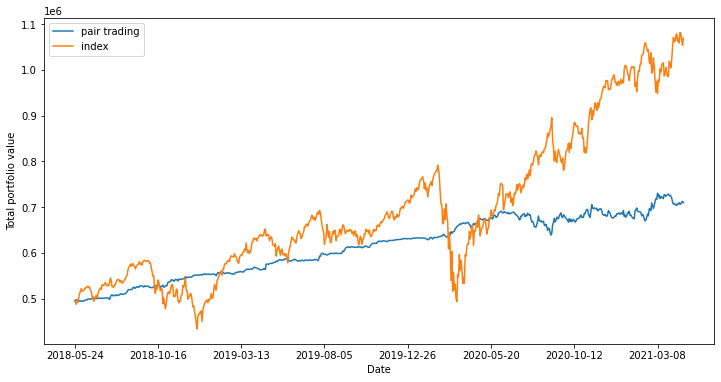

level=0.015000000000000006, z=1.0
84
Number of days = 732
CAGR = 17.355%


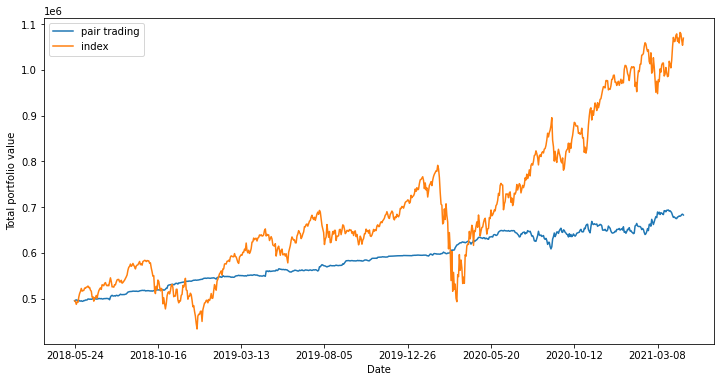

level=0.015000000000000006, z=1.25
84
Number of days = 732
CAGR = 14.556%


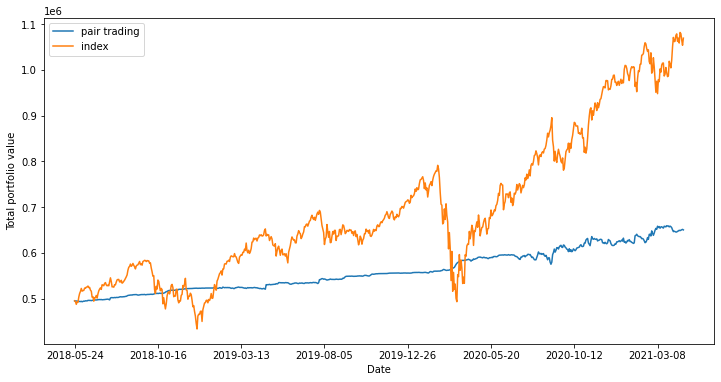

level=0.015000000000000006, z=1.5
84
Number of days = 732
CAGR = 12.070%


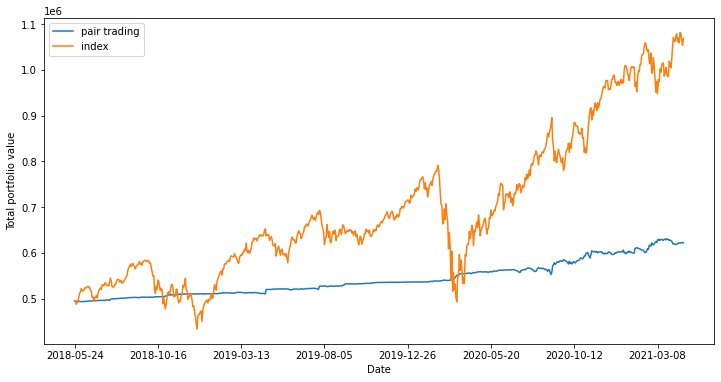

level=0.015000000000000006, z=1.75
84
Number of days = 732
CAGR = 9.086%


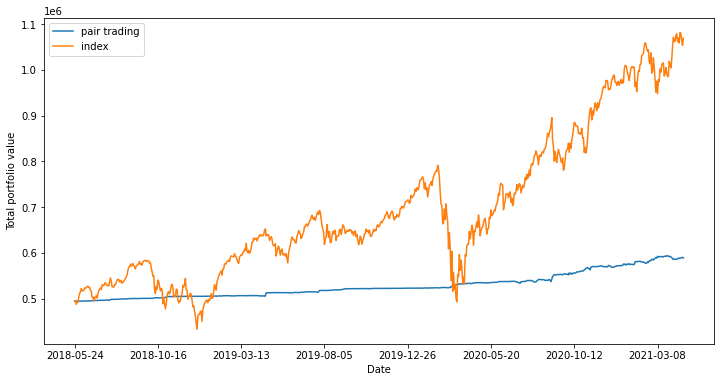

level=0.015000000000000006, z=2.0
84
Number of days = 732
CAGR = 4.943%


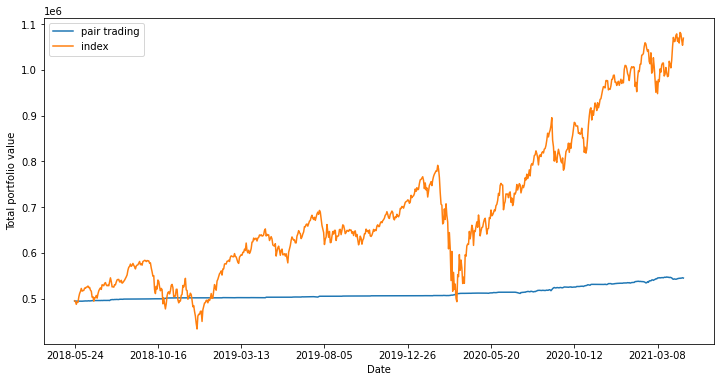

level=0.015000000000000006, z=2.25
84
Number of days = 732
CAGR = 2.850%


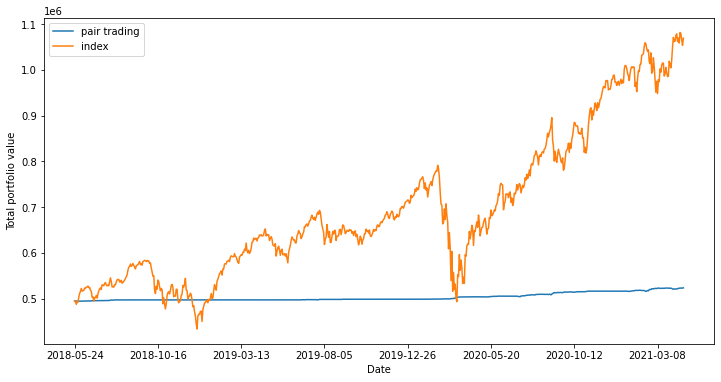

level=0.015000000000000006, z=2.5
84
Number of days = 732
CAGR = 1.562%


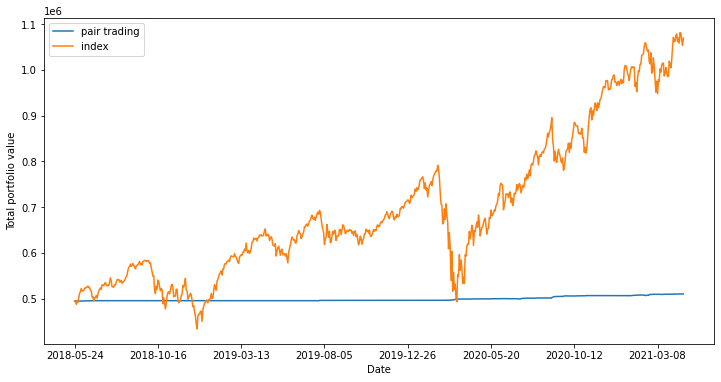

level=0.015000000000000006, z=2.75
84
Number of days = 732
CAGR = 0.726%


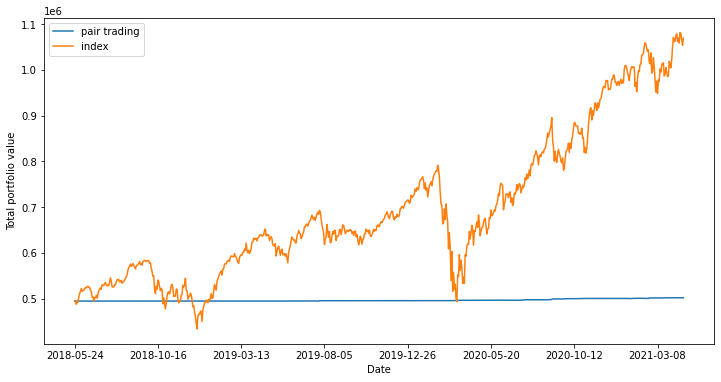

level=0.015000000000000006, z=3.0
84
Number of days = 732
CAGR = 0.363%


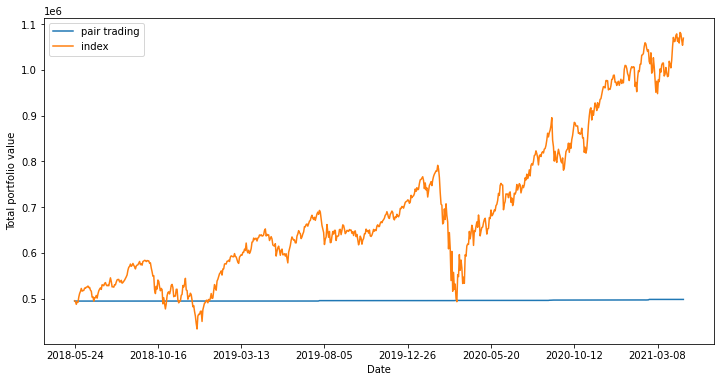

level=0.010000000000000005, z=0.25
60
Number of days = 732
CAGR = 18.432%


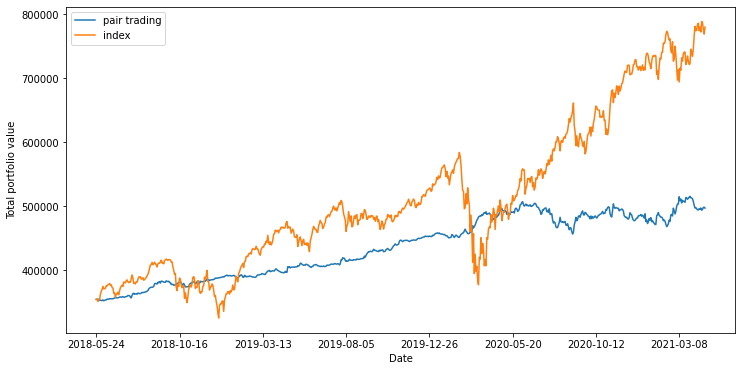

level=0.010000000000000005, z=0.5
60
Number of days = 732
CAGR = 18.768%


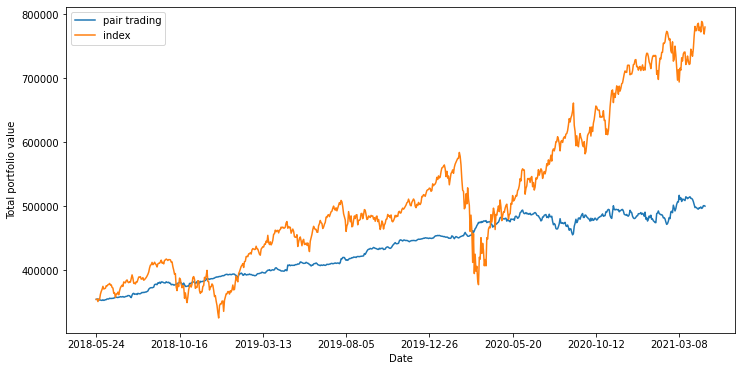

level=0.010000000000000005, z=0.75
60
Number of days = 732
CAGR = 18.982%


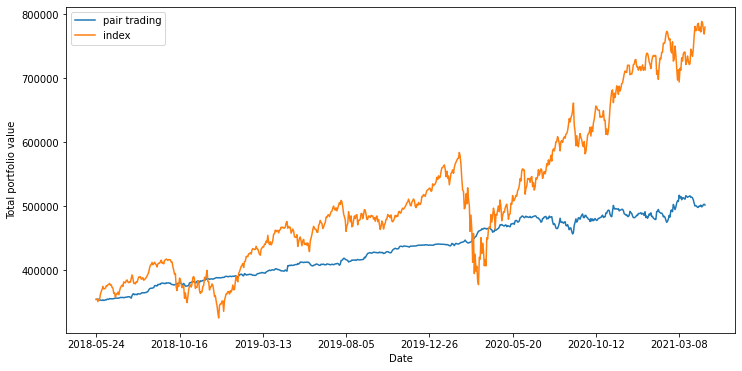

level=0.010000000000000005, z=1.0
60
Number of days = 732
CAGR = 16.788%


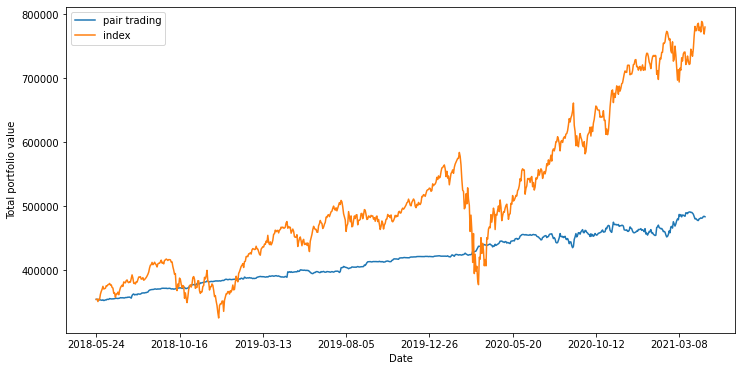

level=0.010000000000000005, z=1.25
60
Number of days = 732
CAGR = 14.153%


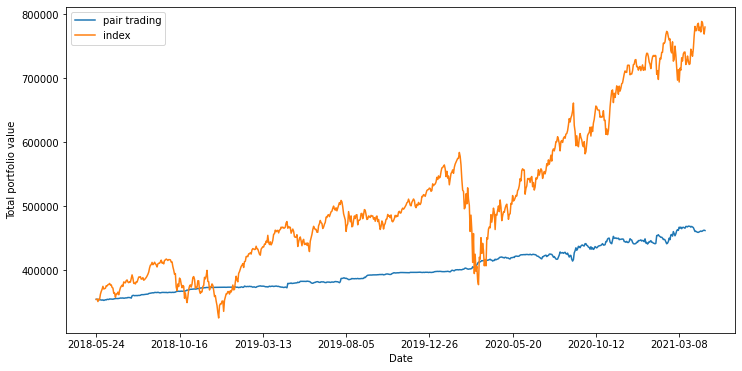

level=0.010000000000000005, z=1.5
60
Number of days = 732
CAGR = 11.916%


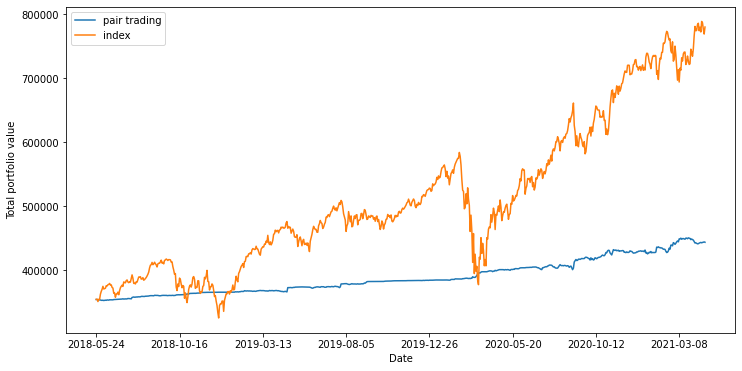

level=0.010000000000000005, z=1.75
60
Number of days = 732
CAGR = 8.438%


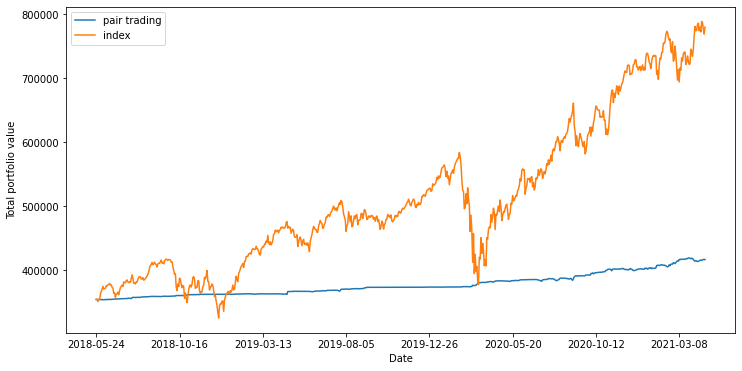

level=0.010000000000000005, z=2.0
60
Number of days = 732
CAGR = 5.231%


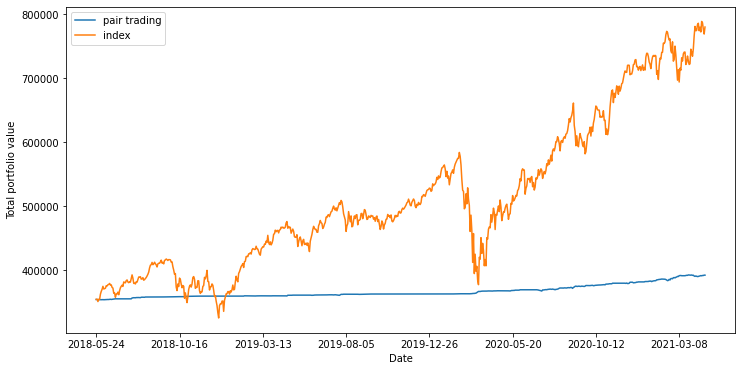

level=0.010000000000000005, z=2.25
60
Number of days = 732
CAGR = 2.728%


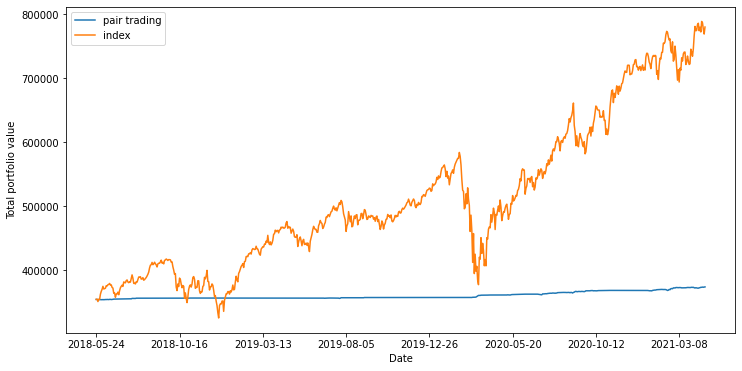

level=0.010000000000000005, z=2.5
60
Number of days = 732
CAGR = 1.584%


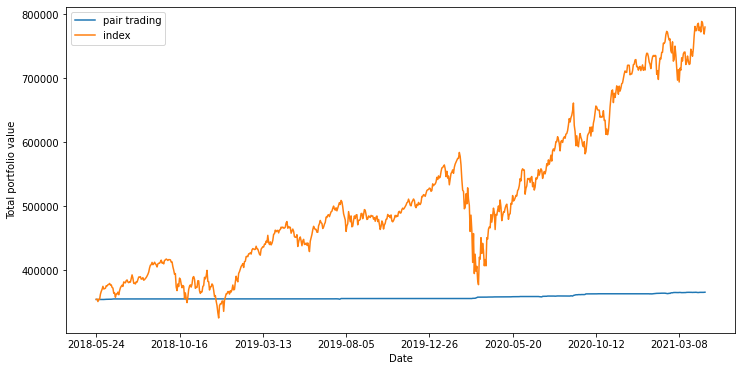

level=0.010000000000000005, z=2.75
60
Number of days = 732
CAGR = 0.659%


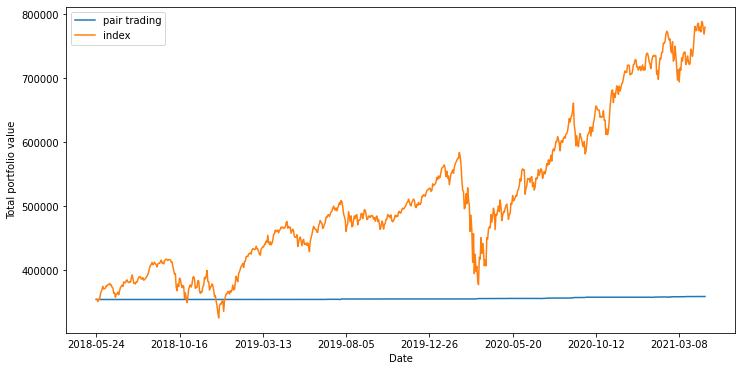

level=0.010000000000000005, z=3.0
60
Number of days = 732
CAGR = 0.349%


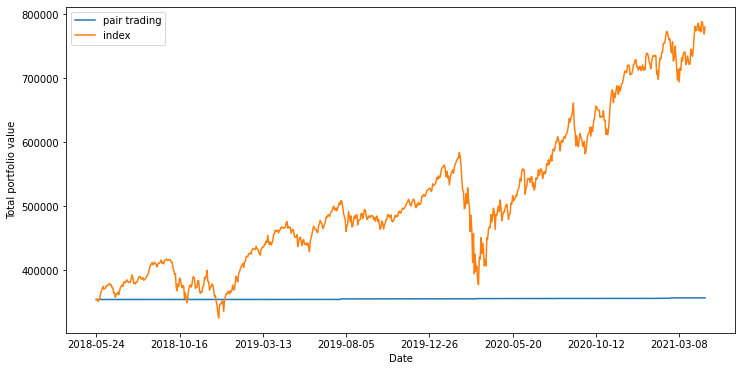

level=0.005000000000000005, z=0.25
37
Number of days = 732
CAGR = 16.482%


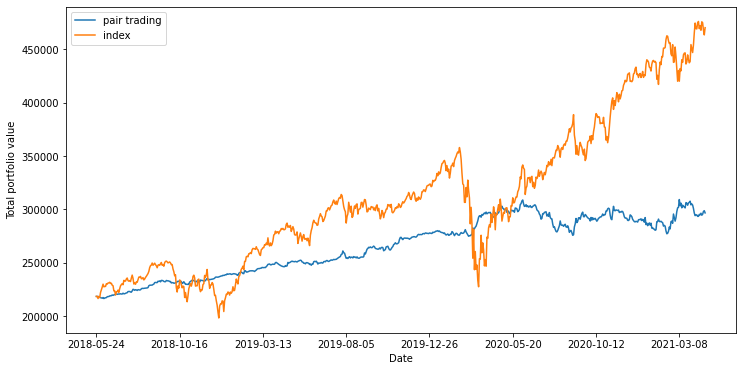

level=0.005000000000000005, z=0.5
37
Number of days = 732
CAGR = 15.142%


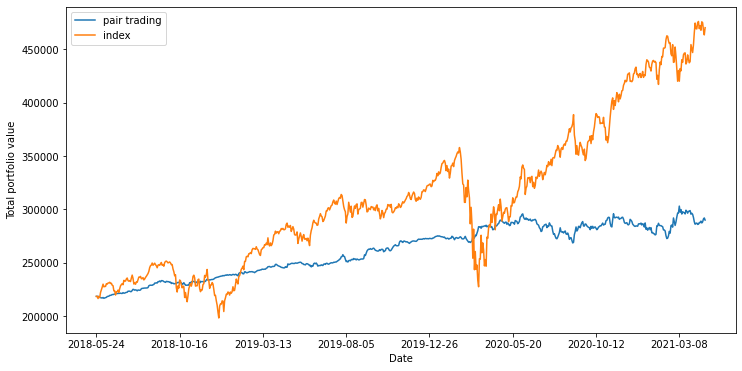

level=0.005000000000000005, z=0.75
37
Number of days = 732
CAGR = 16.381%


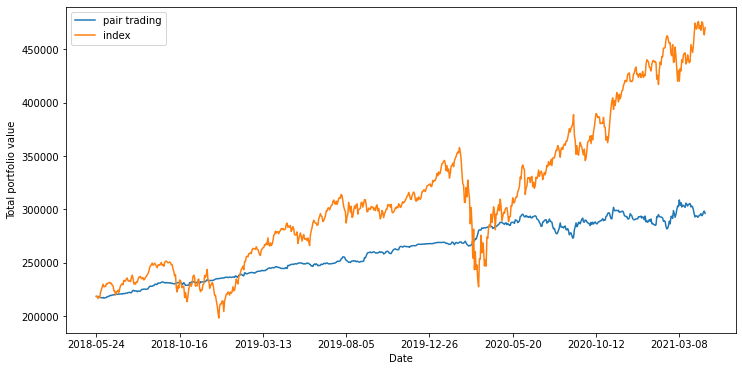

level=0.005000000000000005, z=1.0
37
Number of days = 732
CAGR = 16.496%


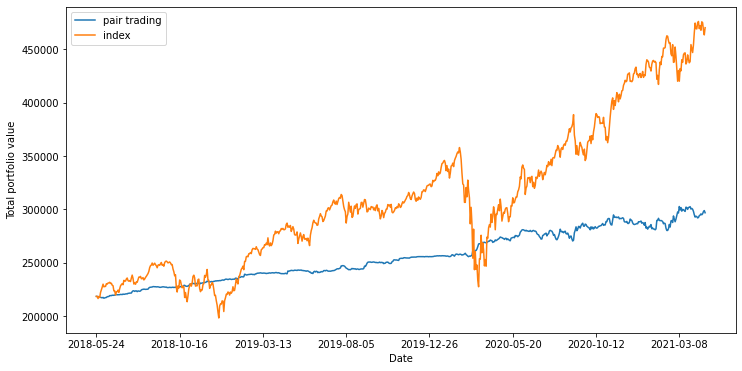

level=0.005000000000000005, z=1.25
37
Number of days = 732
CAGR = 12.795%


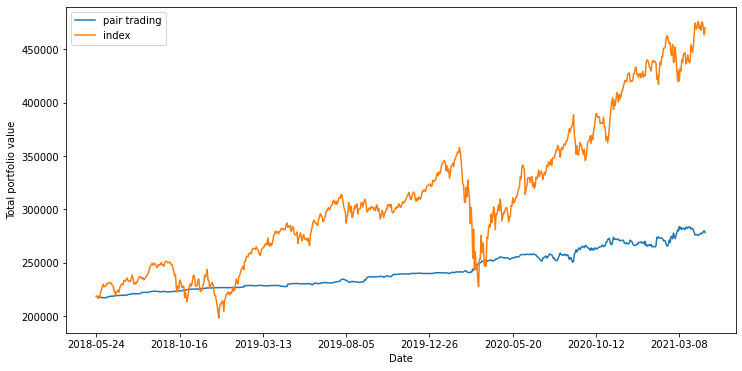

level=0.005000000000000005, z=1.5
37
Number of days = 732
CAGR = 11.678%


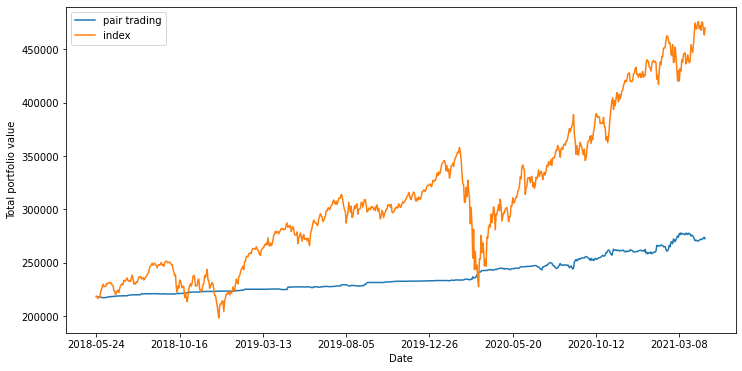

level=0.005000000000000005, z=1.75
37
Number of days = 732
CAGR = 8.095%


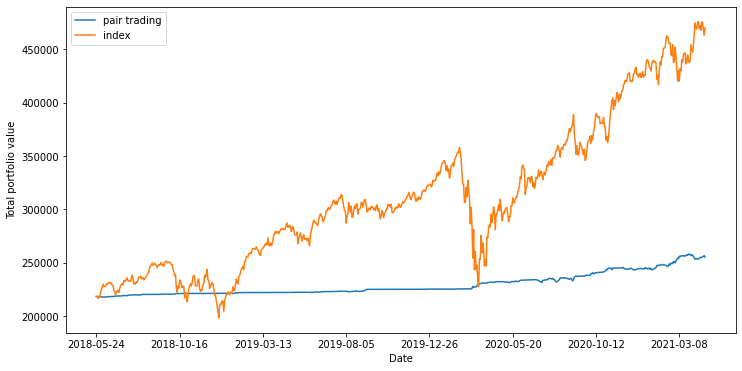

level=0.005000000000000005, z=2.0
37
Number of days = 732
CAGR = 5.417%


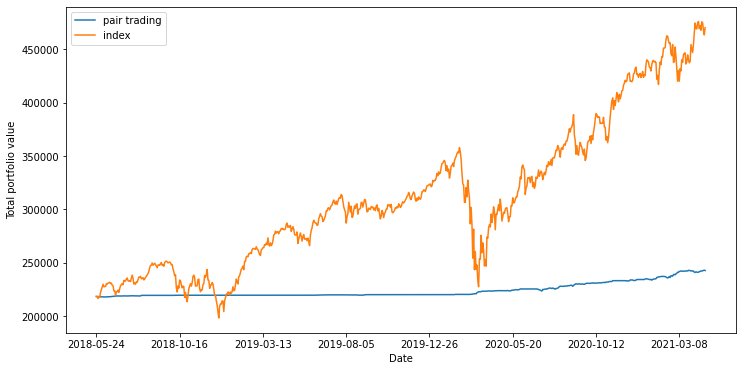

level=0.005000000000000005, z=2.25
37
Number of days = 732
CAGR = 3.100%


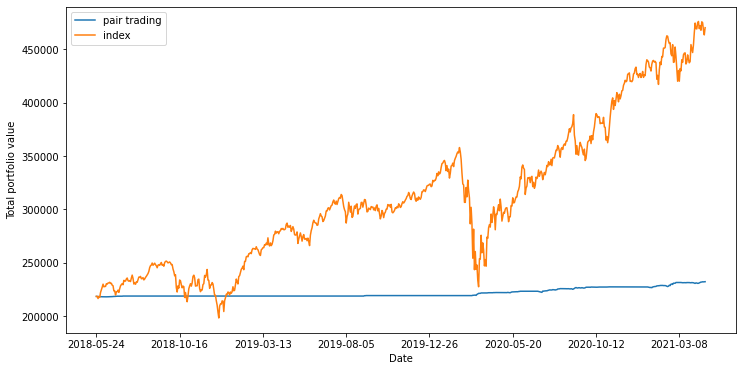

level=0.005000000000000005, z=2.5
37
Number of days = 732
CAGR = 1.729%


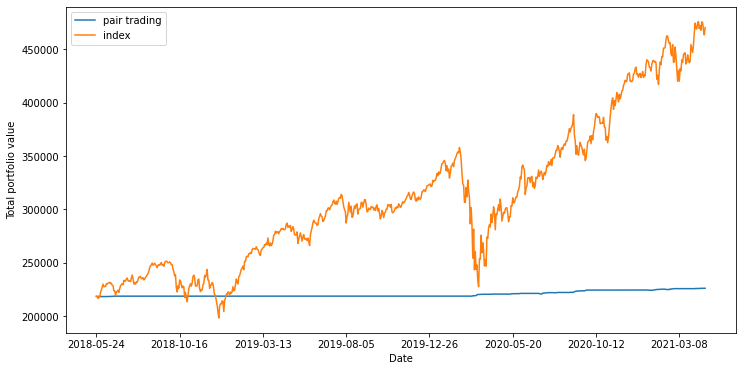

level=0.005000000000000005, z=2.75
37
Number of days = 732
CAGR = 0.639%


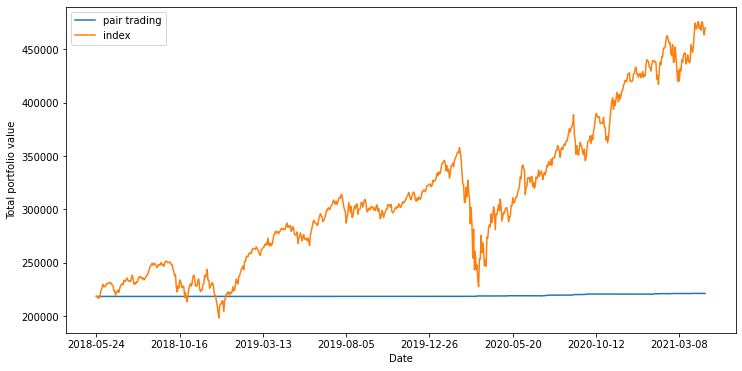

level=0.005000000000000005, z=3.0
37
Number of days = 732
CAGR = 0.300%


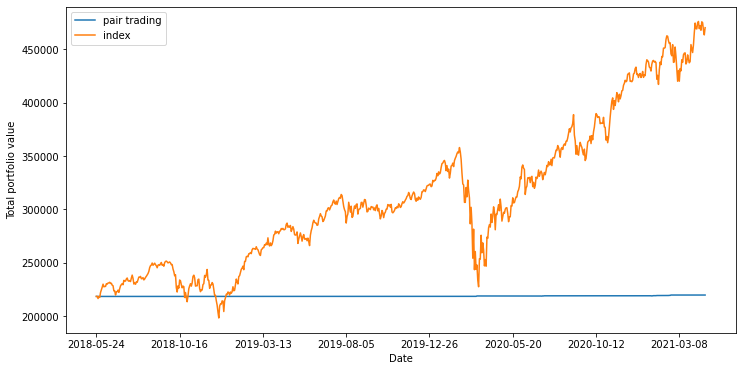

level=5.204170427930421e-18, z=0.25
0


IndexError: index -1 is out of bounds for axis 0 with size 0

In [236]:
max_cagr = 0
best_params = (0, 0)
pf = []

level = 0.05
while level > 0:
    z = 0.25
    
    while z <= 3:
        l_pairs = get_pairs(pairs, level)
        signals = []
        
        print('level={}, z={}'.format(level, z))
        print(len(l_pairs))
            
        max_capital_per_pair = 3000
        pairs_start_capital = []
        
        portfolio = []
        
        for i in range(len(l_pairs)):
            #print("---------------------- {} & {} -----------------------".format(l_pairs[i][0], l_pairs[i][1]))
            s = set_signals(l_pairs[i], threshold=z)
            signals.append(s)
            
            remains1 = max_capital_per_pair % min(signals[i][l_pairs[i][0]])
            remains2 = max_capital_per_pair % min(signals[i][l_pairs[i][1]])
            pairs_capital = max_capital_per_pair - max(remains1, remains2)

            positions = []
            # Неправильно -- надо не max
            positions.append(pairs_capital // min(signals[i][l_pairs[i][0]]))
            positions.append(pairs_capital // min(signals[i][l_pairs[i][1]]))

            pairs_start_capital.append(pairs_capital)

            pair_portfolio = portfolio_calc(l_pairs[i], signals[i], positions, pairs_capital)
            portfolio.append(pair_portfolio)
            
        total_portfolio = pd.DataFrame()
        total_portfolio_plain = pd.DataFrame()
        for i in range(len(l_pairs)):
            total_portfolio[i] = portfolio[i]['total asset']
            total_portfolio_plain[i] = portfolio[i]['plain']
            
        total_portfolio = total_portfolio.sum(axis=1)
        total_portfolio_plain = total_portfolio_plain.sum(axis=1)
        
        #print(total_portfolio_plain)
        
        #returns = total_portfolio['2019-06-06']/total_portfolio['2018-06-05'] - 1
        #print('CAGR = {:.3f}%'.format(returns * 100))
        
        final_value = total_portfolio[-1]
        delta = len(total_portfolio)
        print('Number of days =', delta)

        YEAR_DAYS = 365
        returns_t = (final_value/total_portfolio[0]) ** (YEAR_DAYS/delta) - 1
        print('CAGR = {:.3f}%'.format(returns_t * 100))
        
        pf.append((z, returns_t))
        
        if returns_t * 100 > max_cagr:
            max_cagr = returns_t * 100
            best_params = (level, z)
        
        ax = total_portfolio.plot(figsize=(12, 6), label='pair trading')
        ax.grid(True)
        ax.set_ylabel("Total portfolio value")
        ay = total_portfolio_plain.plot(figsize=(12, 6), label='index')
        #plt.plot(total_portfolio)
        plt.legend()
        plt.show()
        
        z += 0.25
    level -= 0.005

In [197]:
print("Best CAGR:", max_cagr)
print("Best parameters: level={}, z={}".format(best_params[0], best_params[1]))

Best CAGR: 21.530794161834187
Best parameters: level=0.045, z=0.75


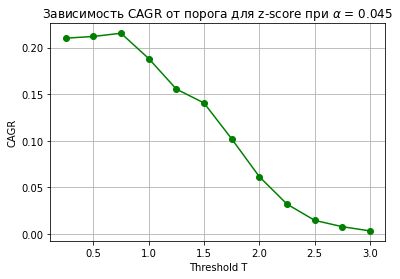

In [225]:
x = []
y = []
for i in pf:
    x.append(i[0])
    y.append(i[1])
plt.plot(x, y, 'og-')
plt.ylabel("CAGR")
plt.xlabel("Threshold T")
plt.title(r"Зависимость CAGR от порога для z-score при $\alpha$ = 0.045")
plt.grid()
plt.show()

In [201]:
pf

[(0.25, 0.2100292346741479),
 (0.5, 0.2118598788612791),
 (0.75, 0.21530794161834188),
 (1.0, 0.18817980052541317),
 (1.25, 0.15541775992180695),
 (1.5, 0.14048439521419342),
 (1.75, 0.10201280068405505),
 (2.0, 0.061404849567959774),
 (2.25, 0.031997633096686684),
 (2.5, 0.014582844827737862),
 (2.75, 0.007782550056894877),
 (3.0, 0.0032663171763276377)]

                  AAPL        INTU         z  z upper limit  z lower limit  \
Date                                                                         
2018-05-23   45.607460  191.857910 -0.372601            1.0           -1.0   
2018-05-24   45.556606  193.383163 -0.408232            1.0           -1.0   
2018-05-25   45.660728  192.698746 -0.385282            1.0           -1.0   
2021-04-19  134.839996  402.290009  1.251818            1.0           -1.0   
2021-04-20  133.110001  405.369995  1.138246            1.0           -1.0   
2021-04-21  133.500000  408.950012  1.106231            1.0           -1.0   

            signals1  positions1  signals2  positions2  
Date                                                    
2018-05-23         0         0.0         0         0.0  
2018-05-24         0         0.0         0         0.0  
2018-05-25         0         0.0         0         0.0  
2021-04-19        -1         0.0         1         0.0  
2021-04-20        -1         0.0 

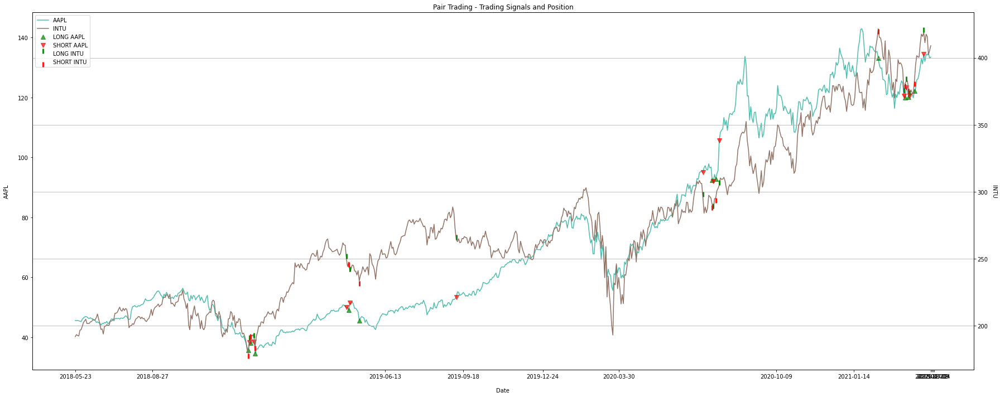

                   ACN         ADI         z  z upper limit  z lower limit  \
Date                                                                         
2018-05-23  148.615402   88.897957 -0.667441            1.0           -1.0   
2018-05-24  148.883347   89.510139 -0.739913            1.0           -1.0   
2018-05-25  149.266098   89.896271 -0.764700            1.0           -1.0   
2021-04-19  286.540009  156.910004  0.658241            1.0           -1.0   
2021-04-20  288.600006  154.470001  1.020437            1.0           -1.0   
2021-04-21  290.720001  158.289993  0.748286            1.0           -1.0   

            signals1  positions1  signals2  positions2  
Date                                                    
2018-05-23         0         0.0         0         0.0  
2018-05-24         0         0.0         0         0.0  
2018-05-25         0         0.0         0         0.0  
2021-04-19         0         0.0         0         0.0  
2021-04-20        -1        -1.0 

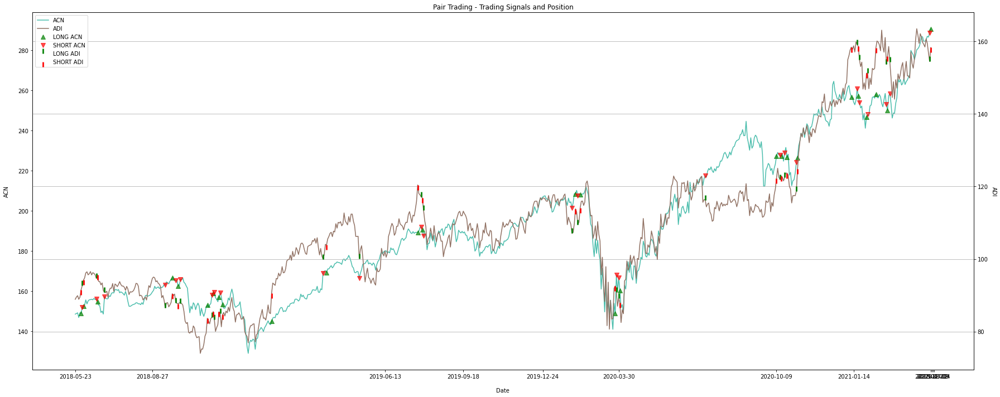

                   ACN         ADP         z  z upper limit  z lower limit  \
Date                                                                         
2018-05-23  148.615402  121.222755 -0.311080            1.0           -1.0   
2018-05-24  148.883347  122.075523 -0.346970            1.0           -1.0   
2018-05-25  149.266098  122.431610 -0.349341            1.0           -1.0   
2021-04-19  286.540009  192.750000  1.157483            1.0           -1.0   
2021-04-20  288.600006  192.809998  1.215080            1.0           -1.0   
2021-04-21  290.720001  194.309998  1.211449            1.0           -1.0   

            signals1  positions1  signals2  positions2  
Date                                                    
2018-05-23         0         0.0         0         0.0  
2018-05-24         0         0.0         0         0.0  
2018-05-25         0         0.0         0         0.0  
2021-04-19        -1         0.0         1         0.0  
2021-04-20        -1         0.0 

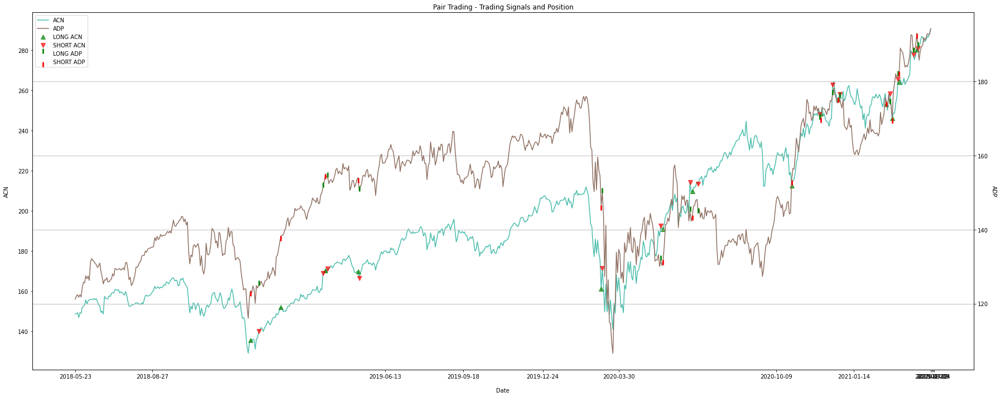

                   ACN        APH         z  z upper limit  z lower limit  \
Date                                                                        
2018-05-23  148.615402  42.791271 -1.308653            1.0           -1.0   
2018-05-24  148.883347  42.597214 -1.237761            1.0           -1.0   
2018-05-25  149.266098  42.340069 -1.140723            1.0           -1.0   
2021-04-19  286.540009  67.510002  1.164425            1.0           -1.0   
2021-04-20  288.600006  66.790001  1.410003            1.0           -1.0   
2021-04-21  290.720001  67.730003  1.318088            1.0           -1.0   

            signals1  positions1  signals2  positions2  
Date                                                    
2018-05-23         1         1.0        -1        -1.0  
2018-05-24         1         0.0        -1         0.0  
2018-05-25         1         0.0        -1         0.0  
2021-04-19        -1        -1.0         1         1.0  
2021-04-20        -1         0.0         

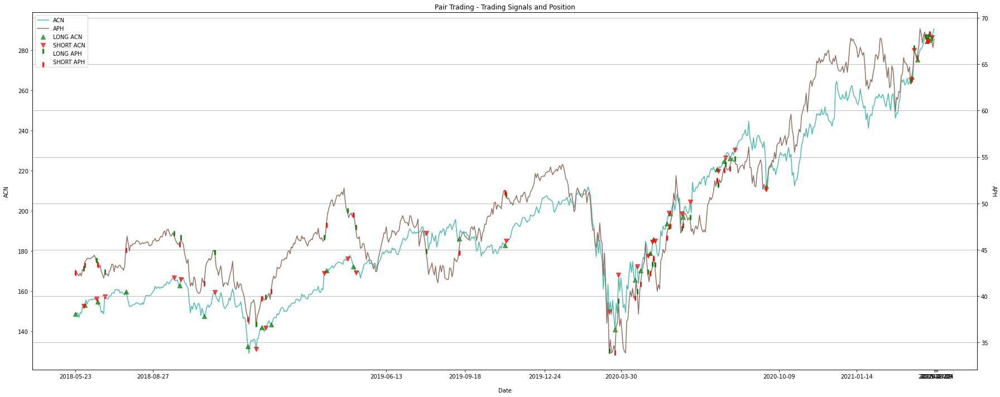

                   ACN         FIS         z  z upper limit  z lower limit  \
Date                                                                         
2018-05-23  148.615402  100.511276 -0.376644            1.0           -1.0   
2018-05-24  148.883347  100.443550 -0.352650            1.0           -1.0   
2018-05-25  149.266098  100.114548 -0.295725            1.0           -1.0   
2021-04-19  286.540009  152.220001  2.267311            1.0           -1.0   
2021-04-20  288.600006  151.779999  2.391905            1.0           -1.0   
2021-04-21  290.720001  152.440002  2.429059            1.0           -1.0   

            signals1  positions1  signals2  positions2  
Date                                                    
2018-05-23         0         0.0         0         0.0  
2018-05-24         0         0.0         0         0.0  
2018-05-25         0         0.0         0         0.0  
2021-04-19        -1         0.0         1         0.0  
2021-04-20        -1         0.0 

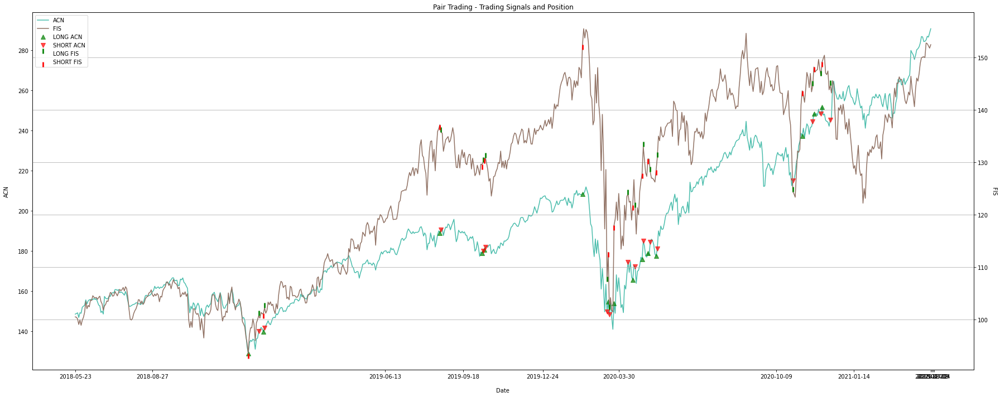

                   ACN         GOOG         z  z upper limit  z lower limit  \
Date                                                                          
2018-05-23  148.615402  1079.689941 -0.423802            1.0           -1.0   
2018-05-24  148.883347  1079.239990 -0.394100            1.0           -1.0   
2018-05-25  149.266098  1075.660034 -0.314905            1.0           -1.0   
2021-04-19  286.540009  2302.399902 -1.705912            1.0           -1.0   
2021-04-20  288.600006  2293.629883 -1.572391            1.0           -1.0   
2021-04-21  290.720001  2293.290039 -1.480746            1.0           -1.0   

            signals1  positions1  signals2  positions2  
Date                                                    
2018-05-23         0         0.0         0         0.0  
2018-05-24         0         0.0         0         0.0  
2018-05-25         0         0.0         0         0.0  
2021-04-19         1         0.0        -1         0.0  
2021-04-20         1     

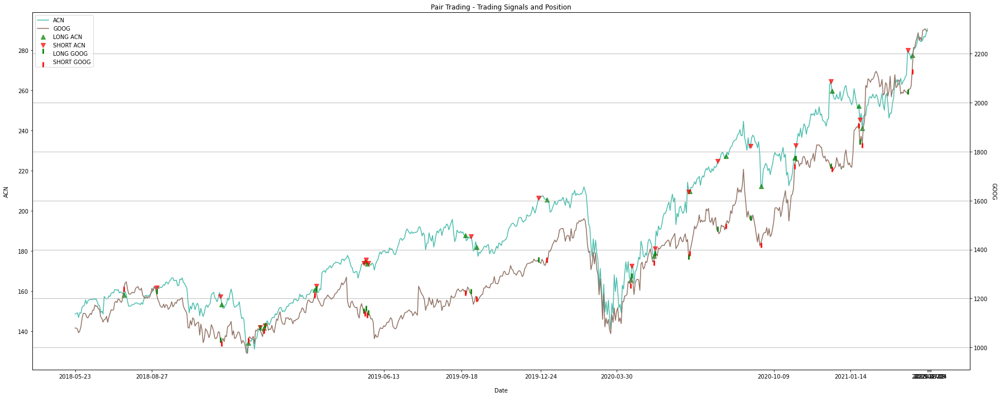

                   ACN        GOOGL         z  z upper limit  z lower limit  \
Date                                                                          
2018-05-23  148.615402  1085.959961 -0.473183            1.0           -1.0   
2018-05-24  148.883347  1085.449951 -0.443113            1.0           -1.0   
2018-05-25  149.266098  1084.079956 -0.392240            1.0           -1.0   
2021-04-19  286.540009  2289.760010 -1.605033            1.0           -1.0   
2021-04-20  288.600006  2279.010010 -1.460634            1.0           -1.0   
2021-04-21  290.720001  2278.350098 -1.367165            1.0           -1.0   

            signals1  positions1  signals2  positions2  
Date                                                    
2018-05-23         0         0.0         0         0.0  
2018-05-24         0         0.0         0         0.0  
2018-05-25         0         0.0         0         0.0  
2021-04-19         1         0.0        -1         0.0  
2021-04-20         1     

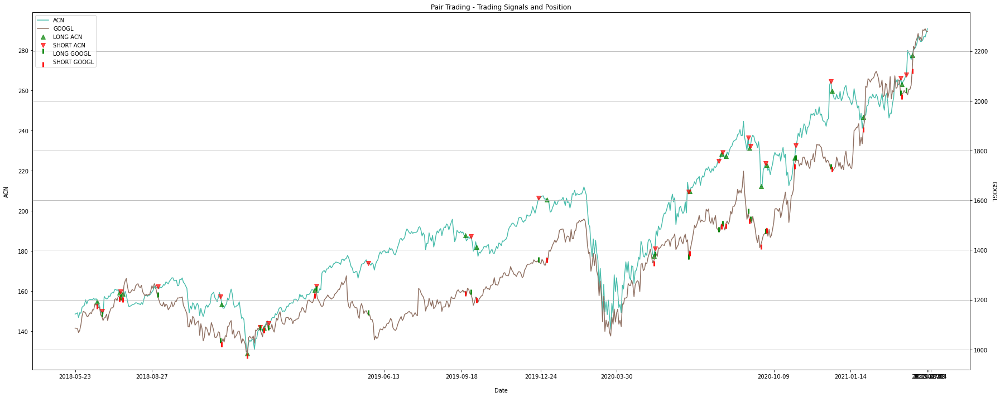

                   ACN          IT         z  z upper limit  z lower limit  \
Date                                                                         
2018-05-23  148.615402  131.759995 -0.869540            1.0           -1.0   
2018-05-24  148.883347  131.300003 -0.845916            1.0           -1.0   
2018-05-25  149.266098  130.639999 -0.811779            1.0           -1.0   
2021-04-19  286.540009  191.940002  0.569258            1.0           -1.0   
2021-04-20  288.600006  191.429993  0.627366            1.0           -1.0   
2021-04-21  290.720001  193.419998  0.609425            1.0           -1.0   

            signals1  positions1  signals2  positions2  
Date                                                    
2018-05-23         0         0.0         0         0.0  
2018-05-24         0         0.0         0         0.0  
2018-05-25         0         0.0         0         0.0  
2021-04-19         0         0.0         0         0.0  
2021-04-20         0         0.0 

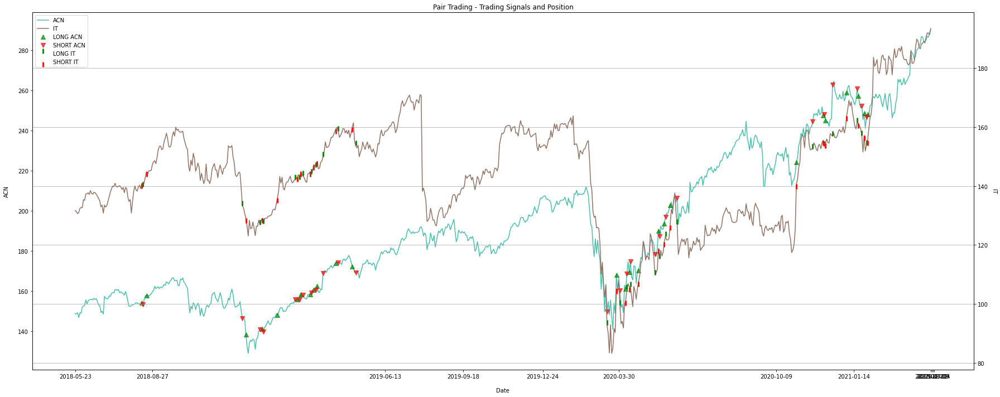

                   ACN         MSI         z  z upper limit  z lower limit  \
Date                                                                         
2018-05-23  148.615402  105.520042  0.663941            1.0           -1.0   
2018-05-24  148.883347  105.539078  0.679088            1.0           -1.0   
2018-05-25  149.266098  105.263000  0.727724            1.0           -1.0   
2021-04-19  286.540009  187.660004  1.449577            1.0           -1.0   
2021-04-20  288.600006  185.270004  1.653881            1.0           -1.0   
2021-04-21  290.720001  186.479996  1.662242            1.0           -1.0   

            signals1  positions1  signals2  positions2  
Date                                                    
2018-05-23         0         0.0         0         0.0  
2018-05-24         0         0.0         0         0.0  
2018-05-25         0         0.0         0         0.0  
2021-04-19        -1         0.0         1         0.0  
2021-04-20        -1         0.0 

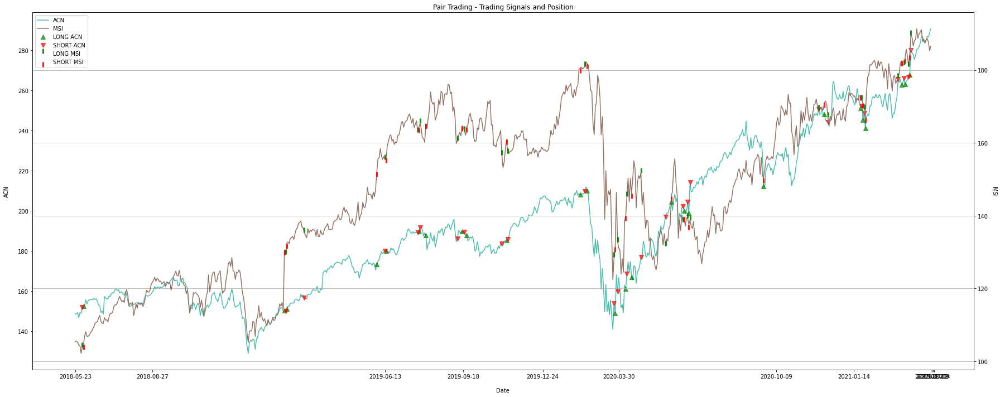

                   ACN        VRSN         z  z upper limit  z lower limit  \
Date                                                                         
2018-05-23  148.615402  128.210007  0.933067            1.0           -1.0   
2018-05-24  148.883347  128.169998  0.950563            1.0           -1.0   
2018-05-25  149.266098  128.509995  0.949887            1.0           -1.0   
2021-04-19  286.540009  207.259995  2.526586            1.0           -1.0   
2021-04-20  288.600006  209.500000  2.491277            1.0           -1.0   
2021-04-21  290.720001  211.110001  2.487969            1.0           -1.0   

            signals1  positions1  signals2  positions2  
Date                                                    
2018-05-23         0         0.0         0         0.0  
2018-05-24         0         0.0         0         0.0  
2018-05-25         0         0.0         0         0.0  
2021-04-19        -1         0.0         1         0.0  
2021-04-20        -1         0.0 

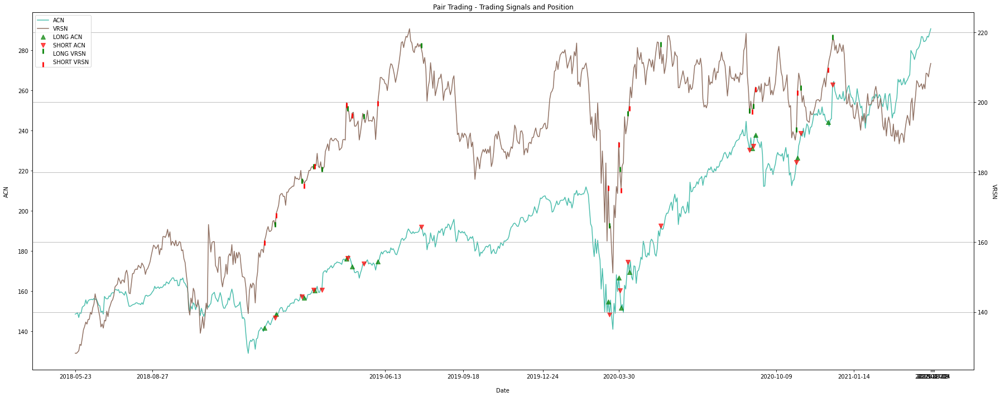

                   ADI         ADP         z  z upper limit  z lower limit  \
Date                                                                         
2018-05-23   88.897957  121.222755  0.012045            1.0           -1.0   
2018-05-24   89.510139  122.075523  0.010792            1.0           -1.0   
2018-05-25   89.896271  122.431610  0.022640            1.0           -1.0   
2021-04-19  156.910004  192.750000  0.948500            1.0           -1.0   
2021-04-20  154.470001  192.809998  0.798740            1.0           -1.0   
2021-04-21  158.289993  194.309998  0.955071            1.0           -1.0   

            signals1  positions1  signals2  positions2  
Date                                                    
2018-05-23         0         0.0         0         0.0  
2018-05-24         0         0.0         0         0.0  
2018-05-25         0         0.0         0         0.0  
2021-04-19         0         1.0         0        -1.0  
2021-04-20         0         0.0 

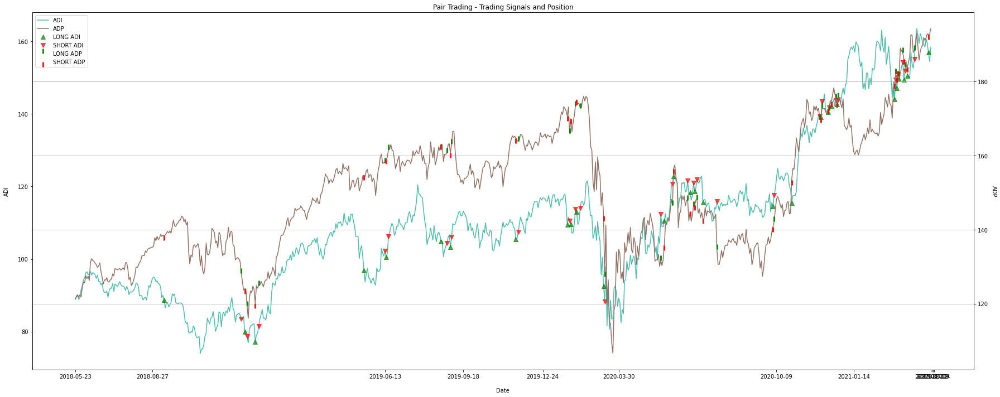

                   ADI        APH         z  z upper limit  z lower limit  \
Date                                                                        
2018-05-23   88.897957  42.791271 -0.885745            1.0           -1.0   
2018-05-24   89.510139  42.597214 -0.739931            1.0           -1.0   
2018-05-25   89.896271  42.340069 -0.606069            1.0           -1.0   
2021-04-19  156.910004  67.510002  0.623866            1.0           -1.0   
2021-04-20  154.470001  66.790001  0.553656            1.0           -1.0   
2021-04-21  158.289993  67.730003  0.702324            1.0           -1.0   

            signals1  positions1  signals2  positions2  
Date                                                    
2018-05-23         0         0.0         0         0.0  
2018-05-24         0         0.0         0         0.0  
2018-05-25         0         0.0         0         0.0  
2021-04-19         0         0.0         0         0.0  
2021-04-20         0         0.0         

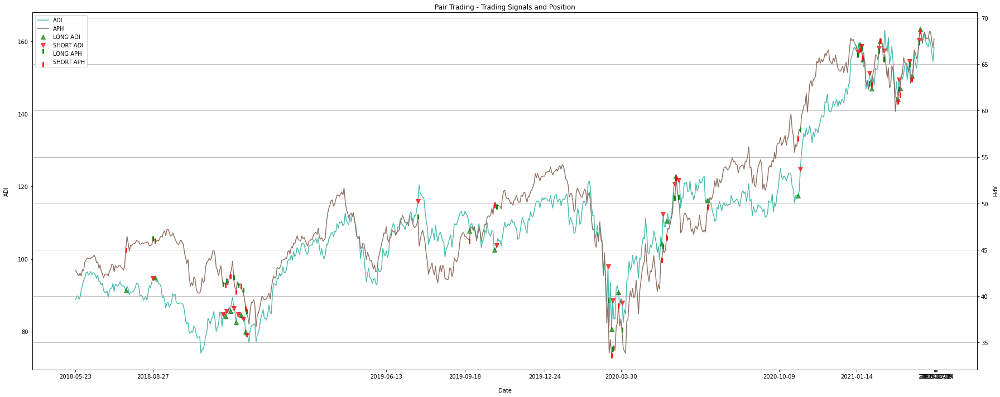

                   ADI       EBAY         z  z upper limit  z lower limit  \
Date                                                                        
2018-05-23   88.897957  36.826172 -1.087569            1.0           -1.0   
2018-05-24   89.510139  36.584145 -0.978940            1.0           -1.0   
2018-05-25   89.896271  36.729351 -0.976149            1.0           -1.0   
2021-04-19  156.910004  63.790001 -0.935434            1.0           -1.0   
2021-04-20  154.470001  61.790001 -0.802139            1.0           -1.0   
2021-04-21  158.289993  61.779999 -0.595411            1.0           -1.0   

            signals1  positions1  signals2  positions2  
Date                                                    
2018-05-23         1         1.0        -1        -1.0  
2018-05-24         0        -1.0         0         1.0  
2018-05-25         0         0.0         0         0.0  
2021-04-19         0         0.0         0         0.0  
2021-04-20         0         0.0         

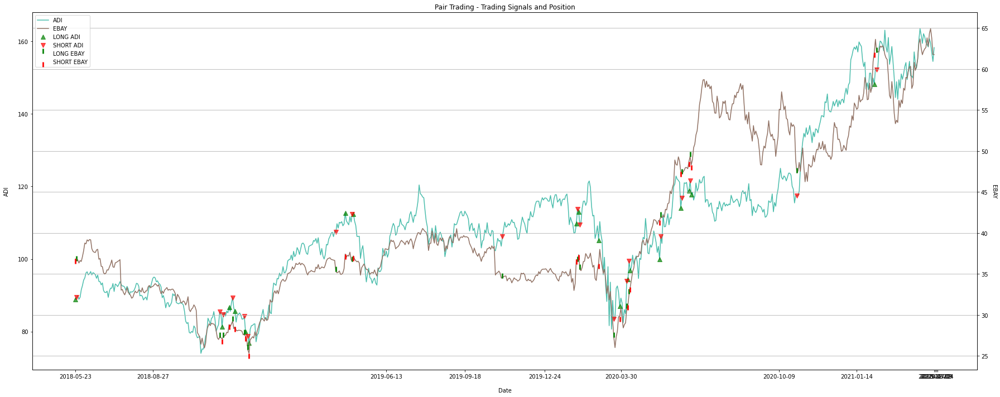

                   ADI         FIS         z  z upper limit  z lower limit  \
Date                                                                         
2018-05-23   88.897957  100.511276  0.027937            1.0           -1.0   
2018-05-24   89.510139  100.443550  0.092317            1.0           -1.0   
2018-05-25   89.896271  100.114548  0.157604            1.0           -1.0   
2021-04-19  156.910004  152.220001  1.436086            1.0           -1.0   
2021-04-20  154.470001  151.779999  1.310162            1.0           -1.0   
2021-04-21  158.289993  152.440002  1.508873            1.0           -1.0   

            signals1  positions1  signals2  positions2  
Date                                                    
2018-05-23         0         0.0         0         0.0  
2018-05-24         0         0.0         0         0.0  
2018-05-25         0         0.0         0         0.0  
2021-04-19        -1         0.0         1         0.0  
2021-04-20        -1         0.0 

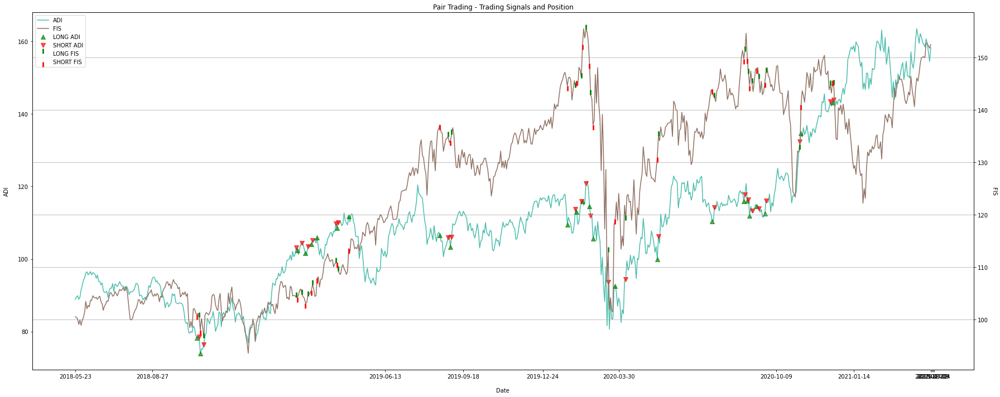

                   ADI         GOOG         z  z upper limit  z lower limit  \
Date                                                                          
2018-05-23   88.897957  1079.689941  0.134806            1.0           -1.0   
2018-05-24   89.510139  1079.239990  0.222934            1.0           -1.0   
2018-05-25   89.896271  1075.660034  0.315961            1.0           -1.0   
2021-04-19  156.910004  2302.399902 -1.943412            1.0           -1.0   
2021-04-20  154.470001  2293.629883 -2.061084            1.0           -1.0   
2021-04-21  158.289993  2293.290039 -1.815596            1.0           -1.0   

            signals1  positions1  signals2  positions2  
Date                                                    
2018-05-23         0         0.0         0         0.0  
2018-05-24         0         0.0         0         0.0  
2018-05-25         0         0.0         0         0.0  
2021-04-19         1         0.0        -1         0.0  
2021-04-20         1     

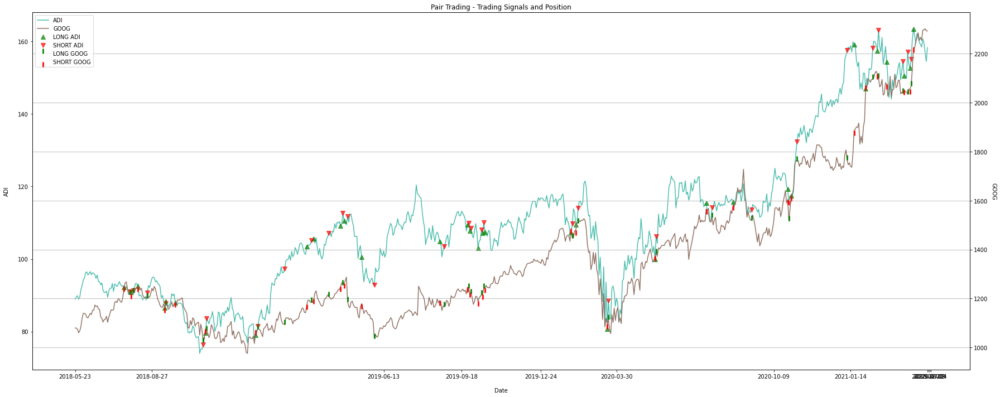

                   ADI        GOOGL         z  z upper limit  z lower limit  \
Date                                                                          
2018-05-23   88.897957  1085.959961  0.088077            1.0           -1.0   
2018-05-24   89.510139  1085.449951  0.176758            1.0           -1.0   
2018-05-25   89.896271  1084.079956  0.244528            1.0           -1.0   
2021-04-19  156.910004  2289.760010 -1.874734            1.0           -1.0   
2021-04-20  154.470001  2279.010010 -1.984752            1.0           -1.0   
2021-04-21  158.289993  2278.350098 -1.735060            1.0           -1.0   

            signals1  positions1  signals2  positions2  
Date                                                    
2018-05-23         0         0.0         0         0.0  
2018-05-24         0         0.0         0         0.0  
2018-05-25         0         0.0         0         0.0  
2021-04-19         1         0.0        -1         0.0  
2021-04-20         1     

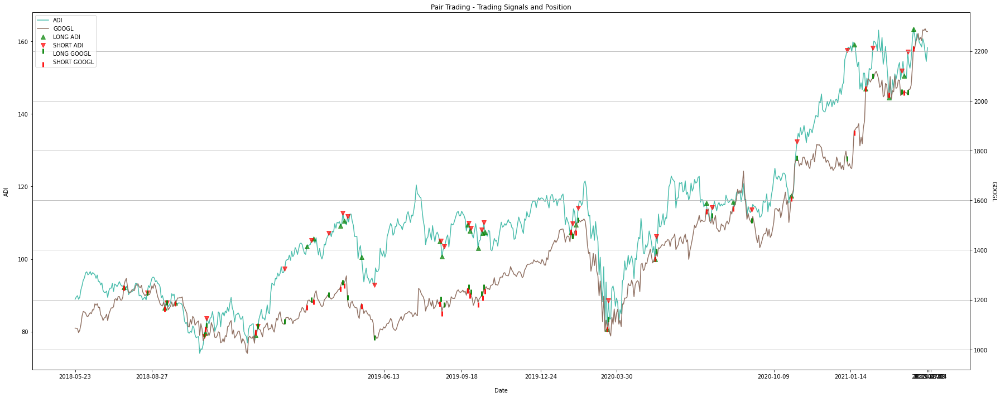

                   ADI         MSI         z  z upper limit  z lower limit  \
Date                                                                         
2018-05-23   88.897957  105.520042  1.139149            1.0           -1.0   
2018-05-24   89.510139  105.539078  1.207995            1.0           -1.0   
2018-05-25   89.896271  105.263000  1.279817            1.0           -1.0   
2021-04-19  156.910004  187.660004  1.061939            1.0           -1.0   
2021-04-20  154.470001  185.270004  1.032886            1.0           -1.0   
2021-04-21  158.289993  186.479996  1.216622            1.0           -1.0   

            signals1  positions1  signals2  positions2  
Date                                                    
2018-05-23        -1        -1.0         1         1.0  
2018-05-24        -1         0.0         1         0.0  
2018-05-25        -1         0.0         1         0.0  
2021-04-19        -1         0.0         1         0.0  
2021-04-20        -1         0.0 

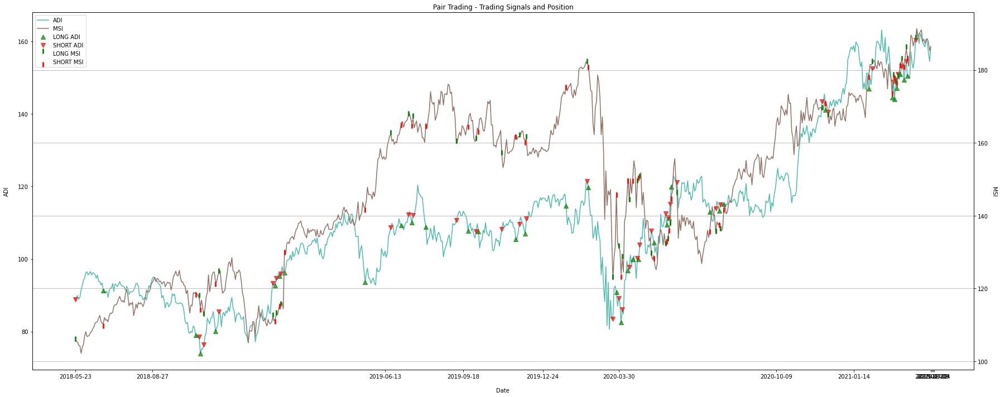

                   ADI        SNPS         z  z upper limit  z lower limit  \
Date                                                                         
2018-05-23   88.897957   90.330002  1.313658            1.0           -1.0   
2018-05-24   89.510139   88.559998  1.483480            1.0           -1.0   
2018-05-25   89.896271   88.320000  1.528957            1.0           -1.0   
2021-04-19  156.910004  250.639999 -0.974140            1.0           -1.0   
2021-04-20  154.470001  250.169998 -1.028936            1.0           -1.0   
2021-04-21  158.289993  252.559998 -0.969637            1.0           -1.0   

            signals1  positions1  signals2  positions2  
Date                                                    
2018-05-23        -1        -1.0         1         1.0  
2018-05-24        -1         0.0         1         0.0  
2018-05-25        -1         0.0         1         0.0  
2021-04-19         0        -1.0         0         1.0  
2021-04-20         1         1.0 

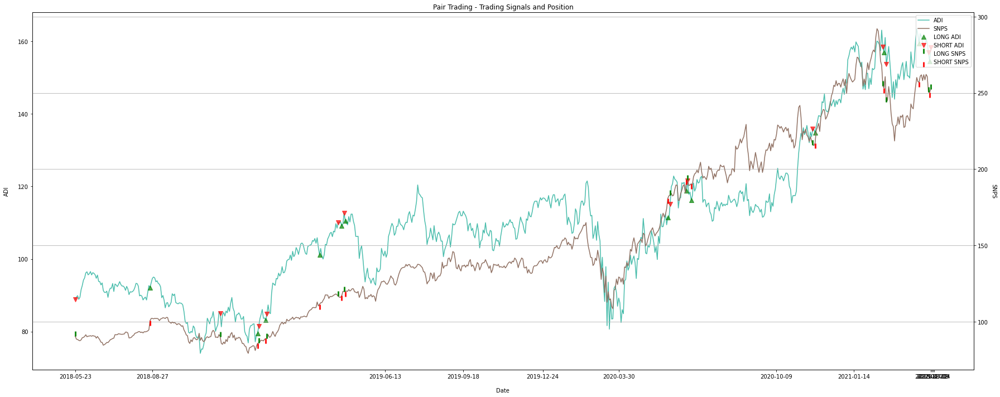

                   ADI        XLNX         z  z upper limit  z lower limit  \
Date                                                                         
2018-05-23   88.897957   66.184227  1.503149            1.0           -1.0   
2018-05-24   89.510139   66.164978  1.566759            1.0           -1.0   
2018-05-25   89.896271   66.992775  1.494511            1.0           -1.0   
2021-04-19  156.910004  126.900002  0.799275            1.0           -1.0   
2021-04-20  154.470001  123.620003  0.885489            1.0           -1.0   
2021-04-21  158.289993  126.949997  0.867769            1.0           -1.0   

            signals1  positions1  signals2  positions2  
Date                                                    
2018-05-23        -1        -1.0         1         1.0  
2018-05-24        -1         0.0         1         0.0  
2018-05-25        -1         0.0         1         0.0  
2021-04-19         0         0.0         0         0.0  
2021-04-20         0         0.0 

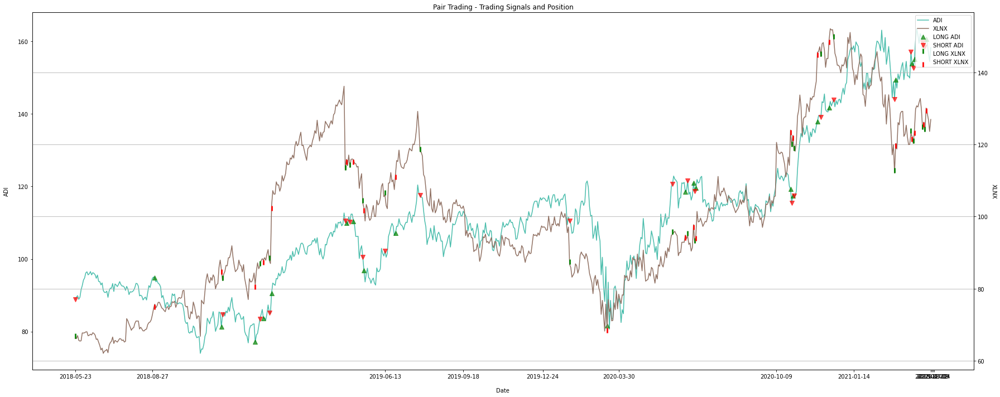

                   ADP        APH         z  z upper limit  z lower limit  \
Date                                                                        
2018-05-23  121.222755  42.791271 -0.723075            1.0           -1.0   
2018-05-24  122.075523  42.597214 -0.619893            1.0           -1.0   
2018-05-25  122.431610  42.340069 -0.538991            1.0           -1.0   
2021-04-19  192.750000  67.510002 -0.653355            1.0           -1.0   
2021-04-20  192.809998  66.790001 -0.554084            1.0           -1.0   
2021-04-21  194.309998  67.730003 -0.610237            1.0           -1.0   

            signals1  positions1  signals2  positions2  
Date                                                    
2018-05-23         0         0.0         0         0.0  
2018-05-24         0         0.0         0         0.0  
2018-05-25         0         0.0         0         0.0  
2021-04-19         0         0.0         0         0.0  
2021-04-20         0         0.0         

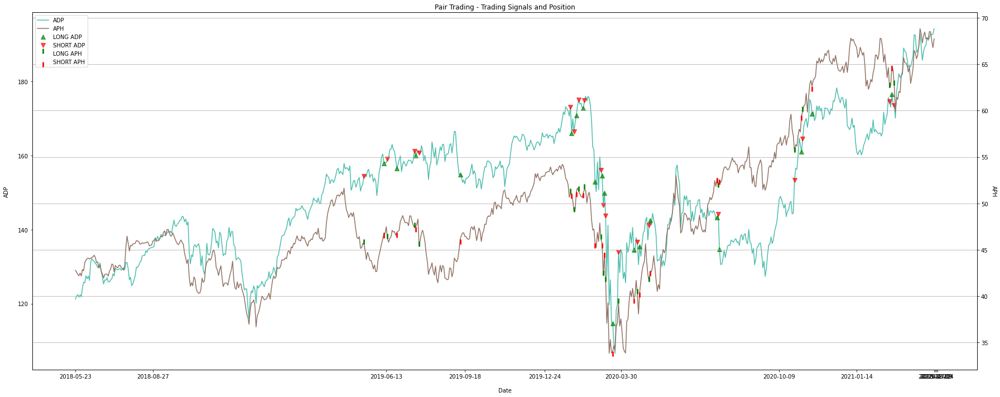

                   ADP         FIS         z  z upper limit  z lower limit  \
Date                                                                         
2018-05-23  121.222755  100.511276 -0.037741            1.0           -1.0   
2018-05-24  122.075523  100.443550  0.038937            1.0           -1.0   
2018-05-25  122.431610  100.114548  0.101171            1.0           -1.0   
2021-04-19  192.750000  152.220001  0.458414            1.0           -1.0   
2021-04-20  192.809998  151.779999  0.491927            1.0           -1.0   
2021-04-21  194.309998  152.440002  0.527697            1.0           -1.0   

            signals1  positions1  signals2  positions2  
Date                                                    
2018-05-23         0         0.0         0         0.0  
2018-05-24         0         0.0         0         0.0  
2018-05-25         0         0.0         0         0.0  
2021-04-19         0         0.0         0         0.0  
2021-04-20         0         0.0 

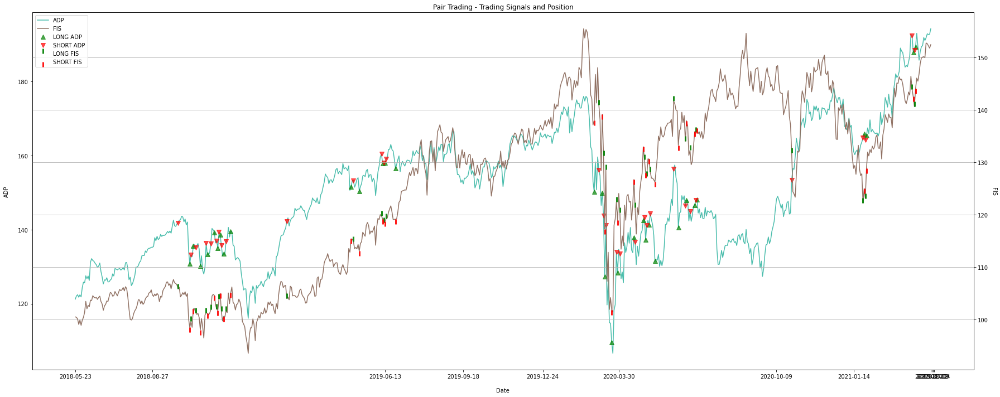

                   ADP         GOOG         z  z upper limit  z lower limit  \
Date                                                                          
2018-05-23  121.222755  1079.689941 -0.034021            1.0           -1.0   
2018-05-24  122.075523  1079.239990  0.015507            1.0           -1.0   
2018-05-25  122.431610  1075.660034  0.057374            1.0           -1.0   
2021-04-19  192.750000  2302.399902 -1.723988            1.0           -1.0   
2021-04-20  192.809998  2293.629883 -1.703497            1.0           -1.0   
2021-04-21  194.309998  2293.290039 -1.664055            1.0           -1.0   

            signals1  positions1  signals2  positions2  
Date                                                    
2018-05-23         0         0.0         0         0.0  
2018-05-24         0         0.0         0         0.0  
2018-05-25         0         0.0         0         0.0  
2021-04-19         1         0.0        -1         0.0  
2021-04-20         1     

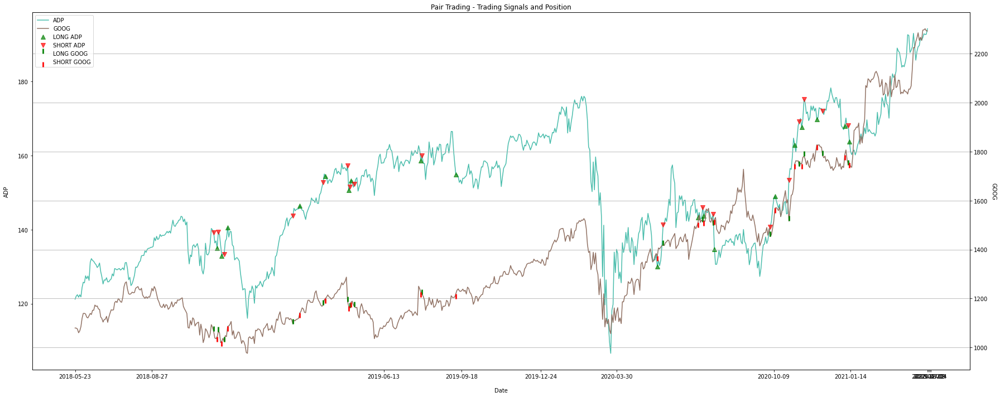

                   ADP        GOOGL         z  z upper limit  z lower limit  \
Date                                                                          
2018-05-23  121.222755  1085.959961 -0.058473            1.0           -1.0   
2018-05-24  122.075523  1085.449951 -0.008099            1.0           -1.0   
2018-05-25  122.431610  1084.079956  0.020186            1.0           -1.0   
2021-04-19  192.750000  2289.760010 -1.708273            1.0           -1.0   
2021-04-20  192.809998  2279.010010 -1.682825            1.0           -1.0   
2021-04-21  194.309998  2278.350098 -1.641780            1.0           -1.0   

            signals1  positions1  signals2  positions2  
Date                                                    
2018-05-23         0         0.0         0         0.0  
2018-05-24         0         0.0         0         0.0  
2018-05-25         0         0.0         0         0.0  
2021-04-19         1         0.0        -1         0.0  
2021-04-20         1     

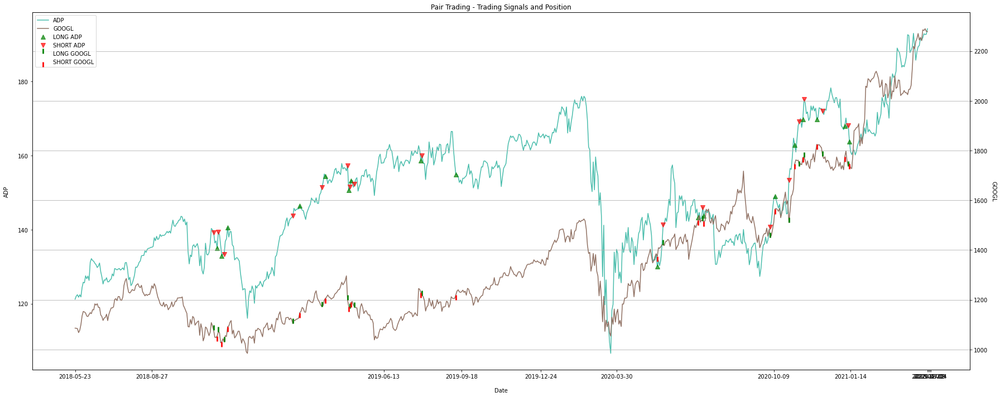

                   ADP          IT         z  z upper limit  z lower limit  \
Date                                                                         
2018-05-23  121.222755  131.759995 -1.179392            1.0           -1.0   
2018-05-24  122.075523  131.300003 -1.090710            1.0           -1.0   
2018-05-25  122.431610  130.639999 -1.022972            1.0           -1.0   
2021-04-19  192.750000  191.940002 -0.411084            1.0           -1.0   
2021-04-20  192.809998  191.429993 -0.383809            1.0           -1.0   
2021-04-21  194.309998  193.419998 -0.407604            1.0           -1.0   

            signals1  positions1  signals2  positions2  
Date                                                    
2018-05-23         1         1.0        -1        -1.0  
2018-05-24         1         0.0        -1         0.0  
2018-05-25         1         0.0        -1         0.0  
2021-04-19         0         0.0         0         0.0  
2021-04-20         0         0.0 

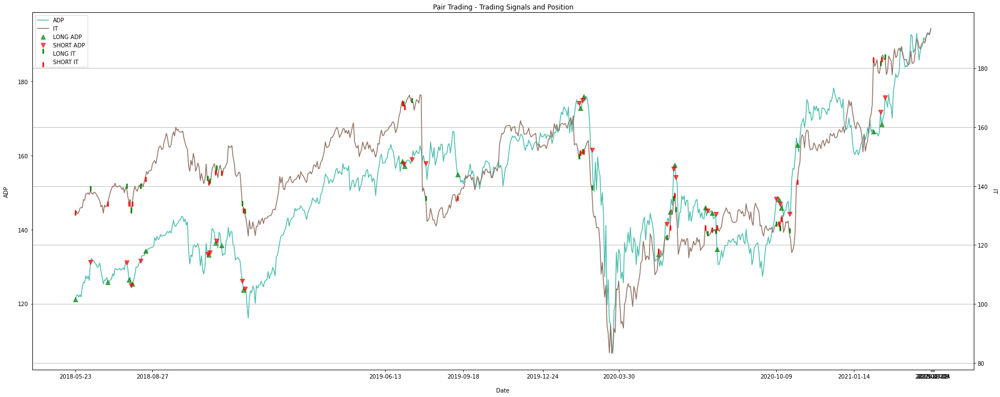

                   ADP         MSI         z  z upper limit  z lower limit  \
Date                                                                         
2018-05-23  121.222755  105.520042  1.399732            1.0           -1.0   
2018-05-24  122.075523  105.539078  1.490366            1.0           -1.0   
2018-05-25  122.431610  105.263000  1.564232            1.0           -1.0   
2021-04-19  192.750000  187.660004 -0.001155            1.0           -1.0   
2021-04-20  192.809998  185.270004  0.155107            1.0           -1.0   
2021-04-21  194.309998  186.479996  0.169971            1.0           -1.0   

            signals1  positions1  signals2  positions2  
Date                                                    
2018-05-23        -1        -1.0         1         1.0  
2018-05-24        -1         0.0         1         0.0  
2018-05-25        -1         0.0         1         0.0  
2021-04-19         0         0.0         0         0.0  
2021-04-20         0         0.0 

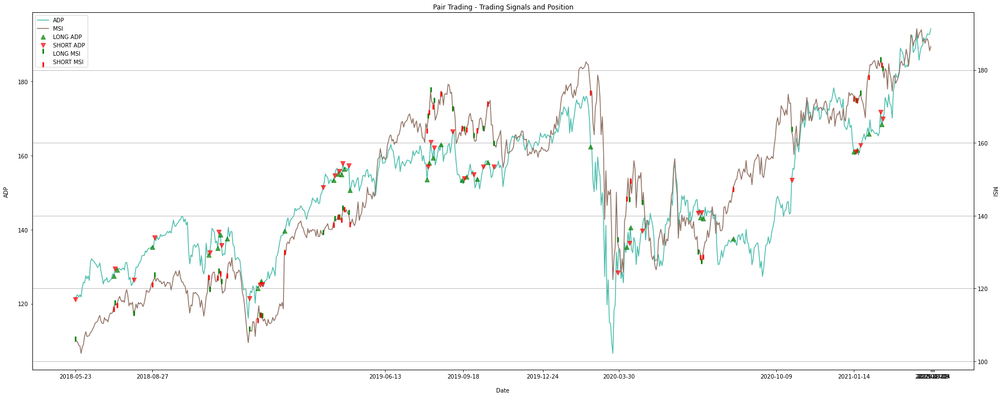

                   ADP        VRSN         z  z upper limit  z lower limit  \
Date                                                                         
2018-05-23  121.222755  128.210007  1.637543            1.0           -1.0   
2018-05-24  122.075523  128.169998  1.719891            1.0           -1.0   
2018-05-25  122.431610  128.509995  1.722866            1.0           -1.0   
2021-04-19  192.750000  207.259995  1.453729            1.0           -1.0   
2021-04-20  192.809998  209.500000  1.339279            1.0           -1.0   
2021-04-21  194.309998  211.110001  1.340305            1.0           -1.0   

            signals1  positions1  signals2  positions2  
Date                                                    
2018-05-23        -1        -1.0         1         1.0  
2018-05-24        -1         0.0         1         0.0  
2018-05-25        -1         0.0         1         0.0  
2021-04-19        -1         0.0         1         0.0  
2021-04-20        -1         0.0 

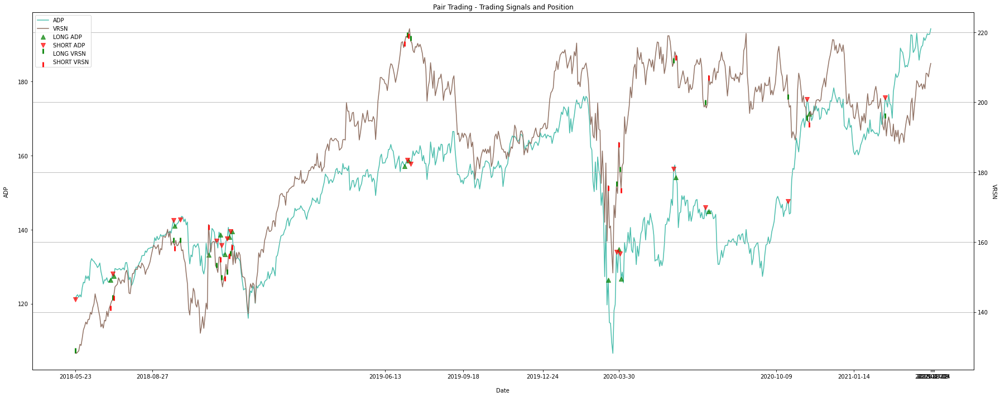

                   ADP        XLNX         z  z upper limit  z lower limit  \
Date                                                                         
2018-05-23  121.222755   66.184227  1.181200            1.0           -1.0   
2018-05-24  122.075523   66.164978  1.235357            1.0           -1.0   
2018-05-25  122.431610   66.992775  1.164813            1.0           -1.0   
2021-04-19  192.750000  126.900002 -0.080510            1.0           -1.0   
2021-04-20  192.809998  123.620003  0.084068            1.0           -1.0   
2021-04-21  194.309998  126.949997 -0.033339            1.0           -1.0   

            signals1  positions1  signals2  positions2  
Date                                                    
2018-05-23        -1        -1.0         1         1.0  
2018-05-24        -1         0.0         1         0.0  
2018-05-25        -1         0.0         1         0.0  
2021-04-19         0         0.0         0         0.0  
2021-04-20         0         0.0 

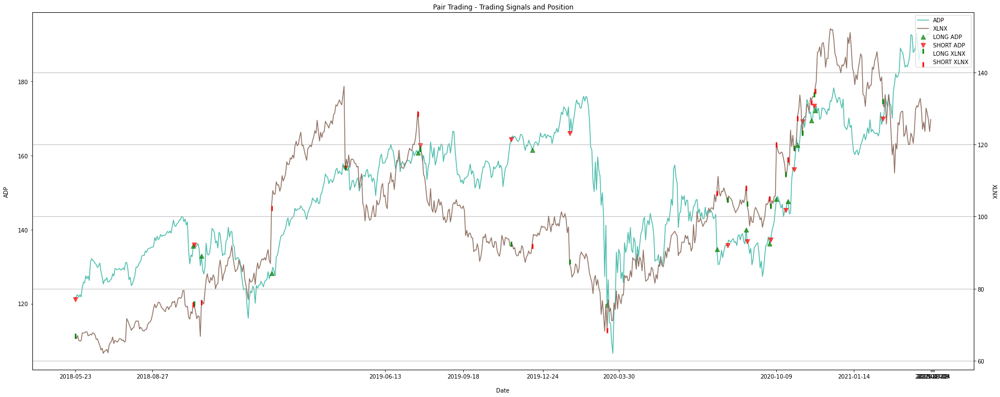

                  ADSK        AMAT         z  z upper limit  z lower limit  \
Date                                                                         
2018-05-23  139.309998   48.190243 -1.049407            1.0           -1.0   
2018-05-24  138.919998   48.601887 -1.106613            1.0           -1.0   
2018-05-25  132.750000   48.678467 -1.337570            1.0           -1.0   
2021-04-19  290.200012  130.889999 -2.234935            1.0           -1.0   
2021-04-20  286.359985  128.589996 -2.217701            1.0           -1.0   
2021-04-21  288.869995  135.050003 -2.372445            1.0           -1.0   

            signals1  positions1  signals2  positions2  
Date                                                    
2018-05-23         1         1.0        -1        -1.0  
2018-05-24         1         0.0        -1         0.0  
2018-05-25         1         0.0        -1         0.0  
2021-04-19         1         0.0        -1         0.0  
2021-04-20         1         0.0 

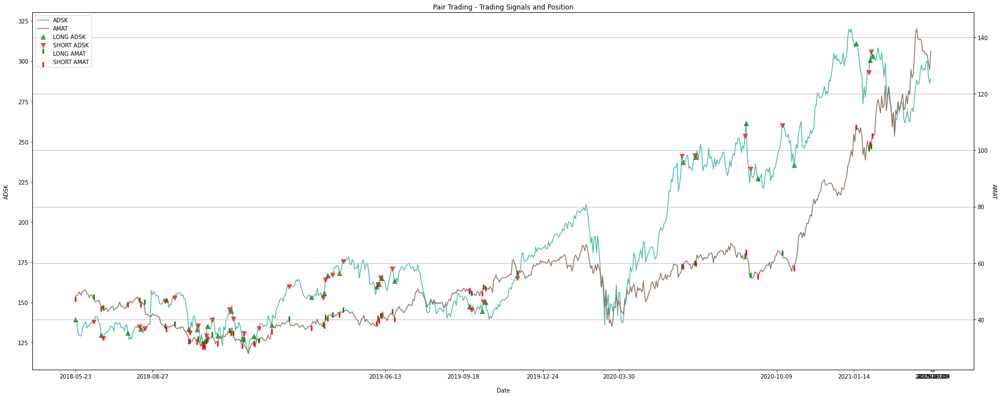

                  ADSK        LRCX         z  z upper limit  z lower limit  \
Date                                                                         
2018-05-23  139.309998  191.630127 -0.171316            1.0           -1.0   
2018-05-24  138.919998  192.629242 -0.208479            1.0           -1.0   
2018-05-25  132.750000  190.423645 -0.362694            1.0           -1.0   
2021-04-19  290.200012  621.729980 -1.839978            1.0           -1.0   
2021-04-20  286.359985  613.030029 -1.837668            1.0           -1.0   
2021-04-21  288.869995  641.250000 -1.944393            1.0           -1.0   

            signals1  positions1  signals2  positions2  
Date                                                    
2018-05-23         0         0.0         0         0.0  
2018-05-24         0         0.0         0         0.0  
2018-05-25         0         0.0         0         0.0  
2021-04-19         1         0.0        -1         0.0  
2021-04-20         1         0.0 

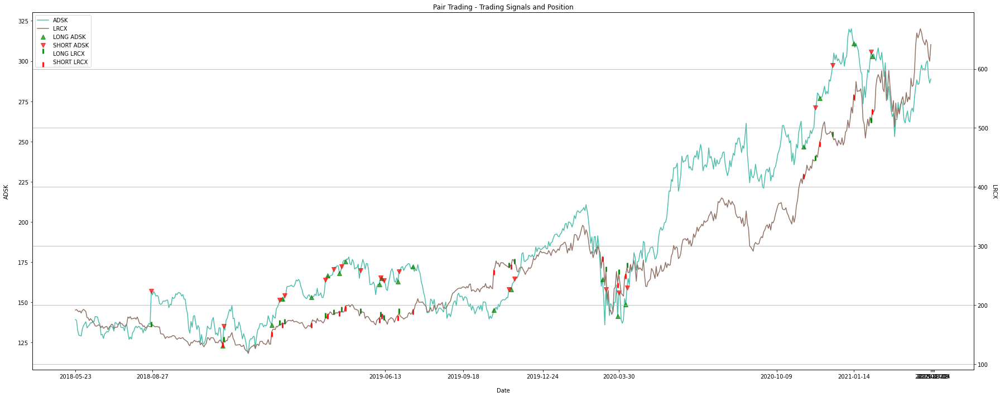

                  ADSK        MCHP         z  z upper limit  z lower limit  \
Date                                                                         
2018-05-23  139.309998   90.190361 -1.584170            1.0           -1.0   
2018-05-24  138.919998   90.928528 -1.652288            1.0           -1.0   
2018-05-25  132.750000   91.848831 -1.986166            1.0           -1.0   
2021-04-19  290.200012  154.029999 -0.210236            1.0           -1.0   
2021-04-20  286.359985  149.729996 -0.095033            1.0           -1.0   
2021-04-21  288.869995  154.649994 -0.275621            1.0           -1.0   

            signals1  positions1  signals2  positions2  
Date                                                    
2018-05-23         1         1.0        -1        -1.0  
2018-05-24         1         0.0        -1         0.0  
2018-05-25         1         0.0        -1         0.0  
2021-04-19         0         0.0         0         0.0  
2021-04-20         0         0.0 

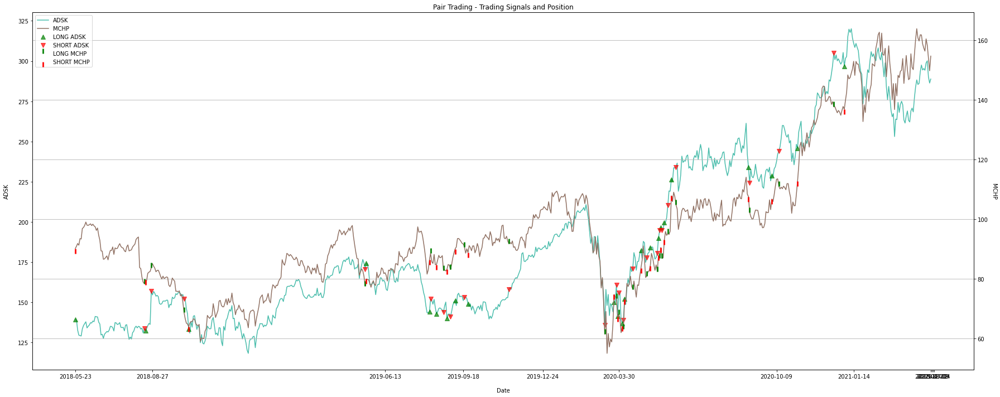

                  ADSK        MSFT         z  z upper limit  z lower limit  \
Date                                                                         
2018-05-23  139.309998   95.203033  1.772827            1.0           -1.0   
2018-05-24  138.919998   94.865280  1.781232            1.0           -1.0   
2018-05-25  132.750000   94.913544  1.278290            1.0           -1.0   
2021-04-19  290.200012  258.739990 -0.840928            1.0           -1.0   
2021-04-20  286.359985  258.260010 -0.938717            1.0           -1.0   
2021-04-21  288.869995  260.579987 -0.940549            1.0           -1.0   

            signals1  positions1  signals2  positions2  
Date                                                    
2018-05-23        -1        -1.0         1         1.0  
2018-05-24        -1         0.0         1         0.0  
2018-05-25        -1         0.0         1         0.0  
2021-04-19         0         0.0         0         0.0  
2021-04-20         0         0.0 

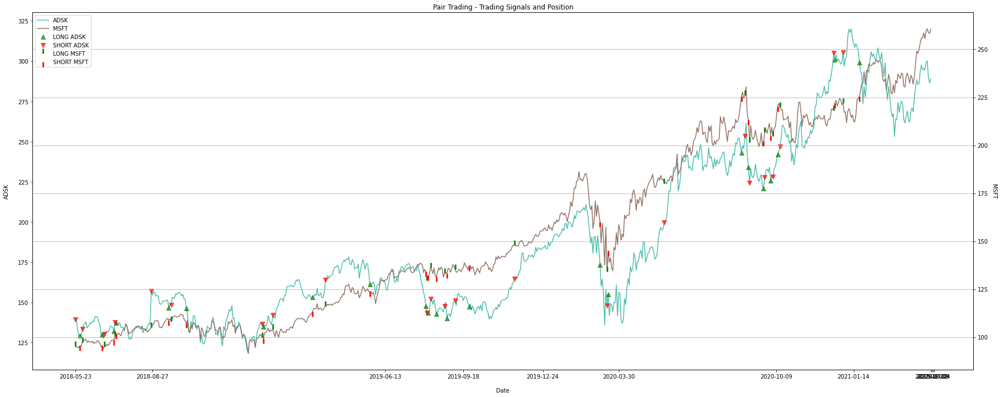

                  ADSK         TXN         z  z upper limit  z lower limit  \
Date                                                                         
2018-05-23  139.309998  102.859314 -1.037414            1.0           -1.0   
2018-05-24  138.919998  102.562965 -1.036805            1.0           -1.0   
2018-05-25  132.750000  103.313095 -1.418666            1.0           -1.0   
2021-04-19  290.200012  187.059998  0.044113            1.0           -1.0   
2021-04-20  286.359985  185.270004  0.012611            1.0           -1.0   
2021-04-21  288.869995  188.899994 -0.077502            1.0           -1.0   

            signals1  positions1  signals2  positions2  
Date                                                    
2018-05-23         1         1.0        -1        -1.0  
2018-05-24         1         0.0        -1         0.0  
2018-05-25         1         0.0        -1         0.0  
2021-04-19         0         0.0         0         0.0  
2021-04-20         0         0.0 

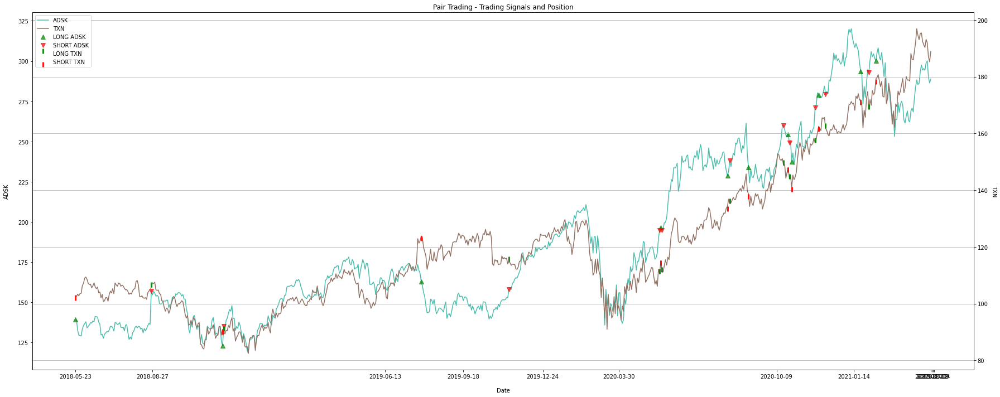

                  AMD       ATVI         z  z upper limit  z lower limit  \
Date                                                                       
2018-05-23  13.100000  70.362610 -1.982930            1.0           -1.0   
2018-05-24  13.410000  69.440659 -1.955009            1.0           -1.0   
2018-05-25  13.540000  70.087990 -1.954722            1.0           -1.0   
2021-04-19  81.110001  96.000000  0.668659            1.0           -1.0   
2021-04-20  79.269997  94.470001  0.645338            1.0           -1.0   
2021-04-21  81.610001  93.180000  0.793188            1.0           -1.0   

            signals1  positions1  signals2  positions2  
Date                                                    
2018-05-23         1         1.0        -1        -1.0  
2018-05-24         1         0.0        -1         0.0  
2018-05-25         1         0.0        -1         0.0  
2021-04-19         0         0.0         0         0.0  
2021-04-20         0         0.0         0       

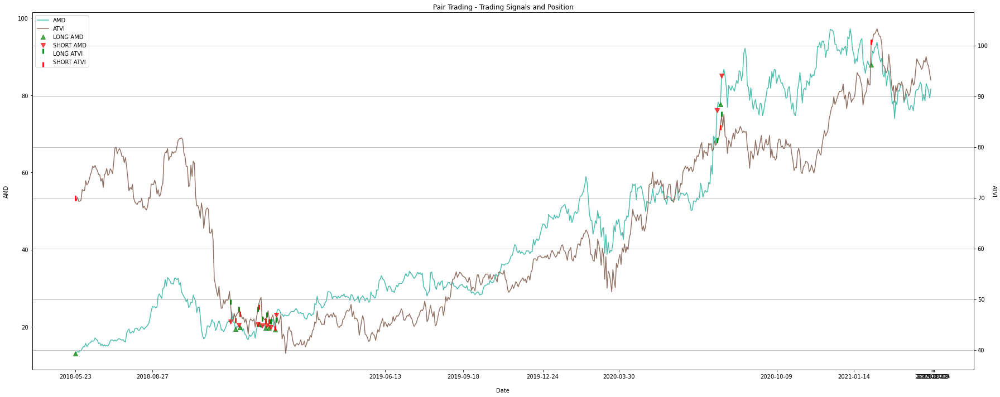

                  AMD        CDNS         z  z upper limit  z lower limit  \
Date                                                                        
2018-05-23  13.100000   42.330002 -1.898563            1.0           -1.0   
2018-05-24  13.410000   42.230000 -1.837665            1.0           -1.0   
2018-05-25  13.540000   42.240002 -1.815017            1.0           -1.0   
2021-04-19  81.110001  141.940002  0.077430            1.0           -1.0   
2021-04-20  79.269997  140.940002  0.009538            1.0           -1.0   
2021-04-21  81.610001  141.500000  0.117487            1.0           -1.0   

            signals1  positions1  signals2  positions2  
Date                                                    
2018-05-23         1         1.0        -1        -1.0  
2018-05-24         1         0.0        -1         0.0  
2018-05-25         1         0.0        -1         0.0  
2021-04-19         0         0.0         0         0.0  
2021-04-20         0         0.0         

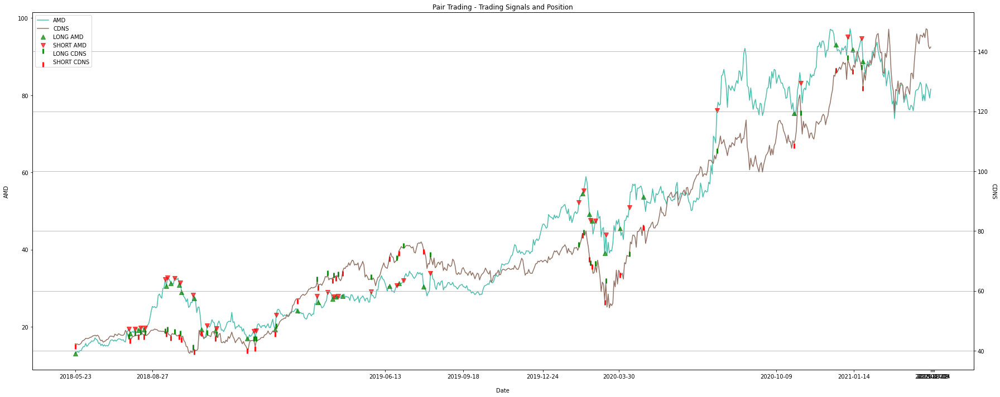

                  AMD       CSCO         z  z upper limit  z lower limit  \
Date                                                                       
2018-05-23  13.100000  39.865742 -1.207644            1.0           -1.0   
2018-05-24  13.410000  39.765350 -1.193231            1.0           -1.0   
2018-05-25  13.540000  39.482414 -1.183692            1.0           -1.0   
2021-04-19  81.110001  52.849998  0.807707            1.0           -1.0   
2021-04-20  79.269997  51.790001  0.800829            1.0           -1.0   
2021-04-21  81.610001  51.930000  0.869227            1.0           -1.0   

            signals1  positions1  signals2  positions2  
Date                                                    
2018-05-23         1         1.0        -1        -1.0  
2018-05-24         1         0.0        -1         0.0  
2018-05-25         1         0.0        -1         0.0  
2021-04-19         0         0.0         0         0.0  
2021-04-20         0         0.0         0       

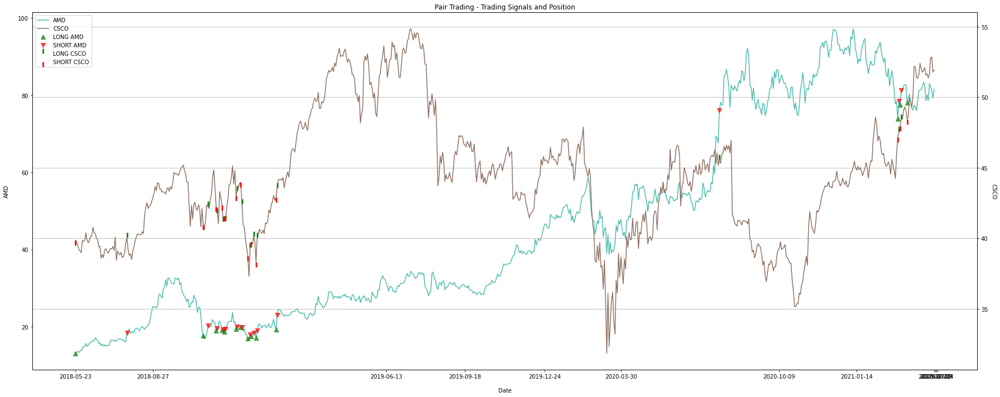

                  AMD        DXC         z  z upper limit  z lower limit  \
Date                                                                       
2018-05-23  13.100000  82.639282 -1.080670            1.0           -1.0   
2018-05-24  13.410000  82.325493 -1.077780            1.0           -1.0   
2018-05-25  13.540000  77.792221 -1.070400            1.0           -1.0   
2021-04-19  81.110001  31.639999  0.509388            1.0           -1.0   
2021-04-20  79.269997  31.040001  0.502958            1.0           -1.0   
2021-04-21  81.610001  31.730000  0.514999            1.0           -1.0   

            signals1  positions1  signals2  positions2  
Date                                                    
2018-05-23         1         1.0        -1        -1.0  
2018-05-24         1         0.0        -1         0.0  
2018-05-25         1         0.0        -1         0.0  
2021-04-19         0         0.0         0         0.0  
2021-04-20         0         0.0         0       

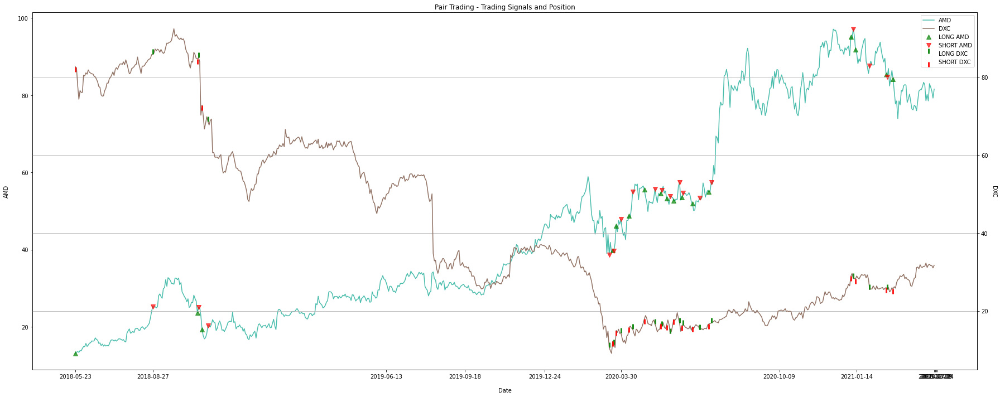

                  AMD          EA         z  z upper limit  z lower limit  \
Date                                                                        
2018-05-23  13.100000  133.157242 -1.766624            1.0           -1.0   
2018-05-24  13.410000  131.142426 -1.743462            1.0           -1.0   
2018-05-25  13.540000  131.511475 -1.739269            1.0           -1.0   
2021-04-19  81.110001  139.630005  1.117227            1.0           -1.0   
2021-04-20  79.269997  140.860001  1.008839            1.0           -1.0   
2021-04-21  81.610001  141.039993  1.103707            1.0           -1.0   

            signals1  positions1  signals2  positions2  
Date                                                    
2018-05-23         1         1.0        -1        -1.0  
2018-05-24         1         0.0        -1         0.0  
2018-05-25         1         0.0        -1         0.0  
2021-04-19        -1         0.0         1         0.0  
2021-04-20        -1         0.0         

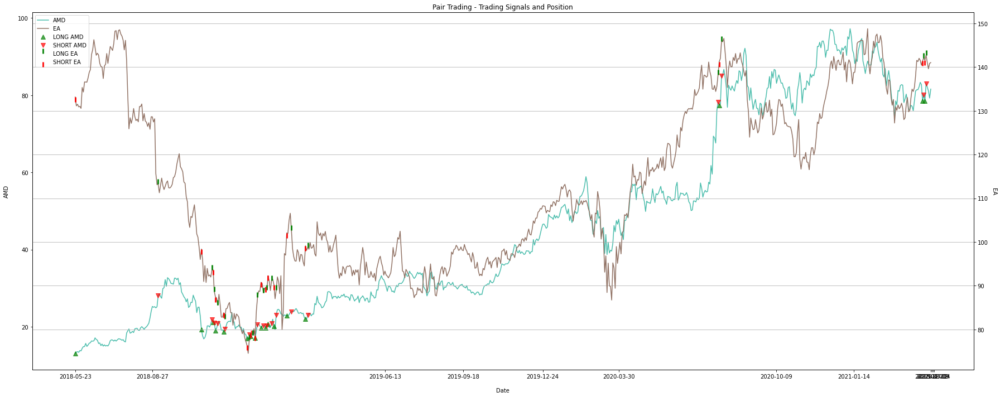

                  AMD        GLW         z  z upper limit  z lower limit  \
Date                                                                       
2018-05-23  13.100000  25.585485 -1.364288            1.0           -1.0   
2018-05-24  13.410000  25.180101 -1.336525            1.0           -1.0   
2018-05-25  13.540000  24.931335 -1.322305            1.0           -1.0   
2021-04-19  81.110001  46.060001  0.322666            1.0           -1.0   
2021-04-20  79.269997  45.560001  0.294220            1.0           -1.0   
2021-04-21  81.610001  46.250000  0.327497            1.0           -1.0   

            signals1  positions1  signals2  positions2  
Date                                                    
2018-05-23         1         1.0        -1        -1.0  
2018-05-24         1         0.0        -1         0.0  
2018-05-25         1         0.0        -1         0.0  
2021-04-19         0         0.0         0         0.0  
2021-04-20         0         0.0         0       

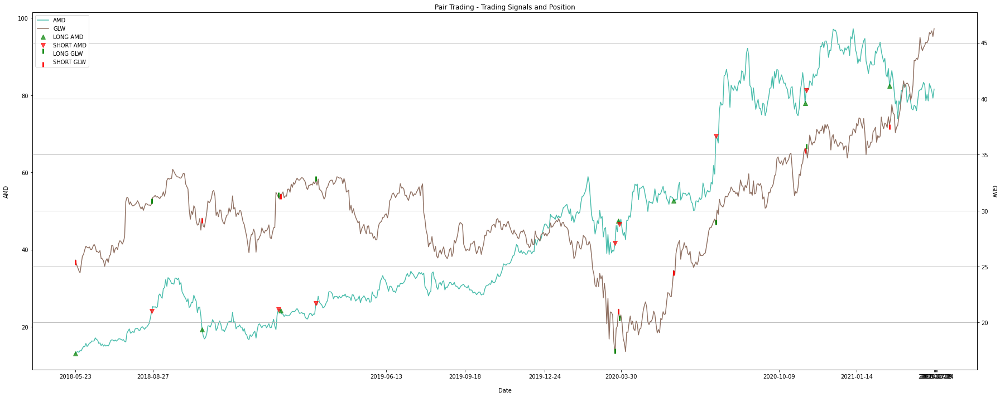

                  AMD         GPN         z  z upper limit  z lower limit  \
Date                                                                        
2018-05-23  13.100000  111.285751 -1.419954            1.0           -1.0   
2018-05-24  13.410000  112.110069 -1.403084            1.0           -1.0   
2018-05-25  13.540000  110.948051 -1.381553            1.0           -1.0   
2021-04-19  81.110001  215.899994  0.870960            1.0           -1.0   
2021-04-20  79.269997  213.029999  0.839203            1.0           -1.0   
2021-04-21  81.610001  215.169998  0.902915            1.0           -1.0   

            signals1  positions1  signals2  positions2  
Date                                                    
2018-05-23         1         1.0        -1        -1.0  
2018-05-24         1         0.0        -1         0.0  
2018-05-25         1         0.0        -1         0.0  
2021-04-19         0         0.0         0         0.0  
2021-04-20         0         0.0         

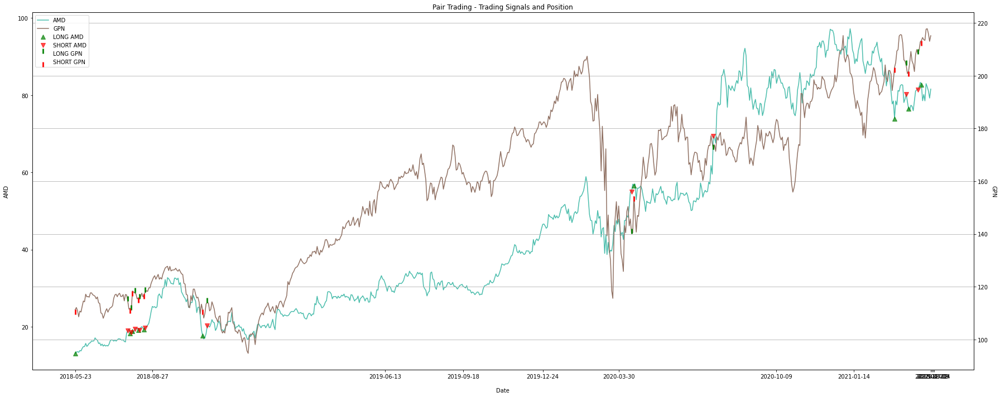

                  AMD        HPQ         z  z upper limit  z lower limit  \
Date                                                                       
2018-05-23  13.100000  20.041748 -1.372705            1.0           -1.0   
2018-05-24  13.410000  20.060051 -1.360219            1.0           -1.0   
2018-05-25  13.540000  20.050903 -1.354514            1.0           -1.0   
2021-04-19  81.110001  33.700001  0.100686            1.0           -1.0   
2021-04-20  79.269997  33.369999  0.074350            1.0           -1.0   
2021-04-21  81.610001  33.900002  0.101148            1.0           -1.0   

            signals1  positions1  signals2  positions2  
Date                                                    
2018-05-23         1         1.0        -1        -1.0  
2018-05-24         1         0.0        -1         0.0  
2018-05-25         1         0.0        -1         0.0  
2021-04-19         0         0.0         0         0.0  
2021-04-20         0         0.0         0       

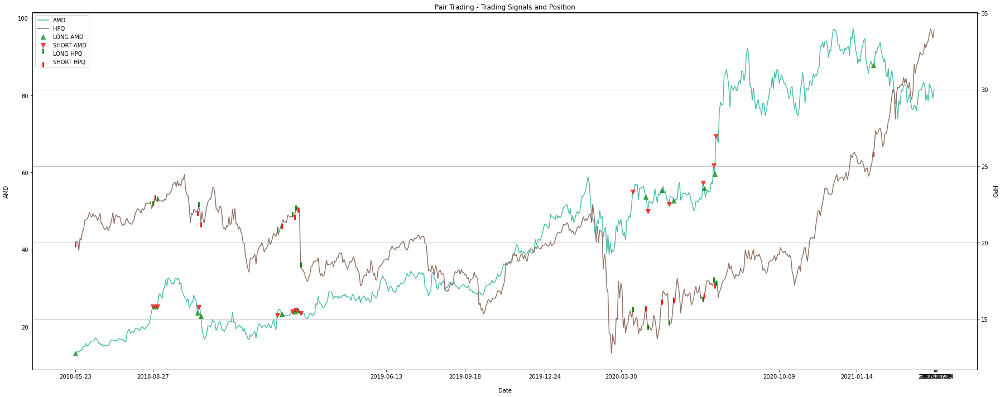

                  AMD       JNPR         z  z upper limit  z lower limit  \
Date                                                                       
2018-05-23  13.100000  24.793077 -1.276892            1.0           -1.0   
2018-05-24  13.410000  24.610846 -1.262288            1.0           -1.0   
2018-05-25  13.540000  24.811298 -1.261547            1.0           -1.0   
2021-04-19  81.110001  25.920000  1.024002            1.0           -1.0   
2021-04-20  79.269997  25.330000  1.024221            1.0           -1.0   
2021-04-21  81.610001  25.559999  1.080299            1.0           -1.0   

            signals1  positions1  signals2  positions2  
Date                                                    
2018-05-23         1         1.0        -1        -1.0  
2018-05-24         1         0.0        -1         0.0  
2018-05-25         1         0.0        -1         0.0  
2021-04-19        -1         0.0         1         0.0  
2021-04-20        -1         0.0         1       

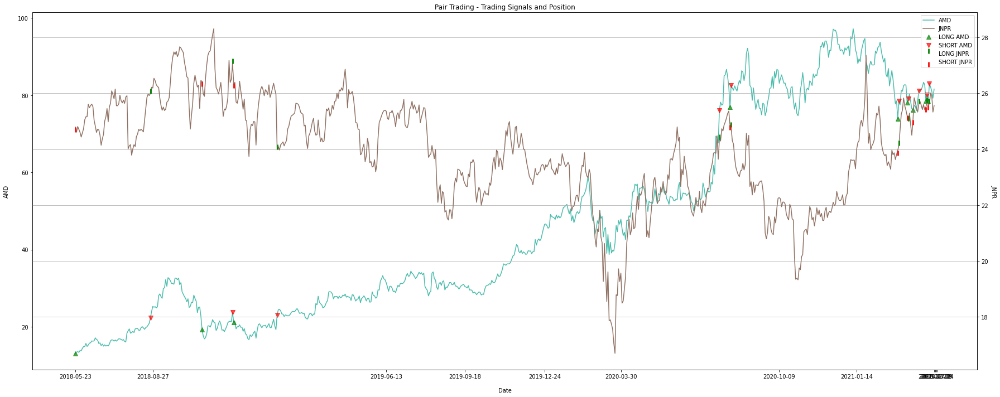

                  AMD        KLAC         z  z upper limit  z lower limit  \
Date                                                                        
2018-05-23  13.100000  106.749916 -2.136653            1.0           -1.0   
2018-05-24  13.410000  106.966614 -2.098940            1.0           -1.0   
2018-05-25  13.540000  107.710930 -2.094092            1.0           -1.0   
2021-04-19  81.110001  324.390015 -0.324350            1.0           -1.0   
2021-04-20  79.269997  318.920013 -0.345429            1.0           -1.0   
2021-04-21  81.610001  331.790009 -0.382278            1.0           -1.0   

            signals1  positions1  signals2  positions2  
Date                                                    
2018-05-23         1         1.0        -1        -1.0  
2018-05-24         1         0.0        -1         0.0  
2018-05-25         1         0.0        -1         0.0  
2021-04-19         0         0.0         0         0.0  
2021-04-20         0         0.0         

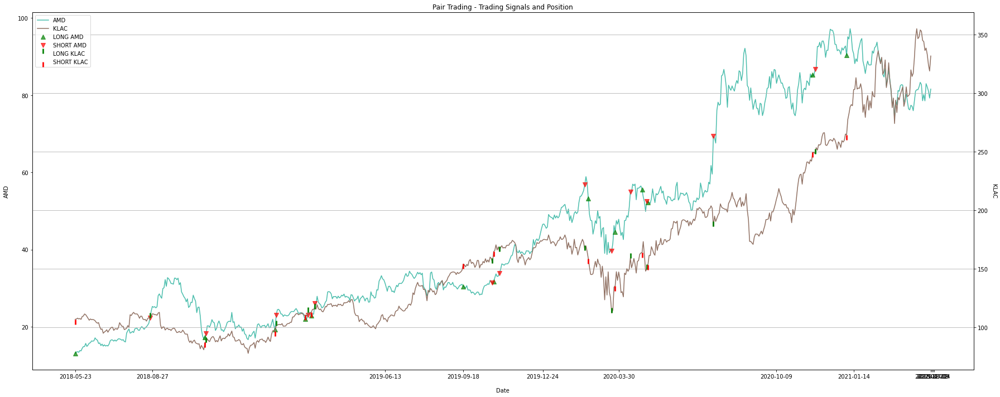

                  AMD        LRCX         z  z upper limit  z lower limit  \
Date                                                                        
2018-05-23  13.100000  191.630127 -2.531864            1.0           -1.0   
2018-05-24  13.410000  192.629242 -2.498781            1.0           -1.0   
2018-05-25  13.540000  190.423645 -2.459520            1.0           -1.0   
2021-04-19  81.110001  621.729980 -0.894562            1.0           -1.0   
2021-04-20  79.269997  613.030029 -0.924885            1.0           -1.0   
2021-04-21  81.610001  641.250000 -0.978711            1.0           -1.0   

            signals1  positions1  signals2  positions2  
Date                                                    
2018-05-23         1         1.0        -1        -1.0  
2018-05-24         1         0.0        -1         0.0  
2018-05-25         1         0.0        -1         0.0  
2021-04-19         0         0.0         0         0.0  
2021-04-20         0         0.0         

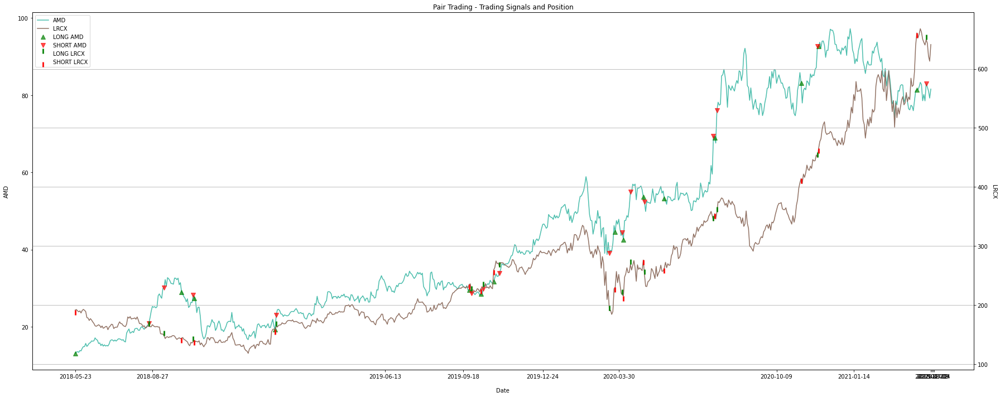

                  AMD        MCHP         z  z upper limit  z lower limit  \
Date                                                                        
2018-05-23  13.100000   90.190361 -1.725042            1.0           -1.0   
2018-05-24  13.410000   90.928528 -1.712511            1.0           -1.0   
2018-05-25  13.540000   91.848831 -1.712861            1.0           -1.0   
2021-04-19  81.110001  154.029999  0.417718            1.0           -1.0   
2021-04-20  79.269997  149.729996  0.433642            1.0           -1.0   
2021-04-21  81.610001  154.649994  0.424022            1.0           -1.0   

            signals1  positions1  signals2  positions2  
Date                                                    
2018-05-23         1         1.0        -1        -1.0  
2018-05-24         1         0.0        -1         0.0  
2018-05-25         1         0.0        -1         0.0  
2021-04-19         0         0.0         0         0.0  
2021-04-20         0         0.0         

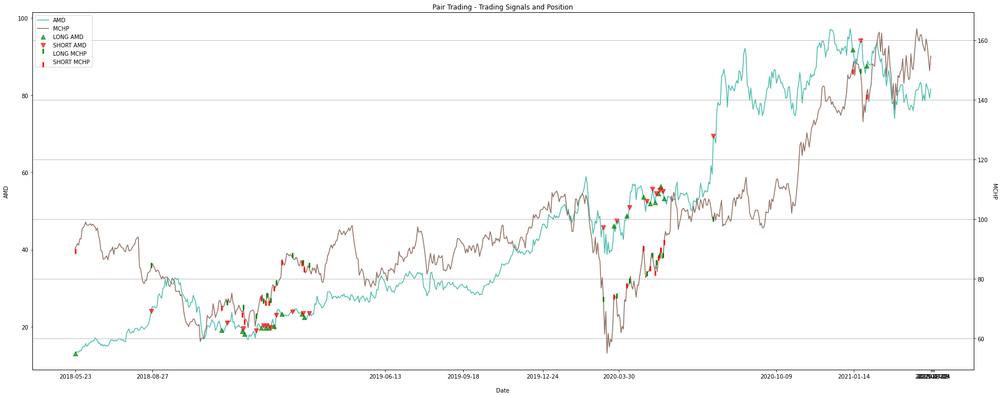

                  AMD        MSFT         z  z upper limit  z lower limit  \
Date                                                                        
2018-05-23  13.100000   95.203033 -1.838521            1.0           -1.0   
2018-05-24  13.410000   94.865280 -1.788433            1.0           -1.0   
2018-05-25  13.540000   94.913544 -1.771135            1.0           -1.0   
2021-04-19  81.110001  258.739990  0.505835            1.0           -1.0   
2021-04-20  79.269997  258.260010  0.418635            1.0           -1.0   
2021-04-21  81.610001  260.579987  0.501907            1.0           -1.0   

            signals1  positions1  signals2  positions2  
Date                                                    
2018-05-23         1         1.0        -1        -1.0  
2018-05-24         1         0.0        -1         0.0  
2018-05-25         1         0.0        -1         0.0  
2021-04-19         0         0.0         0         0.0  
2021-04-20         0         0.0         

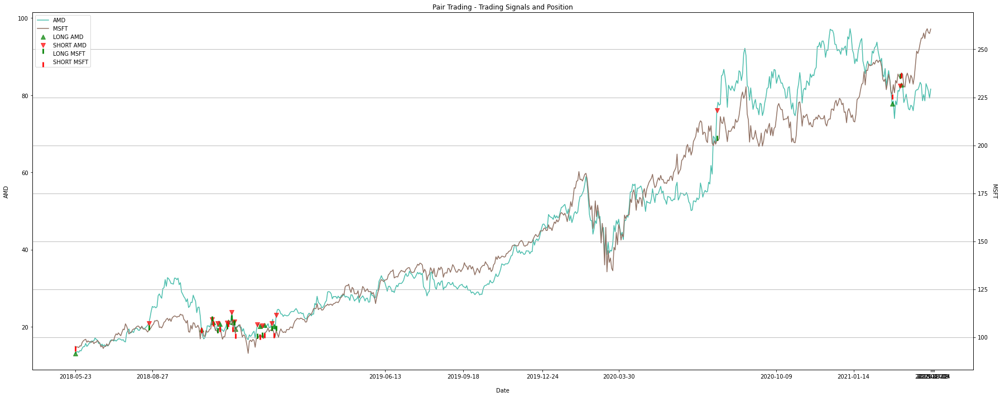

                  AMD        NFLX         z  z upper limit  z lower limit  \
Date                                                                        
2018-05-23  13.100000  344.720001 -1.790075            1.0           -1.0   
2018-05-24  13.410000  349.290009 -1.780560            1.0           -1.0   
2018-05-25  13.540000  351.290009 -1.776866            1.0           -1.0   
2021-04-19  81.110001  554.440002  0.849930            1.0           -1.0   
2021-04-20  79.269997  549.570007  0.799911            1.0           -1.0   
2021-04-21  81.610001  508.899994  1.193034            1.0           -1.0   

            signals1  positions1  signals2  positions2  
Date                                                    
2018-05-23         1         1.0        -1        -1.0  
2018-05-24         1         0.0        -1         0.0  
2018-05-25         1         0.0        -1         0.0  
2021-04-19         0         0.0         0         0.0  
2021-04-20         0         0.0         

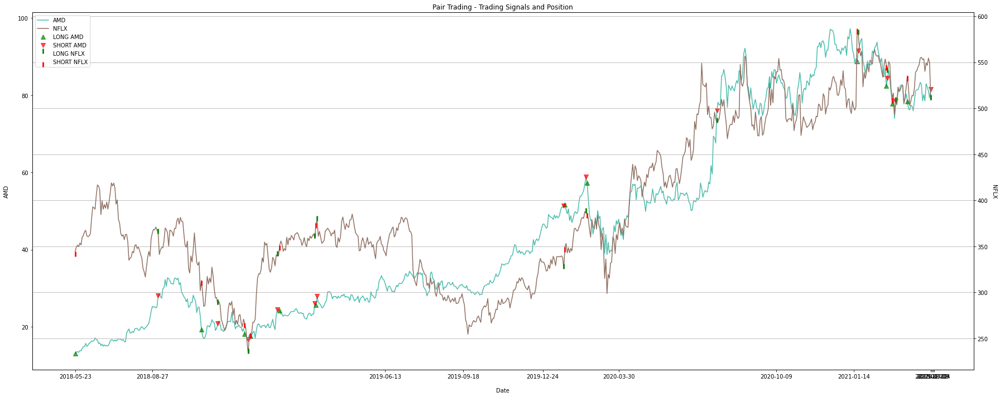

                  AMD       NTAP         z  z upper limit  z lower limit  \
Date                                                                       
2018-05-23  13.100000  60.748791 -1.227832            1.0           -1.0   
2018-05-24  13.410000  61.922104 -1.226101            1.0           -1.0   
2018-05-25  13.540000  61.076233 -1.216454            1.0           -1.0   
2021-04-19  81.110001  77.309998  0.340289            1.0           -1.0   
2021-04-20  79.269997  75.190002  0.349902            1.0           -1.0   
2021-04-21  81.610001  75.910004  0.389083            1.0           -1.0   

            signals1  positions1  signals2  positions2  
Date                                                    
2018-05-23         1         1.0        -1        -1.0  
2018-05-24         1         0.0        -1         0.0  
2018-05-25         1         0.0        -1         0.0  
2021-04-19         0         0.0         0         0.0  
2021-04-20         0         0.0         0       

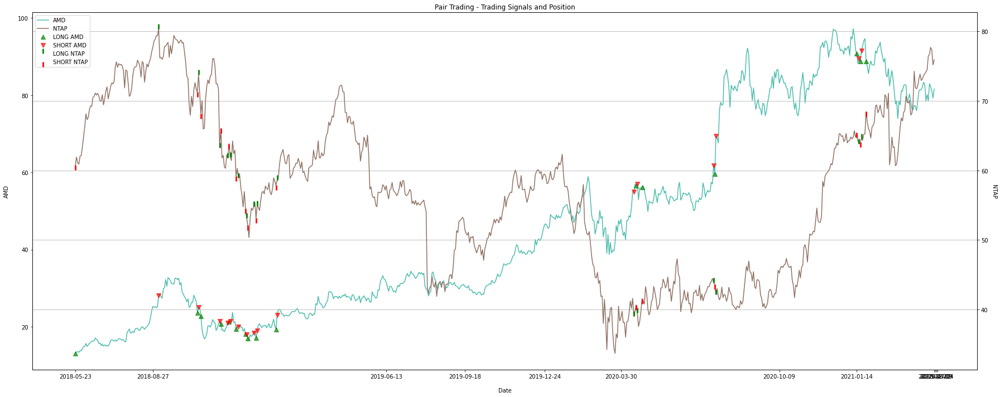

                  AMD        NVDA         z  z upper limit  z lower limit  \
Date                                                                        
2018-05-23  13.100000  245.790283 -2.664891            1.0           -1.0   
2018-05-24  13.410000  245.939224 -2.632124            1.0           -1.0   
2018-05-25  13.540000  247.517990 -2.627390            1.0           -1.0   
2021-04-19  81.110001  614.469971 -0.565214            1.0           -1.0   
2021-04-20  79.269997  606.849976 -0.601886            1.0           -1.0   
2021-04-21  81.610001  614.419983 -0.543218            1.0           -1.0   

            signals1  positions1  signals2  positions2  
Date                                                    
2018-05-23         1         1.0        -1        -1.0  
2018-05-24         1         0.0        -1         0.0  
2018-05-25         1         0.0        -1         0.0  
2021-04-19         0         0.0         0         0.0  
2021-04-20         0         0.0         

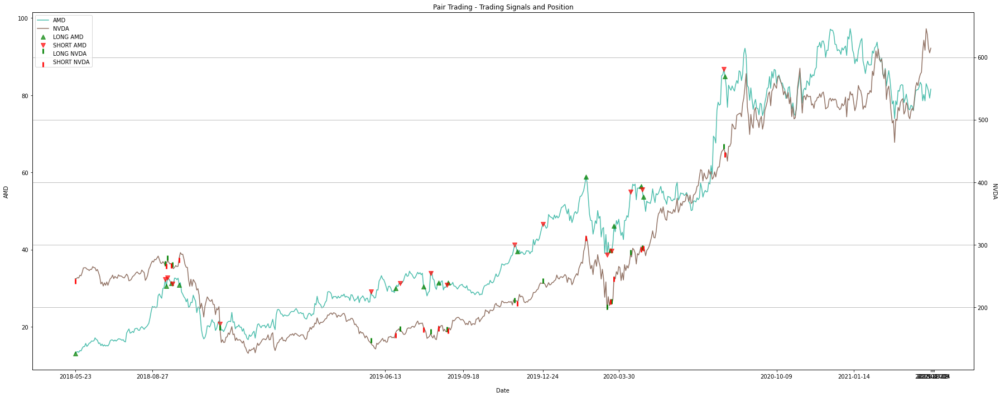

                  AMD        SNPS         z  z upper limit  z lower limit  \
Date                                                                        
2018-05-23  13.100000   90.330002 -2.130959            1.0           -1.0   
2018-05-24  13.410000   88.559998 -2.034080            1.0           -1.0   
2018-05-25  13.540000   88.320000 -2.005566            1.0           -1.0   
2021-04-19  81.110001  250.639999  0.572834            1.0           -1.0   
2021-04-20  79.269997  250.169998  0.470685            1.0           -1.0   
2021-04-21  81.610001  252.559998  0.565561            1.0           -1.0   

            signals1  positions1  signals2  positions2  
Date                                                    
2018-05-23         1         1.0        -1        -1.0  
2018-05-24         1         0.0        -1         0.0  
2018-05-25         1         0.0        -1         0.0  
2021-04-19         0         0.0         0         0.0  
2021-04-20         0         0.0         

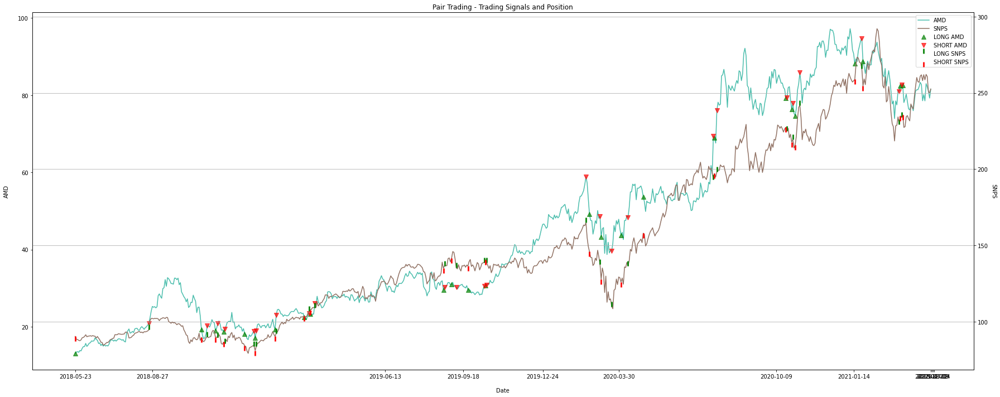

                  AMD        STX         z  z upper limit  z lower limit  \
Date                                                                       
2018-05-23  13.100000  50.014042 -1.556899            1.0           -1.0   
2018-05-24  13.410000  50.014042 -1.542043            1.0           -1.0   
2018-05-25  13.540000  49.318928 -1.526669            1.0           -1.0   
2021-04-19  81.110001  82.330002  0.176524            1.0           -1.0   
2021-04-20  79.269997  82.410004  0.120720            1.0           -1.0   
2021-04-21  81.610001  83.879997  0.147179            1.0           -1.0   

            signals1  positions1  signals2  positions2  
Date                                                    
2018-05-23         1         1.0        -1        -1.0  
2018-05-24         1         0.0        -1         0.0  
2018-05-25         1         0.0        -1         0.0  
2021-04-19         0         0.0         0         0.0  
2021-04-20         0         0.0         0       

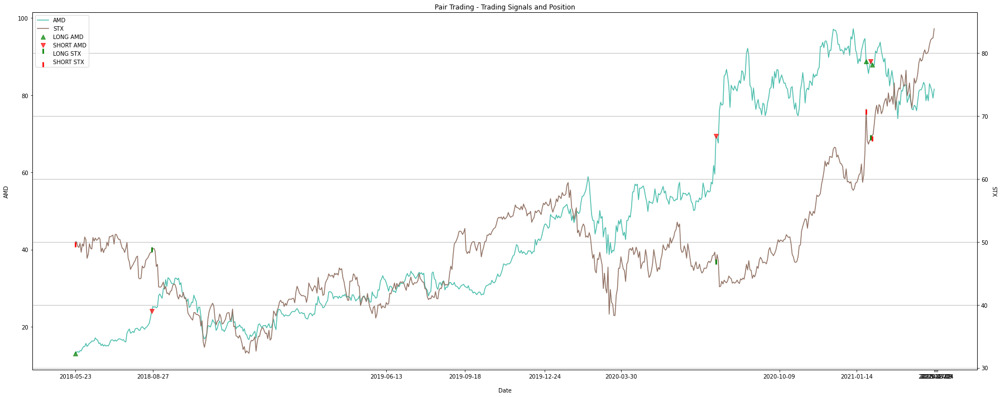

                  AMD         TXN         z  z upper limit  z lower limit  \
Date                                                                        
2018-05-23  13.100000  102.859314 -1.686857            1.0           -1.0   
2018-05-24  13.410000  102.562965 -1.662181            1.0           -1.0   
2018-05-25  13.540000  103.313095 -1.659932            1.0           -1.0   
2021-04-19  81.110001  187.059998  0.541981            1.0           -1.0   
2021-04-20  79.269997  185.270004  0.500190            1.0           -1.0   
2021-04-21  81.610001  188.899994  0.530506            1.0           -1.0   

            signals1  positions1  signals2  positions2  
Date                                                    
2018-05-23         1         1.0        -1        -1.0  
2018-05-24         1         0.0        -1         0.0  
2018-05-25         1         0.0        -1         0.0  
2021-04-19         0         0.0         0         0.0  
2021-04-20         0         0.0         

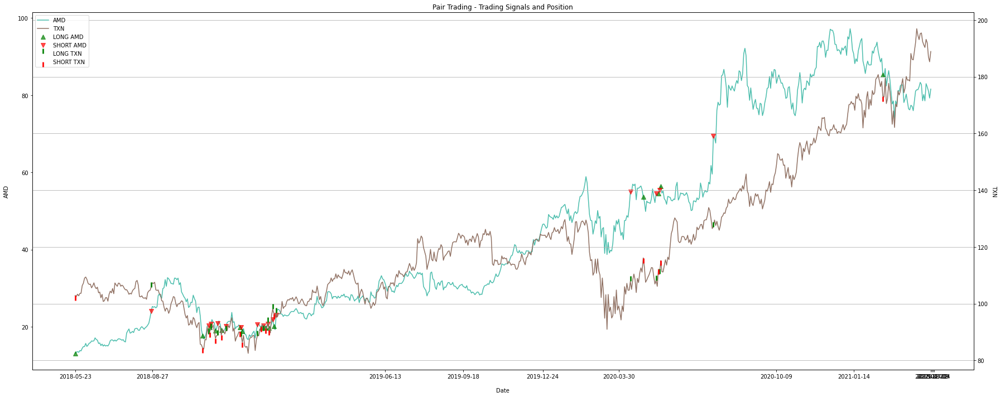

                  AMD        WDC         z  z upper limit  z lower limit  \
Date                                                                       
2018-05-23  13.100000  81.623604 -1.362314            1.0           -1.0   
2018-05-24  13.410000  80.664413 -1.352457            1.0           -1.0   
2018-05-25  13.540000  79.640663 -1.345998            1.0           -1.0   
2021-04-19  81.110001  68.309998  0.397464            1.0           -1.0   
2021-04-20  79.269997  67.980003  0.360957            1.0           -1.0   
2021-04-21  81.610001  69.459999  0.376111            1.0           -1.0   

            signals1  positions1  signals2  positions2  
Date                                                    
2018-05-23         1         1.0        -1        -1.0  
2018-05-24         1         0.0        -1         0.0  
2018-05-25         1         0.0        -1         0.0  
2021-04-19         0         0.0         0         0.0  
2021-04-20         0         0.0         0       

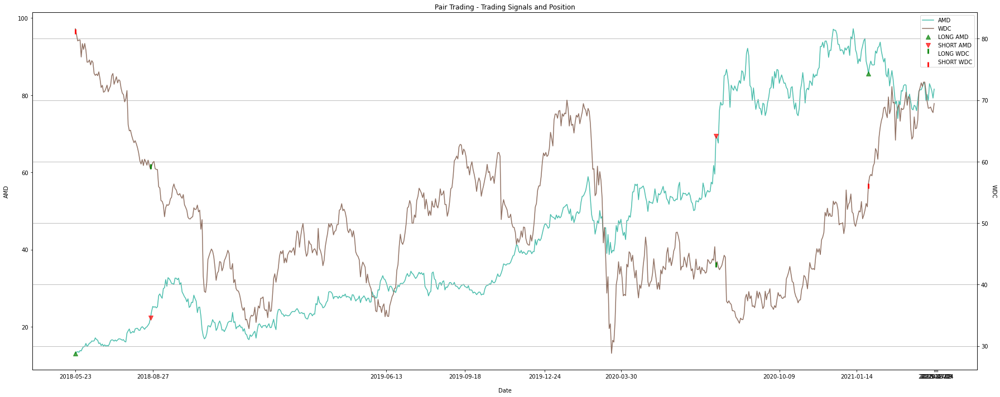

                  AMD         WU         z  z upper limit  z lower limit  \
Date                                                                       
2018-05-23  13.100000  17.927143 -1.403692            1.0           -1.0   
2018-05-24  13.410000  17.873686 -1.384967            1.0           -1.0   
2018-05-25  13.540000  17.820225 -1.375814            1.0           -1.0   
2021-04-19  81.110001  26.150000  0.869668            1.0           -1.0   
2021-04-20  79.269997  25.969999  0.822348            1.0           -1.0   
2021-04-21  81.610001  26.219999  0.880013            1.0           -1.0   

            signals1  positions1  signals2  positions2  
Date                                                    
2018-05-23         1         1.0        -1        -1.0  
2018-05-24         1         0.0        -1         0.0  
2018-05-25         1         0.0        -1         0.0  
2021-04-19         0         0.0         0         0.0  
2021-04-20         0         0.0         0       

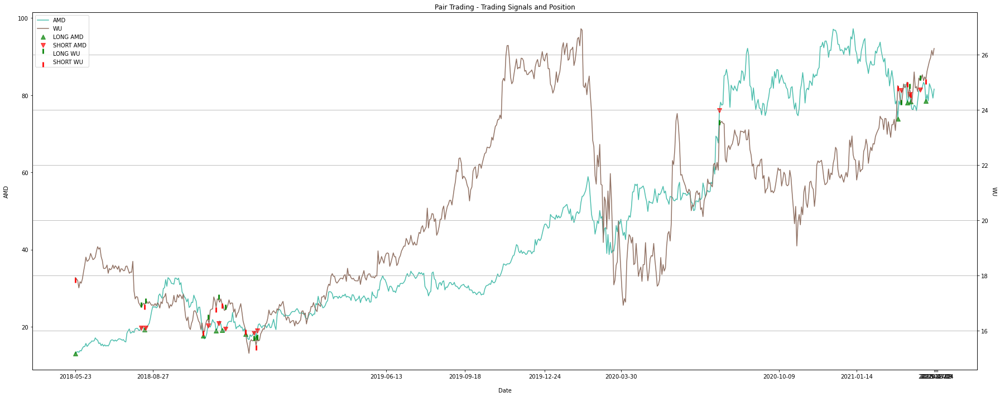

                  AMD        XRX         z  z upper limit  z lower limit  \
Date                                                                       
2018-05-23  13.100000  24.694099 -1.094514            1.0           -1.0   
2018-05-24  13.410000  24.764582 -1.086704            1.0           -1.0   
2018-05-25  13.540000  24.588387 -1.080201            1.0           -1.0   
2021-04-19  81.110001  25.320000  0.801742            1.0           -1.0   
2021-04-20  79.269997  23.709999  0.901005            1.0           -1.0   
2021-04-21  81.610001  24.320000  0.909773            1.0           -1.0   

            signals1  positions1  signals2  positions2  
Date                                                    
2018-05-23         1         1.0        -1        -1.0  
2018-05-24         1         0.0        -1         0.0  
2018-05-25         1         0.0        -1         0.0  
2021-04-19         0         0.0         0         0.0  
2021-04-20         0         0.0         0       

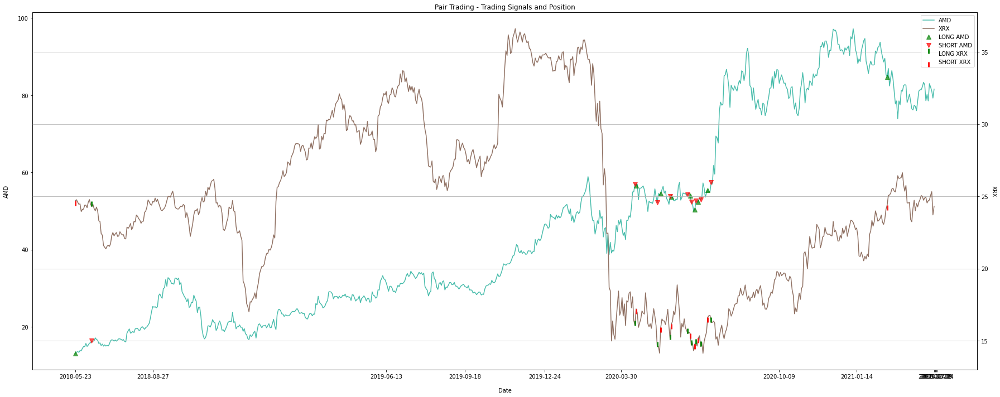

                  ANSS         MSI         z  z upper limit  z lower limit  \
Date                                                                         
2018-05-23  164.160004  105.520042 -0.228553            1.0           -1.0   
2018-05-24  163.220001  105.539078 -0.256547            1.0           -1.0   
2018-05-25  162.320007  105.263000 -0.270239            1.0           -1.0   
2021-04-19  364.470001  187.660004  0.948987            1.0           -1.0   
2021-04-20  364.940002  185.270004  1.033057            1.0           -1.0   
2021-04-21  365.880005  186.479996  1.009473            1.0           -1.0   

            signals1  positions1  signals2  positions2  
Date                                                    
2018-05-23         0         0.0         0         0.0  
2018-05-24         0         0.0         0         0.0  
2018-05-25         0         0.0         0         0.0  
2021-04-19         0         1.0         0        -1.0  
2021-04-20        -1        -1.0 

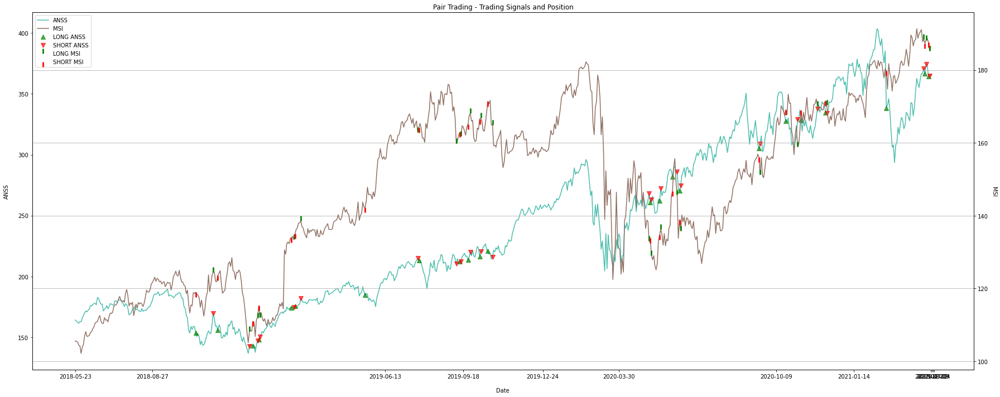

                  ANSS        XLNX         z  z upper limit  z lower limit  \
Date                                                                         
2018-05-23  164.160004   66.184227  0.080826            1.0           -1.0   
2018-05-24  163.220001   66.164978  0.055616            1.0           -1.0   
2018-05-25  162.320007   66.992775 -0.026482            1.0           -1.0   
2021-04-19  364.470001  126.900002  0.813183            1.0           -1.0   
2021-04-20  364.940002  123.620003  0.962751            1.0           -1.0   
2021-04-21  365.880005  126.949997  0.831832            1.0           -1.0   

            signals1  positions1  signals2  positions2  
Date                                                    
2018-05-23         0         0.0         0         0.0  
2018-05-24         0         0.0         0         0.0  
2018-05-25         0         0.0         0         0.0  
2021-04-19         0         0.0         0         0.0  
2021-04-20         0         0.0 

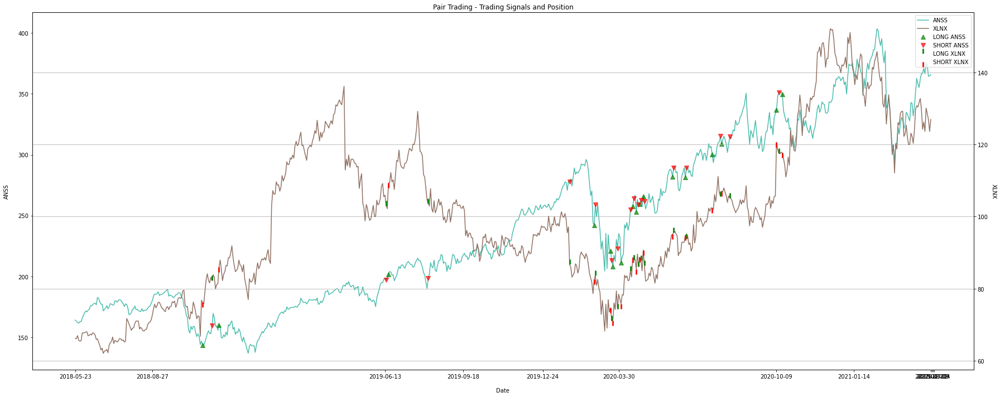

                  APH         FIS         z  z upper limit  z lower limit  \
Date                                                                        
2018-05-23  42.791271  100.511276  0.590104            1.0           -1.0   
2018-05-24  42.597214  100.443550  0.555089            1.0           -1.0   
2018-05-25  42.340069  100.114548  0.530080            1.0           -1.0   
2021-04-19  67.510002  152.220001  0.968301            1.0           -1.0   
2021-04-20  66.790001  151.779999  0.894691            1.0           -1.0   
2021-04-21  67.730003  152.440002  0.985397            1.0           -1.0   

            signals1  positions1  signals2  positions2  
Date                                                    
2018-05-23         0         0.0         0         0.0  
2018-05-24         0         0.0         0         0.0  
2018-05-25         0         0.0         0         0.0  
2021-04-19         0         1.0         0        -1.0  
2021-04-20         0         0.0         

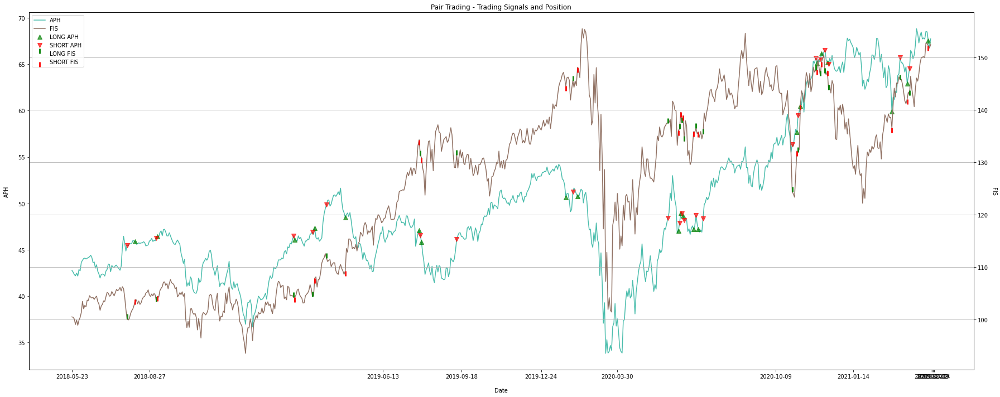

                  APH         GOOG         z  z upper limit  z lower limit  \
Date                                                                         
2018-05-23  42.791271  1079.689941  0.884329            1.0           -1.0   
2018-05-24  42.597214  1079.239990  0.834095            1.0           -1.0   
2018-05-25  42.340069  1075.660034  0.800963            1.0           -1.0   
2021-04-19  67.510002  2302.399902 -2.287912            1.0           -1.0   
2021-04-20  66.790001  2293.629883 -2.349994            1.0           -1.0   
2021-04-21  67.730003  2293.290039 -2.222565            1.0           -1.0   

            signals1  positions1  signals2  positions2  
Date                                                    
2018-05-23         0         0.0         0         0.0  
2018-05-24         0         0.0         0         0.0  
2018-05-25         0         0.0         0         0.0  
2021-04-19         1         0.0        -1         0.0  
2021-04-20         1         0.0 

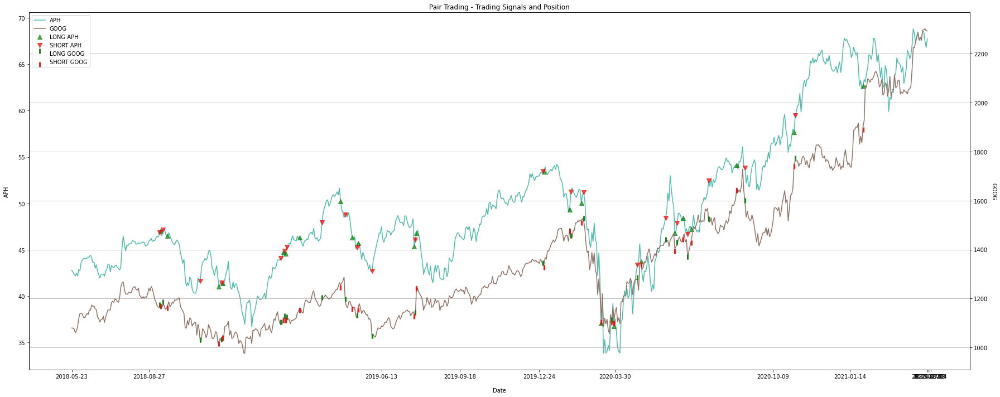

                  APH        GOOGL         z  z upper limit  z lower limit  \
Date                                                                         
2018-05-23  42.791271  1085.959961  0.864485            1.0           -1.0   
2018-05-24  42.597214  1085.449951  0.813604            1.0           -1.0   
2018-05-25  42.340069  1084.079956  0.754043            1.0           -1.0   
2021-04-19  67.510002  2289.760010 -2.285111            1.0           -1.0   
2021-04-20  66.790001  2279.010010 -2.341259            1.0           -1.0   
2021-04-21  67.730003  2278.350098 -2.207579            1.0           -1.0   

            signals1  positions1  signals2  positions2  
Date                                                    
2018-05-23         0         0.0         0         0.0  
2018-05-24         0         0.0         0         0.0  
2018-05-25         0         0.0         0         0.0  
2021-04-19         1         0.0        -1         0.0  
2021-04-20         1         0.0 

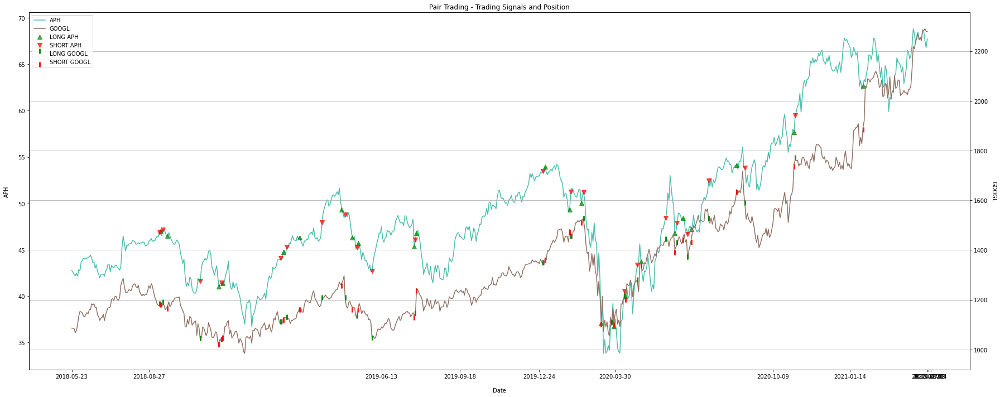

                  APH          IT         z  z upper limit  z lower limit  \
Date                                                                        
2018-05-23  42.791271  131.759995 -0.447445            1.0           -1.0   
2018-05-24  42.597214  131.300003 -0.454748            1.0           -1.0   
2018-05-25  42.340069  130.639999 -0.461817            1.0           -1.0   
2021-04-19  67.510002  191.940002  0.131254            1.0           -1.0   
2021-04-20  66.790001  191.429993  0.070630            1.0           -1.0   
2021-04-21  67.730003  193.419998  0.097898            1.0           -1.0   

            signals1  positions1  signals2  positions2  
Date                                                    
2018-05-23         0         0.0         0         0.0  
2018-05-24         0         0.0         0         0.0  
2018-05-25         0         0.0         0         0.0  
2021-04-19         0         0.0         0         0.0  
2021-04-20         0         0.0         

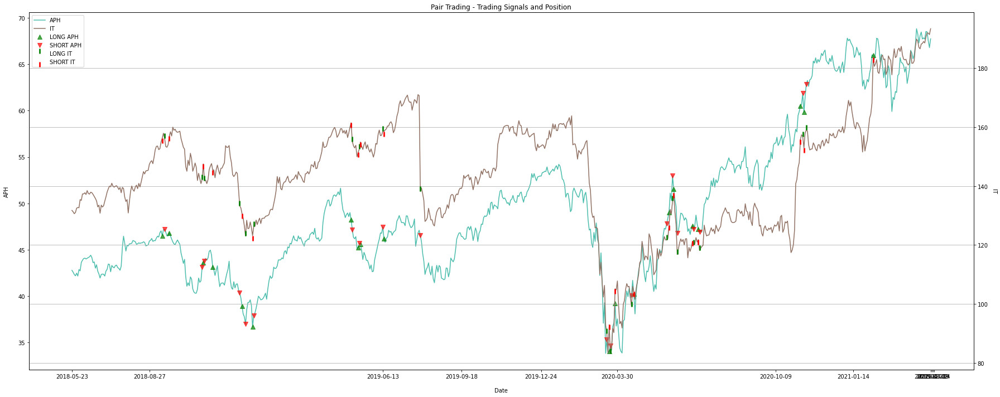

                  APH         MSI         z  z upper limit  z lower limit  \
Date                                                                        
2018-05-23  42.791271  105.520042  1.649824            1.0           -1.0   
2018-05-24  42.597214  105.539078  1.602750            1.0           -1.0   
2018-05-25  42.340069  105.263000  1.568666            1.0           -1.0   
2021-04-19  67.510002  187.660004  0.522617            1.0           -1.0   
2021-04-20  66.790001  185.270004  0.541195            1.0           -1.0   
2021-04-21  67.730003  186.479996  0.607714            1.0           -1.0   

            signals1  positions1  signals2  positions2  
Date                                                    
2018-05-23        -1        -1.0         1         1.0  
2018-05-24        -1         0.0         1         0.0  
2018-05-25        -1         0.0         1         0.0  
2021-04-19         0         0.0         0         0.0  
2021-04-20         0         0.0         

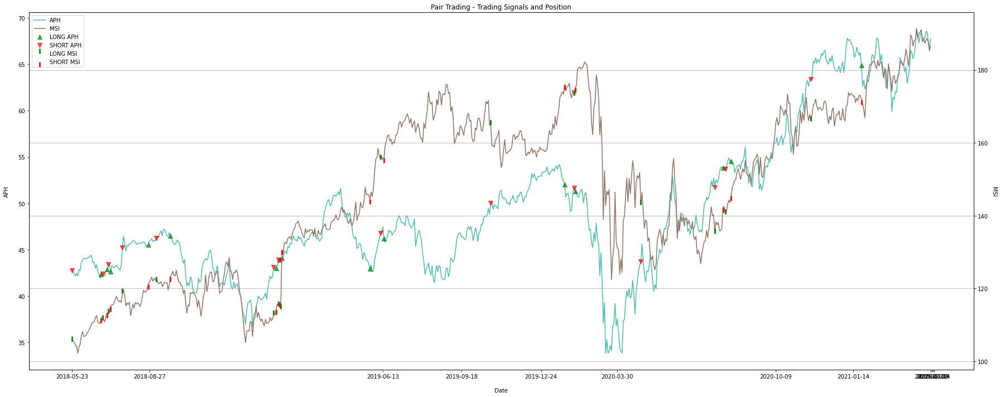

                 ATVI         GPN         z  z upper limit  z lower limit  \
Date                                                                        
2018-05-23  70.362610  111.285751  1.865913            1.0           -1.0   
2018-05-24  69.440659  112.110069  1.749675            1.0           -1.0   
2018-05-25  70.087990  110.948051  1.860940            1.0           -1.0   
2021-04-19  96.000000  215.899994  0.171731            1.0           -1.0   
2021-04-20  94.470001  213.029999  0.160970            1.0           -1.0   
2021-04-21  93.180000  215.169998  0.067008            1.0           -1.0   

            signals1  positions1  signals2  positions2  
Date                                                    
2018-05-23        -1        -1.0         1         1.0  
2018-05-24        -1         0.0         1         0.0  
2018-05-25        -1         0.0         1         0.0  
2021-04-19         0         0.0         0         0.0  
2021-04-20         0         0.0         

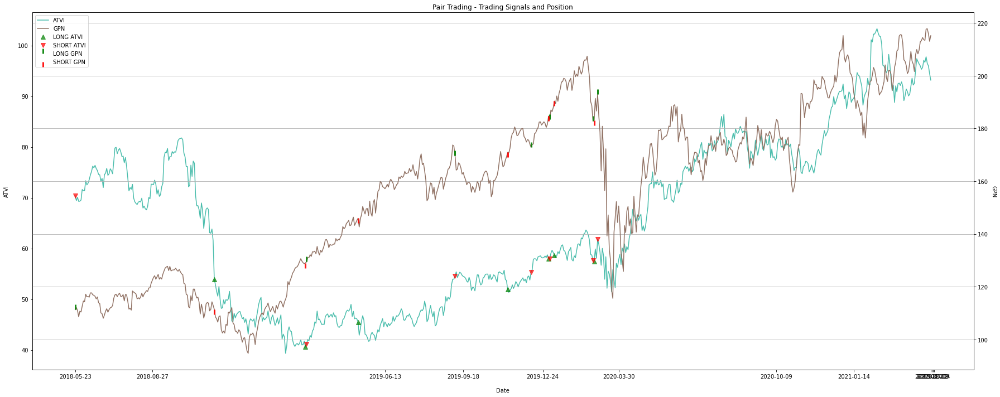

                   CRM        INTU         z  z upper limit  z lower limit  \
Date                                                                         
2018-05-23  128.089996  191.857910  0.390003            1.0           -1.0   
2018-05-24  128.740005  193.383163  0.358795            1.0           -1.0   
2018-05-25  127.959999  192.698746  0.331211            1.0           -1.0   
2021-04-19  230.500000  402.290009 -1.161160            1.0           -1.0   
2021-04-20  227.960007  405.369995 -1.335175            1.0           -1.0   
2021-04-21  230.559998  408.950012 -1.311663            1.0           -1.0   

            signals1  positions1  signals2  positions2  
Date                                                    
2018-05-23         0         0.0         0         0.0  
2018-05-24         0         0.0         0         0.0  
2018-05-25         0         0.0         0         0.0  
2021-04-19         1         0.0        -1         0.0  
2021-04-20         1         0.0 

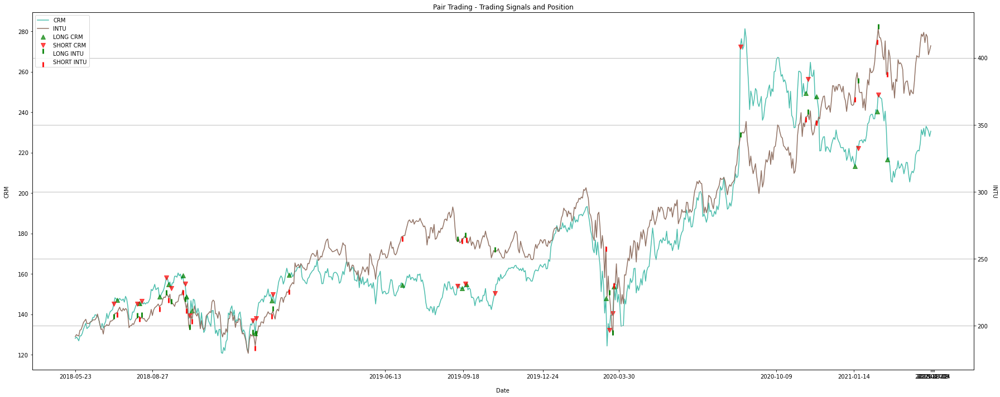

                   CRM          IT         z  z upper limit  z lower limit  \
Date                                                                         
2018-05-23  128.089996  131.759995 -0.890948            1.0           -1.0   
2018-05-24  128.740005  131.300003 -0.862185            1.0           -1.0   
2018-05-25  127.959999  130.639999 -0.865686            1.0           -1.0   
2021-04-19  230.500000  191.940002 -0.103580            1.0           -1.0   
2021-04-20  227.960007  191.429993 -0.138238            1.0           -1.0   
2021-04-21  230.559998  193.419998 -0.134141            1.0           -1.0   

            signals1  positions1  signals2  positions2  
Date                                                    
2018-05-23         0         0.0         0         0.0  
2018-05-24         0         0.0         0         0.0  
2018-05-25         0         0.0         0         0.0  
2021-04-19         0         0.0         0         0.0  
2021-04-20         0         0.0 

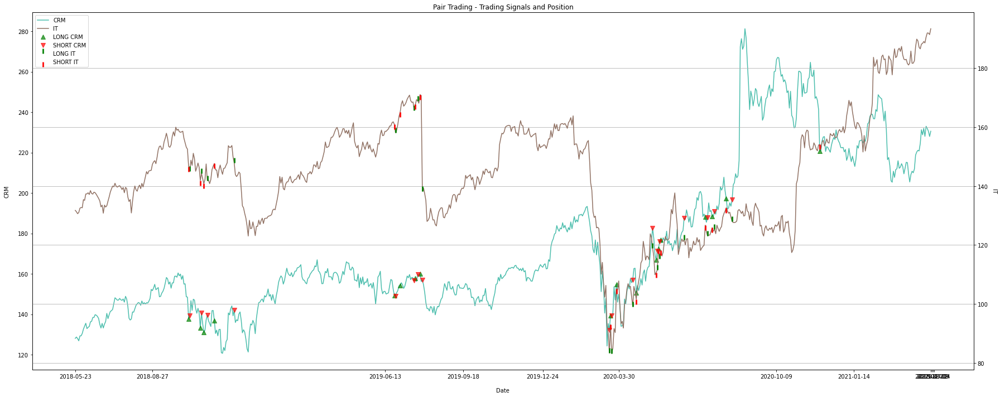

                 CTSH         MSI         z  z upper limit  z lower limit  \
Date                                                                        
2018-05-23  73.180672  105.520042  2.297947            1.0           -1.0   
2018-05-24  73.344887  105.539078  2.312263            1.0           -1.0   
2018-05-25  73.199982  105.263000  2.316727            1.0           -1.0   
2021-04-19  80.400002  187.660004 -0.354439            1.0           -1.0   
2021-04-20  79.610001  185.270004 -0.341804            1.0           -1.0   
2021-04-21  79.250000  186.479996 -0.389017            1.0           -1.0   

            signals1  positions1  signals2  positions2  
Date                                                    
2018-05-23        -1        -1.0         1         1.0  
2018-05-24        -1         0.0         1         0.0  
2018-05-25        -1         0.0         1         0.0  
2021-04-19         0         0.0         0         0.0  
2021-04-20         0         0.0         

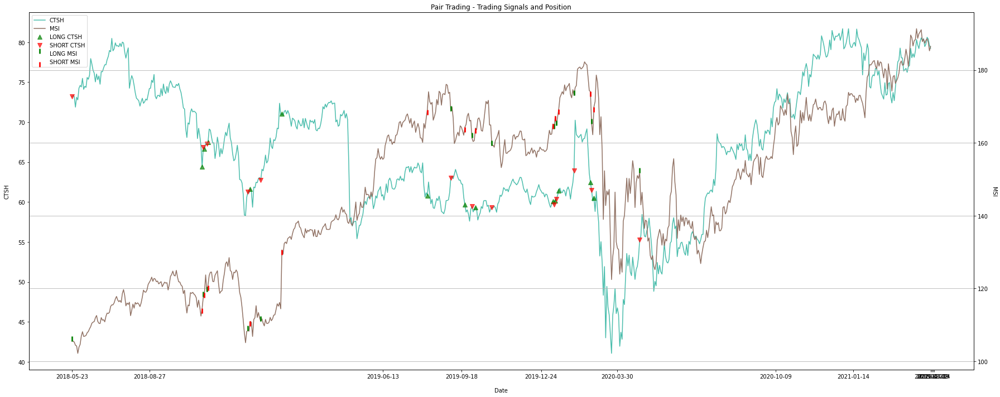

                 EBAY         MSI         z  z upper limit  z lower limit  \
Date                                                                        
2018-05-23  36.826172  105.520042  1.307937            1.0           -1.0   
2018-05-24  36.584145  105.539078  1.264359            1.0           -1.0   
2018-05-25  36.729351  105.263000  1.306687            1.0           -1.0   
2021-04-19  63.790001  187.660004  1.140116            1.0           -1.0   
2021-04-20  61.790001  185.270004  1.021560            1.0           -1.0   
2021-04-21  61.779999  186.479996  0.980543            1.0           -1.0   

            signals1  positions1  signals2  positions2  
Date                                                    
2018-05-23        -1        -1.0         1         1.0  
2018-05-24        -1         0.0         1         0.0  
2018-05-25        -1         0.0         1         0.0  
2021-04-19        -1         0.0         1         0.0  
2021-04-20        -1         0.0         

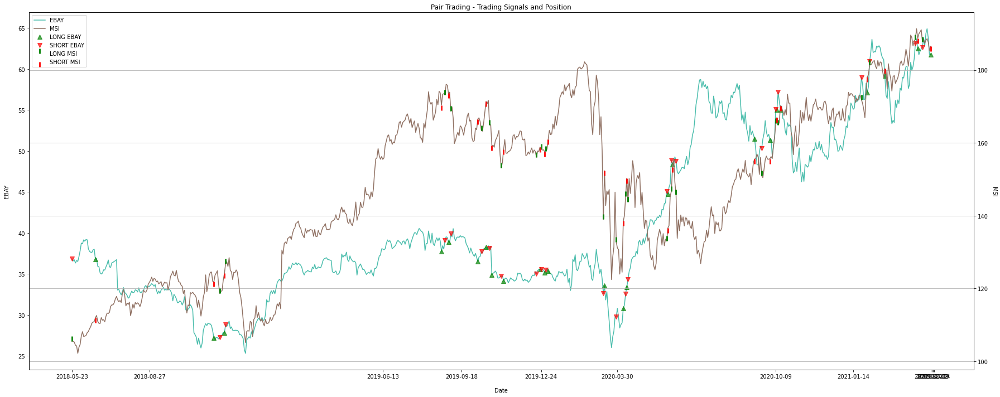

                 EBAY       PAYX         z  z upper limit  z lower limit  \
Date                                                                       
2018-05-23  36.826172  60.104580  0.758132            1.0           -1.0   
2018-05-24  36.584145  60.379578  0.689482            1.0           -1.0   
2018-05-25  36.729351  60.407066  0.710969            1.0           -1.0   
2021-04-19  63.790001  96.430000  1.251017            1.0           -1.0   
2021-04-20  61.790001  97.510002  0.969938            1.0           -1.0   
2021-04-21  61.779999  98.220001  0.922659            1.0           -1.0   

            signals1  positions1  signals2  positions2  
Date                                                    
2018-05-23         0         0.0         0         0.0  
2018-05-24         0         0.0         0         0.0  
2018-05-25         0         0.0         0         0.0  
2021-04-19        -1         0.0         1         0.0  
2021-04-20         0         1.0         0       

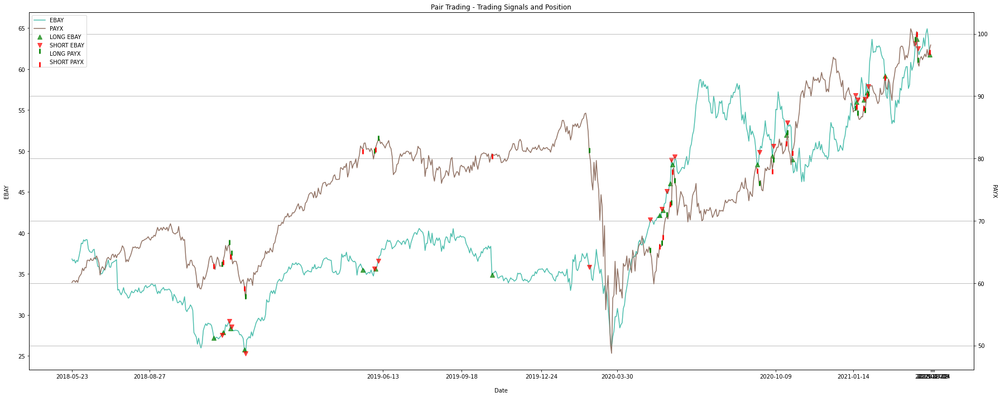

                 EBAY        XLNX         z  z upper limit  z lower limit  \
Date                                                                        
2018-05-23  36.826172   66.184227  1.790497            1.0           -1.0   
2018-05-24  36.584145   66.164978  1.746792            1.0           -1.0   
2018-05-25  36.729351   66.992775  1.688477            1.0           -1.0   
2021-04-19  63.790001  126.900002  1.118678            1.0           -1.0   
2021-04-20  61.790001  123.620003  1.083161            1.0           -1.0   
2021-04-21  61.779999  126.949997  0.918269            1.0           -1.0   

            signals1  positions1  signals2  positions2  
Date                                                    
2018-05-23        -1        -1.0         1         1.0  
2018-05-24        -1         0.0         1         0.0  
2018-05-25        -1         0.0         1         0.0  
2021-04-19        -1         0.0         1         0.0  
2021-04-20        -1         0.0         

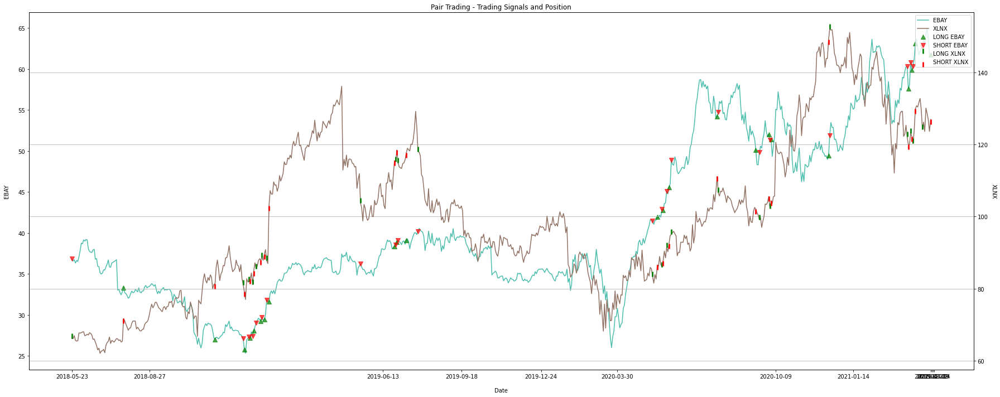

                   FIS         GOOG         z  z upper limit  z lower limit  \
Date                                                                          
2018-05-23  100.511276  1079.689941 -0.027987            1.0           -1.0   
2018-05-24  100.443550  1079.239990 -0.030044            1.0           -1.0   
2018-05-25  100.114548  1075.660034 -0.029710            1.0           -1.0   
2021-04-19  152.220001  2302.399902 -2.345963            1.0           -1.0   
2021-04-20  151.779999  2293.629883 -2.340725            1.0           -1.0   
2021-04-21  152.440002  2293.290039 -2.315156            1.0           -1.0   

            signals1  positions1  signals2  positions2  
Date                                                    
2018-05-23         0         0.0         0         0.0  
2018-05-24         0         0.0         0         0.0  
2018-05-25         0         0.0         0         0.0  
2021-04-19         1         0.0        -1         0.0  
2021-04-20         1     

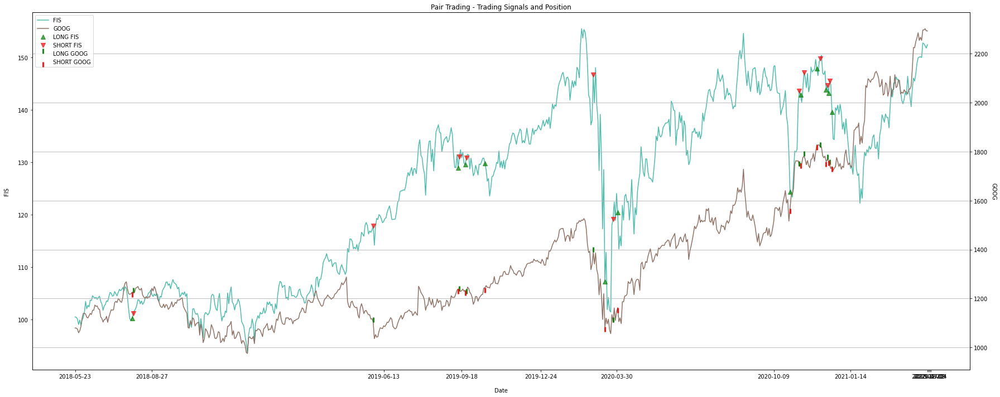

                   FIS        GOOGL         z  z upper limit  z lower limit  \
Date                                                                          
2018-05-23  100.511276  1085.959961 -0.058635            1.0           -1.0   
2018-05-24  100.443550  1085.449951 -0.060268            1.0           -1.0   
2018-05-25  100.114548  1084.079956 -0.076376            1.0           -1.0   
2021-04-19  152.220001  2289.760010 -2.310448            1.0           -1.0   
2021-04-20  151.779999  2279.010010 -2.300042            1.0           -1.0   
2021-04-21  152.440002  2278.350098 -2.273360            1.0           -1.0   

            signals1  positions1  signals2  positions2  
Date                                                    
2018-05-23         0         0.0         0         0.0  
2018-05-24         0         0.0         0         0.0  
2018-05-25         0         0.0         0         0.0  
2021-04-19         1         0.0        -1         0.0  
2021-04-20         1     

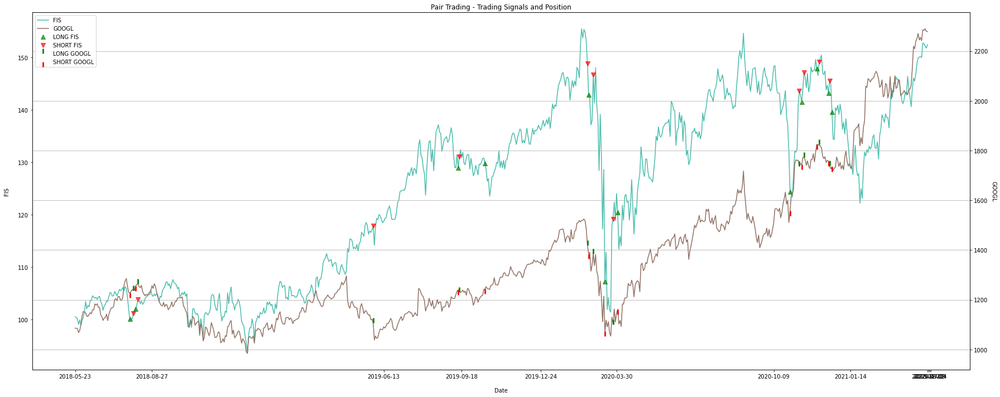

                   FIS          IT         z  z upper limit  z lower limit  \
Date                                                                         
2018-05-23  100.511276  131.759995 -0.718279            1.0           -1.0   
2018-05-24  100.443550  131.300003 -0.705219            1.0           -1.0   
2018-05-25  100.114548  130.639999 -0.697066            1.0           -1.0   
2021-04-19  152.220001  191.940002 -0.535255            1.0           -1.0   
2021-04-20  151.779999  191.429993 -0.536379            1.0           -1.0   
2021-04-21  152.440002  193.419998 -0.565114            1.0           -1.0   

            signals1  positions1  signals2  positions2  
Date                                                    
2018-05-23         0         0.0         0         0.0  
2018-05-24         0         0.0         0         0.0  
2018-05-25         0         0.0         0         0.0  
2021-04-19         0         0.0         0         0.0  
2021-04-20         0         0.0 

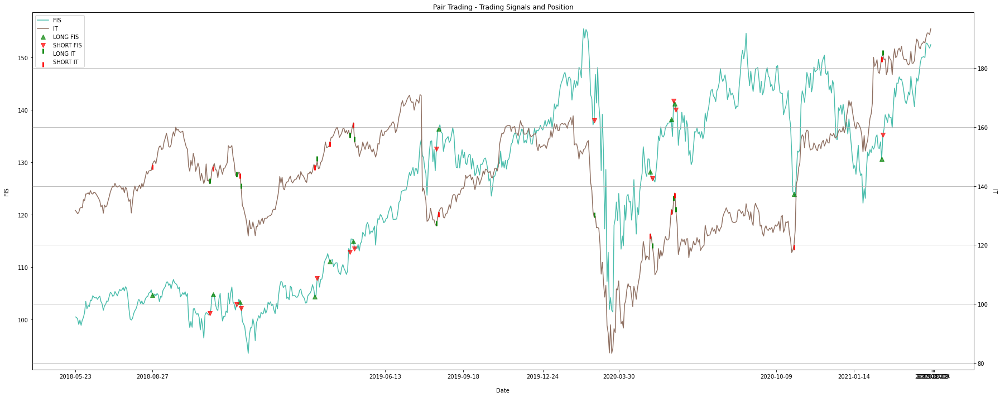

                   FIS        KLAC         z  z upper limit  z lower limit  \
Date                                                                         
2018-05-23  100.511276  106.749916  0.414890            1.0           -1.0   
2018-05-24  100.443550  106.966614  0.402694            1.0           -1.0   
2018-05-25  100.114548  107.710930  0.356878            1.0           -1.0   
2021-04-19  152.220001  324.390015 -1.852540            1.0           -1.0   
2021-04-20  151.779999  318.920013 -1.820525            1.0           -1.0   
2021-04-21  152.440002  331.790009 -1.899601            1.0           -1.0   

            signals1  positions1  signals2  positions2  
Date                                                    
2018-05-23         0         0.0         0         0.0  
2018-05-24         0         0.0         0         0.0  
2018-05-25         0         0.0         0         0.0  
2021-04-19         1         0.0        -1         0.0  
2021-04-20         1         0.0 

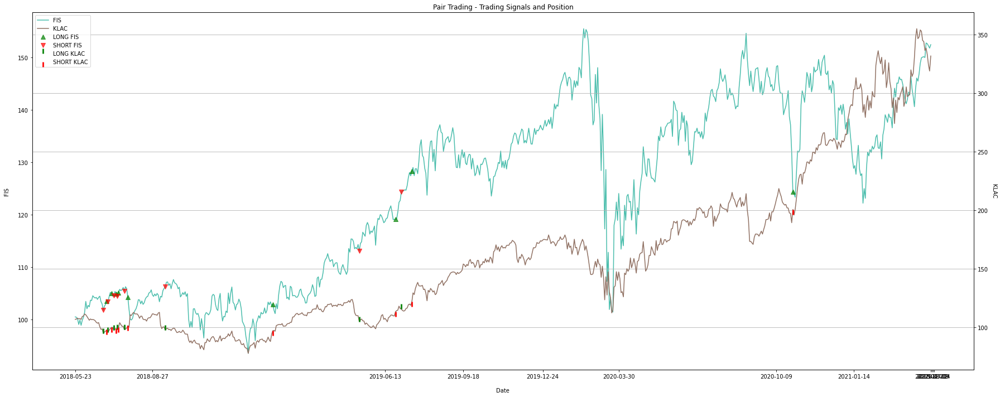

                   FIS         MSI         z  z upper limit  z lower limit  \
Date                                                                         
2018-05-23  100.511276  105.520042  1.276834            1.0           -1.0   
2018-05-24  100.443550  105.539078  1.266356            1.0           -1.0   
2018-05-25  100.114548  105.263000  1.258249            1.0           -1.0   
2021-04-19  152.220001  187.660004 -0.544194            1.0           -1.0   
2021-04-20  151.779999  185.270004 -0.440008            1.0           -1.0   
2021-04-21  152.440002  186.479996 -0.462889            1.0           -1.0   

            signals1  positions1  signals2  positions2  
Date                                                    
2018-05-23        -1        -1.0         1         1.0  
2018-05-24        -1         0.0         1         0.0  
2018-05-25        -1         0.0         1         0.0  
2021-04-19         0         0.0         0         0.0  
2021-04-20         0         0.0 

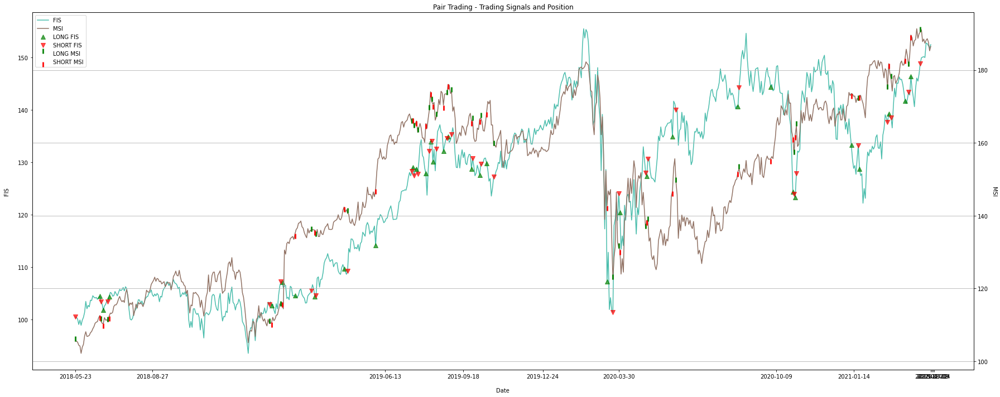

                   GOOG        KLAC         z  z upper limit  z lower limit  \
Date                                                                          
2018-05-23  1079.689941  106.749916  0.552624            1.0           -1.0   
2018-05-24  1079.239990  106.966614  0.539188            1.0           -1.0   
2018-05-25  1075.660034  107.710930  0.483175            1.0           -1.0   
2021-04-19  2302.399902  324.390015 -1.088507            1.0           -1.0   
2021-04-20  2293.629883  318.920013 -1.037238            1.0           -1.0   
2021-04-21  2293.290039  331.790009 -1.189566            1.0           -1.0   

            signals1  positions1  signals2  positions2  
Date                                                    
2018-05-23         0         0.0         0         0.0  
2018-05-24         0         0.0         0         0.0  
2018-05-25         0         0.0         0         0.0  
2021-04-19         1         0.0        -1         0.0  
2021-04-20         1     

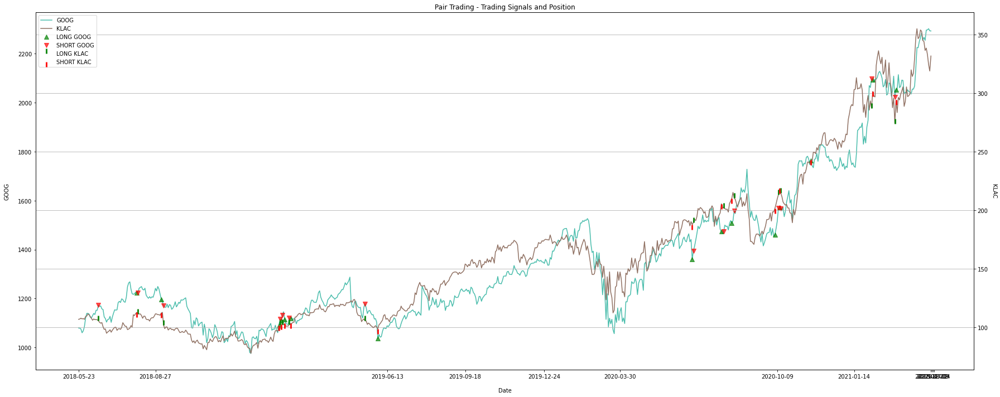

                   GOOG         MSI         z  z upper limit  z lower limit  \
Date                                                                          
2018-05-23  1079.689941  105.520042  0.690854            1.0           -1.0   
2018-05-24  1079.239990  105.539078  0.686419            1.0           -1.0   
2018-05-25  1075.660034  105.263000  0.681200            1.0           -1.0   
2021-04-19  2302.399902  187.660004  2.169557            1.0           -1.0   
2021-04-20  2293.629883  185.270004  2.250090            1.0           -1.0   
2021-04-21  2293.290039  186.479996  2.190453            1.0           -1.0   

            signals1  positions1  signals2  positions2  
Date                                                    
2018-05-23         0         0.0         0         0.0  
2018-05-24         0         0.0         0         0.0  
2018-05-25         0         0.0         0         0.0  
2021-04-19        -1         0.0         1         0.0  
2021-04-20        -1     

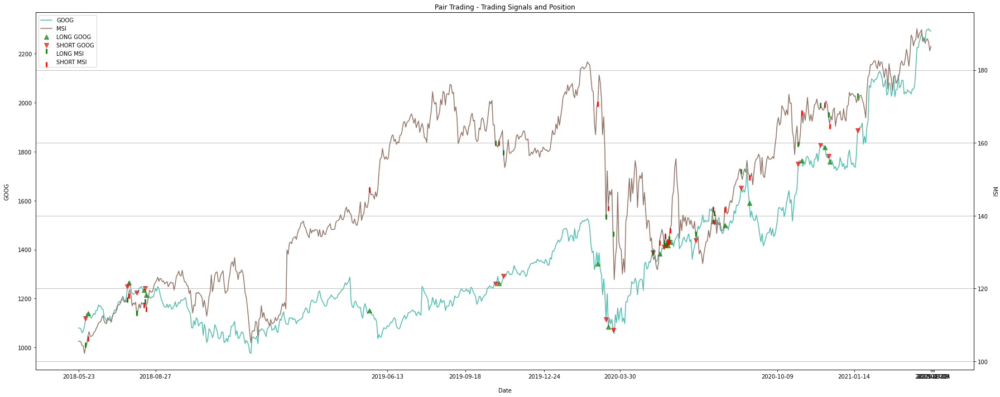

                   GOOG        VRSN         z  z upper limit  z lower limit  \
Date                                                                          
2018-05-23  1079.689941  128.210007  0.847796            1.0           -1.0   
2018-05-24  1079.239990  128.169998  0.847126            1.0           -1.0   
2018-05-25  1075.660034  128.509995  0.809041            1.0           -1.0   
2021-04-19  2302.399902  207.259995  2.889327            1.0           -1.0   
2021-04-20  2293.629883  209.500000  2.767299            1.0           -1.0   
2021-04-21  2293.290039  211.110001  2.702651            1.0           -1.0   

            signals1  positions1  signals2  positions2  
Date                                                    
2018-05-23         0         0.0         0         0.0  
2018-05-24         0         0.0         0         0.0  
2018-05-25         0         0.0         0         0.0  
2021-04-19        -1         0.0         1         0.0  
2021-04-20        -1     

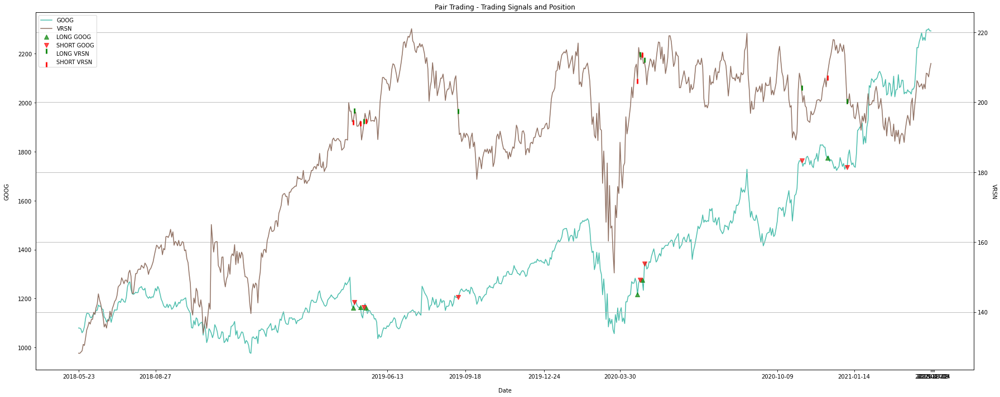

                  GOOGL        KLAC         z  z upper limit  z lower limit  \
Date                                                                          
2018-05-23  1085.959961  106.749916  0.555229            1.0           -1.0   
2018-05-24  1085.449951  106.966614  0.541793            1.0           -1.0   
2018-05-25  1084.079956  107.710930  0.497932            1.0           -1.0   
2021-04-19  2289.760010  324.390015 -1.093637            1.0           -1.0   
2021-04-20  2279.010010  318.920013 -1.047384            1.0           -1.0   
2021-04-21  2278.350098  331.790009 -1.195197            1.0           -1.0   

            signals1  positions1  signals2  positions2  
Date                                                    
2018-05-23         0         0.0         0         0.0  
2018-05-24         0         0.0         0         0.0  
2018-05-25         0         0.0         0         0.0  
2021-04-19         1         0.0        -1         0.0  
2021-04-20         1     

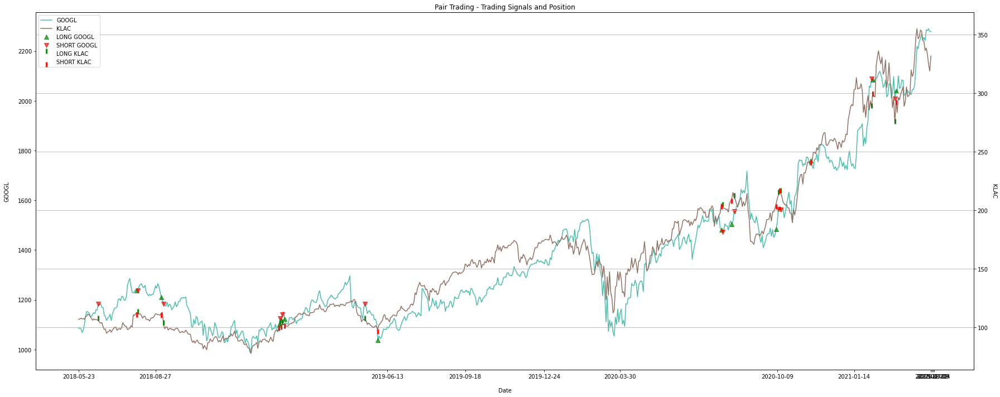

                  GOOGL         MSI         z  z upper limit  z lower limit  \
Date                                                                          
2018-05-23  1085.959961  105.520042  0.723813            1.0           -1.0   
2018-05-24  1085.449951  105.539078  0.718943            1.0           -1.0   
2018-05-25  1084.079956  105.263000  0.729105            1.0           -1.0   
2021-04-19  2289.760010  187.660004  2.114322            1.0           -1.0   
2021-04-20  2279.010010  185.270004  2.186666            1.0           -1.0   
2021-04-21  2278.350098  186.479996  2.125987            1.0           -1.0   

            signals1  positions1  signals2  positions2  
Date                                                    
2018-05-23         0         0.0         0         0.0  
2018-05-24         0         0.0         0         0.0  
2018-05-25         0         0.0         0         0.0  
2021-04-19        -1         0.0         1         0.0  
2021-04-20        -1     

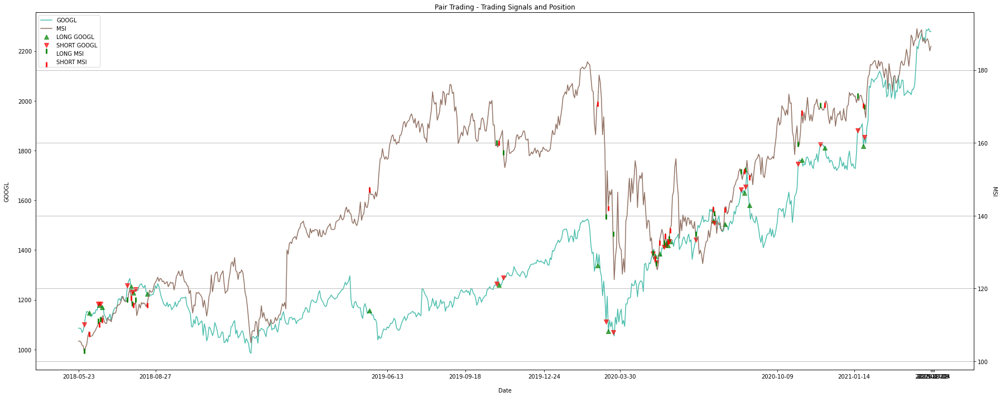

                  GOOGL        VRSN         z  z upper limit  z lower limit  \
Date                                                                          
2018-05-23  1085.959961  128.210007  0.884706            1.0           -1.0   
2018-05-24  1085.449951  128.169998  0.883681            1.0           -1.0   
2018-05-25  1084.079956  128.509995  0.858312            1.0           -1.0   
2021-04-19  2289.760010  207.259995  2.862276            1.0           -1.0   
2021-04-20  2279.010010  209.500000  2.732282            1.0           -1.0   
2021-04-21  2278.350098  211.110001  2.666234            1.0           -1.0   

            signals1  positions1  signals2  positions2  
Date                                                    
2018-05-23         0         0.0         0         0.0  
2018-05-24         0         0.0         0         0.0  
2018-05-25         0         0.0         0         0.0  
2021-04-19        -1         0.0         1         0.0  
2021-04-20        -1     

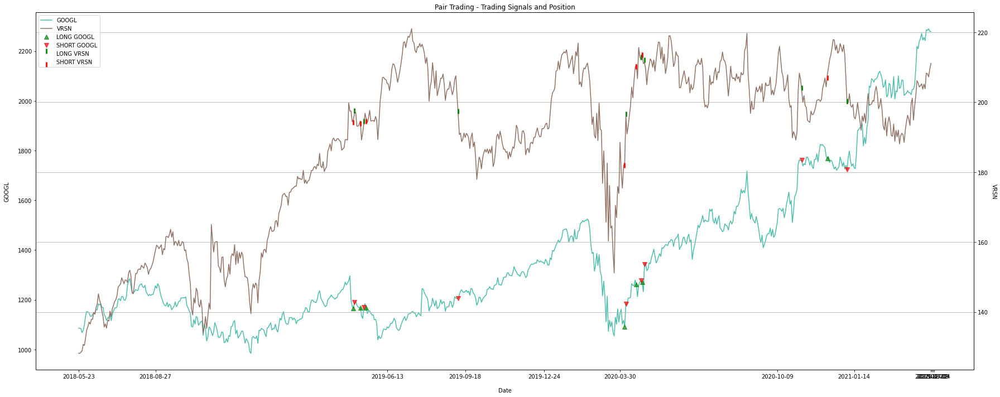

                 INTC         MSI         z  z upper limit  z lower limit  \
Date                                                                        
2018-05-23  51.601616  105.520042  2.597152            1.0           -1.0   
2018-05-24  51.171684  105.539078  2.517379            1.0           -1.0   
2018-05-25  51.816586  105.263000  2.659185            1.0           -1.0   
2021-04-19  63.630001  187.660004 -0.277048            1.0           -1.0   
2021-04-20  62.700001  185.270004 -0.289423            1.0           -1.0   
2021-04-21  63.700001  186.479996 -0.228727            1.0           -1.0   

            signals1  positions1  signals2  positions2  
Date                                                    
2018-05-23        -1        -1.0         1         1.0  
2018-05-24        -1         0.0         1         0.0  
2018-05-25        -1         0.0         1         0.0  
2021-04-19         0         0.0         0         0.0  
2021-04-20         0         0.0         

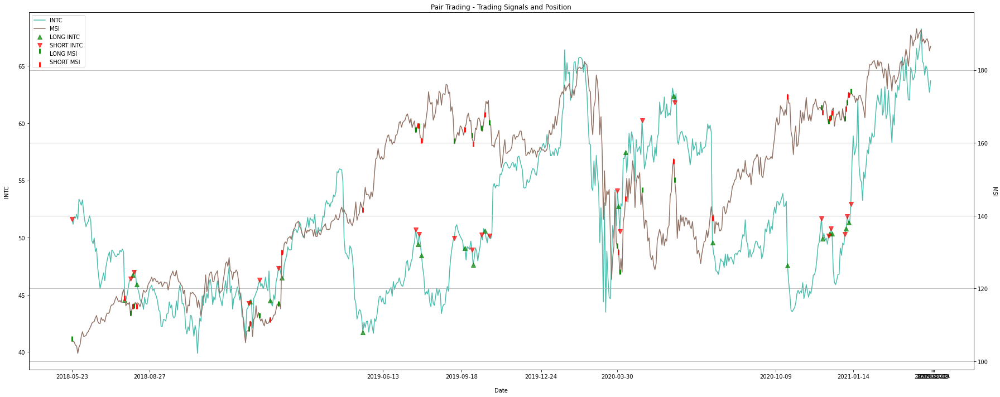

                  INTU        VRSN         z  z upper limit  z lower limit  \
Date                                                                         
2018-05-23  191.857910  128.210007  0.192565            1.0           -1.0   
2018-05-24  193.383163  128.169998  0.250281            1.0           -1.0   
2018-05-25  192.698746  128.509995  0.206797            1.0           -1.0   
2021-04-19  402.290009  207.259995  2.267227            1.0           -1.0   
2021-04-20  405.369995  209.500000  2.238985            1.0           -1.0   
2021-04-21  408.950012  211.110001  2.249259            1.0           -1.0   

            signals1  positions1  signals2  positions2  
Date                                                    
2018-05-23         0         0.0         0         0.0  
2018-05-24         0         0.0         0         0.0  
2018-05-25         0         0.0         0         0.0  
2021-04-19        -1         0.0         1         0.0  
2021-04-20        -1         0.0 

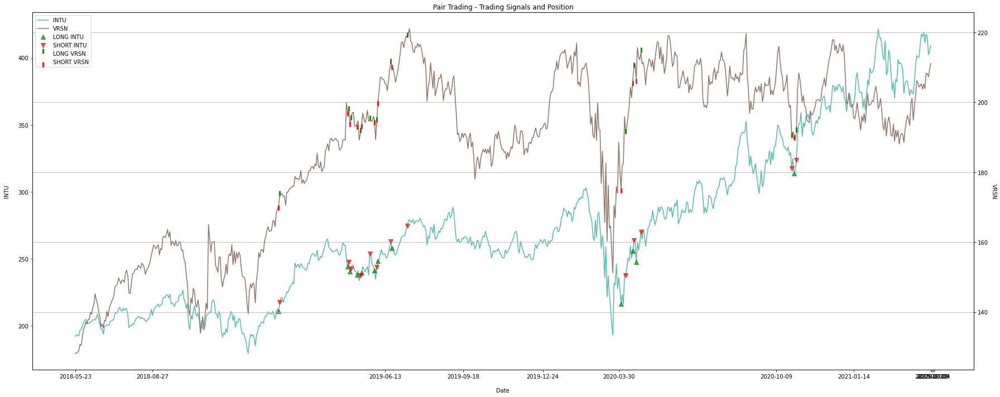

                    IT         MSI         z  z upper limit  z lower limit  \
Date                                                                         
2018-05-23  131.759995  105.520042  1.581993            1.0           -1.0   
2018-05-24  131.300003  105.539078  1.553540            1.0           -1.0   
2018-05-25  130.639999  105.263000  1.534874            1.0           -1.0   
2021-04-19  191.940002  187.660004  0.179968            1.0           -1.0   
2021-04-20  191.429993  185.270004  0.244782            1.0           -1.0   
2021-04-21  193.419998  186.479996  0.269407            1.0           -1.0   

            signals1  positions1  signals2  positions2  
Date                                                    
2018-05-23        -1        -1.0         1         1.0  
2018-05-24        -1         0.0         1         0.0  
2018-05-25        -1         0.0         1         0.0  
2021-04-19         0         0.0         0         0.0  
2021-04-20         0         0.0 

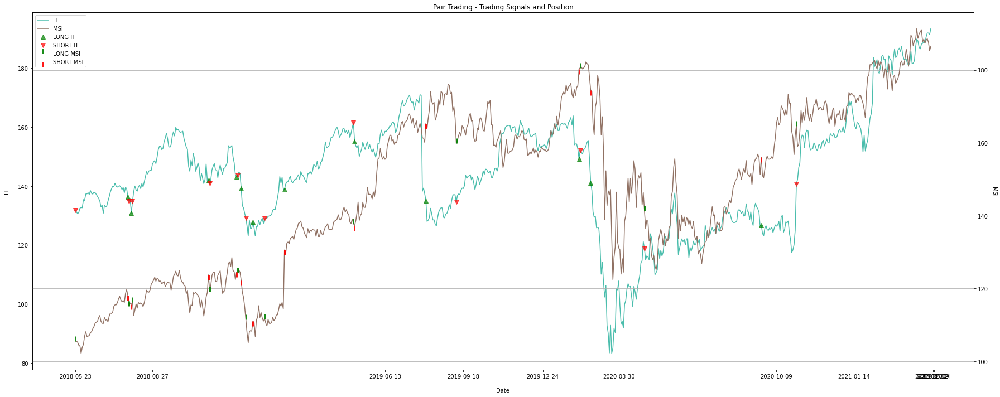

                  KLAC        MCHP         z  z upper limit  z lower limit  \
Date                                                                         
2018-05-23  106.749916   90.190361 -1.346838            1.0           -1.0   
2018-05-24  106.966614   90.928528 -1.369660            1.0           -1.0   
2018-05-25  107.710930   91.848831 -1.381294            1.0           -1.0   
2021-04-19  324.390015  154.029999  1.566653            1.0           -1.0   
2021-04-20  318.920013  149.729996  1.642297            1.0           -1.0   
2021-04-21  331.790009  154.649994  1.691122            1.0           -1.0   

            signals1  positions1  signals2  positions2  
Date                                                    
2018-05-23         1         1.0        -1        -1.0  
2018-05-24         1         0.0        -1         0.0  
2018-05-25         1         0.0        -1         0.0  
2021-04-19        -1         0.0         1         0.0  
2021-04-20        -1         0.0 

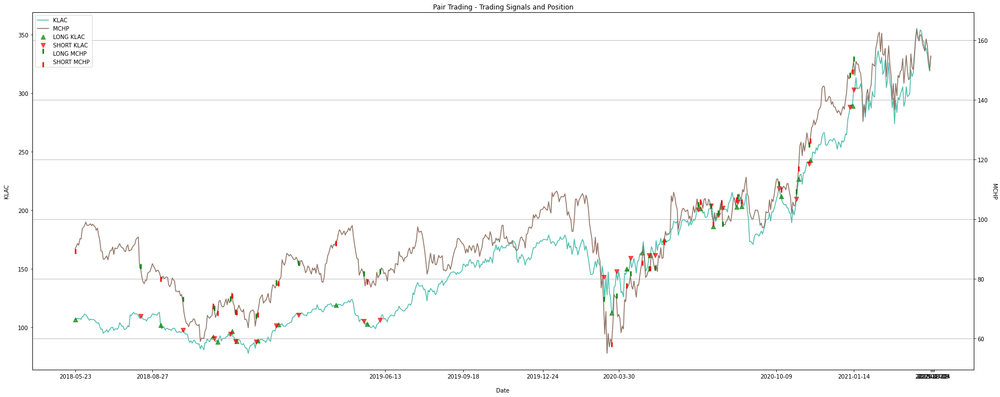

                  KLAC         MSI         z  z upper limit  z lower limit  \
Date                                                                         
2018-05-23  106.749916  105.520042 -0.188538            1.0           -1.0   
2018-05-24  106.966614  105.539078 -0.182651            1.0           -1.0   
2018-05-25  107.710930  105.263000 -0.152036            1.0           -1.0   
2021-04-19  324.390015  187.660004  2.067461            1.0           -1.0   
2021-04-20  318.920013  185.270004  2.044725            1.0           -1.0   
2021-04-21  331.790009  186.479996  2.226747            1.0           -1.0   

            signals1  positions1  signals2  positions2  
Date                                                    
2018-05-23         0         0.0         0         0.0  
2018-05-24         0         0.0         0         0.0  
2018-05-25         0         0.0         0         0.0  
2021-04-19        -1         0.0         1         0.0  
2021-04-20        -1         0.0 

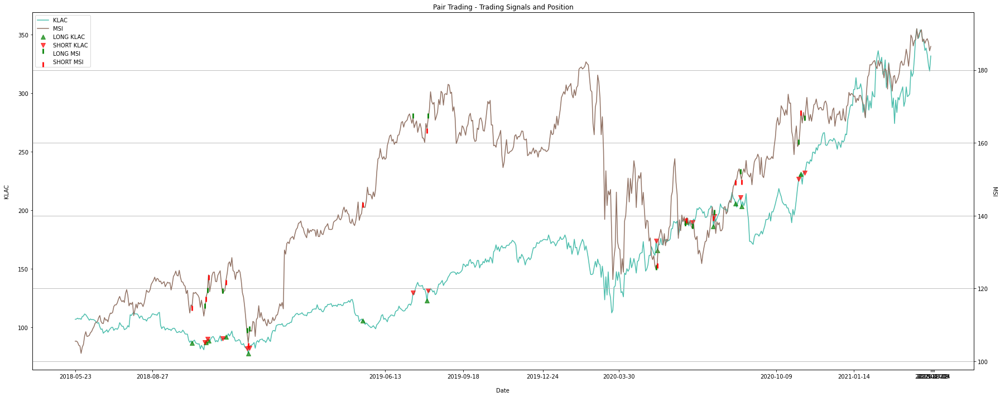

                  KLAC        SNPS         z  z upper limit  z lower limit  \
Date                                                                         
2018-05-23  106.749916   90.330002  1.099995            1.0           -1.0   
2018-05-24  106.966614   88.559998  1.334546            1.0           -1.0   
2018-05-25  107.710930   88.320000  1.439911            1.0           -1.0   
2021-04-19  324.390015  250.639999  2.112017            1.0           -1.0   
2021-04-20  318.920013  250.169998  1.937150            1.0           -1.0   
2021-04-21  331.790009  252.559998  2.287129            1.0           -1.0   

            signals1  positions1  signals2  positions2  
Date                                                    
2018-05-23        -1        -1.0         1         1.0  
2018-05-24        -1         0.0         1         0.0  
2018-05-25        -1         0.0         1         0.0  
2021-04-19        -1         0.0         1         0.0  
2021-04-20        -1         0.0 

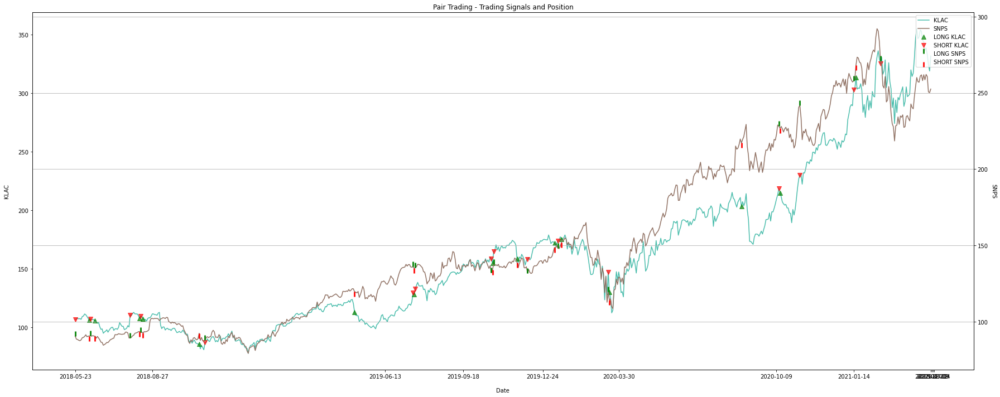

                  KLAC         TXN         z  z upper limit  z lower limit  \
Date                                                                         
2018-05-23  106.749916  102.859314 -0.961265            1.0           -1.0   
2018-05-24  106.966614  102.562965 -0.941378            1.0           -1.0   
2018-05-25  107.710930  103.313095 -0.942810            1.0           -1.0   
2021-04-19  324.390015  187.059998  1.747771            1.0           -1.0   
2021-04-20  318.920013  185.270004  1.698090            1.0           -1.0   
2021-04-21  331.790009  188.899994  1.834461            1.0           -1.0   

            signals1  positions1  signals2  positions2  
Date                                                    
2018-05-23         0         0.0         0         0.0  
2018-05-24         0         0.0         0         0.0  
2018-05-25         0         0.0         0         0.0  
2021-04-19        -1         0.0         1         0.0  
2021-04-20        -1         0.0 

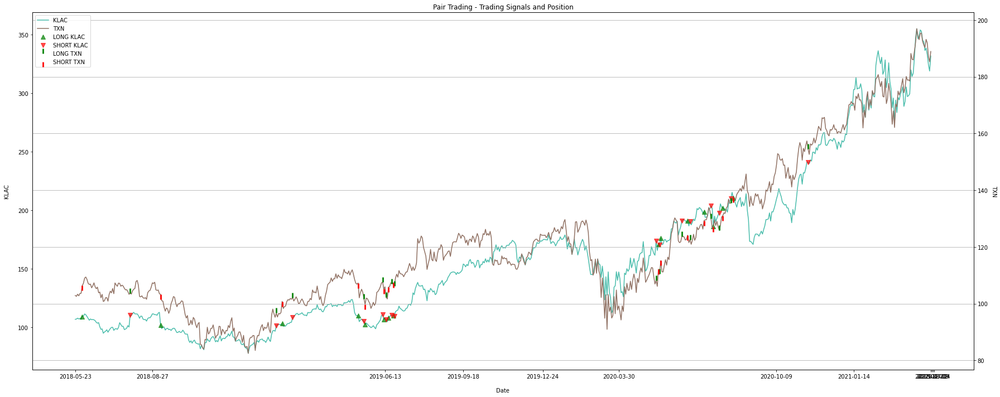

                  MCHP        SNPS         z  z upper limit  z lower limit  \
Date                                                                         
2018-05-23   90.190361   90.330002  2.183980            1.0           -1.0   
2018-05-24   90.928528   88.559998  2.379297            1.0           -1.0   
2018-05-25   91.848831   88.320000  2.470498            1.0           -1.0   
2021-04-19  154.029999  250.639999 -0.466478            1.0           -1.0   
2021-04-20  149.729996  250.169998 -0.577173            1.0           -1.0   
2021-04-21  154.649994  252.559998 -0.481784            1.0           -1.0   

            signals1  positions1  signals2  positions2  
Date                                                    
2018-05-23        -1        -1.0         1         1.0  
2018-05-24        -1         0.0         1         0.0  
2018-05-25        -1         0.0         1         0.0  
2021-04-19         0         0.0         0         0.0  
2021-04-20         0         0.0 

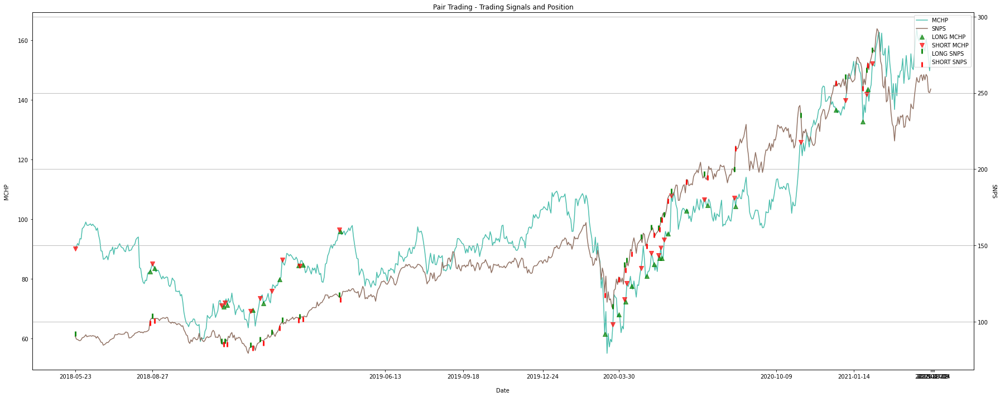

                  MSFT         TXN         z  z upper limit  z lower limit  \
Date                                                                         
2018-05-23   95.203033  102.859314 -1.739579            1.0           -1.0   
2018-05-24   94.865280  102.562965 -1.742737            1.0           -1.0   
2018-05-25   94.913544  103.313095 -1.774630            1.0           -1.0   
2021-04-19  258.739990  187.059998  0.596171            1.0           -1.0   
2021-04-20  258.260010  185.270004  0.651157            1.0           -1.0   
2021-04-21  260.579987  188.899994  0.577120            1.0           -1.0   

            signals1  positions1  signals2  positions2  
Date                                                    
2018-05-23         1         1.0        -1        -1.0  
2018-05-24         1         0.0        -1         0.0  
2018-05-25         1         0.0        -1         0.0  
2021-04-19         0         0.0         0         0.0  
2021-04-20         0         0.0 

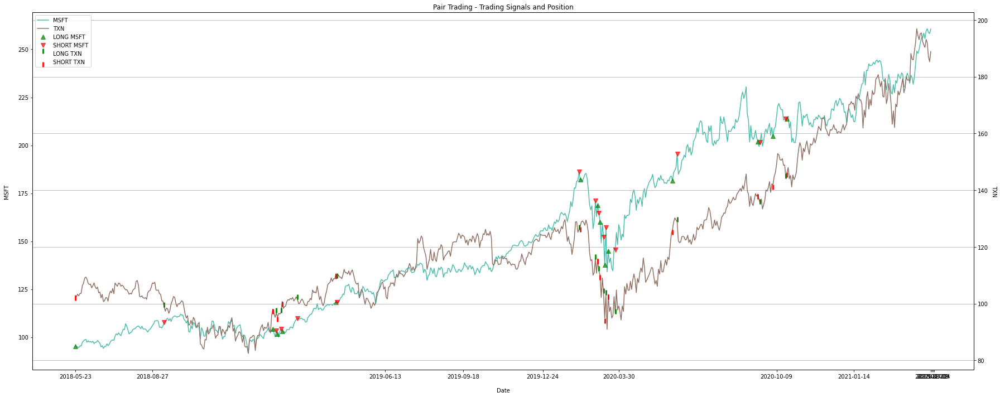

                   MSI       PAYX         z  z upper limit  z lower limit  \
Date                                                                        
2018-05-23  105.520042  60.104580 -1.233768            1.0           -1.0   
2018-05-24  105.539078  60.379578 -1.284626            1.0           -1.0   
2018-05-25  105.263000  60.407066 -1.320155            1.0           -1.0   
2021-04-19  187.660004  96.430000  0.027438            1.0           -1.0   
2021-04-20  185.270004  97.510002 -0.277585            1.0           -1.0   
2021-04-21  186.479996  98.220001 -0.286956            1.0           -1.0   

            signals1  positions1  signals2  positions2  
Date                                                    
2018-05-23         1         1.0        -1        -1.0  
2018-05-24         1         0.0        -1         0.0  
2018-05-25         1         0.0        -1         0.0  
2021-04-19         0         0.0         0         0.0  
2021-04-20         0         0.0         

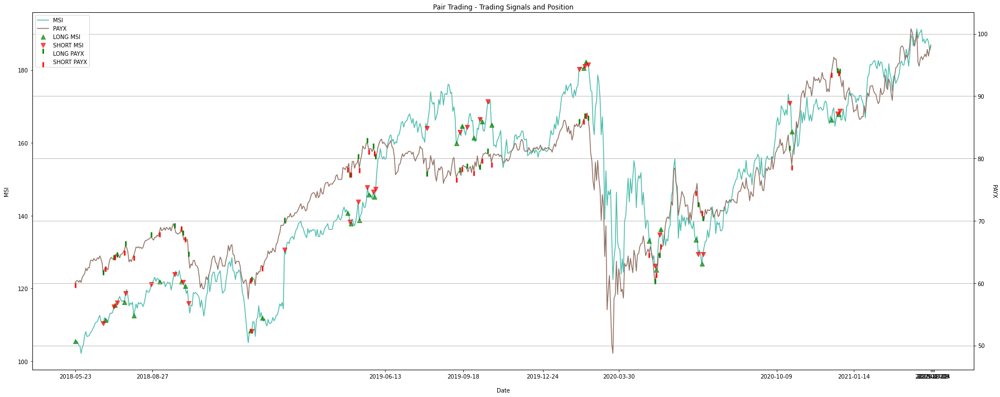

                   MSI        SNPS         z  z upper limit  z lower limit  \
Date                                                                         
2018-05-23  105.520042   90.330002  0.455495            1.0           -1.0   
2018-05-24  105.539078   88.559998  0.551259            1.0           -1.0   
2018-05-25  105.263000   88.320000  0.551716            1.0           -1.0   
2021-04-19  187.660004  250.639999 -1.249211            1.0           -1.0   
2021-04-20  185.270004  250.169998 -1.282322            1.0           -1.0   
2021-04-21  186.479996  252.559998 -1.291334            1.0           -1.0   

            signals1  positions1  signals2  positions2  
Date                                                    
2018-05-23         0         0.0         0         0.0  
2018-05-24         0         0.0         0         0.0  
2018-05-25         0         0.0         0         0.0  
2021-04-19         1         0.0        -1         0.0  
2021-04-20         1         0.0 

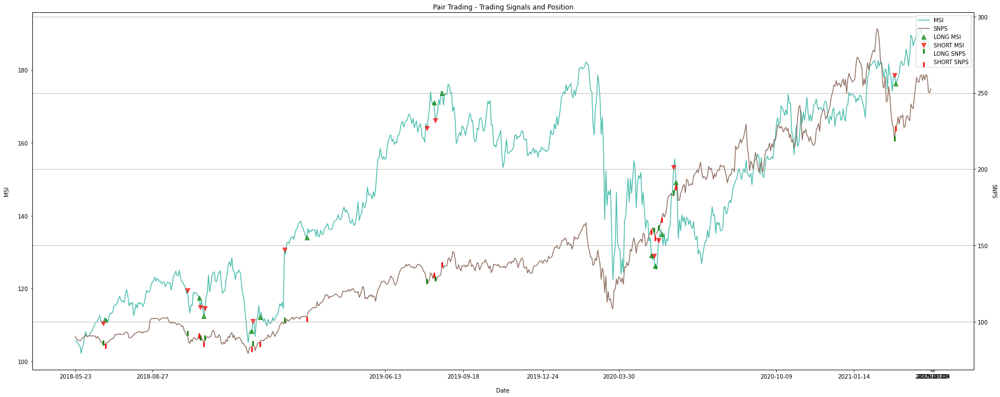

                   MSI        VRSN         z  z upper limit  z lower limit  \
Date                                                                         
2018-05-23  105.520042  128.210007  0.458975            1.0           -1.0   
2018-05-24  105.539078  128.169998  0.464296            1.0           -1.0   
2018-05-25  105.263000  128.509995  0.407505            1.0           -1.0   
2021-04-19  187.660004  207.259995  1.540611            1.0           -1.0   
2021-04-20  185.270004  209.500000  1.263807            1.0           -1.0   
2021-04-21  186.479996  211.110001  1.250514            1.0           -1.0   

            signals1  positions1  signals2  positions2  
Date                                                    
2018-05-23         0         0.0         0         0.0  
2018-05-24         0         0.0         0         0.0  
2018-05-25         0         0.0         0         0.0  
2021-04-19        -1         0.0         1         0.0  
2021-04-20        -1         0.0 

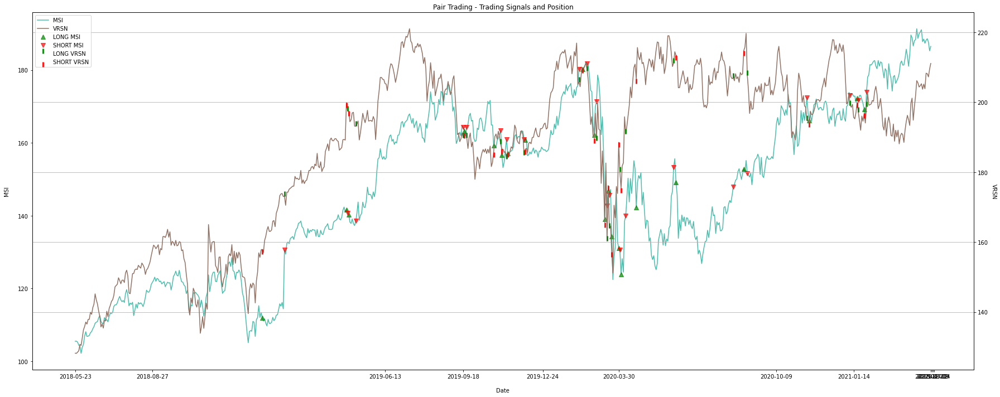

                   MSI        XLNX         z  z upper limit  z lower limit  \
Date                                                                         
2018-05-23  105.520042   66.184227  0.376468            1.0           -1.0   
2018-05-24  105.539078   66.164978  0.379583            1.0           -1.0   
2018-05-25  105.263000   66.992775  0.280812            1.0           -1.0   
2021-04-19  187.660004  126.900002 -0.102395            1.0           -1.0   
2021-04-20  185.270004  123.620003 -0.019900            1.0           -1.0   
2021-04-21  186.479996  126.949997 -0.143334            1.0           -1.0   

            signals1  positions1  signals2  positions2  
Date                                                    
2018-05-23         0         0.0         0         0.0  
2018-05-24         0         0.0         0         0.0  
2018-05-25         0         0.0         0         0.0  
2021-04-19         0         0.0         0         0.0  
2021-04-20         0         0.0 

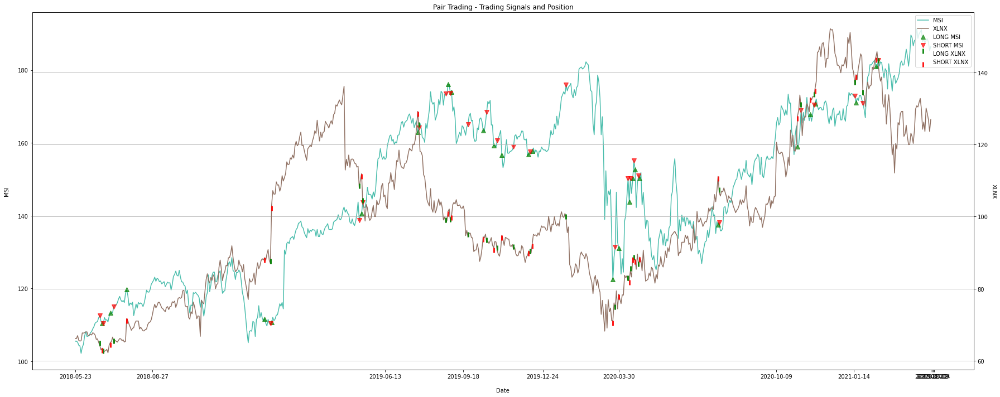

In [704]:
signals = []
for pair in watched:
    s = set_signals(pair, threshold=1)
    signals.append(s)

# Profit calculations

In [705]:
signals[0]

,AAPL,INTU,z,z upper limit,z lower limit,signals1,positions1,signals2,positions2
Date,,,,,,,,,
2018-05-23,45.607460,191.857910,-0.372601,1.0,-1.0,0,0.0,0,0.0
2018-05-24,45.556606,193.383163,-0.408232,1.0,-1.0,0,0.0,0,0.0
2018-05-25,45.660728,192.698746,-0.385282,1.0,-1.0,0,0.0,0,0.0
2018-05-29,45.496067,192.317413,-0.391721,1.0,-1.0,0,0.0,0,0.0
2018-05-30,45.399216,196.619415,-0.486197,1.0,-1.0,0,0.0,0,0.0
...,...,...,...,...,...,...,...,...,...
2021-04-15,134.500000,417.559998,1.033959,1.0,-1.0,-1,0.0,1,0.0
2021-04-16,134.160004,415.820007,1.042796,1.0,-1.0,-1,0.0,1,0.0
2021-04-19,134.839996,402.290009,1.251818,1.0,-1.0,-1,0.0,1,0.0


In [138]:
def portfolio_calc(pair, signals, positions, start_capital, show=False):    
    portfolio = pd.DataFrame()
    portfolio[pair[0]] = signals[pair[0]]
    portfolio['holdings1'] = signals['positions1'].cumsum() * signals[pair[0]] * positions[0]
    portfolio['cash1'] = start_capital - (signals['positions1'] * signals[pair[0]] * positions[0]).cumsum()
    portfolio['total asset1'] = portfolio['holdings1'] + portfolio['cash1']
    portfolio['return1'] = portfolio['total asset1'].pct_change()
    portfolio['positions1'] = signals['positions1']
    
    portfolio[pair[1]] = signals[pair[1]]
    portfolio['holdings2'] = signals['positions2'].cumsum() * signals[pair[1]] * positions[1]
    portfolio['cash2'] = start_capital - (signals['positions2'] * signals[pair[1]] * positions[1]).cumsum()
    portfolio['total asset2'] = portfolio['holdings2'] + portfolio['cash2']
    portfolio['return2'] = portfolio['total asset2'].pct_change()
    portfolio['positions2'] = signals['positions2']
    
    portfolio['plain'] = positions[0] * signals[pair[0]] + positions[1] * signals[pair[1]]
    start = 2 * start_capital - portfolio['plain'][0]
    portfolio['plain'] = portfolio['plain'] + start
    
    portfolio['s'] = signals['s']
    portfolio['z'] = signals['z']
    portfolio['total asset'] = portfolio['total asset1'] + portfolio['total asset2']
    portfolio['z upper limit'] = signals['z upper limit']
    portfolio['z lower limit'] = signals['z lower limit']
    portfolio = portfolio.dropna()
    
    if show:
        print_portfolio(portfolio)
    
    return portfolio

In [707]:
max_capital_per_pair = 1000
pairs_start_capital = []

In [708]:
portfolio = []

In [709]:
for i in range(len(watched)):
    remains1 = max_capital_per_pair % max(signals[i][watched[i][0]])
    remains2 = max_capital_per_pair % max(signals[i][watched[i][1]])
    pairs_capital = max_capital_per_pair - min(remains1, remains2)
    
    positions = []
    positions.append(pairs_capital // max(signals[i][watched[i][0]]))
    positions.append(pairs_capital // max(signals[i][watched[i][1]]))
    
    pairs_start_capital.append(pairs_capital)
    
    pair_portfolio = portfolio_calc(watched[i], signals[i], positions, pairs_capital)
    portfolio.append(pair_portfolio)

In [107]:
def print_portfolio(portfolio):
    fig = plt.figure(figsize=(14,6),)
    ax = fig.add_subplot(111)
    ax2 = ax.twinx()

    l1, = ax.plot(portfolio['total asset'], c='g')
    l2, = ax2.plot(portfolio['z'], c='black', alpha=0.3)
    #l3, = ax2.plot(portfolio['s'], c='r', alpha=0.3)

    b = ax2.fill_between(portfolio.index,portfolio['z upper limit'],\
                    portfolio['z lower limit'], \
                    alpha=0.2,color='#ffb48f')

    ax.set_ylabel('Portfolio Value')
    ax2.set_ylabel('Z Statistics',rotation=270)
    ax.yaxis.labelpad=15
    ax2.yaxis.labelpad=15
    ax.set_xlabel('Date')
    ax.xaxis.labelpad=15
    plt.title('Portfolio Performance with Profit and Loss')
    plt.legend([l2,b,l1],['Z Statistics',
                          'Z Statistics +-{:.2f} Sigma'.format(portfolio['z upper limit'][0]),
                          'Total Portfolio Value'],loc='upper left');
    plt.show()

---------------------- AAPL & INTU -----------------------


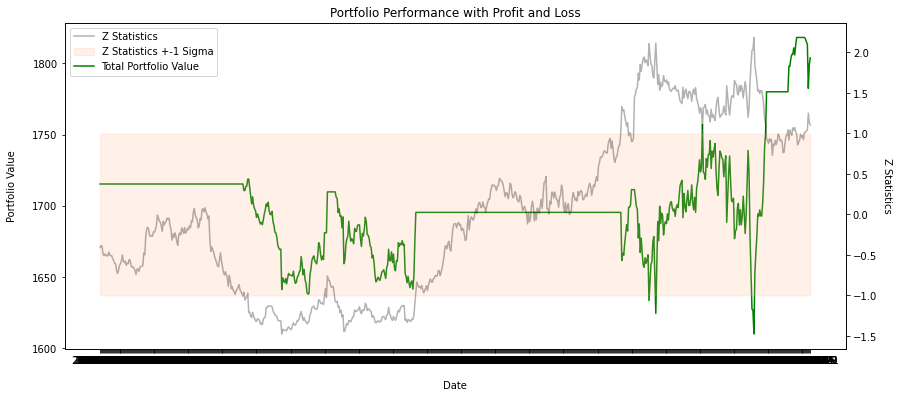

---------------------- ACN & ADI -----------------------


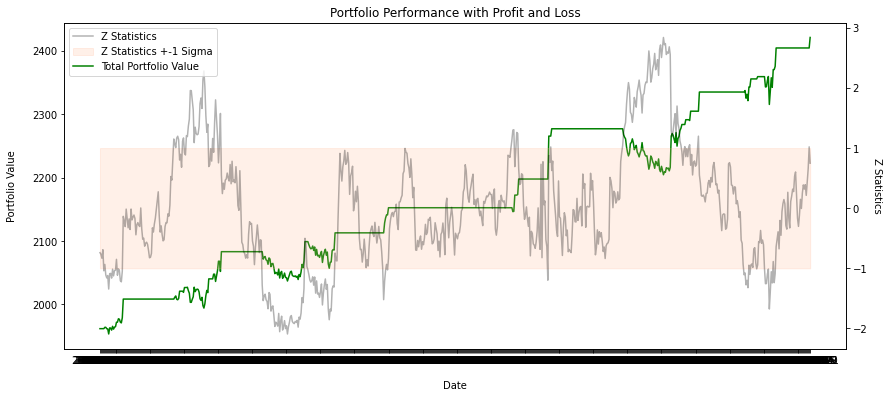

---------------------- ACN & ADP -----------------------


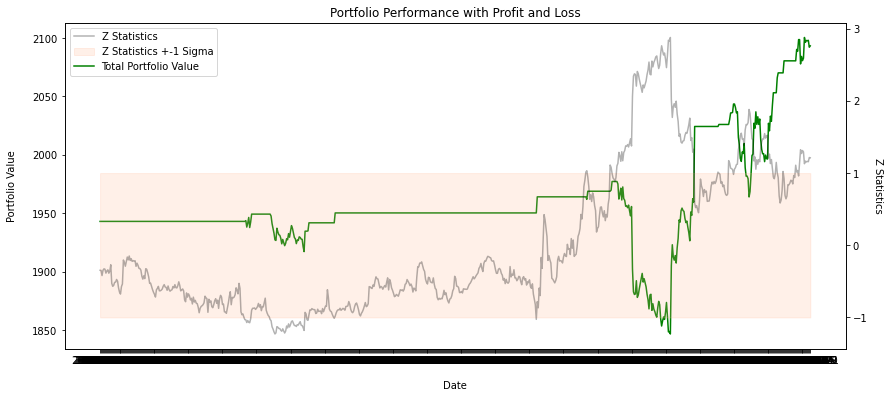

---------------------- ACN & APH -----------------------


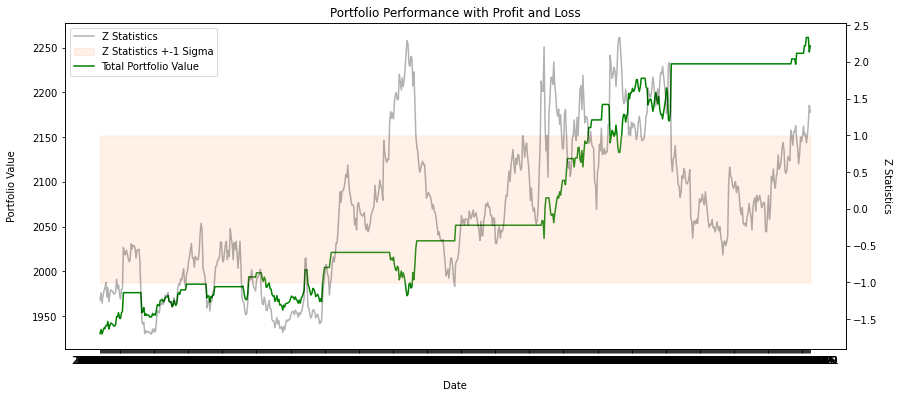

---------------------- ACN & FIS -----------------------


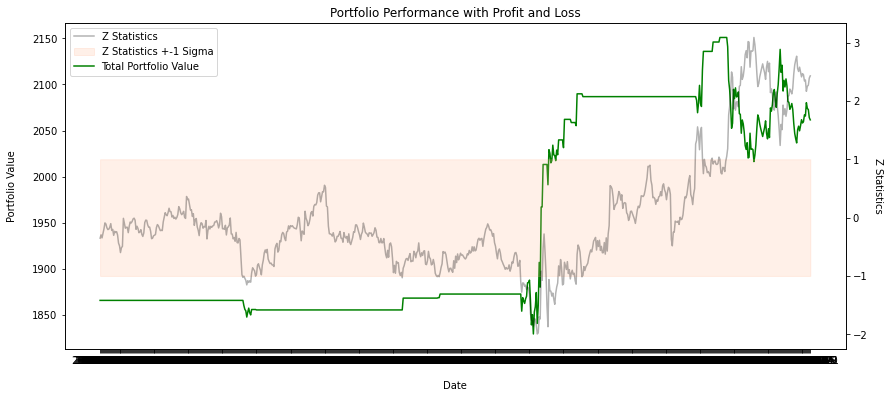

---------------------- ACN & GOOG -----------------------


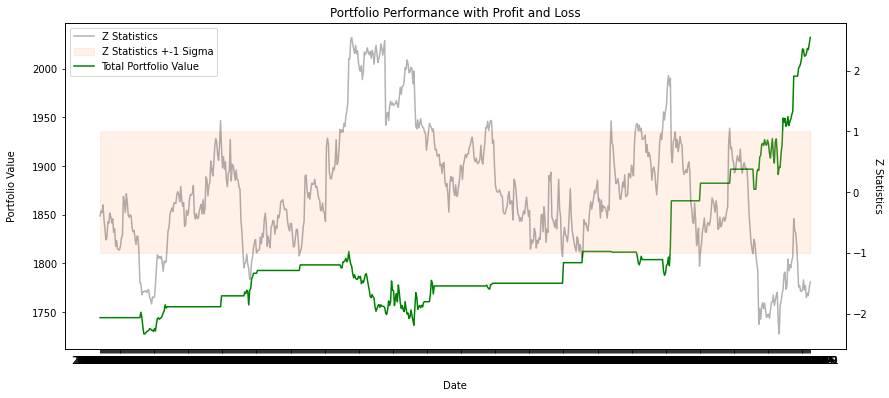

---------------------- ACN & GOOGL -----------------------


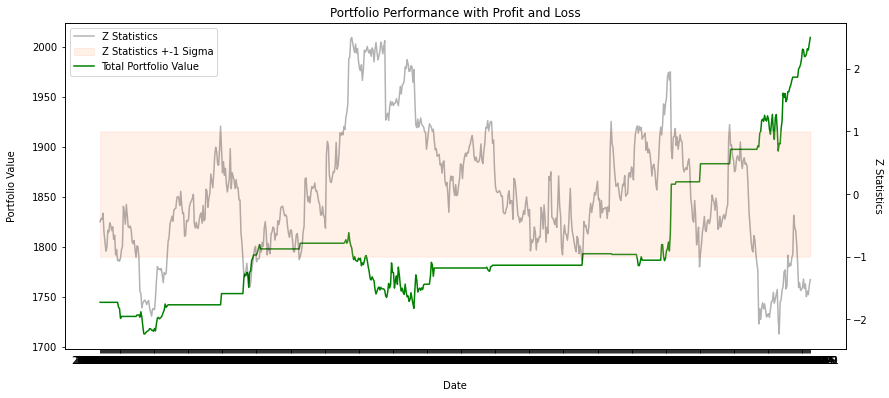

---------------------- ACN & IT -----------------------


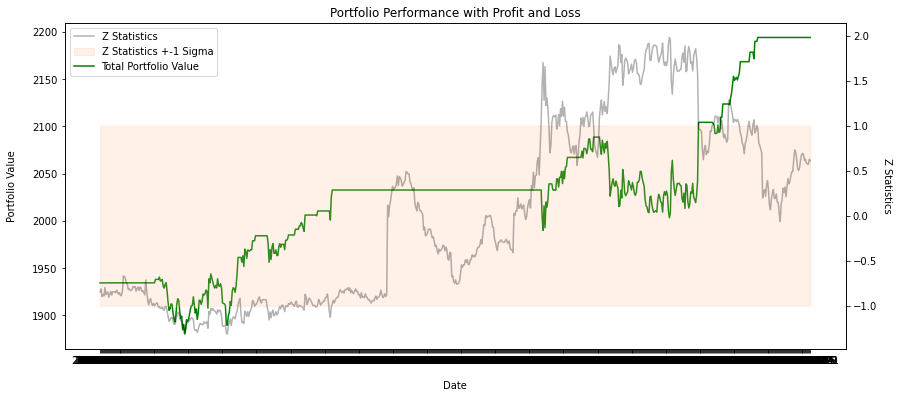

---------------------- ACN & MSI -----------------------


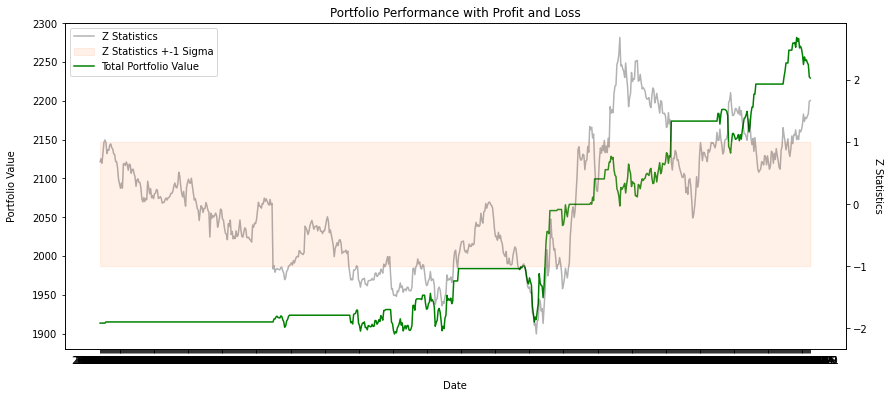

---------------------- ACN & VRSN -----------------------


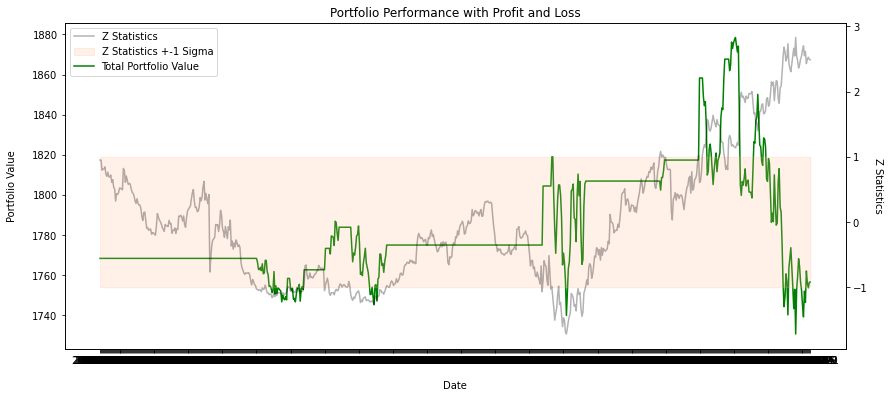

---------------------- ADI & ADP -----------------------


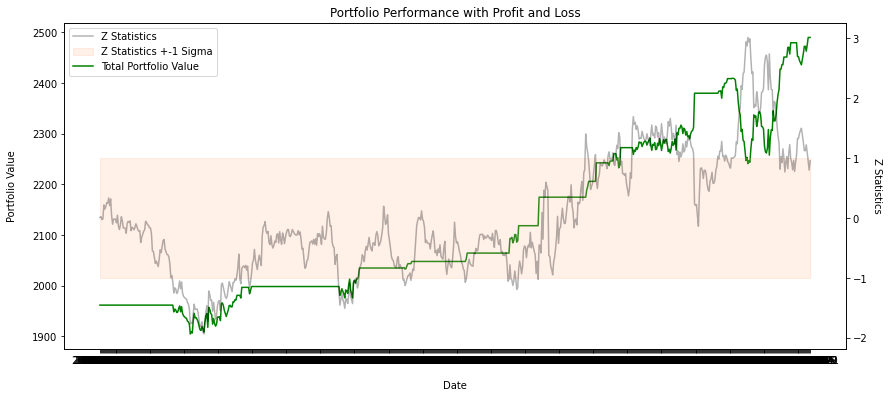

---------------------- ADI & APH -----------------------


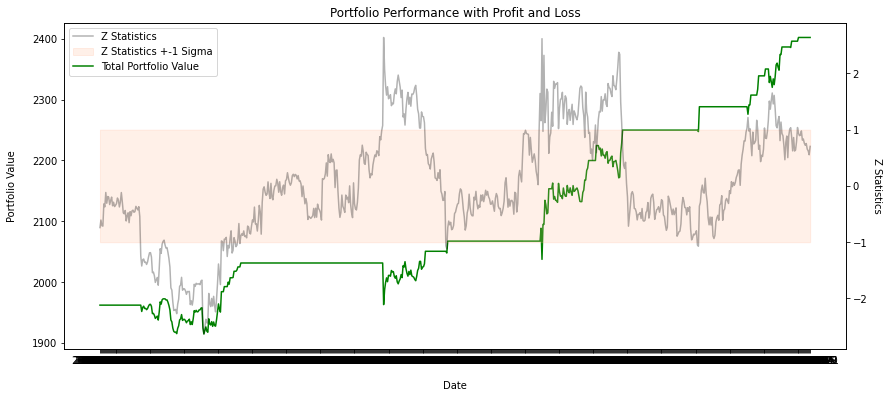

---------------------- ADI & EBAY -----------------------


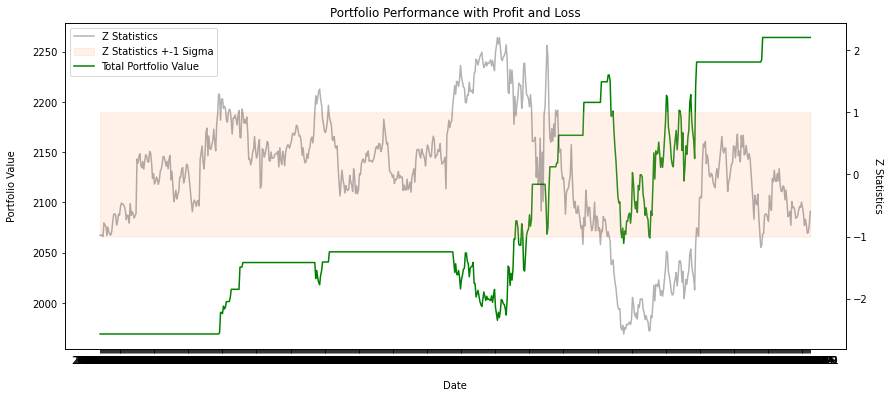

---------------------- ADI & FIS -----------------------


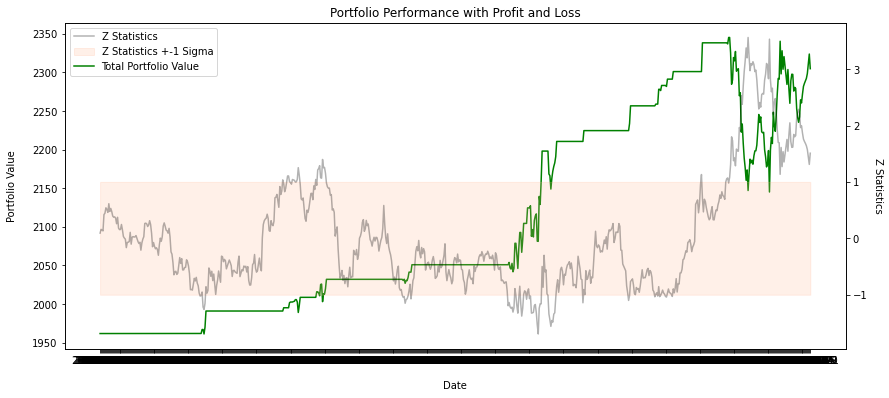

---------------------- ADI & GOOG -----------------------


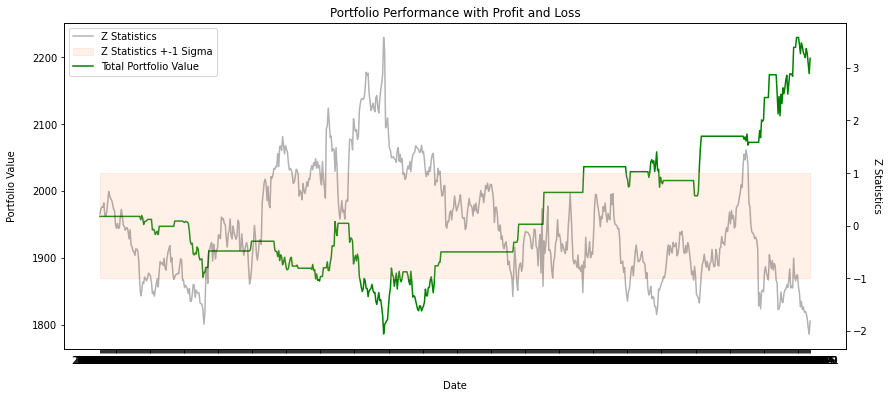

---------------------- ADI & GOOGL -----------------------


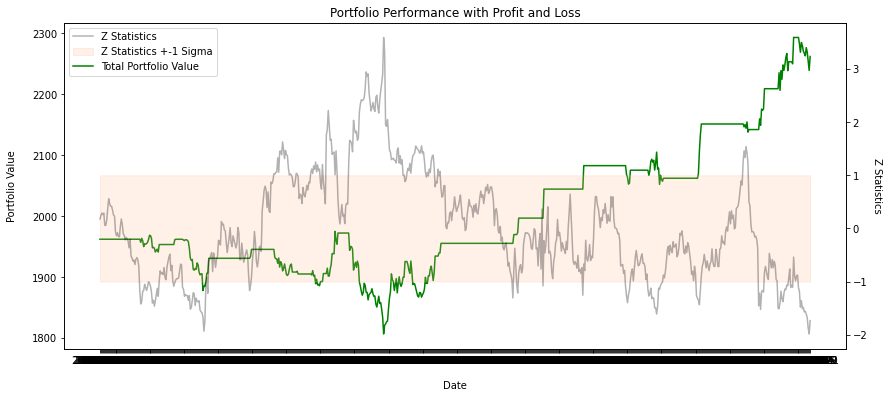

---------------------- ADI & MSI -----------------------


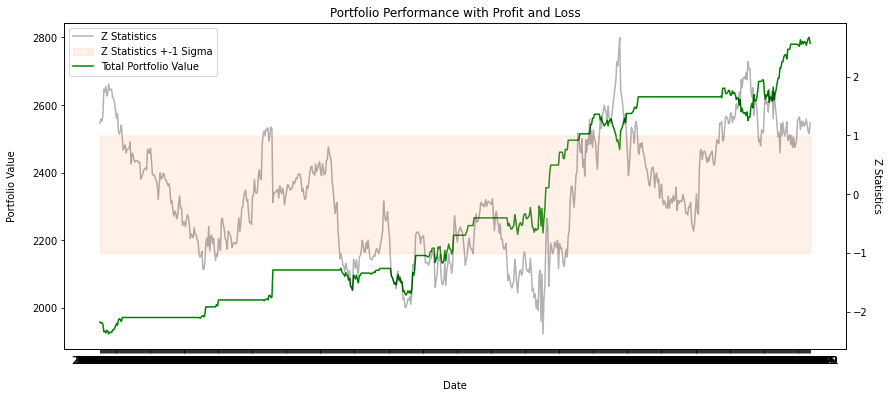

---------------------- ADI & SNPS -----------------------


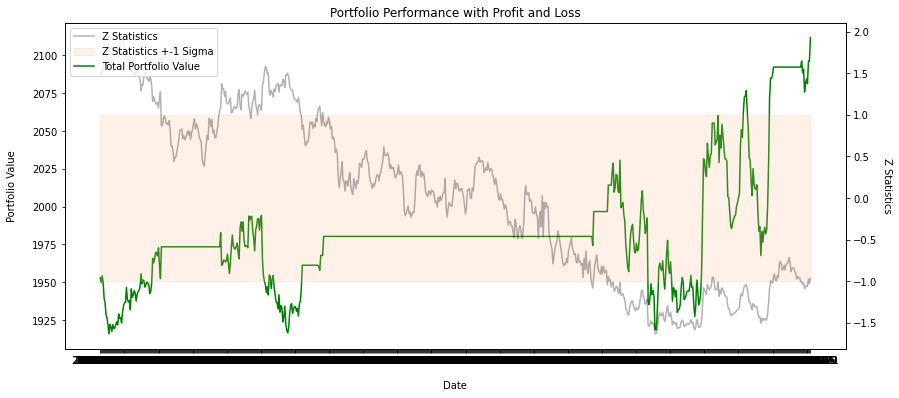

---------------------- ADI & XLNX -----------------------


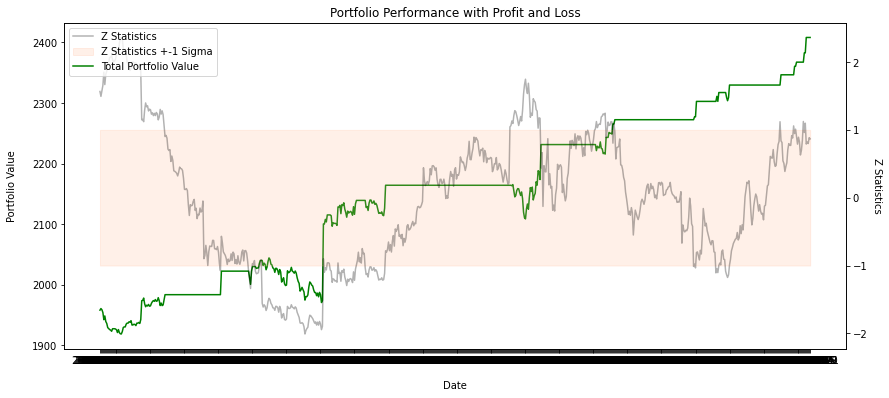

---------------------- ADP & APH -----------------------


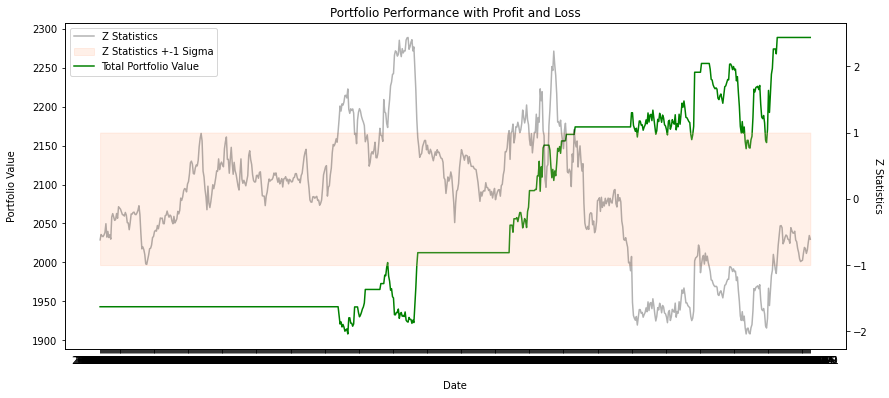

---------------------- ADP & FIS -----------------------


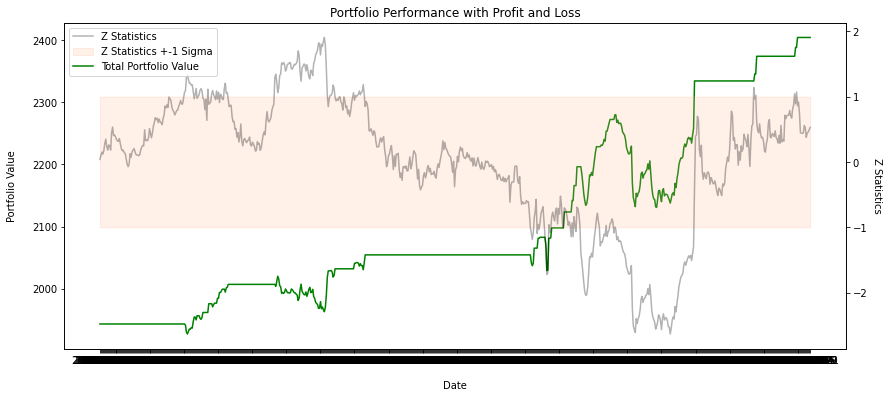

---------------------- ADP & GOOG -----------------------


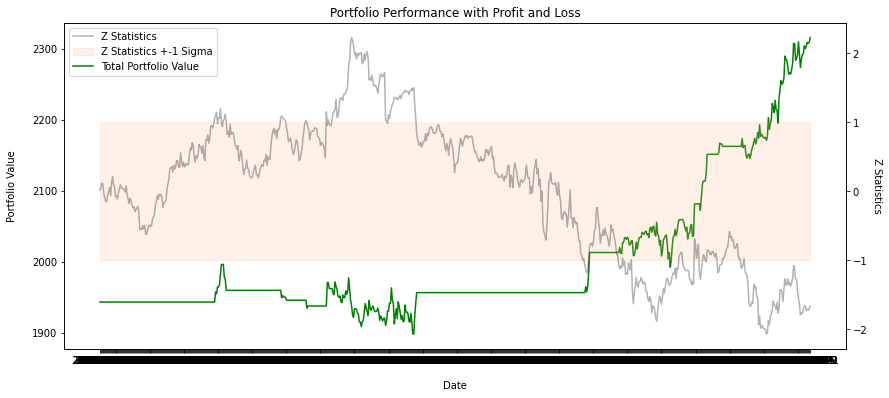

---------------------- ADP & GOOGL -----------------------


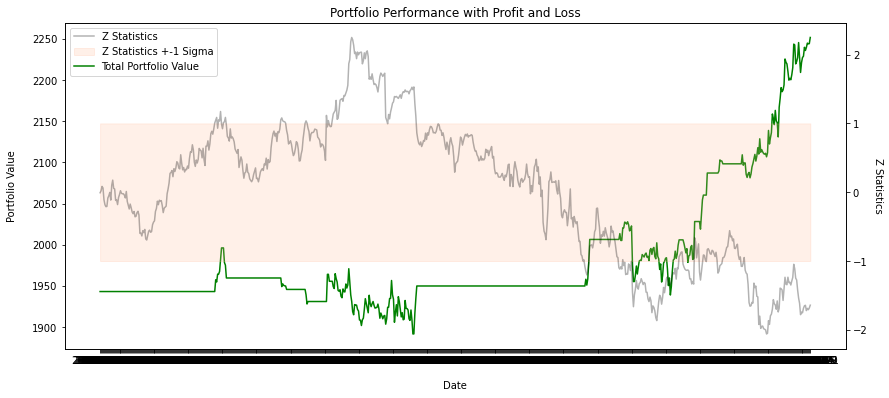

---------------------- ADP & IT -----------------------


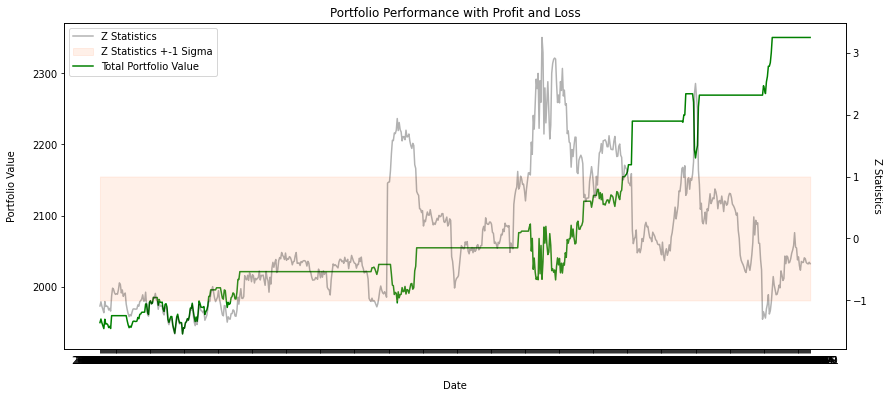

---------------------- ADP & MSI -----------------------


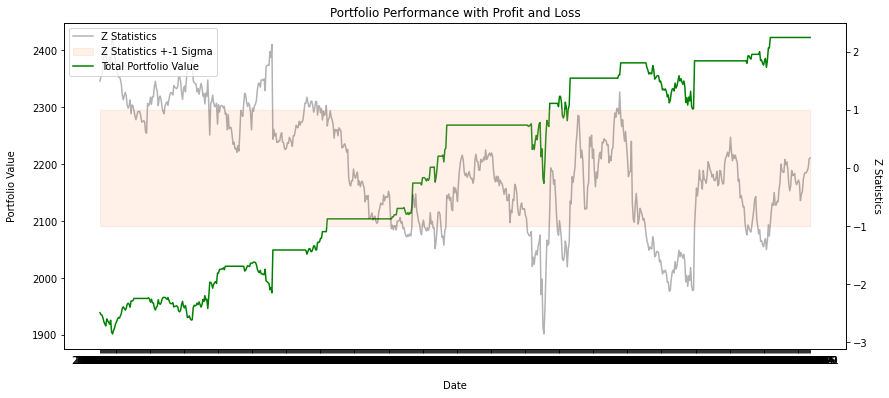

---------------------- ADP & VRSN -----------------------


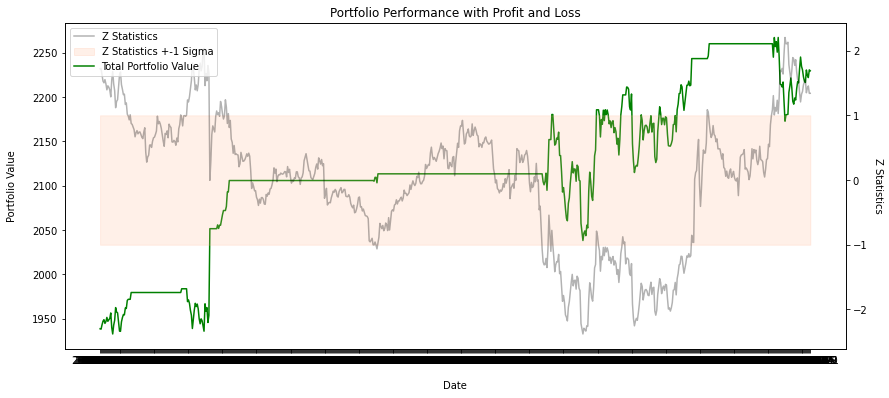

---------------------- ADP & XLNX -----------------------


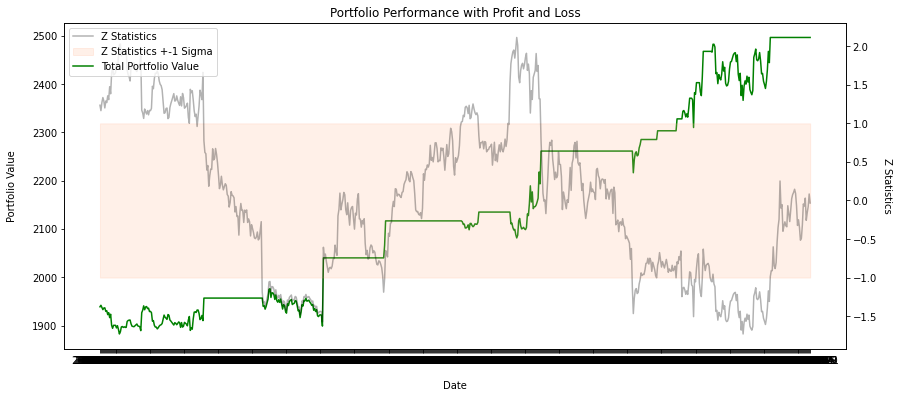

---------------------- ADSK & AMAT -----------------------


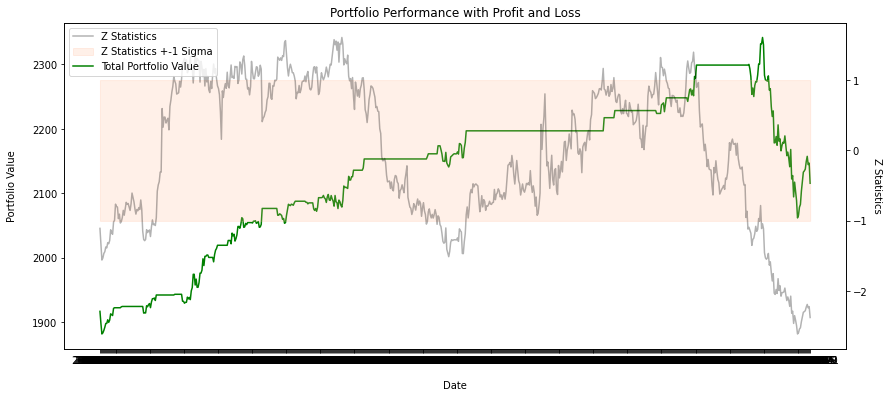

---------------------- ADSK & LRCX -----------------------


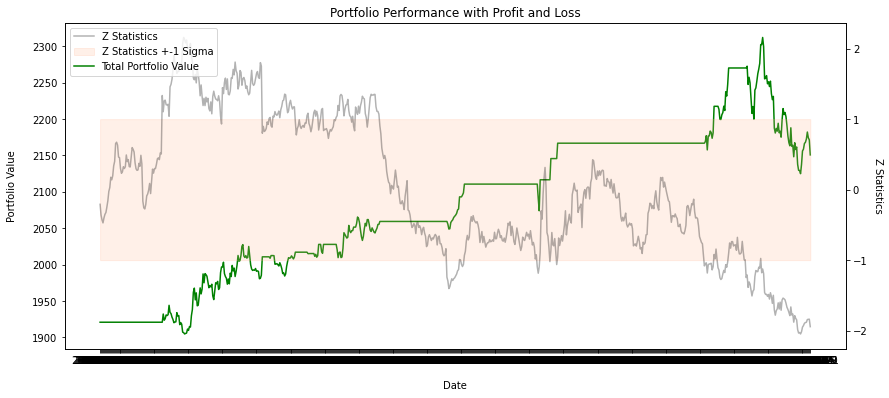

---------------------- ADSK & MCHP -----------------------


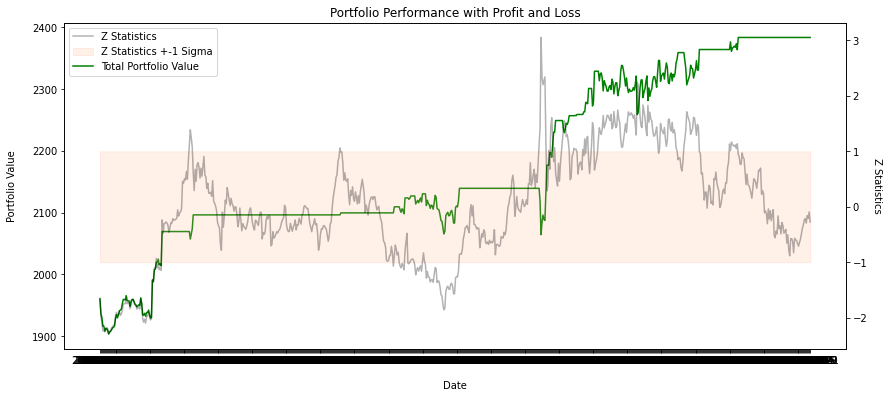

---------------------- ADSK & MSFT -----------------------


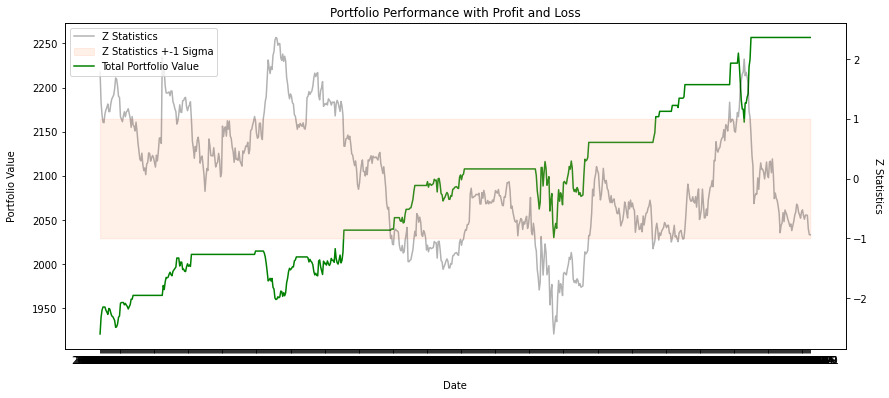

---------------------- ADSK & TXN -----------------------


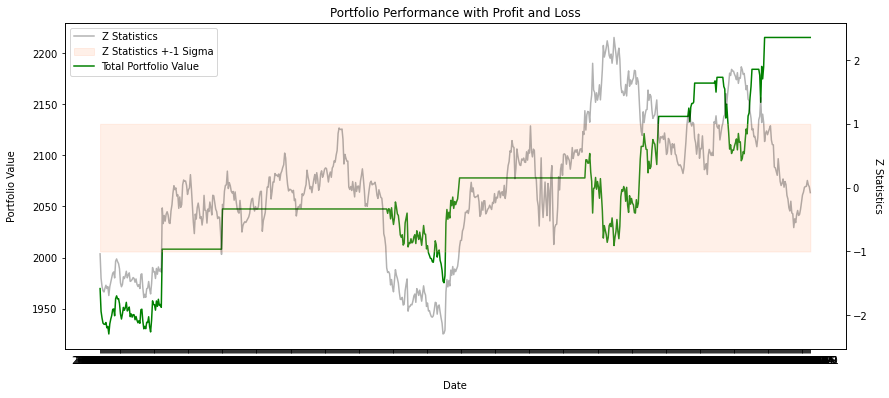

---------------------- AMD & ATVI -----------------------


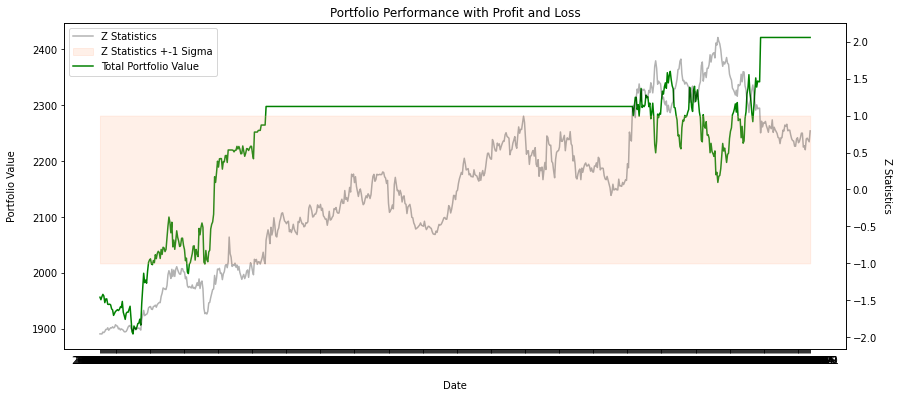

---------------------- AMD & CDNS -----------------------


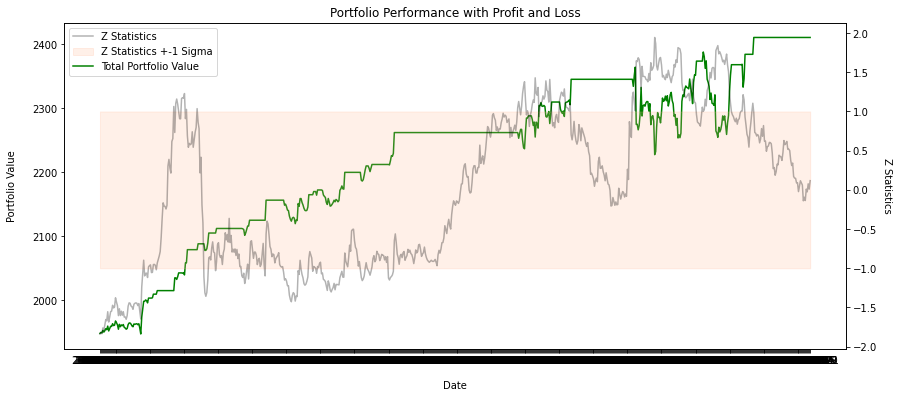

---------------------- AMD & CSCO -----------------------


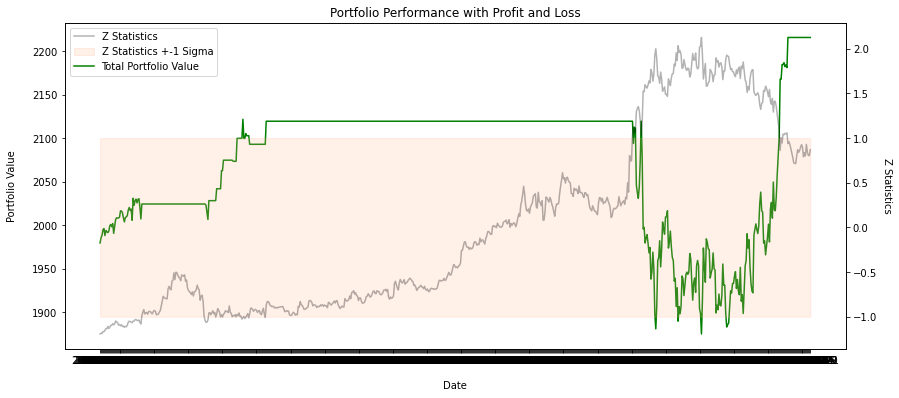

---------------------- AMD & DXC -----------------------


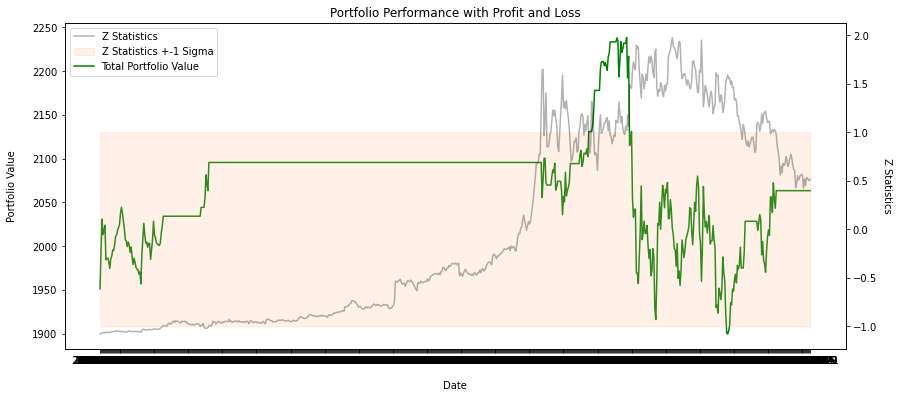

---------------------- AMD & EA -----------------------


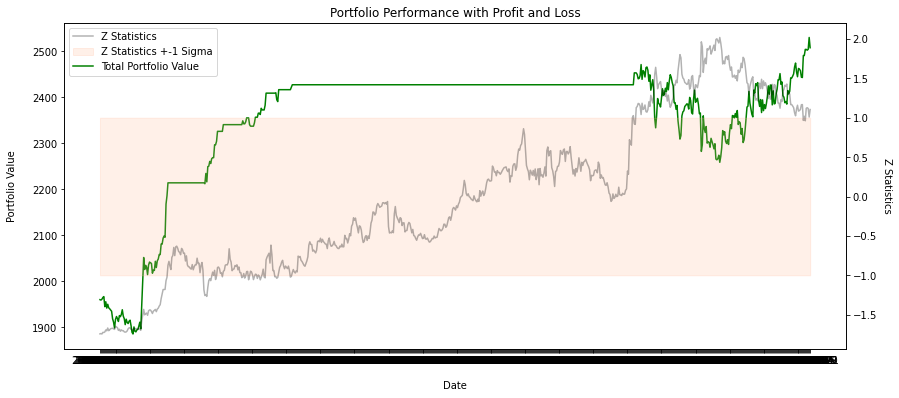

---------------------- AMD & GLW -----------------------


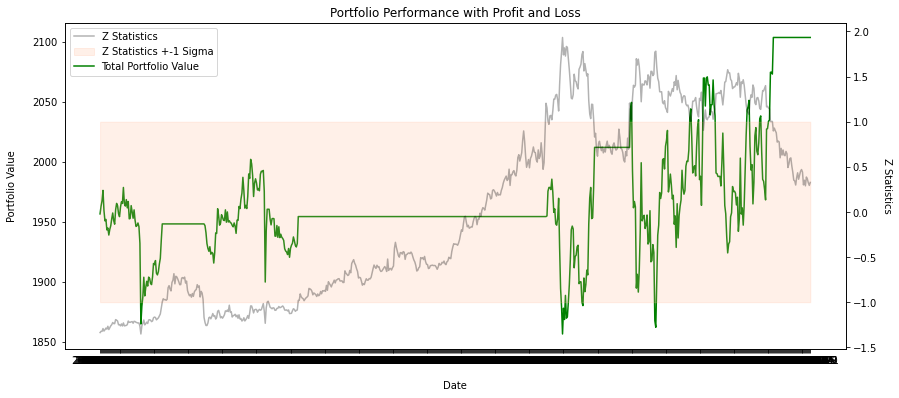

---------------------- AMD & GPN -----------------------


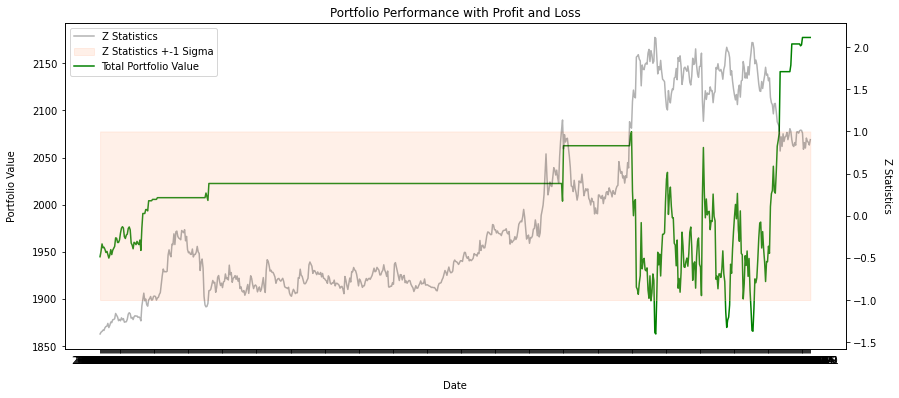

---------------------- AMD & HPQ -----------------------


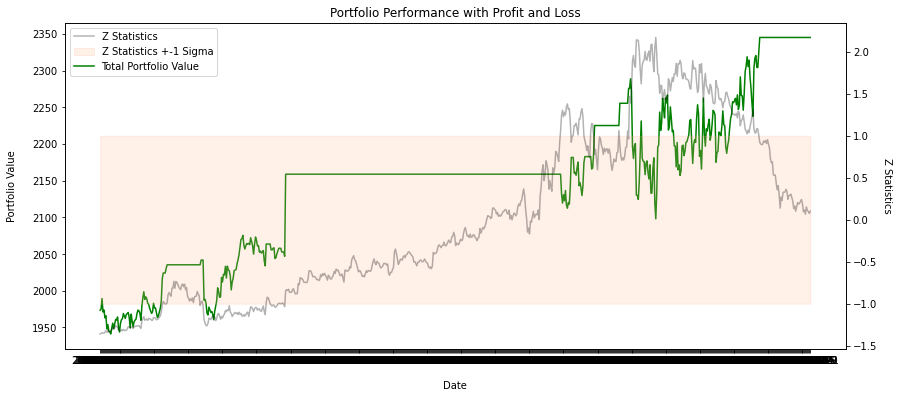

---------------------- AMD & JNPR -----------------------


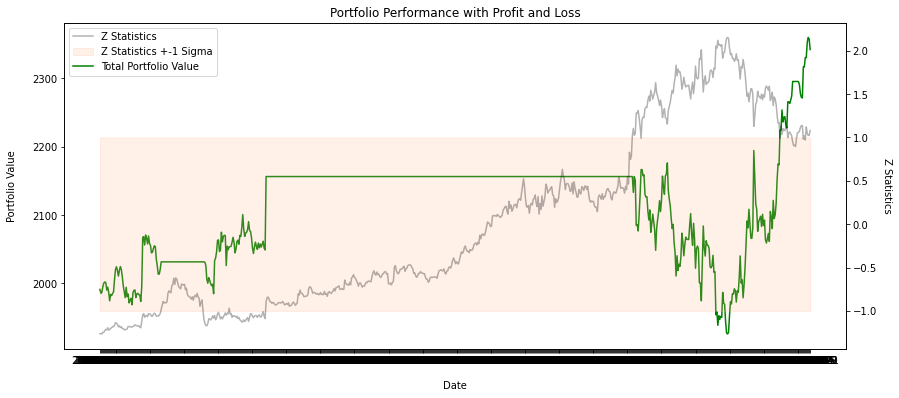

---------------------- AMD & KLAC -----------------------


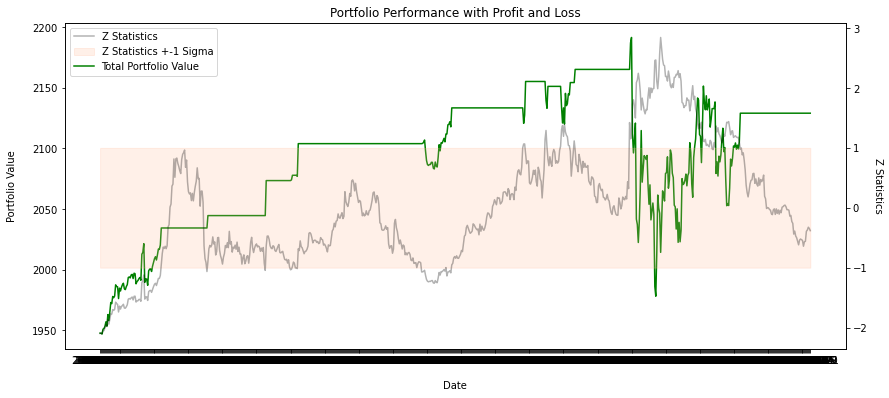

---------------------- AMD & LRCX -----------------------


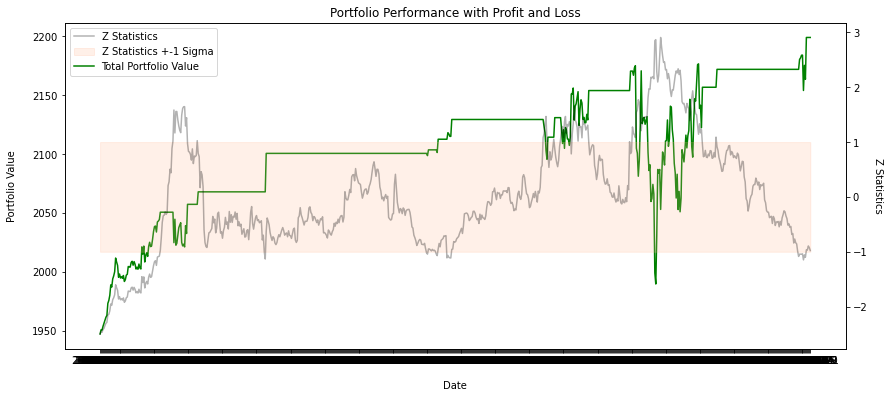

---------------------- AMD & MCHP -----------------------


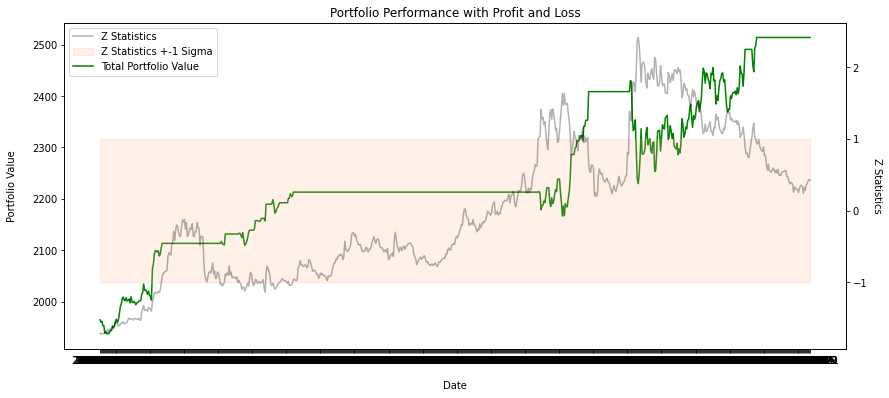

---------------------- AMD & MSFT -----------------------


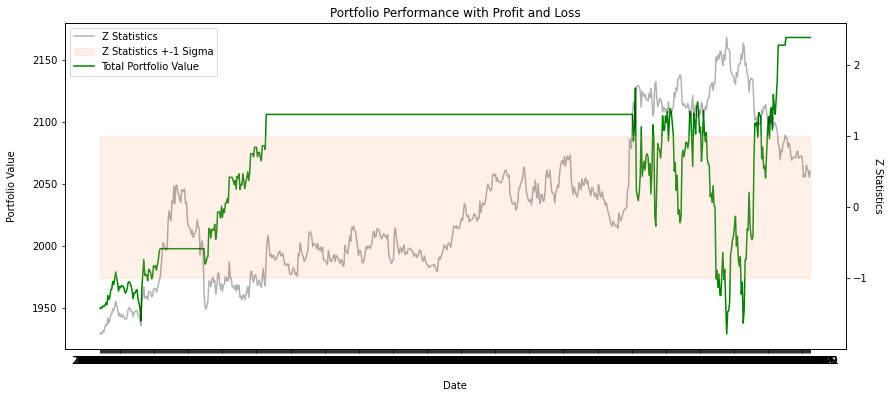

---------------------- AMD & NFLX -----------------------


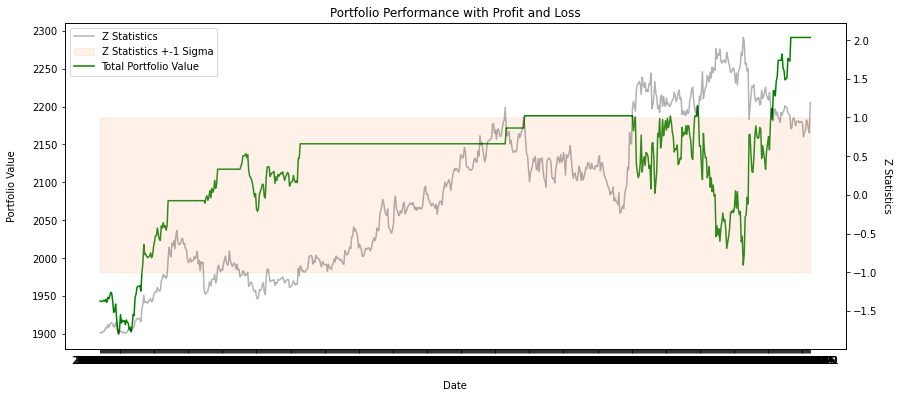

---------------------- AMD & NTAP -----------------------


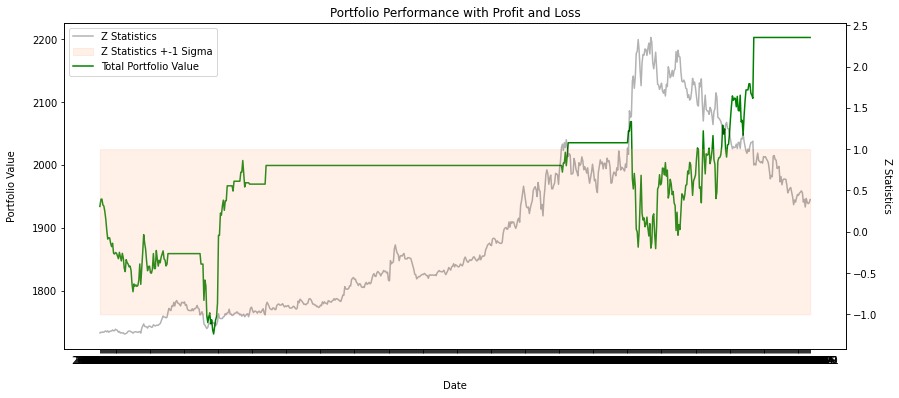

---------------------- AMD & NVDA -----------------------


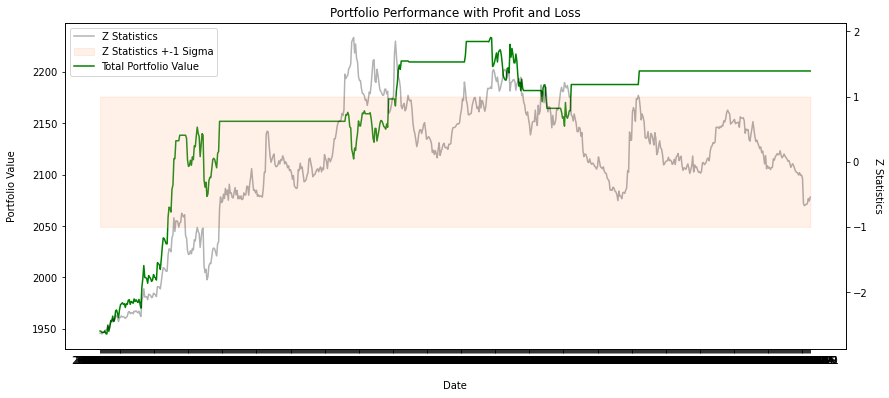

---------------------- AMD & SNPS -----------------------


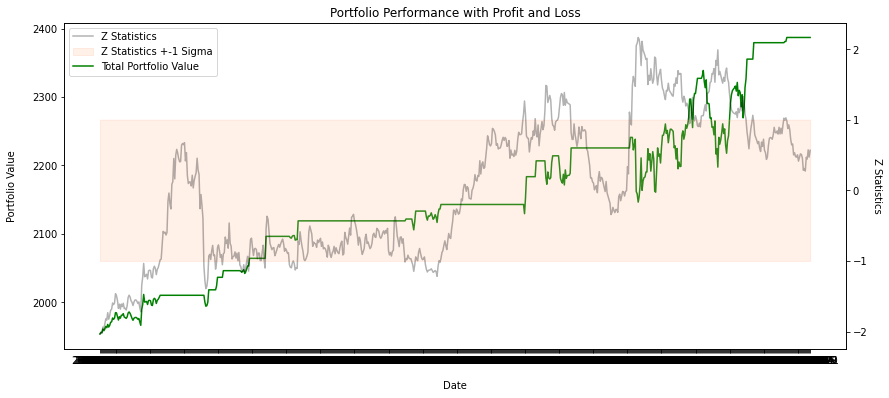

---------------------- AMD & STX -----------------------


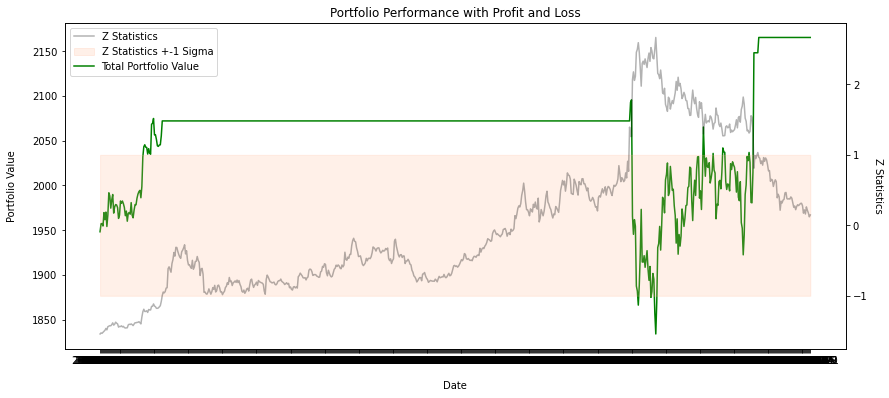

---------------------- AMD & TXN -----------------------


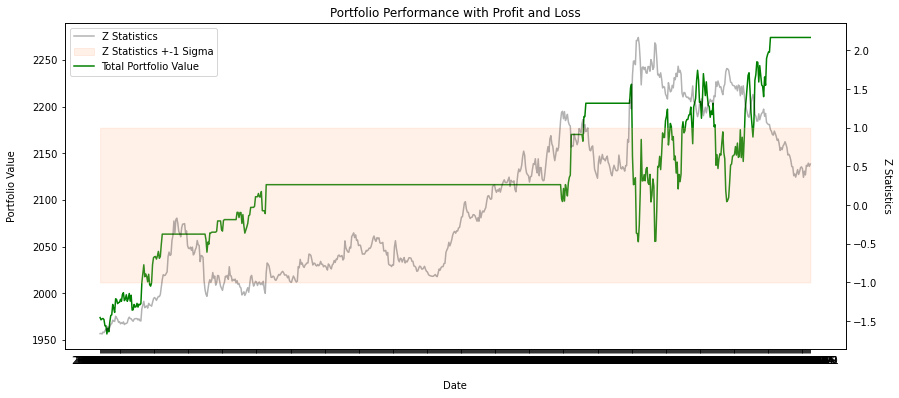

---------------------- AMD & WDC -----------------------


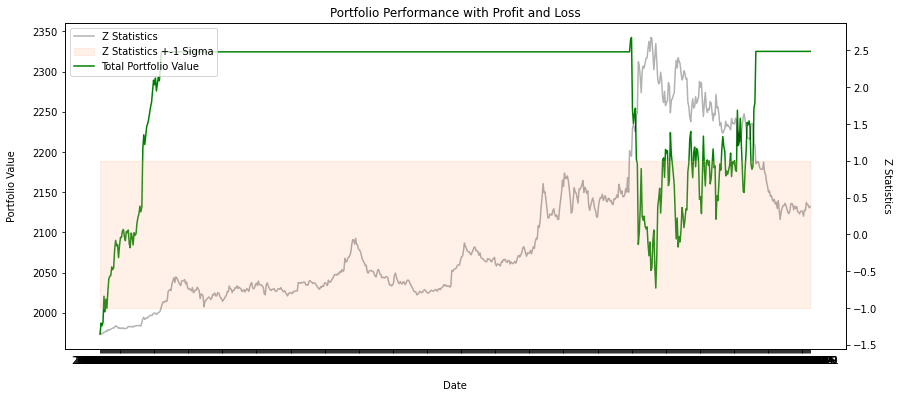

---------------------- AMD & WU -----------------------


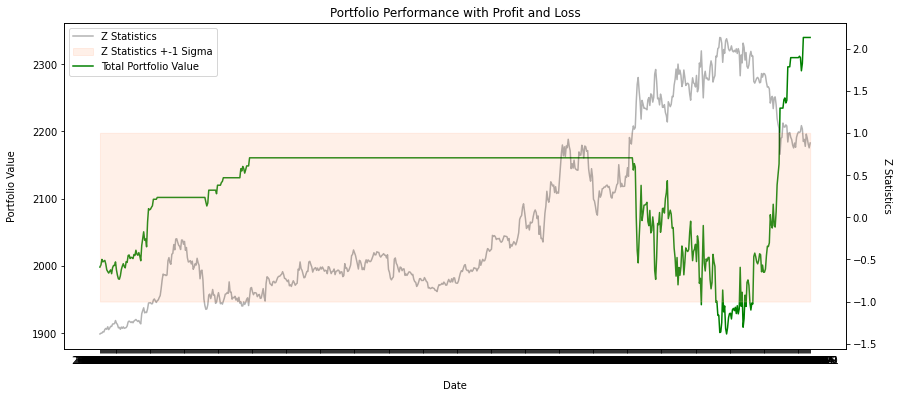

---------------------- AMD & XRX -----------------------


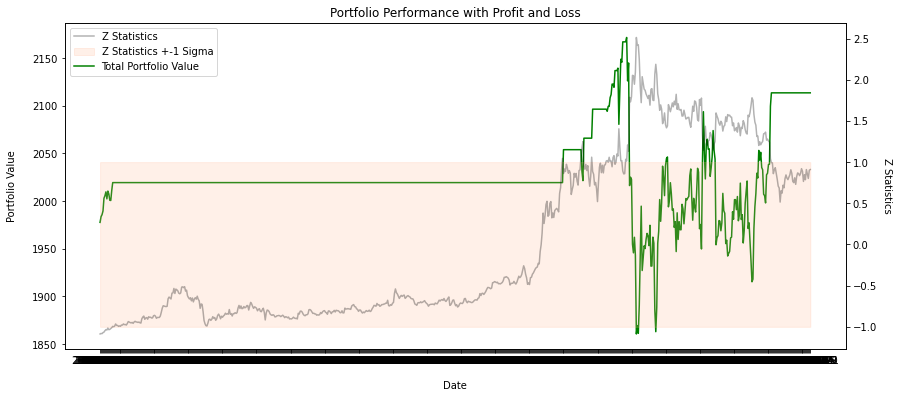

---------------------- ANSS & MSI -----------------------


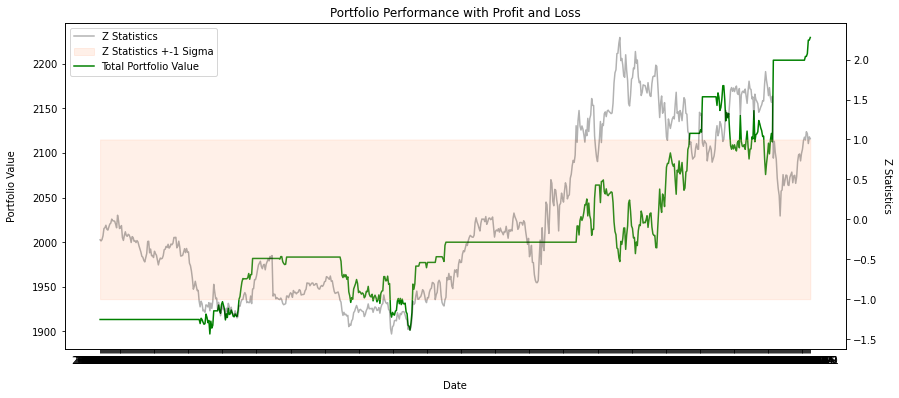

---------------------- ANSS & XLNX -----------------------


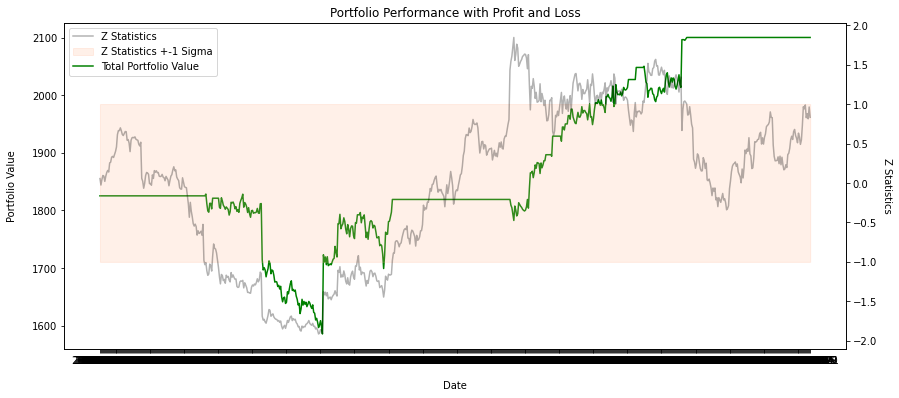

---------------------- APH & FIS -----------------------


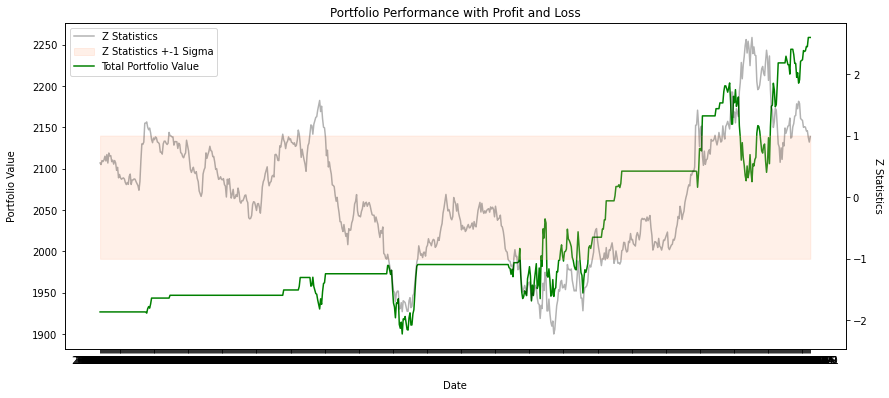

---------------------- APH & GOOG -----------------------


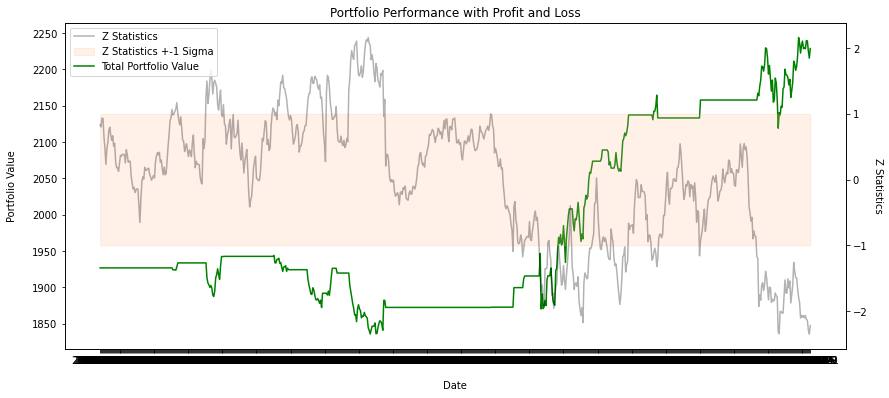

---------------------- APH & GOOGL -----------------------


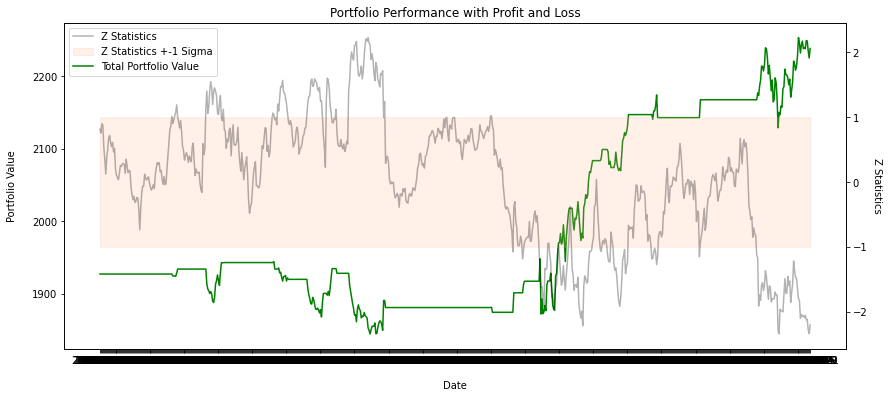

---------------------- APH & IT -----------------------


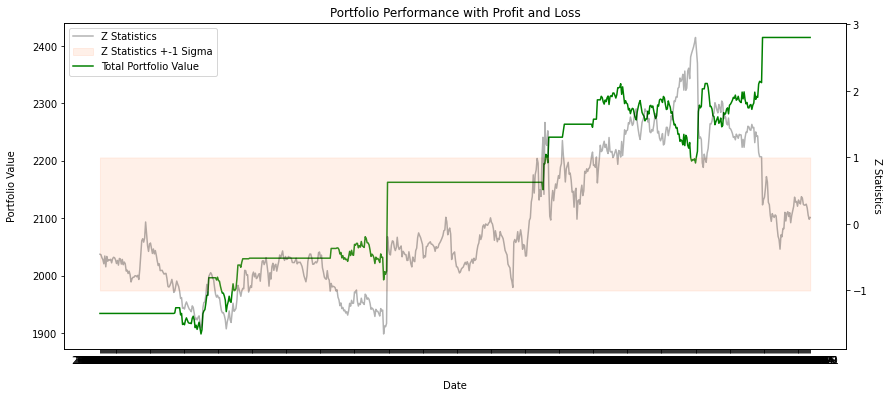

---------------------- APH & MSI -----------------------


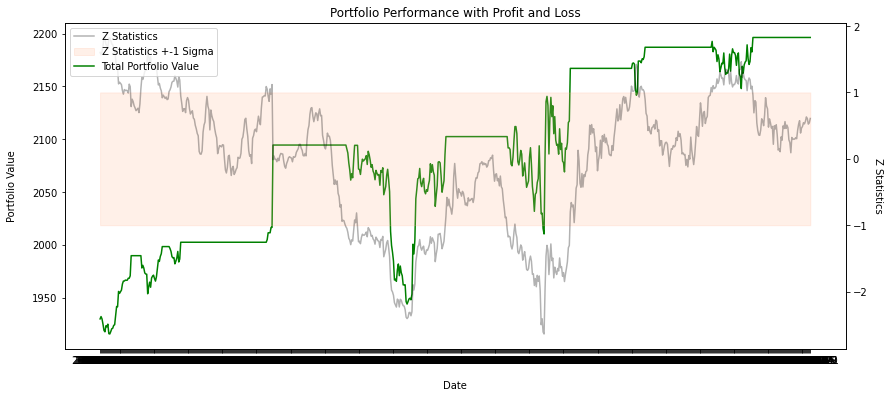

---------------------- ATVI & GPN -----------------------


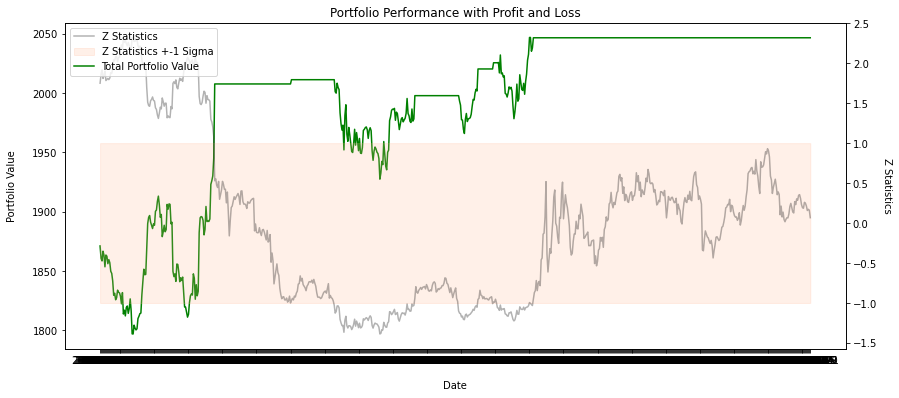

---------------------- CRM & INTU -----------------------


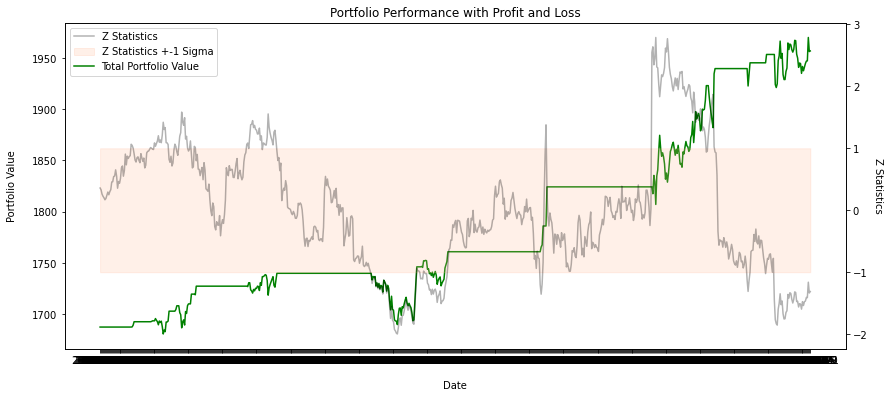

---------------------- CRM & IT -----------------------


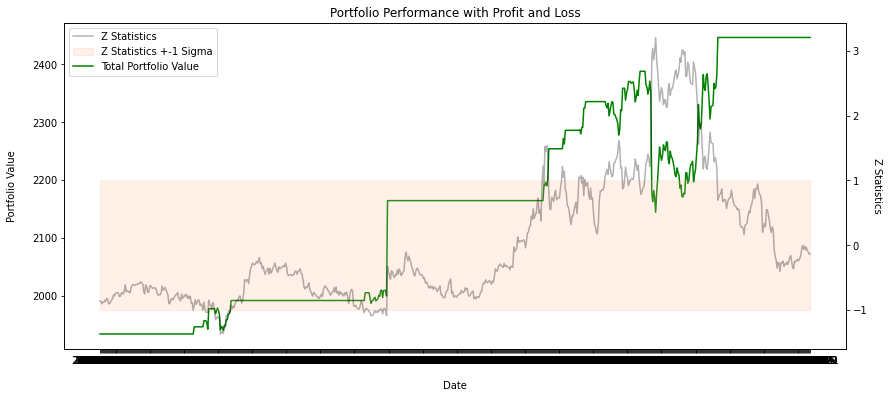

---------------------- CTSH & MSI -----------------------


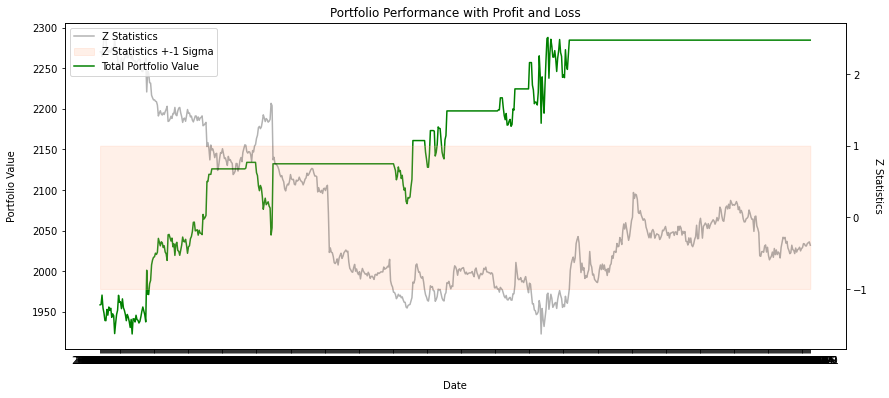

---------------------- EBAY & MSI -----------------------


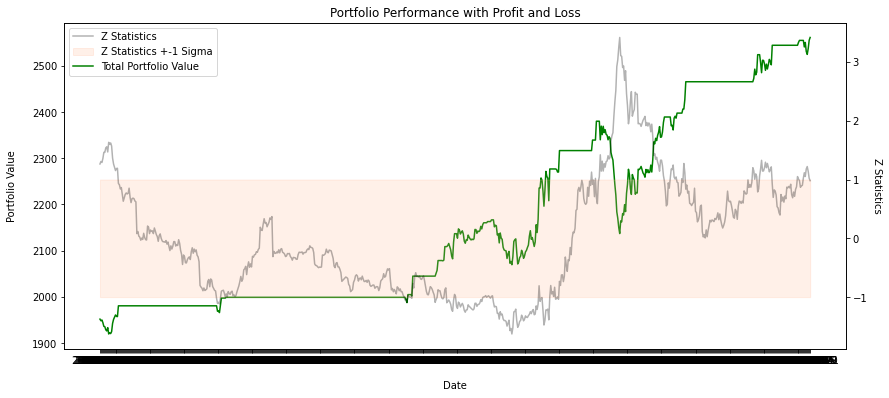

---------------------- EBAY & PAYX -----------------------


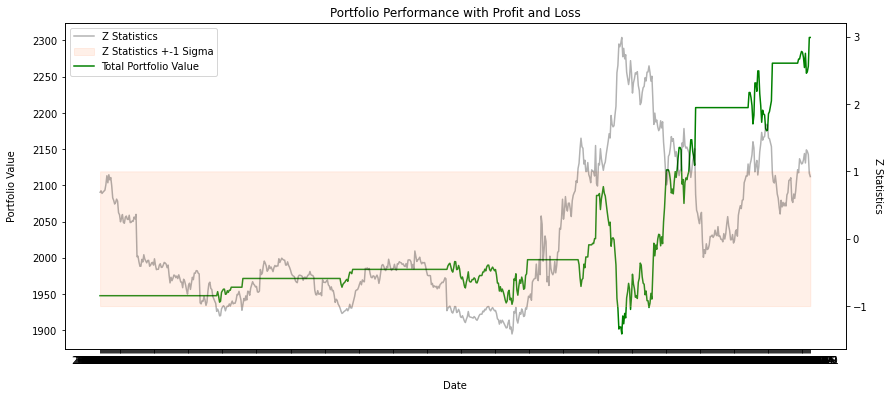

---------------------- EBAY & XLNX -----------------------


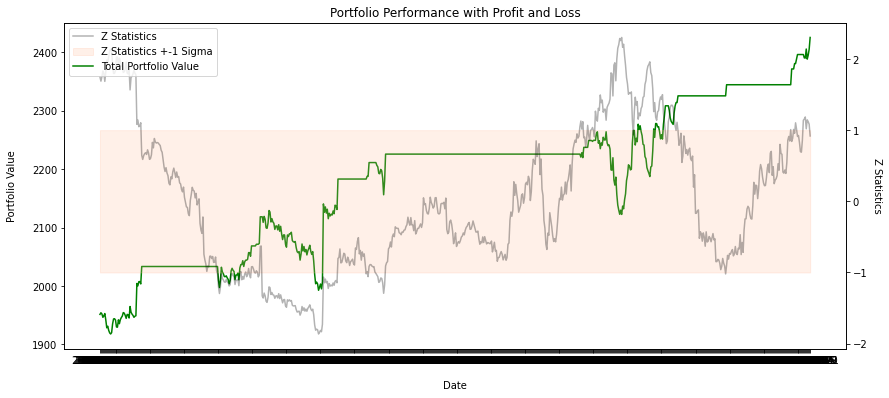

---------------------- FIS & GOOG -----------------------


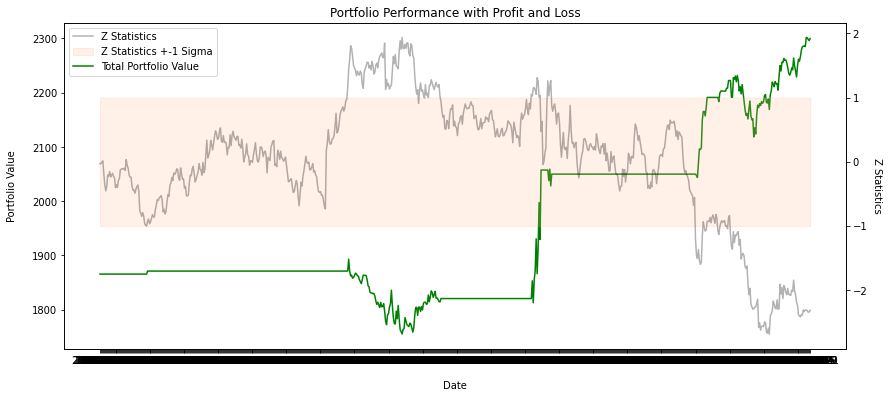

---------------------- FIS & GOOGL -----------------------


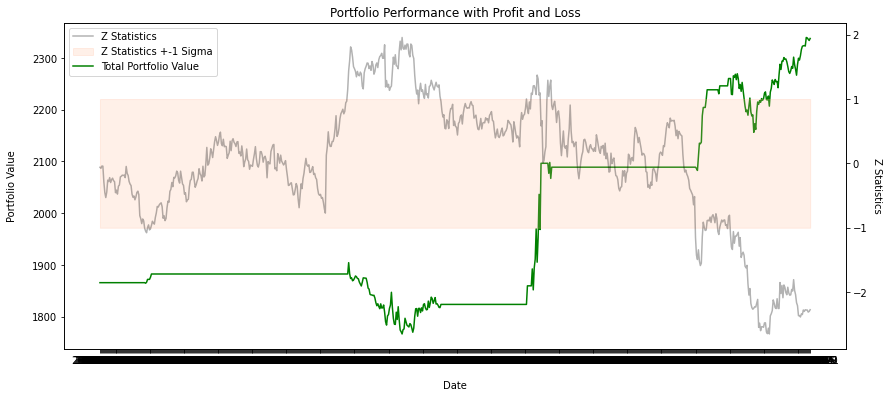

---------------------- FIS & IT -----------------------


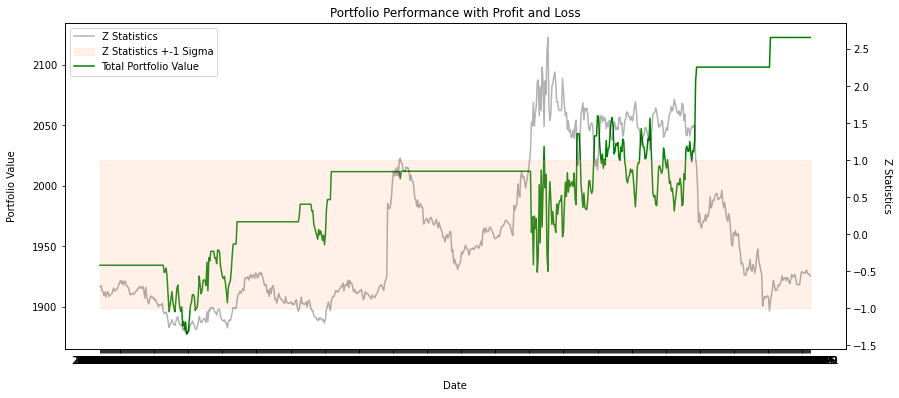

---------------------- FIS & KLAC -----------------------


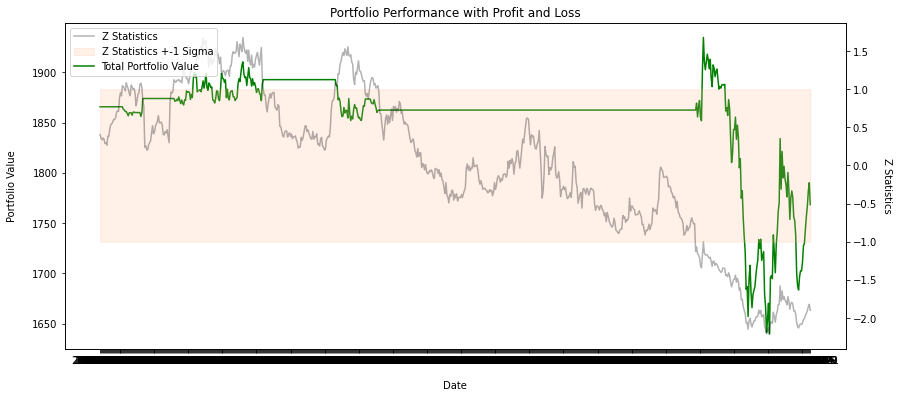

---------------------- FIS & MSI -----------------------


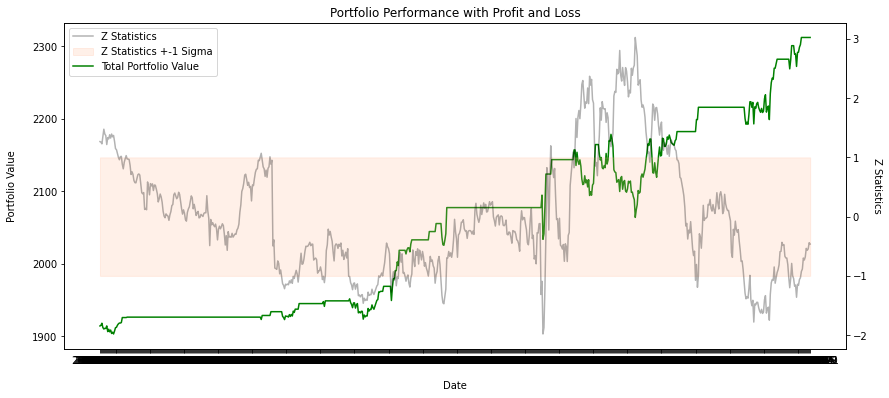

---------------------- GOOG & KLAC -----------------------


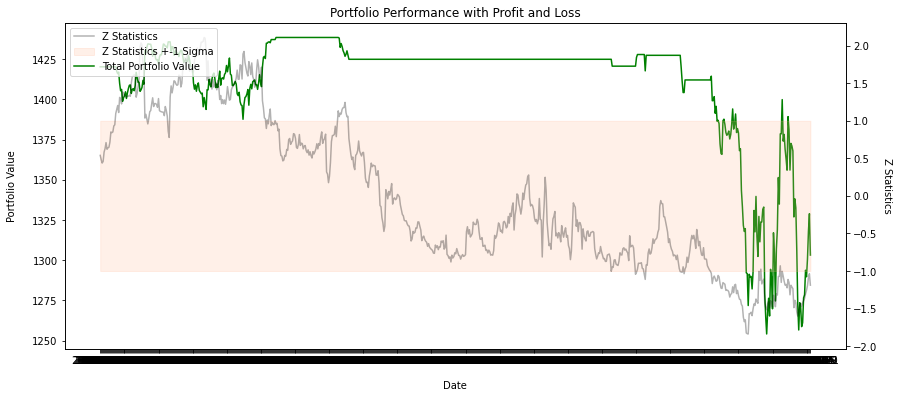

---------------------- GOOG & MSI -----------------------


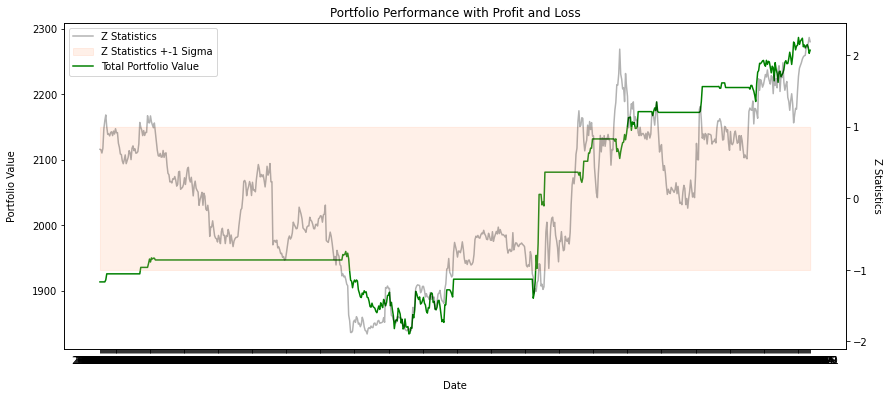

---------------------- GOOG & VRSN -----------------------


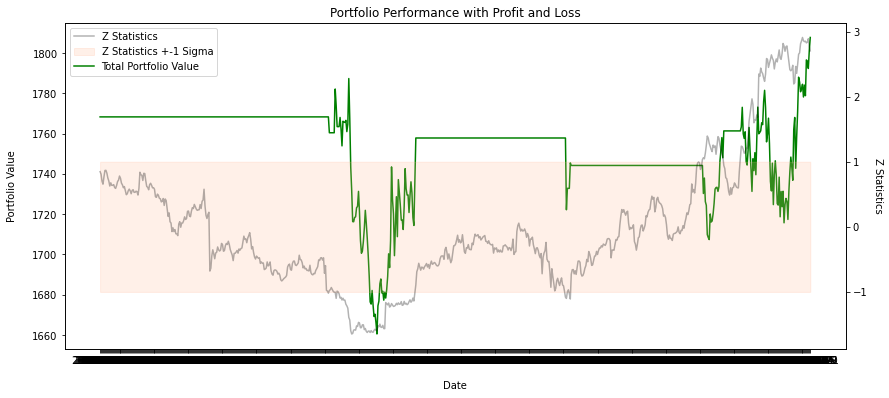

---------------------- GOOGL & KLAC -----------------------


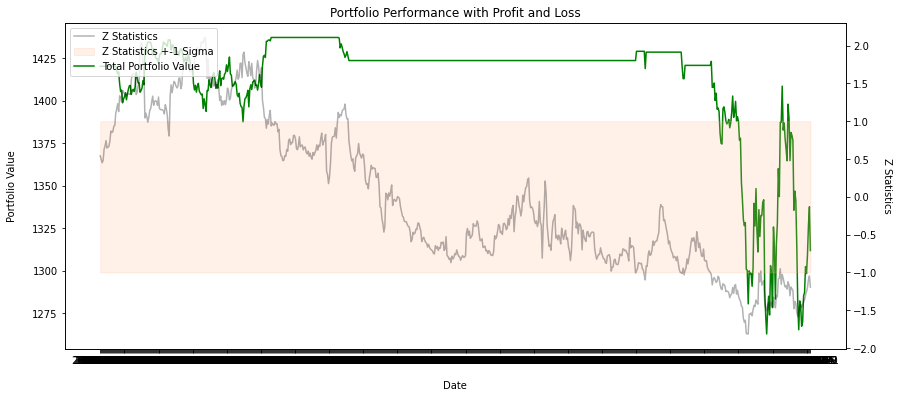

---------------------- GOOGL & MSI -----------------------


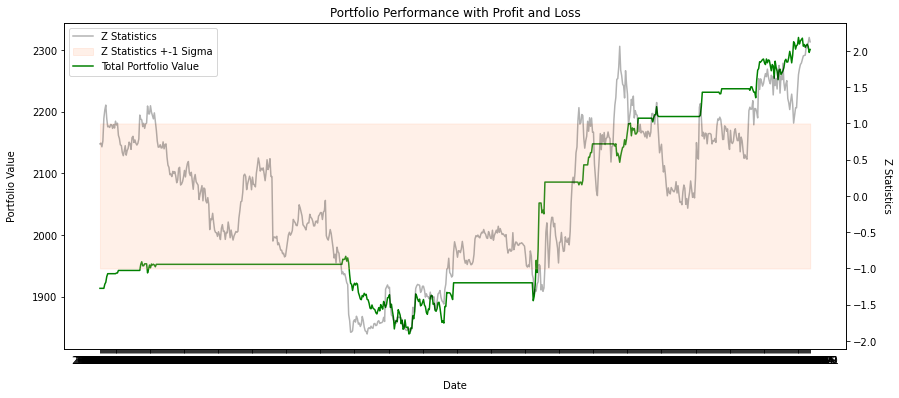

---------------------- GOOGL & VRSN -----------------------


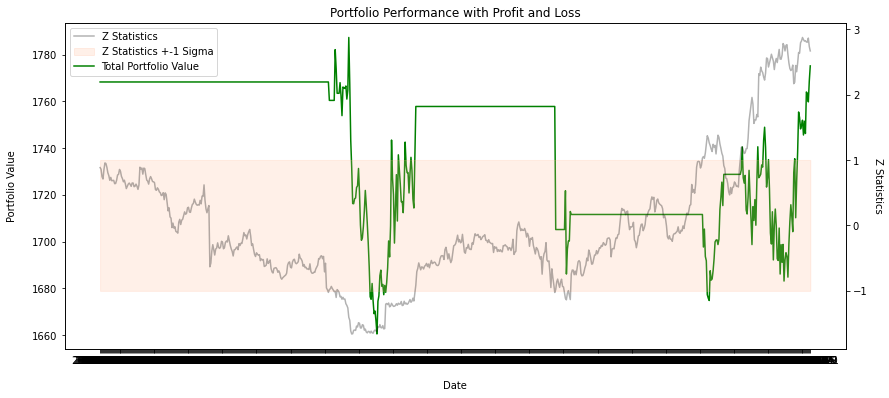

---------------------- INTC & MSI -----------------------


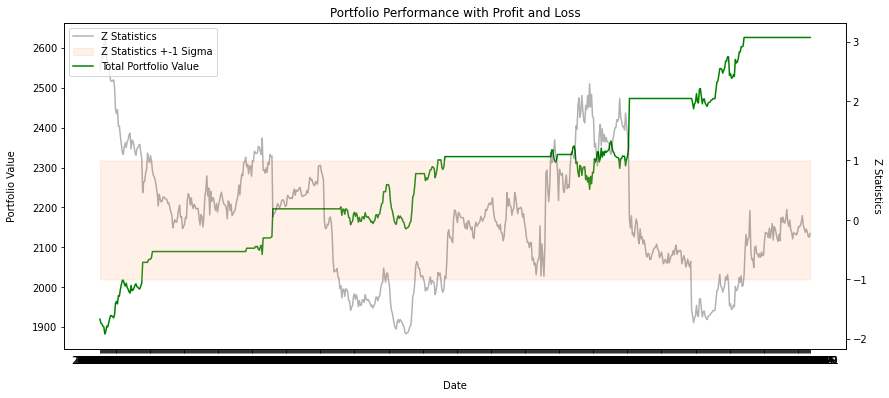

---------------------- INTU & VRSN -----------------------


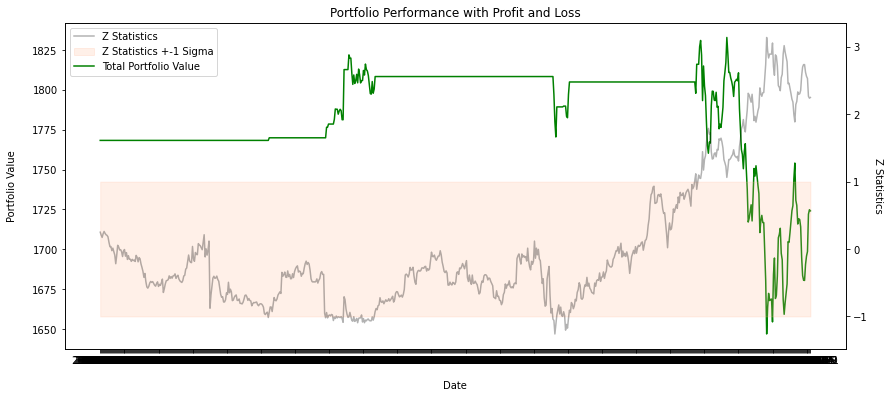

---------------------- IT & MSI -----------------------


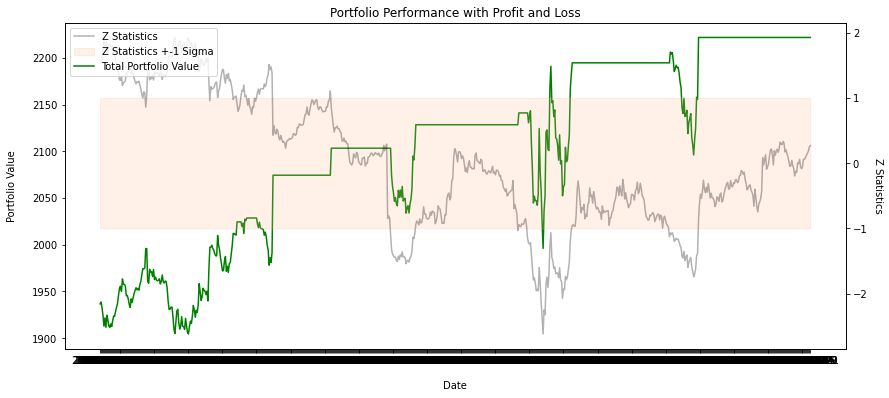

---------------------- KLAC & MCHP -----------------------


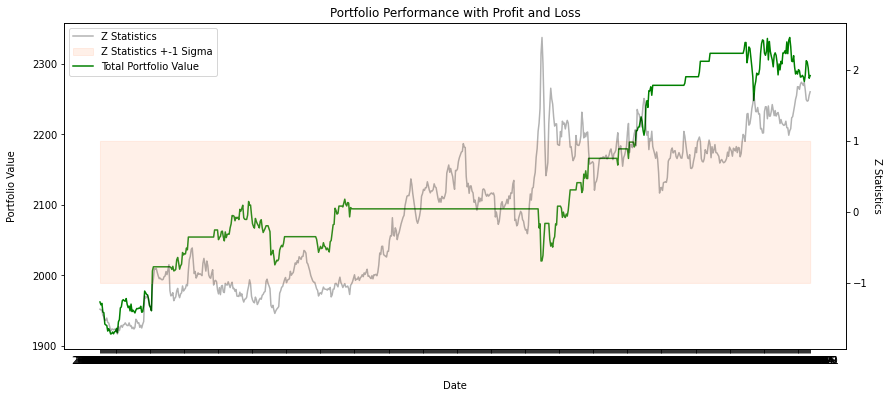

---------------------- KLAC & MSI -----------------------


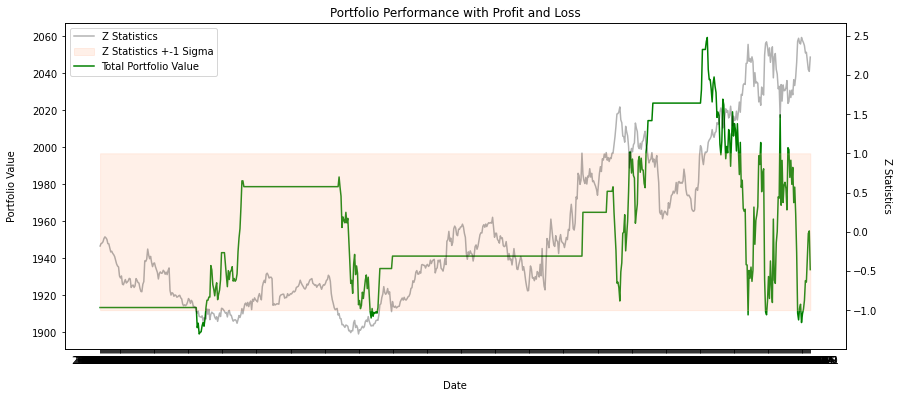

---------------------- KLAC & SNPS -----------------------


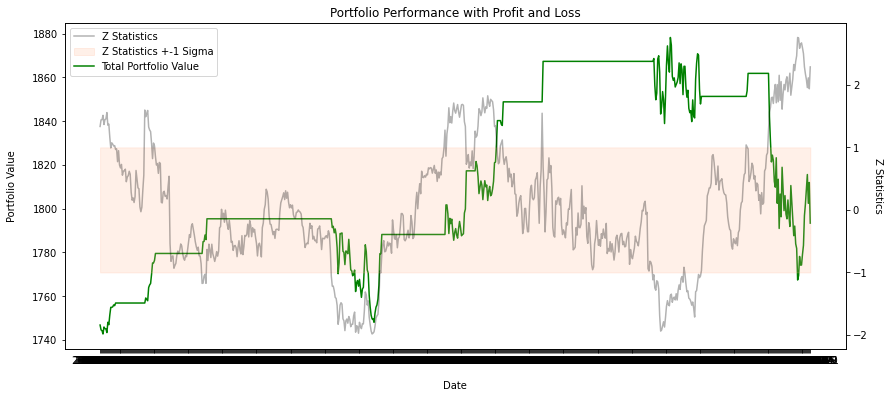

---------------------- KLAC & TXN -----------------------


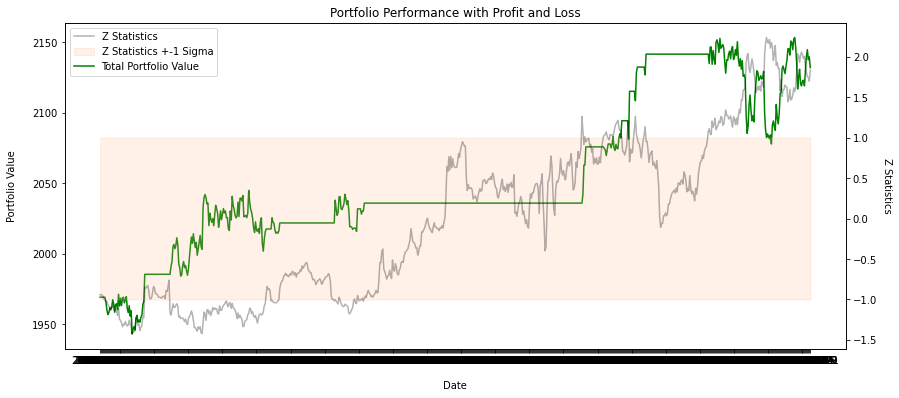

---------------------- MCHP & SNPS -----------------------


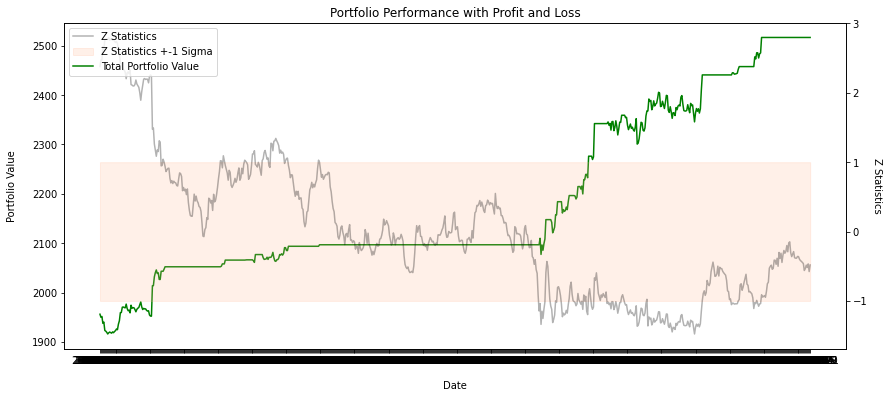

---------------------- MSFT & TXN -----------------------


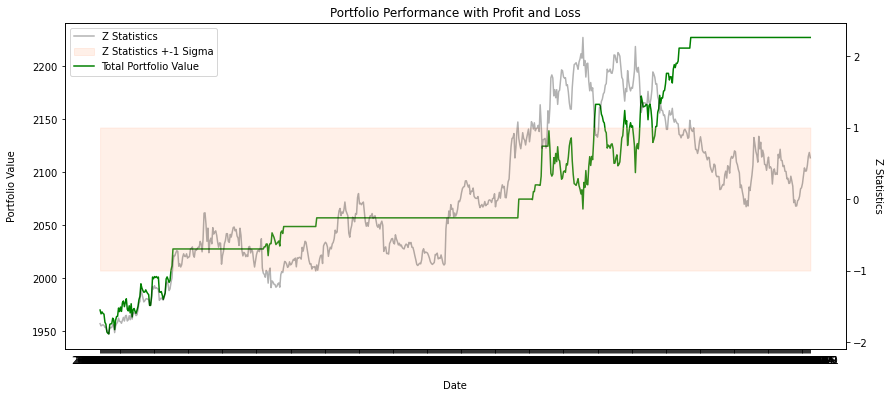

---------------------- MSI & PAYX -----------------------


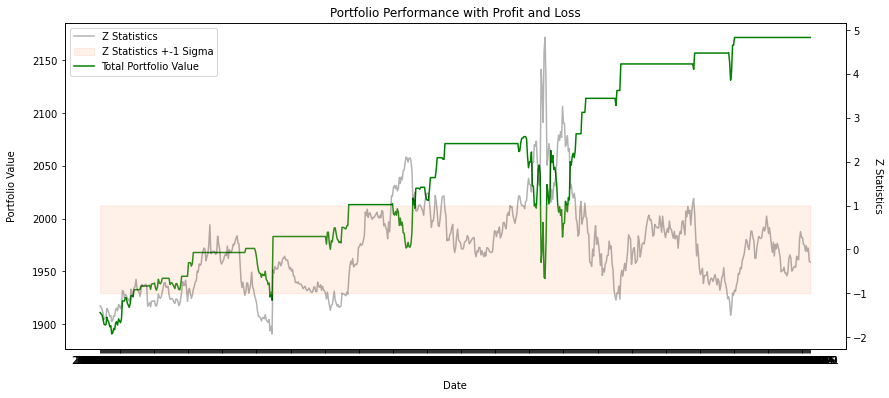

---------------------- MSI & SNPS -----------------------


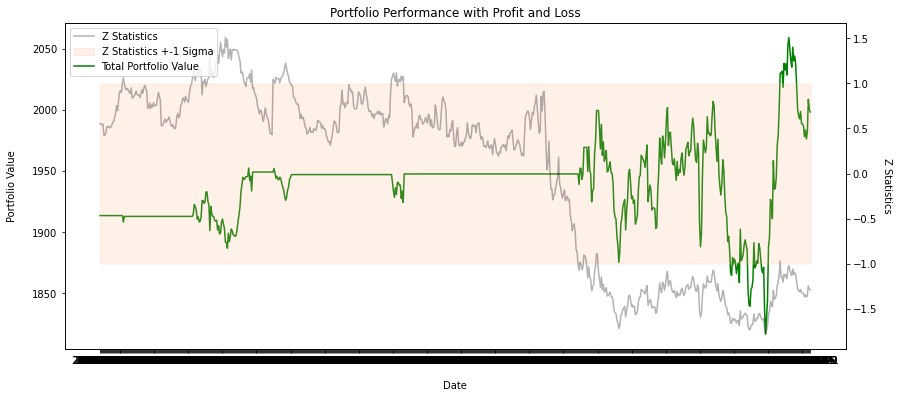

---------------------- MSI & VRSN -----------------------


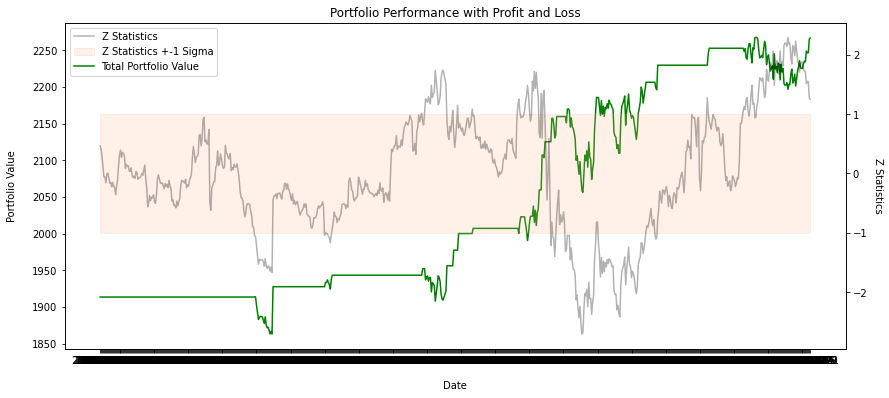

---------------------- MSI & XLNX -----------------------


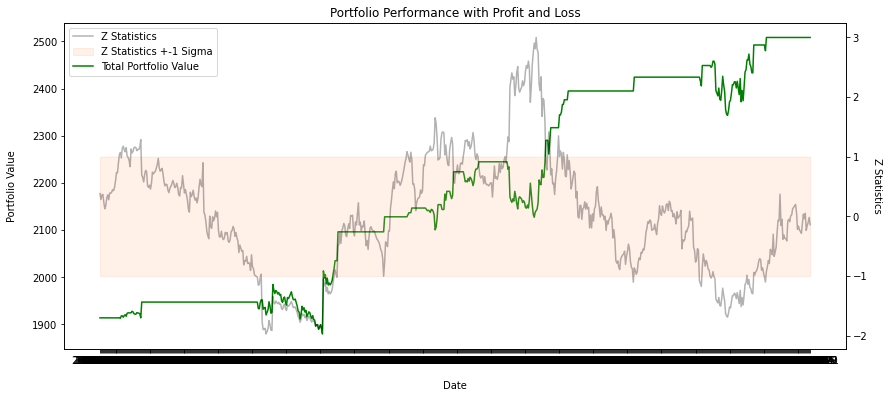

In [716]:
for i in range(len(watched)):
    print("---------------------- {} & {} -----------------------".format(watched[i][0], watched[i][1]))
    print_portfolio(portfolio[i])

In [710]:
total_portfolio = pd.DataFrame()
for i in range(len(watched)):
    total_portfolio[i] = portfolio[i]['total asset']
total_portfolio

,0,1,2,3,4,5,6,7,8,9,...,82,83,84,85,86,87,88,89,90,91
Date,,,,,,,,,,,,,,,,,,,,,
2018-05-24,1715.356750,1961.880066,1943.099976,1930.480629,1865.742188,1744.320007,1744.320007,1934.199982,1913.399963,1768.319946,...,1961.844482,1913.399963,1746.796570,1969.299927,1956.101074,1969.768410,1911.001125,1913.399963,1913.399963,1913.399963
2018-05-25,1715.356750,1961.880066,1943.099976,1935.228912,1865.742188,1744.320007,1744.320007,1934.199982,1913.399963,1768.319946,...,1957.811295,1913.399963,1744.587944,1969.299927,1949.859261,1966.162552,1909.649418,1913.399963,1913.399963,1913.399963
2018-05-29,1715.356750,1961.880066,1943.099976,1930.165344,1865.742188,1744.320007,1744.320007,1934.199982,1913.399963,1768.319946,...,1959.884872,1913.399963,1744.230453,1969.299927,1951.575348,1968.020020,1908.652702,1913.399963,1913.399963,1913.399963
2018-05-30,1715.356750,1961.880066,1943.099976,1933.305824,1865.742188,1744.320007,1744.320007,1934.199982,1913.399963,1768.319946,...,1947.448822,1913.399963,1742.712082,1969.299927,1937.620926,1966.527702,1904.965504,1913.399963,1913.399963,1913.399963
2018-05-31,1715.356750,1961.880066,1943.099976,1936.820656,1865.742188,1744.320007,1744.320007,1934.199982,1913.399963,1768.319946,...,1946.726776,1913.399963,1745.891884,1969.299927,1940.078682,1965.931358,1899.989464,1913.399963,1913.399963,1913.399963
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-04-15,1815.076019,2404.591644,2097.900513,2261.387711,2080.204605,2015.432465,1992.654831,2194.089211,2252.710358,1762.050827,...,2304.292198,1927.123413,1808.569176,2140.003609,2516.813324,2227.320801,2171.589142,1976.123802,2248.753998,2508.340157
2021-04-16,1813.636017,2404.591644,2097.720535,2261.387711,2073.934616,2020.862457,1998.084824,2194.089211,2249.000397,1755.980820,...,2302.592186,1939.923462,1815.569145,2144.883598,2516.813324,2227.320801,2171.589142,1981.923882,2246.393951,2508.340157
2021-04-19,1782.496063,2404.591644,2098.030472,2261.387711,2072.794601,2019.602509,1996.824875,2194.089211,2246.500336,1753.640732,...,2294.252190,1953.383423,1802.399147,2137.753593,2516.813324,2227.320801,2171.589142,2008.553841,2246.553925,2508.340157


In [711]:
total_portfolio = total_portfolio.sum(axis=1)

In [712]:
returns = total_portfolio['2019-06-05']/total_portfolio['2018-06-05'] - 1
print('CAGR = {:.3f}%'.format(returns * 100))

CAGR = 4.914%


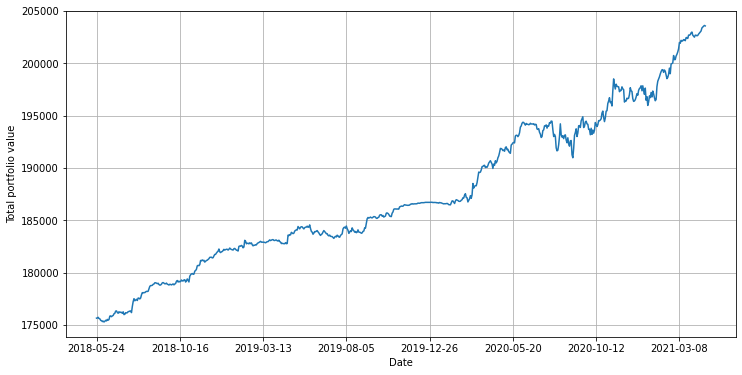

In [713]:
ax = total_portfolio.plot(figsize=(12, 6))
ax.grid(True)
ax.set_ylabel("Total portfolio value")
plt.show()

In [714]:
final_value = total_portfolio[-1]
delta = len(total_portfolio)
print('Number of days =', delta)

Number of days = 732


In [715]:
YEAR_DAYS = 365
returns = (final_value/(2 * sum(pairs_start_capital))) ** (YEAR_DAYS/delta) - 1
print('CAGR = {:.3f}%'.format(returns * 100))

CAGR = 7.657%
